# Master 2023 - Degradation of Norwegian Wind Farms

To run this program, all the files in Data/Værdata at OneDrive need to be uploaded

In [1]:
!pip install windpowerlib
!pip install windrose
!pip install pmdarima
!pip install xarray==0.21.1
!pip install geopy

In [2]:
# Libraries for working with multidimensional arrays
import numpy as np
import xarray as xr
# Libraries for plotting and visualising data
import matplotlib.path as mpath
import math
import matplotlib.pyplot as plt
import pandas as pd
from scipy import stats
import altair as alt
from windrose import WindroseAxes
import seaborn as sns

from windpowerlib import ModelChain, WindTurbine, create_power_curve
from windpowerlib import data as wt
from windpowerlib.power_curves import smooth_power_curve

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.linear_model import RANSACRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold


import statsmodels.api as sm
import statsmodels.stats.diagnostic as smd
from scipy.stats import shapiro
from scipy.stats import mannwhitneyu


import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.regression.linear_model import OLS
from sklearn.model_selection import TimeSeriesSplit
from statsmodels.tsa.seasonal import seasonal_decompose

from statsmodels.stats import diagnostic as diag

import pandas as pd
from statsmodels.regression import linear_model
from patsy import dmatrices
import statsmodels.graphics.tsaplots as tsa
from statsmodels.stats.diagnostic import linear_rainbow,linear_harvey_collier,het_breuschpagan
import numpy as np


#Obtaining power coeffients to plot the power curves and power coefficient curves
from windpowerlib.power_output import power_coefficient_curve
import geopy.distance
import pmdarima as pm

# Functions

In [3]:
#Load powercoefficient
power_coeff=pd.read_csv("https://pvexpect.com/Green_hydrogen/power_coefficient_2.csv", delimiter=";")

def create_production_dataframe(chosen_windfarms):

  # we start by loading the wind energy production data from an Excel file.
  wind_energy = pd.read_excel("NVE_prod_2002_2023.xlsx")

  #@title Data structuring of wind production data

  #We skips the first rows as they do not contain time series data
  wind_energy = wind_energy[2:]
  #Rename the 'kraftverknavn' column to 'timestamp' for clarity.
  wind_energy.rename(columns={'kraftverknavn': 'time'}, inplace=True)

  #Convert the 'timestamp' column to datetime format.
  wind_energy['time'] = pd.to_datetime(wind_energy['time'])

  #Create a new 'year' column by extracting the year from the 'timestamp' column.
  wind_energy['year'] = wind_energy.time.dt.year

  #Set the 'timestamp' column as the index for time-based analysis.
  wind_energy.set_index("time", inplace=True)

  # Display the first few rows of the structured data for inspection.
  wind_energy.head(100)

  #Choosing production data for choosen wind farms and saving into separate file
  wind_energy_chosen =wind_energy[chosen_windfarms]

  wind_energy_chosen.to_csv('nve_prod_chosen_2023.csv', index=True)

def combine_nc_dataset(name):
  full = xr.open_mfdataset(name + '_*_*.nc',combine = 'nested', concat_dim="time")
  full.to_netcdf(name + '_combined.nc')

#Modifisert versjon av Jesper Frausig sin kode
def construct_columns(nc_name, ds):
  da = ds[nc_name]
  weights = np.cos(np.deg2rad(da.latitude))
  weights.name = "weights"
  t2m_C_weighted = da.weighted(weights)

  data_values=t2m_C_weighted.mean(["longitude", "latitude"])
  df = pd.DataFrame({"date": data_values.time, "value": data_values})
  df['timestamp']=df.date
  df.set_index('timestamp', inplace=True)
  df.drop("date", axis=1, inplace=True)
  nc_variable=df
  return nc_variable

#Modifisert versjon av Jesper Frausig sin kode
def create_wind_direction_df(v10, u10):
  angle = np.arctan2(v10.value,u10.value)
  df_wind_direction=pd.DataFrame()
  df_wind_direction['wdir']= angle * (180/np.pi) + 180
  return df_wind_direction

def construct_weather_data(u10, v10,t2m, sp,fsr):
  weather_data=pd.DataFrame()
  weather_data['wind_speed']=((u10.value)**2+(v10.value)**2)**(0.5)
  weather_data['temperature'] = t2m
  weather_data['pressure'] = sp
  weather_data['roughness_length'] = fsr

  weather_data['timestamp']=weather_data.index
  return weather_data

def period_resampled_data(df,on_column,period = 'M', hours = None):
  if hours is None:
    df_monthly = df[str(on_column)].resample(period).agg(['sum'])
    df_monthly.columns = ["Production"]
  else:
    df_monthly = df[str(on_column)].resample(period).agg(['sum', 'count'])
    df_monthly.columns = ["Production", "Hours"]
  return df_monthly


def first_valid_hour(df,column = None):
  df = pd.DataFrame(df)
  if column is None:
    column = df.columns[0]

  #Finding first production hour
  index_of_first_valid_value = df[str(column)].first_valid_index()
  one_year = str(pd.to_datetime(index_of_first_valid_value) + pd.Timedelta(365, unit="d"))

  return index_of_first_valid_value, one_year


def create_windrose(wind):
  ax = WindroseAxes.from_ax()
  ax.bar(wind.wdir.to_numpy(), wind.wind_speed.to_numpy(), normed=True, opening=0.8, edgecolor='white')
  ax.set_legend()


def create_new_turbine_object(Vindpark):
  new_turbine = {
      "turbine_type": Vindpark['Model_2'],
      "nominal_power": (Vindpark['Maksimal effekt'] *10**6),  # in W
      "hub_height": Vindpark['hub_height'],  # in m
      "power_curve": make_power_curve(external_power_curves['wind_speed'],  external_power_curves[Vindpark['Model_2']]),
  }
  new_turbine = WindTurbine(**new_turbine)

  return new_turbine


def make_power_curve(wind_speed, power):
  power_curve = create_power_curve(wind_speed = wind_speed, power = power)

  return power_curve


def create_turbine_object(vindpark):
  df = wt.get_turbine_types(print_out=False)

  if df[df["turbine_type"].str.contains(vindpark['Model_2'])]['turbine_type'].any():
    my_turbine= WindTurbine(hub_height=vindpark["hub_height"],turbine_type=vindpark['Model_2'])

  else:
    my_turbine = create_new_turbine_object(vindpark)

  return my_turbine





#Plotting power coefficient curve
def plot_power_coefficient_curve(my_turbine, vindpark):
  if my_turbine.power_coefficient_curve is not None:
          my_turbine.power_coefficient_curve.plot(
              x='wind_speed', y='value', style='*',
              title= vindpark['Model_2'] +' power coefficient curve')
          plt.xlabel('Wind speed in m/s')
          plt.ylabel('Power Coefficient, Cp')
          plt.show()


#Plotting power curve
def plot_power_curve(my_turbine, vindpark):
  if my_turbine.power_curve is not None:
          power_curve = my_turbine.power_curve.plot(x='wind_speed', y='value', style='*',
                                      title= vindpark['Model_2'] +' power curve')
          plt.xlabel('Wind speed in m/s')
          plt.ylabel('Power in W')
          plt.show()


def construct_weather_windpowerlib(weather_data):

  df_weather_windpowerlib = pd.DataFrame(weather_data[['wind_speed','temperature','pressure','roughness_length']])

  header =[['wind_speed','temperature','pressure','roughness_length'],[100,2,0, 0]]
  df_weather_windpowerlib.columns = header
  return df_weather_windpowerlib

#Modifisert versjon av Jesper Frausig sin kode
def wind_farm_simulated_power_output(my_turbine, vindpark):
  # @title Comparing and merging simulated and measured wind power output
  # Extract power output data from the turbine model and store it in 'simulated_data'
  simulated_data=my_turbine.power_output

  # Localize the timezone of the simulated data and scale it
  # (by converting it to MW and adjusting for the number of operational turbines)
  simulated_data=simulated_data.tz_localize(None)
  simulated_data=simulated_data*(10**-6)*vindpark['Antall operative turbiner']

  # Convert simulated data to DataFrame for further manipulations
  simulated_data=pd.DataFrame(simulated_data)
  # Display the total sum of the simulated data for quick inspection
  print(simulated_data.sum())

  return simulated_data

#PLotting simulated power output

def plot_power_output(my_turbine, vindpark):
  my_turbine.power_output.plot(legend=True, label= vindpark['Model_2'])
  plt.xlabel('Time')
  plt.ylabel('Power in MW')
  plt.show()

#Creating production index
def create_production_index(df_measured, df_simulated):
  production_index = df_measured.div(df_simulated)
  production_index.columns = ['Production Index']
  return production_index




In [4]:
#Getting coordinate to weather data
def get_weather_coords(ds):
  latitude = ds['latitude'].values[0]
  longitude = ds['longitude'].values[0]
  weather_coordinate = (latitude,longitude)
  return weather_coordinate

In [5]:
#Creating three metrics to a wind farm using y_test and the predicted y
def get_metrics(vindpark_navn, y_test,y_pred):
  r2 = r2_score(y_test, y_pred)
  mse = mean_squared_error(y_test, y_pred)
  mae = mean_absolute_error(y_test, y_pred)
  df_metrics = pd.DataFrame({'Wind Farm': vindpark_navn, 'R2': r2, 'MSE': mse, 'MAE': mae}, index = [vindpark_navn])

  return df_metrics

In [6]:
def downtime(df, Vindpark_navn):
  #Downtime is defined as all points that have consequetive 3 hours of zero production when inside production interval (5-25 m/s)
  mask_d = df[Vindpark_navn].ne(0)
  cumsum_d = df.groupby(mask_d.cumsum())[Vindpark_navn].transform('size')

  df_downtime_zero_production = df.loc[((df['wind_speed'] > 5) & (df['wind_speed'] < 25)) & (cumsum_d.gt(3).mask(mask_d, False))]

  return df_downtime_zero_production

In [7]:
#calculating distance between weather coordinate and wind farm coordinate
def get_df_distance(ds,Vindpark_navn):
  weather_coord = get_weather_coords(ds)

  latitude_windfarm = portfolio[Vindpark_navn]['Latitude']
  longitude_windfarm = portfolio[Vindpark_navn]['Longitude']

  wind_farm_coord = (latitude_windfarm, longitude_windfarm)

  distance_km = geopy.distance.geodesic(weather_coord, wind_farm_coord).km

  df_distance = pd.DataFrame({'Wind_farm': Vindpark_navn,
                              'Weather_coordinate': str(weather_coord),
                              'Windfarm_coordinate': str(wind_farm_coord),
                              'Distance': distance_km}, index = [0])
  return df_distance


In [8]:
#Simulating a tubine and using this tubine to simulated the rest of the farm
def windpowerlib_simulation(Vindpark,Vindpark_navn, weather_data):
    my_turbine = create_turbine_object(Vindpark)

    mc_my_turbine = ModelChain(my_turbine, wind_speed_model='logarithmic', hub_height=portfolio[Vindpark_navn]['hub_height'], density_correction=True).run_model(weather_data)
    my_turbine.power_output = mc_my_turbine.power_output
    simulated_data = wind_farm_simulated_power_output(my_turbine, Vindpark)


    return simulated_data, my_turbine

In [9]:
#Selecting n years of the production index dataframe and returning this

def select_period(df,num_years):
  _,one_year = first_valid_hour(df)

  end_date = pd.to_datetime(one_year) + pd.Timedelta(365 * num_years, unit="d")

  #greater than the start date and smaller than the end date
  selected_df = df[one_year:end_date]

  return selected_df

In [10]:
#@title Reading and transforming wind turbine data

# Read the wind turbine data from a CSV file
portfolio_data = pd.read_csv("https://pvexpect.com/Vind/Vindturbine_portfolio_2.csv", delimiter=";")


In [11]:
#Importing external power_curves that was not in windpowerlib
external_power_curves = pd.read_csv('PowerCurves.csv',delimiter=";")

## Chosen windfarms

In [12]:
#Choosing wind farms
chosen_windfarm = {'Egersund':'Egersund','Fakken':'Fakken', 'Hamnefjell':'Hamnefjell','Hitra':'Hitra',  'Kjøllefjord':'Kjollefjord', 'Lista':'Lista', 'Raggovidda':'Raggovidda', 'Rye Vind':'ryevind', 'Røyrmyra':'royrmyra','Sandøy':'Sandoy','Skomakerfjellet':'Skomakerfjellet','Tellenes':'Tellenes', 'Valsneset':'Valsneset','Ytre Vikna':'Ytre_Vikna', 'Åsen II':'Asen2'}

In [13]:
#Selecting data reagarding the chosen wind farms
portfolio_data = portfolio_data.loc[portfolio_data['Navn'].isin(chosen_windfarm)]
portfolio_data.head(16)

,Turbiner,ID,Navn,Midlere årsproduksjon,Maksimal effekt,Fylke(r),Kommune(r),Elspotområde,Antall operative turbiner,hub_height,...,Unnamed: 27,Unnamed: 28,Høyde,Unnamed: 30,Unnamed: 31,Model,Unnamed: 33,Model_2,Lengdegrad,Breddegrad
2,Egersund,50,Egersund,"370,0 GWh",112.200,Rogaland,Eigersund,NO 2,33.0,93 m,...,NaN,NaN,169.9,3.4M114,NaN,3.4M114,NaN,S114/3400,58.432960,6.085451
3,Fakken,37,Fakken,"139,0 GWh",54.000,Troms og Finnmark Romsa ja Finnmárku,Karlsøy,NO 4,18.0,80 m,...,NaN,NaN,192.7,NaN,NaN,V90-3.0 MW,NaN,V90/3000,70.098011,20.050189
8,Hamnefjell,52,Hamnefjell,"186,0 GWh",51.750,Troms og Finnmark Romsa ja Finnmárku,Båtsfjord,NO 4,15.0,84 m,...,NaN,NaN,NaN,NaN,NaN,V112-3.45 MW,NaN,V112/3450,70.667311,29.719091
12,Hitra,19,Hitra,"138,0 GWh",55.200,Trøndelag,Hitra,NO 3,24.0,"2,3 MW",...,NaN,NaN,NaN,NaN,NaN,SWT-2.3-93,NaN,SWT93/2300,63.525614,8.804193
19,Kjøllefjord,2,Kjøllefjord,"119,0 GWh",39.100,Troms og Finnmark Romsa ja Finnmárku,Lebesby,NO 4,17.0,70 m,...,NaN,NaN,NaN,NaN,NaN,SWT-2.3-82,SWT82/2300,SWT82/2300,70.922246,27.266737
24,Lista,38,Lista,"220,0 GWh",71.300,Agder,Farsund,NO 2,31.0,80 m,...,NaN,NaN,NaN,SWT-2.3-93,NaN,SWT-2.3-93,SWT93/2300,SWT93/2300,58.155634,6.656178
30,Raggovidda,46,Raggovidda,"189,0 GWh",45.000,Troms og Finnmark Romsa ja Finnmárku,Berlevåg,NO 4,15.0,80 m,...,NaN,NaN,NaN,SWT-3.0-101,NaN,SWT-3.0-101,SWT101/3000,SWT101/3000,70.764896,29.083451
34,Rye Vind,49,Rye Vind,"0,3 GWh",0.225,Trøndelag,Trondheim,NO 3,1.0,31 m,...,NaN,NaN,NaN,NaN,NaN,none,NaN,none,63.418100,10.118100
35,Røyrmyra,47,Røyrmyra,"8,1 GWh",2.400,Rogaland,Hå,NO 2,3.0,65 m,...,NaN,NaN,NaN,NaN,NaN,E-48 800,E48/800,E48/800,58.590600,5.727500
36,Sandøy,4,Sandøy,"10,0 GWh",3.750,Møre og Romsdal,Ålesund,NO 3,5.0,"0,75 MW",...,NaN,NaN,NaN,NaN,NaN,none,NaN,none,62.763100,6.446400


In [14]:
portfolio_data['Geografic_area'] = None
portfolio_data.loc[portfolio_data['Elspotområde'] == 'NO 2','Geografic_area'] = 'South_west'
portfolio_data.loc[portfolio_data['Elspotområde'] == 'NO 3','Geografic_area'] = 'Mid'
portfolio_data.loc[portfolio_data['Elspotområde'] == 'NO 4','Geografic_area'] = 'North'

In [15]:
# Extract numerical values from 'Gjennomsnitt navhøyde' column and fill missing values with -1
#Modifisert versjon av Jesper Frausig sin kode
portfolio_data['hub_height'] = portfolio_data['hub_height'].str.extract('(\d+)').fillna(-1).astype(int)
portfolio_data['rotordiameter'] = portfolio_data['rotordiameter'].str.extract('(\d+)').fillna(-1).astype(int)
#Renaming coordinate colum
portfolio_data.rename(columns={"Lengdegrad": "Latitude", "Breddegrad": "Longitude"},inplace=True)
#Applying turbine type to the missing wind farms
portfolio_data.loc[portfolio_data['Navn'] == 'Åsen II','Model_2'] = 'E48/800'
portfolio_data.loc[portfolio_data['Navn'] == 'Rye Vind','Model_2'] = 'V27/225'

portfolio_data.loc[portfolio_data['Navn'] == 'Hitra','Model'] = 'SWT-2.3-82'
portfolio_data.loc[portfolio_data['Navn'] == 'Hitra','Model_2'] = 'SWT82/2300'


portfolio_data.loc[portfolio_data['Navn'] == 'Sandøy','Model_2'] = 'NM48/750'
portfolio_data.loc[portfolio_data['Navn'] == 'Sandøy','hub_height'] = 50
portfolio_data.loc[portfolio_data['Navn'] == 'Hitra','hub_height'] = 70

portfolio_data.loc[portfolio_data['Navn'] == 'Sandøy','rotordiameter'] = 48.2
portfolio_data.loc[portfolio_data['Navn'] == 'Hitra','rotordiameter'] = 82.4

portfolio_data['Manufacture_year'] = [2014,2002,2004,2004,2004,2005,2011,1989,2004,1997,2015,2014,2005,2005,2004]
portfolio_data['Generator_performance'] = [3.4,3,3.45,2.3,2.3,2.3,3,0.225,0.8,0.750,3.3,3.2,2.3,2.3,0.8]


portfolio_data.drop(columns =['Unnamed: 25', 'Unnamed: 26', 'Unnamed: 27',
       'Unnamed: 28','Unnamed: 30','Høyde', 'Unnamed: 31','Unnamed: 33','Antall.2',	'Idriftsatt.2','Turbinprodusent.2',	'Turbintype.2',
                              'Antall.1',	'Idriftsatt.1','Turbinprodusent.1','Turbintype.1'], inplace = True)

portfolio_data['Age_groups'] = None
portfolio_data.loc[portfolio_data['Manufacture_year'] >= 2011,'Age_groups'] = 'New_turbine'
portfolio_data.loc[portfolio_data['Manufacture_year'] < 2011,'Age_groups'] = 'Old_turbine'

#Creating dictionare of the data
portfolio = {
    turbin: row.to_dict()
    for turbin, row in portfolio_data.set_index("Navn").iterrows()
}

portfolio_data.set_index('Navn', inplace = True)
portfolio_data.index.names = ['Wind_farm']

In [16]:
portfolio_data

,Turbiner,ID,Midlere årsproduksjon,Maksimal effekt,Fylke(r),Kommune(r),Elspotområde,Antall operative turbiner,hub_height,rotordiameter,...,Antall,Idriftsatt,Model,Model_2,Latitude,Longitude,Geografic_area,Manufacture_year,Generator_performance,Age_groups
Wind_farm,,,,,,,,,,,,,,,,,,,,,
Egersund,Egersund,50,"370,0 GWh",112.200,Rogaland,Eigersund,NO 2,33.0,93,114.0,...,33.0,2017.0,3.4M114,S114/3400,58.432960,6.085451,South_west,2014,3.400,New_turbine
Fakken,Fakken,37,"139,0 GWh",54.000,Troms og Finnmark Romsa ja Finnmárku,Karlsøy,NO 4,18.0,80,90.0,...,18.0,2012.0,V90-3.0 MW,V90/3000,70.098011,20.050189,North,2002,3.000,Old_turbine
Hamnefjell,Hamnefjell,52,"186,0 GWh",51.750,Troms og Finnmark Romsa ja Finnmárku,Båtsfjord,NO 4,15.0,84,112.0,...,15.0,2017.0,V112-3.45 MW,V112/3450,70.667311,29.719091,North,2004,3.450,Old_turbine
Hitra,Hitra,19,"138,0 GWh",55.200,Trøndelag,Hitra,NO 3,24.0,70,82.4,...,24.0,2004.0,SWT-2.3-82,SWT82/2300,63.525614,8.804193,Mid,2004,2.300,Old_turbine
Kjøllefjord,Kjøllefjord,2,"119,0 GWh",39.100,Troms og Finnmark Romsa ja Finnmárku,Lebesby,NO 4,17.0,70,82.0,...,17.0,2006.0,SWT-2.3-82,SWT82/2300,70.922246,27.266737,North,2004,2.300,Old_turbine
Lista,Lista,38,"220,0 GWh",71.300,Agder,Farsund,NO 2,31.0,80,93.0,...,31.0,2012.0,SWT-2.3-93,SWT93/2300,58.155634,6.656178,South_west,2005,2.300,Old_turbine
Raggovidda,Raggovidda,46,"189,0 GWh",45.000,Troms og Finnmark Romsa ja Finnmárku,Berlevåg,NO 4,15.0,80,101.0,...,15.0,2014.0,SWT-3.0-101,SWT101/3000,70.764896,29.083451,North,2011,3.000,New_turbine
Rye Vind,Rye Vind,49,"0,3 GWh",0.225,Trøndelag,Trondheim,NO 3,1.0,31,27.0,...,1.0,2015.0,none,V27/225,63.418100,10.118100,Mid,1989,0.225,Old_turbine
Røyrmyra,Røyrmyra,47,"8,1 GWh",2.400,Rogaland,Hå,NO 2,3.0,65,48.0,...,3.0,2015.0,E-48 800,E48/800,58.590600,5.727500,South_west,2004,0.800,Old_turbine


In [17]:
#Bar chart showing the count of different turbine types selected in this thesis
alt.Chart(portfolio_data).mark_bar().encode(
    x=alt.X('Model_2:O', title='Model name'),
    y=alt.Y('Antall:Q', title='Number of turbines'),
    color = 'Manufacture_year:O',
    order=alt.Order("Manufacture_year:O", sort='ascending'),
).configure_axis(
    labelFontSize=15,
    titleFontSize=20).configure_axis(
    labelFontSize=13,
    titleFontSize=14)

alt.Chart(...)

In [18]:
#Bar chart showing the count of different turbine types selected in this thesis
chart_hub_height = alt.Chart(portfolio_data).mark_bar().encode(
    x=alt.X('Model_2:O',title='Model name'),
    y=alt.Y('hub_height:Q',title='Hub height [m]'),
    color = 'Manufacture_year:O'
).properties(
    title='Hub height'
)

chart_rotor_diameter = alt.Chart(portfolio_data).mark_bar().encode(
    x=alt.X('Model_2:O',title='Model name'),
    y=alt.Y('rotordiameter:Q',title='Rotor diameter [m]'),
    color = 'Manufacture_year:O').properties(
    title='Rotor diameter'
)


chart_generator_performance = alt.Chart(portfolio_data).mark_bar().encode(
    x=alt.X('Model_2:O',title='Model name'),
    y=alt.Y('Generator_performance:Q',title='Generator performance [MW]'),
    color = 'Manufacture_year:O').properties(
    title='Generator performance'
)
alt.hconcat(chart_hub_height, chart_rotor_diameter, chart_generator_performance).properties(
).configure_axis(
    labelFontSize=13,
    titleFontSize=14)

alt.HConcatChart(...)

In [19]:
#Modifisert versjon av Jesper Frausig sin kode

#@title Interactive maps of Norway, wind Farms, and weather stations

# Define a variable 'norway_counties' and load geojson data for European countries
norway_counties = alt.topo_feature('https://dmws.hkvservices.nl/dataportal/data.asmx/read?database=vega&key=europe', 'europe')

# Create a base map of Norway using the geojson data
norway = alt.Chart(norway_counties).mark_geoshape(stroke="black", fill="lightgrey").encode(
).project(
    type='mercator',
    scale=1000,
    center=[16, 65],
).properties(
    width=600,
    height=800
)

# Create a map of wind farms using 'portfolio_data' with circles representing wind turbines
south_west = alt.Chart(portfolio_data.loc[portfolio_data['Geografic_area'] =='South_west']).mark_circle(size=30, stroke="blue", fill="blue").encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
).project(
    type='mercator',
    scale=1000,
    center=[16, 65],
).properties(
    width=600,
    height=800
)

mid = alt.Chart(portfolio_data.loc[portfolio_data['Geografic_area'] =='Mid']).mark_circle(size=30, stroke="red", fill="red").encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
).project(
    type='mercator',
    scale=1000,
    center=[16, 65],
).properties(
    width=600,
    height=800
)

north = alt.Chart(portfolio_data.loc[portfolio_data['Geografic_area'] =='North']).mark_circle(size=30, stroke="green", fill="green").encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
).project(
    type='mercator',
    scale=1000,
    center=[16, 65],
).properties(
    width=600,
    height=800
)


# Combine the maps by adding them together
norway + south_west +mid + north


alt.LayerChart(...)

In [20]:
#Regression function that conducts normal linear regression and Ransac regression. Returining, metrics, tests, coefficients and plotting the results
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.regression.linear_model import OLS
from sklearn.model_selection import TimeSeriesSplit
import seaborn as sns

def reg_RANSAC(df, vindpark_navn = None, regression_plot = None):
  df = df.copy()
  df['Time'] = np.arange(len(df.index))


  # Training data
  X = df.loc[:, ['Time']].values  # features
  y = df.loc[:, ['Production Index']].values  # target


  X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 0,test_size=0.20, shuffle=False)

  if X_train.shape[0] > 25:
    param_grid = {'min_samples': [20,25,30,40],
                'residual_threshold':[0.375, 0.5,0.625, 0.75,1.0,1.5,2.0,2.5,3.0]}
  else:
    param_grid = {'min_samples': [4,6,8,10,12],
                'residual_threshold':[0.375, 0.5,0.625, 0.75,1.0,1.5,2.0,2.5,3.0]}
   # Fit line using all data

  lr = LinearRegression()
  lr.fit(X_train, y_train)
  y_pred_lr = lr.predict(X_test)

  ci_factor_linear, lower,upper = create_confidence_interval(lr.coef_,X_train, X_test, y_train, y_test, y_pred_lr)


  ransac = RANSACRegressor(LinearRegression(),
                          max_trials = 100,
                          loss = 'absolute_error',
                          random_state = 0)

  gs = GridSearchCV(estimator=ransac, param_grid = param_grid, n_jobs=-1)
  gs.fit(X_train, y_train)


  print(" Results from Grid Search " )
  print("\n The best estimator across ALL searched params:\n",gs.best_estimator_)
  print("\n The best score across ALL searched params:\n",gs.best_score_)
  print("\n The best parameters across ALL searched params:\n",gs.best_params_)

  ransac = gs.best_estimator_



  ransac.fit(X_train, y_train)
  y_pred_ran = ransac.predict(X_test)
  ci_factor_ransac, lower,upper = create_confidence_interval(lr.coef_,X_train, X_test, y_train, y_test, y_pred_ran)



  if vindpark_navn is not None:
    lr_residuals = get_residuals(vindpark_navn,X_train,X_test,y_train, y_test, y_pred_lr, df)
    ran_residuals = get_residuals(vindpark_navn,X_train,X_test, y_train,y_test, y_pred_ran, df)

  lr_metrics = get_metrics(vindpark_navn, y_test,y_pred_lr)
  ran_metrics = get_metrics(vindpark_navn, y_test,y_pred_ran)

  inlier_mask = ransac.inlier_mask_
  outlier_mask = np.logical_not(inlier_mask)


    # Predict data of estimated models
  line_X_test = np.arange(X_test.min(), X_test.max())[:, np.newaxis]
  line_y_test = lr.predict(line_X_test)
  line_y_ransac_test = ransac.predict(line_X_test)

  line_X_train = np.arange(X_train.min(), X_train.max())[:, np.newaxis]
  line_y_train = lr.predict(line_X_train)
  line_y_ransac_train = ransac.predict(line_X_train)


  # Compare estimated coefficients
  lr_coef = lr.coef_
  ransac_coef = ransac.estimator_.coef_

  if regression_plot is not None:
    lw = 2
    plt.scatter(
        X_train[inlier_mask], y_train[inlier_mask], color="yellowgreen", marker=".", label="Inliers"
    )
    plt.scatter(
        X_train[outlier_mask], y_train[outlier_mask], color="gold", marker=".", label="Outliers"
    )

    plt.plot(line_X_train, line_y_train, color="navy", linewidth=lw, label="Linear regressor")
    plt.plot(
        line_X_train,
        line_y_ransac_train,
        color="cornflowerblue",
        linewidth=lw,
        label="RANSAC regressor",
    )

    plt.plot(line_X_test, line_y_test, color="navy", linewidth=lw, label="Linear regressor")
    plt.plot(
        line_X_test,
        line_y_ransac_test,
        color="cornflowerblue",
        linewidth=lw,
        label="RANSAC regressor",
    )
    plt.legend(loc="lower right")
    plt.xticks(df.index)
    plt.xlabel("Time")
    plt.ylabel("Performance Index")
    plt.show()

  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
                                'Confidence_interval_linear': round(float(ci_factor_linear),4),
                                'Ransac_coefficient': round(float(ransac_coef),4),
                                'Confidence_interval_ransac': round(float(ci_factor_ransac),4)}, index=[0])





  if vindpark_navn is None:
    return results, lr_metrics, ran_metrics
  else:
    return results, lr_metrics, ran_metrics, lr_residuals,ran_residuals


In [21]:
import scipy.stats
def create_confidence_interval(coef,X_train, X_test, y_train, y_test, y_pred):
  t = scipy.stats.t.ppf(q=1-.05/2,df=degrees_of_freedom(X_test))
  std_err = standard_error_slope(X_train, X_test, y_train, y_test, y_pred)

  factor = t*std_err
  upper = coef + factor
  lower = coef - factor
  print(factor, lower,upper)
  return factor, lower,upper

In [22]:
def residuals(test_data, pred_data):
  residuals = pd.DataFrame(test_data - pred_data)
  return residuals

def degrees_of_freedom(X):
  n = len(X)
  df = n - 2
  return df

def standard_error_slope(X_train, X_test, y_train, y_test, y_pred):
  df_residuals = residuals(y_test, y_pred)
  df = degrees_of_freedom(X_test)

  X_mean = np.mean(X_test)
  y_mean = np.mean(y_test)

  std_err = np.sqrt(np.sum(df_residuals**2) / (np.sum((X_test - X_mean)**2) * df)).values
  return std_err

In [23]:
#Function to sleect type of regression, normal, seasonal or limited normal
def methods_regression(simulated_data,valid_energy_prod,Vindpark_navn, type_reg, num_years = 0):
  #Group production by month

  if type_reg == "Month":
      period = 'M'
  elif type_reg =="Season":
    period = 'W'
  else:
    period = 'M'


  df_period_simulated = period_resampled_data(simulated_data,'feedin_power_plant',period, hours = None)
  df_period_measured = period_resampled_data(valid_energy_prod,Vindpark_navn, period, hours = None)

  df_production_index_periodly = create_production_index(df_period_measured, df_period_simulated)

  if num_years != 0:
    df_production_index_periodly = select_period(df_production_index_periodly, num_years)

  if type_reg =='Month':
    arima_slope, arima_metrics = auto_arima(df_production_index_periodly, Vindpark_navn)
    results, lr_metrics, ran_metrics, lr_residuals,ran_residuals = reg_RANSAC(df_production_index_periodly,Vindpark_navn,'Plot')

    lin_slope = results['Linear_coefficient']
    ransac_slope = results['Ransac_coefficient']

    yearly_degradation_lin = 12 * lin_slope
    yearly_degradation_ransac = 12 * ransac_slope
    yearly_degradation_arima = 12 * arima_slope

    results_degrad = pd.DataFrame({'Wind_farm': str(Vindpark_navn),
                'Linear_degradation': round(float(yearly_degradation_lin),4),
                'Ransac_degradation': round(float(yearly_degradation_ransac),4),
                'Arima degradation': round(float(yearly_degradation_arima),4)}, index=[0])

    df_conf_int = pd.DataFrame({'Confidence_interval_linear': round(float(results['Confidence_interval_linear']),4),
                                'Confidence_interval_ransac': round(float(results['Confidence_interval_ransac']),4)}, index=[Vindpark_navn])

    return results_degrad,df_conf_int, lr_metrics, ran_metrics,arima_metrics, lr_residuals,ran_residuals

  elif type_reg == 'Season':

    unique_years = pd.DataFrame(df_production_index_periodly.index.year).drop_duplicates()['time'].tolist()
    df_production_index_periodly['quarters'] = df_production_index_periodly.index.quarter


    quarters = {'Q1': 1,'Q2': 2,'Q3': 3,'Q4': 4}
    df_year_lr = pd.DataFrame(columns = ['Year','Q1','Q2','Q3','Q4' ])
    df_year_ran = pd.DataFrame(columns = ['Year','Q1','Q2','Q3','Q4' ])
    for year in unique_years:
      year_row_lr = pd.DataFrame({'Year': year,
                  'Q1': None,
                  'Q2': None,
                  'Q3': None,
                  'Q4': None}, index = [0])

      year_row_ran = pd.DataFrame({'Year': year,
                  'Q1': None,
                  'Q2': None,
                  'Q3': None,
                  'Q4': None}, index = [0])


      df_new = df_production_index_periodly.iloc[(df_production_index_periodly.index.year == year)]
      for quarter in quarters:
        df_q = df_new.iloc[df_new['quarters'].values == quarters[quarter]]

        if df_q.shape[0] > 10:
          results_degrad, lr_metrics, ran_metrics = reg_RANSAC(df_q)
          year_row_lr.loc[year_row_lr[quarter].values == None, quarter] = results_degrad['Linear_coefficient']
          year_row_ran.loc[year_row_ran[quarter].values == None, quarter] = results_degrad['Ransac_coefficient']


      df_year_lr = pd.concat([df_year_lr,year_row_lr], ignore_index=True)
      df_year_ran = pd.concat([df_year_ran, year_row_ran], ignore_index=True)

    df_avg_wind_lr = pd.DataFrame({'Wind_farm':Vindpark_navn,
                                'Q1': df_year_lr['Q1'].mean(),
                                'Q2': df_year_lr['Q2'].mean(),
                                'Q3': df_year_lr['Q3'].mean(),
                                'Q4': df_year_lr['Q4'].mean()}, index = [0])
    df_avg_wind_ran = pd.DataFrame({'Wind_farm':Vindpark_navn,
                                'Q1': df_year_ran['Q1'].mean(),
                                'Q2': df_year_ran['Q2'].mean(),
                                'Q3': df_year_ran['Q3'].mean(),
                                'Q4': df_year_ran['Q4'].mean()}, index = [0])
    return df_avg_wind_lr,df_avg_wind_ran, lr_metrics, ran_metrics


In [24]:
def find_points_under_powercurve(scatterplot, curve, vindpark_navn):
  x_curve = curve['wind_speed']
  y_curve = curve['value']
  # Filter points that are below the curve

  df_under_pc = pd.DataFrame(columns=['wind_speed', 'value'])

  for index, row in scatterplot.iterrows():
      if row[vindpark_navn] < np.interp(row['wind_speed'], x_curve, y_curve):
        new_row = pd.DataFrame({'wind_speed':row['wind_speed'], 'value': row[vindpark_navn]}, index = [index])
        df_under_pc = pd.concat([df_under_pc, new_row])

  return df_under_pc

In [25]:

def find_neigbour_points(df_cumulative_effect,df_scatter):
  horizontal_line_y = df_cumulative_effect['Cumulative_effect']
  distance_threshold = 0.05

  df_neigbours = pd.DataFrame(columns = ['wind_speed', 'value', 'effect'])
  for line in horizontal_line_y:
    for index, row in df_scatter.iterrows():
        if abs(row['value'] - line) < distance_threshold:
          new_row = pd.DataFrame({'wind_speed':row['wind_speed'], 'value': row['value'],'effect': line}, index = [index])
          df_neigbours = pd.concat([df_neigbours, new_row])

  return df_neigbours


In [26]:
def remove_downtime_points(df_production, df_downtime):
  df_production = df_production.drop(df_downtime.index)
  return df_production

In [27]:
def create_80_power_curve(power_curve_wind_farm):
  new_power_curve = power_curve_wind_farm.copy()
  new_power_curve['wind_speed'] = new_power_curve['wind_speed'] +5
  new_power_curve['value'] = new_power_curve['value'] *0.8
  return new_power_curve


In [28]:
def windfarm_powercurve(my_turbine, Vindpark):
  #Creating  powercurves
  power_curve_wind_farm = my_turbine.power_curve
  power_curve_wind_farm['value'] = power_curve_wind_farm['value'] * Vindpark['Antall operative turbiner']*(10**-6)
  return power_curve_wind_farm

In [29]:
def cumulative_effect_wind_farm(Vindpark):
  #Adjusting powercurve to the entire wind farm
  num_turbines = Vindpark['Antall operative turbiner']
  df_cumulative_effect = pd.DataFrame({ 'Num_windturbines' : range(1, int(num_turbines) +1 ,1)})
  effect_per_turbine = Vindpark['Maksimal effekt']/Vindpark['Antall operative turbiner']
  df_cumulative_effect['Cumulative_effect'] = df_cumulative_effect.Num_windturbines * effect_per_turbine
  return df_cumulative_effect

In [30]:
def plot_production_powercurve(Vindpark_navn,df_weather_downtime,df_under_pc,df_neigbours,df_cumulative_effect,power_curve_wind_farm,new_power_curve):
  plt.figure()
  plt.scatter(df_weather_downtime['wind_speed'], df_weather_downtime[Vindpark_navn], marker='.', alpha=0.7)
  plt.scatter(df_under_pc['wind_speed'], df_under_pc['value'], color='yellowgreen', label='Filtered Points', marker='.', alpha=0.7)
  plt.scatter(df_neigbours['wind_speed'], df_neigbours['value'], color='gold', label='Points Close to Horizontal Line')
  plt.hlines(df_cumulative_effect['Cumulative_effect'], xmin = 0, xmax = 25, colors= 'r')
  plt.plot(power_curve_wind_farm['wind_speed'],power_curve_wind_farm['value'],color= 'navy')
  plt.plot(new_power_curve['wind_speed'],new_power_curve['value'],color= 'cornflowerblue')
  plt.show()

In [31]:
def make_weighted_degradation(df_result, seasons = False):
  proportion_effect = pd.DataFrame(index = portfolio_data.index)
  proportion_effect['Maksimal effekt'] = portfolio_data['Maksimal effekt']
  tot_effect = portfolio_data['Maksimal effekt'].sum()

  proportion_effect['Proportion'] = proportion_effect['Maksimal effekt']/tot_effect

  selected_wind_farms = proportion_effect.loc[proportion_effect.index.isin(df_result.index)]
  print(selected_wind_farms)
  if seasons == False:
    df_weight = pd.DataFrame()
    df_weight['Weighted_Linear_degradation'] = df_result['Linear_degradation'].values * selected_wind_farms['Proportion']
    df_weight['Weighted_Ransac_degradation'] = df_result['Ransac_degradation'].values * selected_wind_farms['Proportion']
    df_weight['Weighted_Arima_degradation'] = df_result['Arima degradation'].values * selected_wind_farms['Proportion']



    lr_weighted_average = df_weight['Weighted_Linear_degradation'].sum()
    ran_weighted_average = df_weight['Weighted_Ransac_degradation'].sum()
    arima_weighted_average = df_weight['Weighted_Arima_degradation'].sum()

    df_results_avg = pd.DataFrame({'Linear Reg Mean': df_result['Linear_degradation'].mean(),
                                  'Ransac Reg Mean':df_result['Ransac_degradation'].mean(),
                                  'Arima Reg Mean':df_result['Arima degradation'].mean(),
                                  'Linear Reg Weighted Avg':lr_weighted_average,
                                  'Ransac Reg Weighted Avg': ran_weighted_average,
                                  'Arima Reg Weighted Avg': arima_weighted_average}, index = [0])


  elif seasons == True:
    df_weight = pd.DataFrame()
    df_weight['Weighted_Q1_degradation'] = df_result['Q1'].values * selected_wind_farms['Proportion']
    df_weight['Weighted_Q2_degradation'] = df_result['Q2'].values * selected_wind_farms['Proportion']
    df_weight['Weighted_Q3_degradation'] = df_result['Q3'].values * selected_wind_farms['Proportion']
    df_weight['Weighted_Q4_degradation'] = df_result['Q4'].values * selected_wind_farms['Proportion']

    q1_weighted_average = df_weight['Weighted_Q1_degradation'].sum()
    q2_weighted_average = df_weight['Weighted_Q2_degradation'].sum()
    q3_weighted_average = df_weight['Weighted_Q3_degradation'].sum()
    q4_weighted_average = df_weight['Weighted_Q4_degradation'].sum()




    df_results_avg = pd.DataFrame({'Q1' :results_season_ran['Q1'].mean() ,
                          'Q2' :results_season_ran['Q2'].mean() ,
                          'Q3' :results_season_ran['Q3'].mean() ,
                          'Q4' :results_season_ran['Q4'].mean() },index = ['Average Degradation'])

    df_results_weighted_avg = pd.DataFrame({'Q1' :q1_weighted_average ,
                          'Q2' :q2_weighted_average ,
                          'Q3' :q3_weighted_average ,
                          'Q4' :q4_weighted_average },index = ['Weighted Average Degradation'])

    df_results_avg = pd.concat([df_results_avg,df_results_weighted_avg])


  return df_results_avg, df_weight


In [32]:
def mannwhitney_test(groups, reg_type):

  group = list(groups.items())
  group_1_name = group[0][0]
  group_2_name = group[1][0]
  group_1_values = group[0][1]
  group_2_values = group[1][1]
  U1, p = mannwhitneyu(group_1_values,group_2_values , method='auto')

  df_mann_whitneyu = pd.DataFrame({'Test_group_1':group_1_name,'Test_group_2':group_2_name,'Test-statistic':U1, 'p-value' : p}, index = [reg_type])

  return df_mann_whitneyu



In [33]:
def run_u_test_case(cases):
  reg_type = cases[0]
  test_groups = cases[1]
  df_test = pd.DataFrame()
  for groups in test_groups:

    df = mannwhitney_test(groups, reg_type)
    df_test = pd.concat([df_test,df])

  print(df_test)


In [34]:

#Creating different statistical tests and plots to test the linear assumptions
def get_residuals(vindpark_navn,X_train, X_test,y_train, y_test, y_pred, df):
  sns.pairplot(df, x_vars='Time', y_vars='Production Index', height=7, aspect=0.7)
  residuals = pd.DataFrame(y_test - y_pred)

  mean_residuals = np.mean(residuals)
  print("Mean of Residuals {}".format(mean_residuals))
  lr_model = OLS(y_train, X_train).fit()
  rainbow_test = linear_rainbow(lr_model, frac = 0.5)
  ljungbox = diag.acorr_ljungbox(residuals,return_df=True)
  min_ljung_pvalue = min(ljungbox.lb_pvalue)

  #bresuchpagan = het_breuschpagan(lr_model.resid, exog_het = X_train['Production Index'], robust=True)


  df_tests = pd.DataFrame({'Windfarm': vindpark_navn , 'Ljungbox test': min_ljung_pvalue,'Rainbow test': rainbow_test[1],
                           'Shapiro-Wilk test':shapiro(df)[1],'Goldfeld Quandt':smd.het_goldfeldquandt(residuals, X_test)[1]}, index=[0])
  return df_tests

In [35]:
def auto_arima(df, vindpark_navn = None, regression_plot = None):
  df_Arima = df.copy()

  df_Arima['Time'] = np.arange(len(df_Arima.index))

  df_Arima['DateTimeIndex']= pd.to_datetime(df_Arima.index)
  df_Arima = df_Arima.set_index(keys=['DateTimeIndex'])

  print(df_Arima)

  # Training data
  dataset_len = df_Arima.shape[0]
  split_index = round(dataset_len*0.9)
  train_set_end_date = df_Arima.index[split_index]


  df_train = df_Arima.loc[df_Arima.index <= train_set_end_date].copy()
  df_test = df_Arima.loc[df_Arima.index > train_set_end_date].copy()

  y_train = pd.DataFrame(df_train['Production Index'])
  X_train = pd.DataFrame(df_train['Time'])  # Extract the index column into a DataFrame

  y_test = pd.DataFrame(df_test['Production Index'])
  X_test = pd.DataFrame(df_test['Time'])

  model_lr = OLS(y_train, X_train)
  results_lr = model_lr.fit()
  rainbow_test = linear_rainbow(results_lr)
  residuals = pd.DataFrame(results_lr.resid)

  residuals_diff_1 = residuals.diff().dropna()
  residuals_diff_2 = residuals_diff_1.diff().dropna()
   # autocorrelation
  sm.graphics.tsa.plot_acf(residuals,alpha=0.05)
  plt.show()

  sm.graphics.tsa.plot_acf(residuals.diff().dropna(), alpha=0.05)
  plt.show()

  sm.graphics.tsa.plot_acf(residuals_diff_2, alpha=0.05)
  plt.show()


  components = seasonal_decompose(residuals)
  components.plot()


  olsr_resid_diff_1_24 = residuals_diff_1.diff(periods=24)

   # partial autocorrelation
  sm.graphics.tsa.plot_pacf(residuals)
  plt.show()


    # SARIMAX Model
  sxmodel = pm.auto_arima(y_train, X_train,
                            start_p=1, start_q=1,
                            test='adf',
                            max_p=3, max_q=3, m=12,
                            start_P=0, seasonal=True,
                            d=None, D=1, trace=True,
                            error_action='ignore',
                            suppress_warnings=True,
                            stepwise=True)


  sxmodel.plot_diagnostics(figsize=(10,8))
  plt.show()

  print(sxmodel.summary())

  model_dict = sxmodel.to_dict()
  print(sxmodel.pvalues())
  print(model_dict)
  coefficient = model_dict['params']['Time']


  prediction = sxmodel.predict(n_periods=len(y_test),X = X_test)
  prediction = pd.DataFrame(prediction,index = y_test.index,columns=['Prediction'])

  arima_metrics = forecast_metrics_arima(vindpark_navn, prediction['Prediction'], y_test['Production Index'])

  #plot the predictions for validation set
  plt.plot(y_train, label='Train')
  plt.plot(y_test, label='Actual')
  plt.plot(prediction, label='Prediction')
  plt.legend(loc="lower right")
  plt.show()

  return coefficient, arima_metrics



In [36]:
def forecast_metrics_arima(Vindpark_navn, forecast, actual):
  mse = np.mean((forecast - actual)**2) # MSE
  mae = np.mean(np.abs(forecast - actual))    # MAE

  arima_metrics = pd.DataFrame({'MSE': mse, 'MAE': mae}, index = [Vindpark_navn])
  return arima_metrics




In [37]:
from sklearn.impute import SimpleImputer
def data_cleaning(data_set, Vindpark_navn, Vindpark):

  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0

  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
  data_set.loc[data_set[Vindpark_navn].isnull(), Vindpark_navn] = (data_set[Vindpark_navn].fillna(method='ffill')+data_set[Vindpark_navn].fillna(method='bfill'))/2


  return data_set

                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2013-03-05 00:00:00   7.333631  275.248535  100403.187500         0.507505
2013-03-05 01:00:00   7.448957  275.028320  100322.531250         0.508885
2013-03-05 02:00:00   7.560957  274.754700  100240.226562         0.510811
2013-03-05 03:00:00   7.596419  274.693390  100144.906250         0.512551
2013-03-05 04:00:00   7.736411  274.549377  100068.828125         0.514009
...                        ...         ...            ...              ...
2023-12-31 19:00:00  18.190849  276.221313   98446.414062         0.544976
2023-12-31 20:00:00  18.593397  276.034546   98465.359375         0.544745
2023-12-31 21:00:00  18.708921  275.934204   98508.382812         0.544474
2023-12-31 22:00:00  18.576893  276.120483   98485.421875         0.546057
2023-12-31 23:00:00  18.2

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    54800.039163
dtype: float64
         Observasjoner tot prod  Observasjoner valid prod  \
Åsen II                  192840                     94896   

         Missing values prod  Negative values prod  Zero values prod  \
Åsen II                    0                     0              5044   

         Prod over capacity  Observasjoner df_windpowerlib  \
Åsen II                1840                          94896   

         Missing values wind_peed  Missing values temperature  \
Åsen II                       NaN                         NaN   

         Missing values pressure  Missing values roughness_length  \
Åsen II                      NaN                              NaN   

         Observasjoner sim  Zero values sim  
Åsen II              94896             6394  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

             Åsen II
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31  0.372517
2014-12-31  0.810502
2015-12-31  3.732877
2016-12-31  0.409836
2017-12-31  0.171233
2018-12-31  0.639269
2019-12-31  0.251142
2020-12-31  0.398452
2021-12-31  0.216895
2022-12-31  0.239726
2023-12-31  0.947489 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    53832.315572
dtype: float64


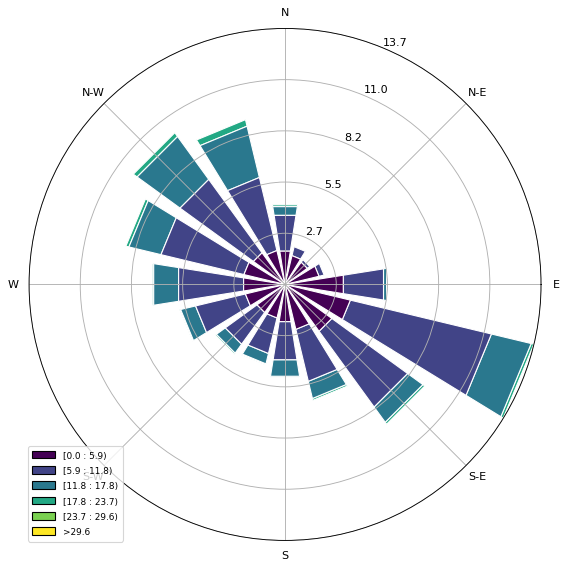

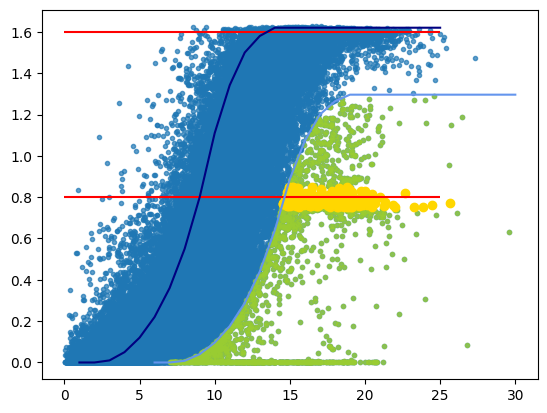

               Production Index  Time
DateTimeIndex                        
2013-03-31             1.135397     0
2013-04-30             0.893691     1
2013-05-31             0.940355     2
2013-06-30             0.862338     3
2013-07-31             0.746046     4
...                         ...   ...
2023-08-31             0.639864   125
2023-09-30             0.849363   126
2023-10-31             0.797750   127
2023-11-30             0.777120   128
2023-12-31             0.708795   129

[130 rows x 2 columns]


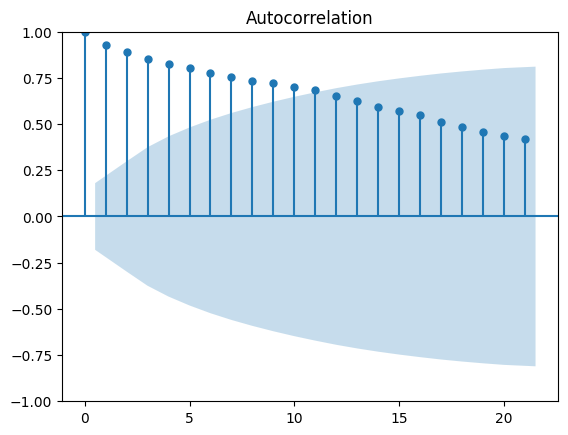

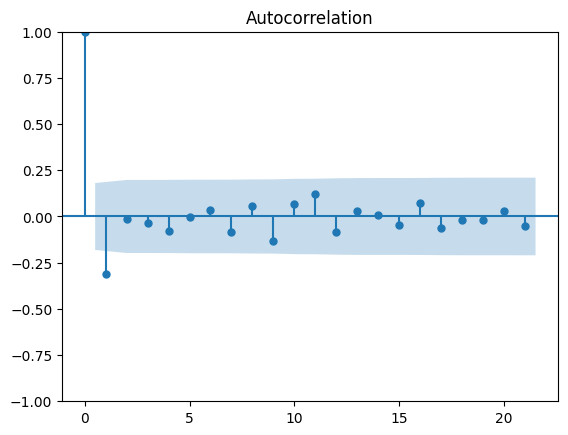

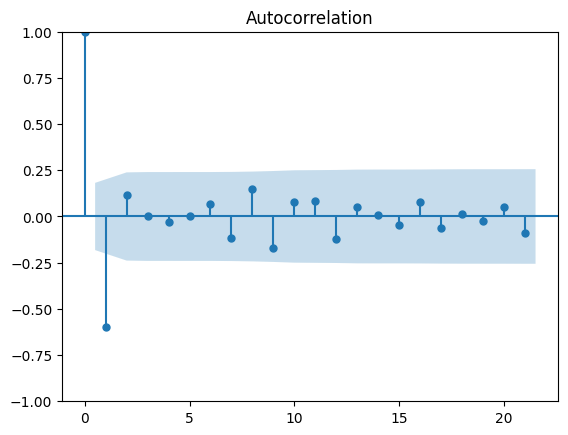

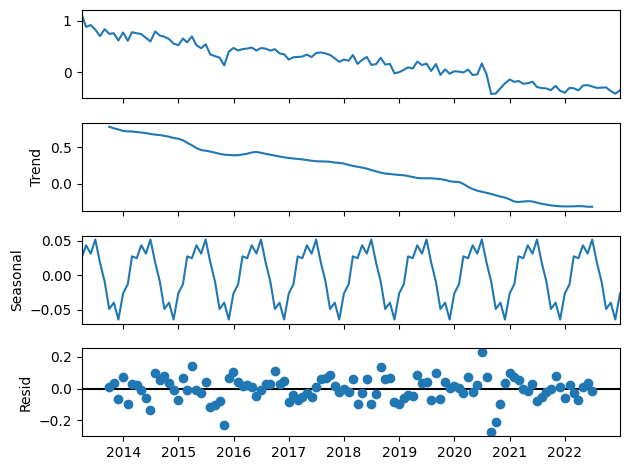

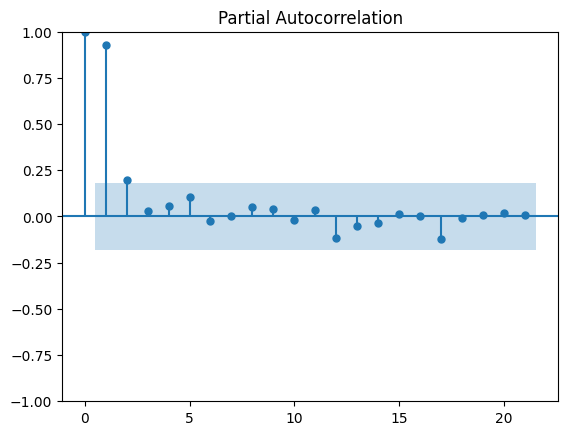

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.83 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-110.718, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-152.692, Time=0.98 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-169.711, Time=1.06 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-112.718, Time=0.13 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-126.358, Time=0.23 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=-170.735, Time=1.86 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-146.950, Time=1.34 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=-170.598, Time=4.08 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=5.71 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=3.00 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-156.797, Time=1.78 sec
 ARIMA(0,0,1)(2,1,2)[12] intercept   : AIC=inf, Time=4.15 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=2.15 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-

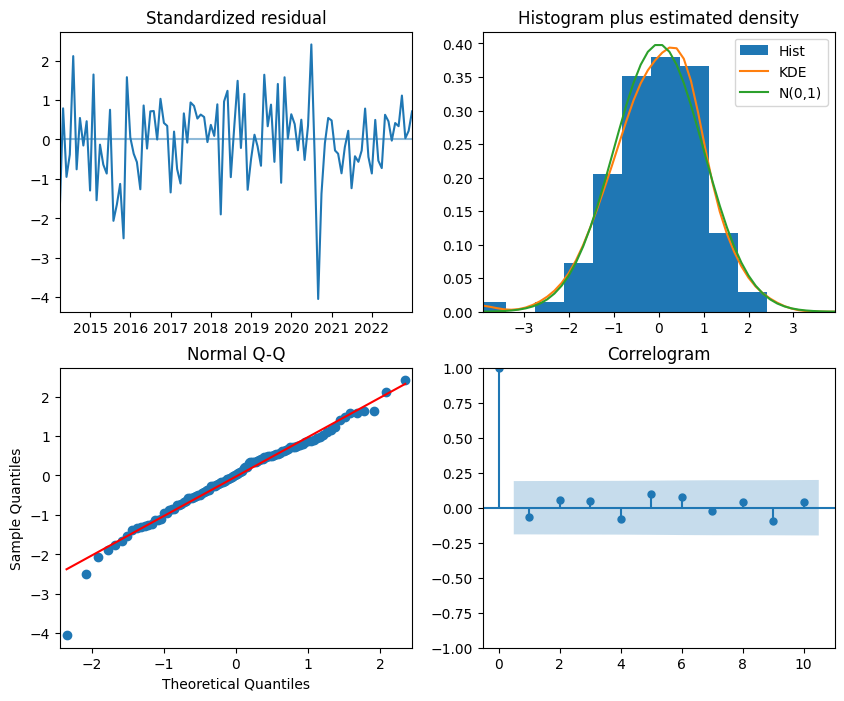

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  118
Model:             SARIMAX(1, 0, 0)x(2, 1, [1], 12)   Log Likelihood                  94.911
Date:                              Sat, 11 May 2024   AIC                           -175.822
Time:                                      08:32:26   BIC                           -157.178
Sample:                                  03-31-2013   HQIC                          -168.265
                                       - 12-31-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.1193      0.001    199.936      0.000       0.118       0.121
Time          -0.01

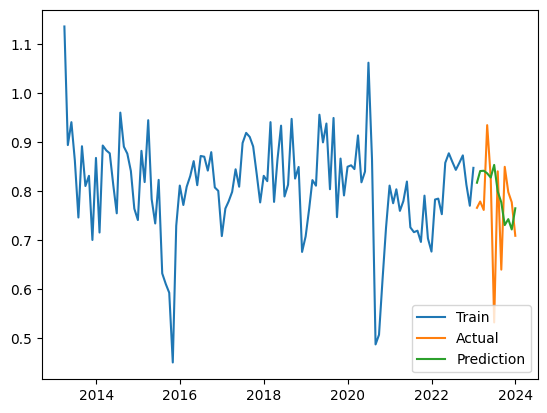

[0.00474351] [[-0.00529547]] [[0.00419155]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3565308233064363

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00474351] [[-0.00529547]] [[0.00419155]]
Mean of Residuals 0.012429822152359245
Mean of Residuals 0.012429822152359245


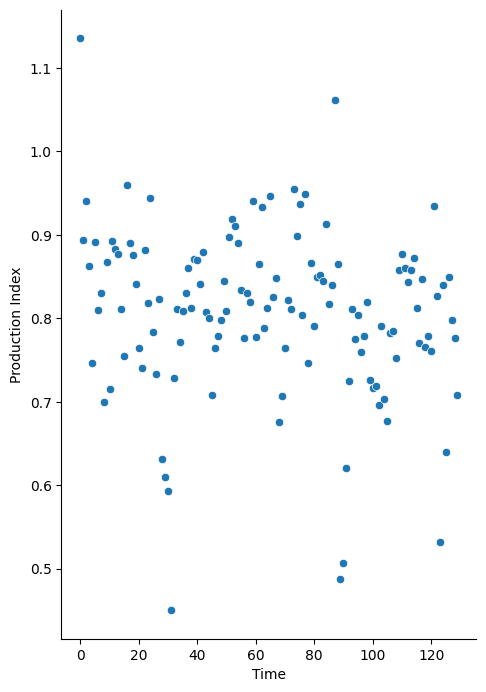

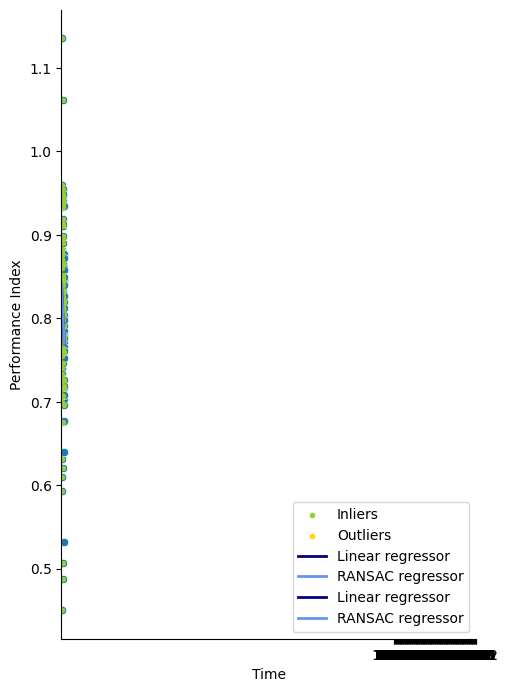

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.09811196] [[-3.11419801]] [[3.0820259]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -216.65287715604686

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.09811196] [[-3.11419801]] [[3.0820259]]
[1.45056544] [[-1.45133445]] [[1.44979642]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -250.04715643760795

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.50900421] [[-1.50977323]] [[1.5082352]]
[3.14043955] [[-3.15117384]] [[3.12970526]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -107.0533903041706

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.14043955] [[-3.15117384]] [[3.12970526]]
[1.7156813] [[-1.69863081]] [[1.73273178]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -40.01245364568273

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.7156813] [[-1.69863081]] [[1.73273178]]
[5.63330301] [[-5.60585369]] [[5.66075232]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -91.37194589318878

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.63330301] [[-5.60585369]] [[5.66075232]]
[3.65627858] [[-3.65750897]] [[3.6550482]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.2116594081359215

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.65627858] [[-3.65750897]] [[3.6550482]]
[2.36638732] [[-2.39187519]] [[2.34089944]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -103.8585731621126

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.36638732] [[-2.39187519]] [[2.34089944]]
[1.47595403] [[-1.46882001]] [[1.48308806]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.99970511665293

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47595403] [[-1.46882001]] [[1.48308806]]
[2.20007356] [[-2.18791608]] [[2.21223103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.090374328899497

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.20007356] [[-2.18791608]] [[2.21223103]]
[3.57136073] [[-3.57056507]] [[3.57215638]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.298670266313374

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.57136073] [[-3.57056507]] [[3.57215638]]
[0.30691603] [[-0.28692243]] [[0.32690963]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -17.991041552112844

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[0.30691603] [[-0.28692243]] [[0.32690963]]
[3.26826455] [[-3.25051773]] [[3.28601137]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.420428741052324

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.26826455] [[-3.25051773]] [[3.28601137]]
[3.40000554] [[-3.42059045]] [[3.37942064]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -282.29634086055466

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.40000554] [[-3.42059045]] [[3.37942064]]
[2.22314498] [[-2.23902631]] [[2.20726364]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33456.07549204033

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.22314498] [[-2.23902631]] [[2.20726364]]
[1.68785456] [[-1.71098941]] [[1.66471971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.689810573632727

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.68785456] [[-1.71098941]] [[1.66471971]]
[0.88180561] [[-0.86553228]] [[0.89807893]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6448838183675296

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.88180561] [[-0.86553228]] [[0.89807893]]
[2.65355676] [[-2.66463704]] [[2.64247647]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -796.0990147738031

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.65355676] [[-2.66463704]] [[2.64247647]]
[1.96055053] [[-1.96186657]] [[1.95923449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6289639075879385

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96055053] [[-1.96186657]] [[1.95923449]]
[2.78119654] [[-2.79030558]] [[2.7720875]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0845876769916947

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.78119654] [[-2.79030558]] [[2.7720875]]
[3.87668681] [[-3.85884367]] [[3.89452995]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.87668681] [[-3.85884367]] [[3.89452995]]
[3.48717644] [[-3.46865233]] [[3.50570054]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.259893659791176

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.48717644] [[-3.46865233]] [[3.50570054]]
[5.06761525] [[-5.03498707]] [[5.10024344]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -87.65800195629764

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.06761525] [[-5.03498707]] [[5.10024344]]
[0.70679137] [[-0.72197461]] [[0.69160813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.861273332724676

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.70679137] [[-0.72197461]] [[0.69160813]]
[0.57552506] [[-0.57345588]] [[0.57759424]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.849408445148647

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.57552506] [[-0.57345588]] [[0.57759424]]
[1.5696888] [[-1.58516852]] [[1.55420908]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.1668304714881925

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11551889] [[-2.13099861]] [[2.10003916]]
[4.58977623] [[-4.57027697]] [[4.60927549]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.685887799577813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.58977623] [[-4.57027697]] [[4.60927549]]
[1.31320692] [[-1.3190399]] [[1.30737394]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3662043756213637

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.31320692] [[-1.3190399]] [[1.30737394]]
[0.62853924] [[-0.62367951]] [[0.63339896]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.614243810479499

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.62853924] [[-0.62367951]] [[0.63339896]]
[13.30966491] [[-13.30086556]] [[13.31846427]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.575017560340351

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.30966491] [[-13.30086556]] [[13.31846427]]
[4.13433312] [[-4.18966088]] [[4.07900536]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20.34664744181118

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.13433312] [[-4.18966088]] [[4.07900536]]
[1.1437089] [[-1.11702551]] [[1.17039229]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.763194836308905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.1437089] [[-1.11702551]] [[1.17039229]]
[2.62868223] [[-2.65331227]] [[2.60405219]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -70.51492608112713

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.62868223] [[-2.65331227]] [[2.60405219]]
[5.62487603] [[-5.61055652]] [[5.63919554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.276070740874202

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.67050827] [[-4.65618876]] [[4.68482778]]
[0.84848249] [[-0.86241339]] [[0.83455158]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -23.56434508416352

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84848249] [[-0.86241339]] [[0.83455158]]
[1.20934088] [[-1.23014168]] [[1.18854008]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -48.410271623741174

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.20934088] [[-1.23014168]] [[1.18854008]]
[2.285747] [[-2.27902314]] [[2.29247086]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -78.12625239556435

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.285747] [[-2.27902314]] [[2.29247086]]
[2.45316833] [[-2.46792644]] [[2.43841022]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5636152683422

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.45316833] [[-2.46792644]] [[2.43841022]]
[2.07377269] [[-2.06990585]] [[2.07763953]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -22.81333589624813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.07377269] [[-2.06990585]] [[2.07763953]]
[1.92870096] [[-1.94759677]] [[1.90980516]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.014183748833062

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.92870096] [[-1.94759677]] [[1.90980516]]
[1.54347037] [[-1.55263041]] [[1.53431033]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.392263329768769

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.54347037] [[-1.55263041]] [[1.53431033]]
[3.77220504] [[-3.80257299]] [[3.74183709]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9764466529427014

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.93248707] [[-3.96285502]] [[3.90211912]]
[5.86794435] [[-5.84471484]] [[5.89117386]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.77753612276838

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.12849695] [[-5.10526744]] [[5.15172646]]
[2.26204198] [[-2.26272047]] [[2.2613635]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.43283972350956

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.26204198] [[-2.26272047]] [[2.2613635]]
               Production Index  Time
DateTimeIndex                        
2013-03-31             1.135682     0
2013-04-30             0.914907     1
2013-05-31             0.940564     2
2013-06-30             0.862338     3
2013-07-31             0.746046     4
...                         ...   ...
2023-08-31             0.647512   125
2023-09-30             0.881034   126
2023-10-31             0.803676   127
2023-11-30             0.788554   128
2023-12-31             0.714009   129

[130 rows x 2 columns]


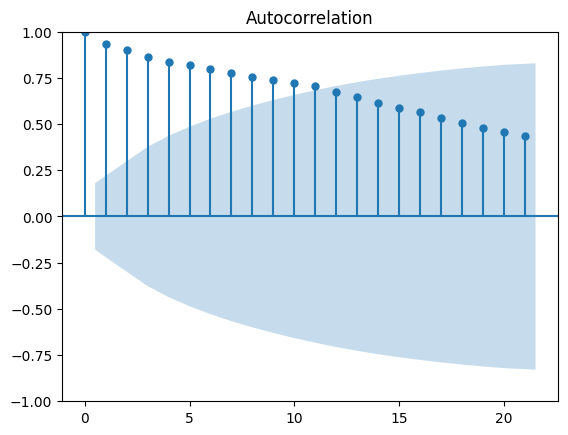

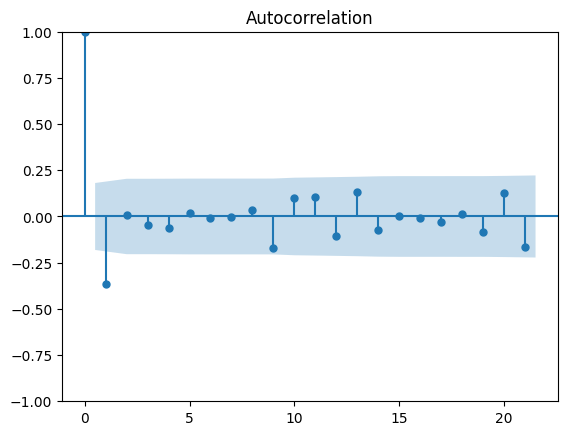

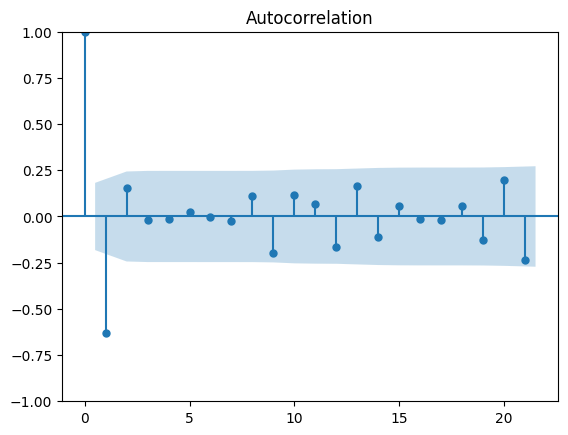

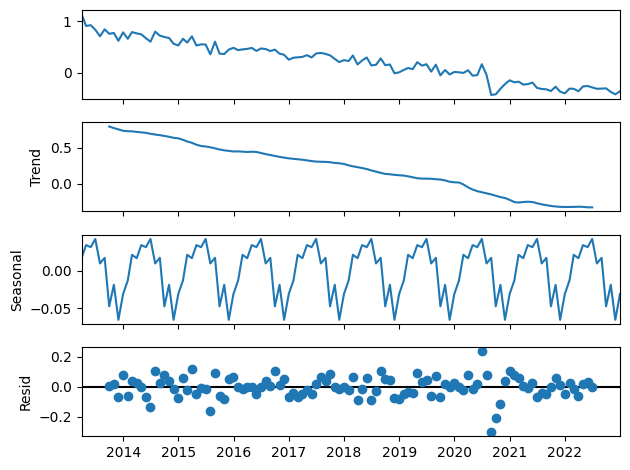

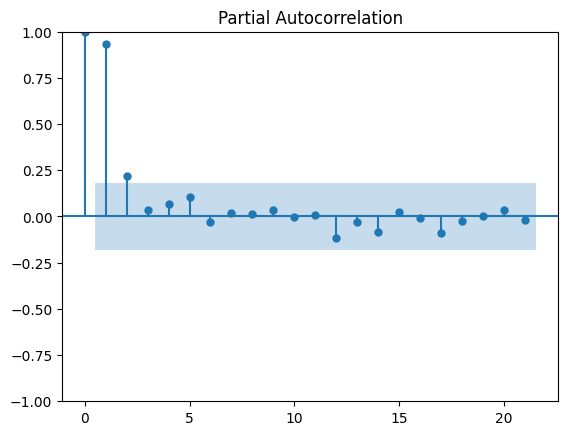

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-190.403, Time=2.34 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-140.138, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-168.865, Time=1.50 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.10 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-142.138, Time=0.22 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-144.329, Time=0.81 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-189.350, Time=1.71 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=2.28 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-167.447, Time=1.85 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=3.37 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-191.119, Time=0.95 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-144.935, Time=0.48 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-191.251, Time=2.44 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-190.749, Time=3.55 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept

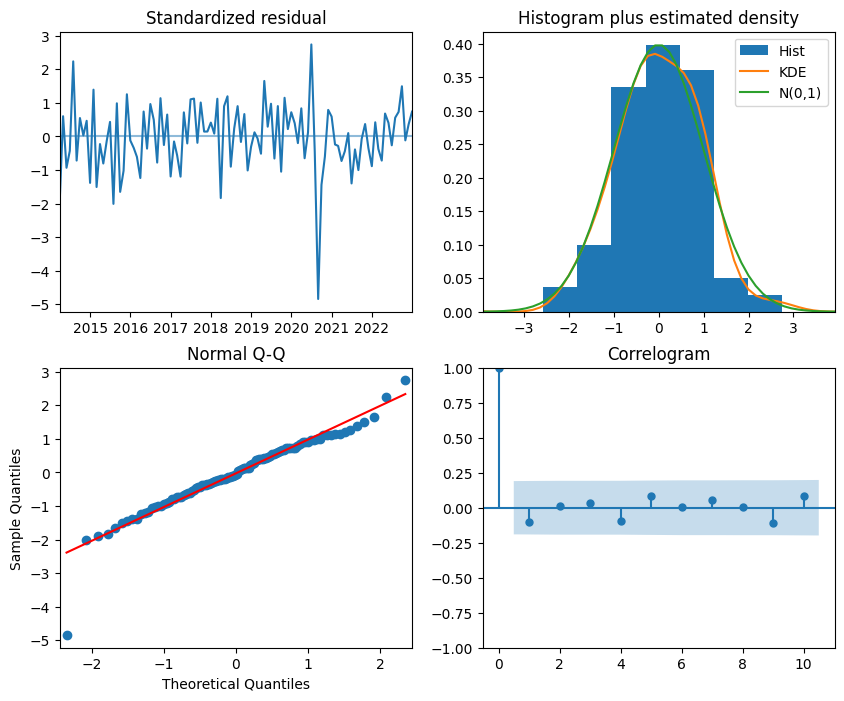

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  118
Model:             SARIMAX(1, 0, 0)x(1, 1, [1], 12)   Log Likelihood                 101.625
Date:                              Sat, 11 May 2024   AIC                           -191.251
Time:                                      08:33:35   BIC                           -175.270
Sample:                                  03-31-2013   HQIC                          -184.774
                                       - 12-31-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2083      0.001    311.104      0.000       0.207       0.210
Time          -0.02

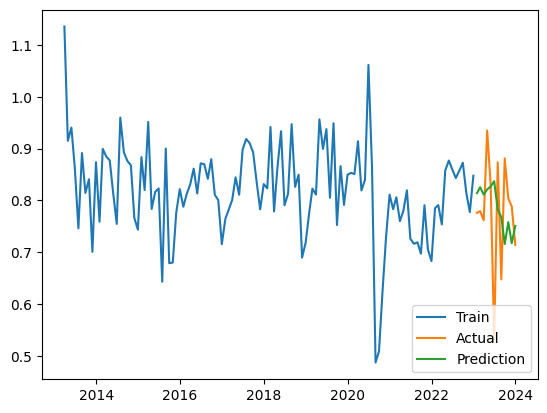

[0.00490288] [[-0.00567254]] [[0.00413323]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.24945985695743875

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00490288] [[-0.00567254]] [[0.00413323]]
Mean of Residuals 0.02177814222134957
Mean of Residuals 0.02177814222134957


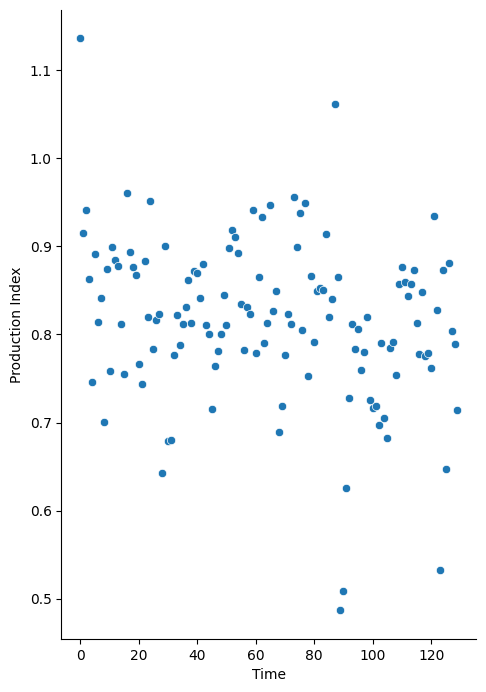

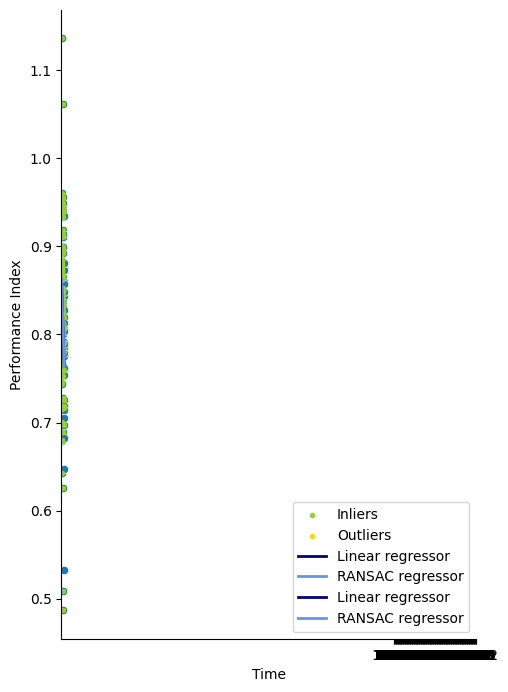

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.15269065] [[-3.17026178]] [[3.13511952]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.6660763476549034

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.15269065] [[-3.17026178]] [[3.13511952]]
[1.72224891] [[-1.72301676]] [[1.72148106]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -244.29993399242275

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.77176348] [[-1.77253133]] [[1.77099563]]
[3.19534267] [[-3.20640156]] [[3.18428378]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -126.99752319476791

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.19534267] [[-3.20640156]] [[3.18428378]]
[1.72479018] [[-1.71194965]] [[1.73763072]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.71294478638317

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.72479018] [[-1.71194965]] [[1.73763072]]
[5.63114615] [[-5.60372416]] [[5.65856814]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -91.41421109992372

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.63114615] [[-5.60372416]] [[5.65856814]]
[3.68008943] [[-3.68114174]] [[3.67903713]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.485821846353536

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.68008943] [[-3.68114174]] [[3.67903713]]
[2.65596046] [[-2.68510574]] [[2.62681518]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -89.43332517018605

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.65596046] [[-2.68510574]] [[2.62681518]]
[1.47049594] [[-1.46328457]] [[1.4777073]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.599961112003347

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47049594] [[-1.46328457]] [[1.4777073]]
[3.13625598] [[-3.12089637]] [[3.15161558]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -131.1768911513482

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13625598] [[-3.12089637]] [[3.15161558]]
[4.24488208] [[-4.22192625]] [[4.26783792]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -55.661405633660685

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.24488208] [[-4.22192625]] [[4.26783792]]
[0.33051365] [[-0.32059765]] [[0.34042966]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -63.26215549796601

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.33051365] [[-0.32059765]] [[0.34042966]]
[3.13394166] [[-3.11885229]] [[3.14903103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -125.32595503453315

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13394166] [[-3.11885229]] [[3.14903103]]
[3.39713217] [[-3.41770851]] [[3.37655583]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -282.5610482679891

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.39713217] [[-3.41770851]] [[3.37655583]]
[2.22235981] [[-2.23822787]] [[2.20649175]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33420.59919739976

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.22235981] [[-2.23822787]] [[2.20649175]]
[1.70833348] [[-1.73183892]] [[1.68482803]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.1705561459217

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.70833348] [[-1.73183892]] [[1.68482803]]
[0.90605898] [[-0.88924966]] [[0.92286831]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0353595847270225

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.90605898] [[-0.88924966]] [[0.92286831]]
[2.63152486] [[-2.64249331]] [[2.62055641]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -771.8418907155088

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.63152486] [[-2.64249331]] [[2.62055641]]
[1.96055053] [[-1.96186657]] [[1.95923449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6289639075879385

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96055053] [[-1.96186657]] [[1.95923449]]
[2.71620364] [[-2.72479538]] [[2.70761191]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.8166924067501984

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.71620364] [[-2.72479538]] [[2.70761191]]
[3.86843356] [[-3.85077525]] [[3.88609187]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.86843356] [[-3.85077525]] [[3.88609187]]
[3.48629256] [[-3.4677645]] [[3.50482062]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.2512020557198156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.48629256] [[-3.4677645]] [[3.50482062]]
[5.03612972] [[-5.00375332]] [[5.06850611]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -89.42490570162946

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.03612972] [[-5.00375332]] [[5.06850611]]
[0.56165128] [[-0.57527314]] [[0.54802941]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.831314871868311

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.56165128] [[-0.57527314]] [[0.54802941]]
[0.58128437] [[-0.58084319]] [[0.58172554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -42.61051648737241

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.58128437] [[-0.58084319]] [[0.58172554]]
[1.56951621] [[-1.5850073]] [[1.55402511]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.2005847418064817

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11375543] [[-2.12924652]] [[2.09826434]]
[4.53675765] [[-4.51710065]] [[4.55641464]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.654904245259996

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.53675765] [[-4.51710065]] [[4.55641464]]
[1.3103358] [[-1.31614584]] [[1.30452576]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3629908426382106

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.3103358] [[-1.31614584]] [[1.30452576]]
[0.50593299] [[-0.50021005]] [[0.51165594]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -39.56804262652251

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.50593299] [[-0.50021005]] [[0.51165594]]
[13.30467188] [[-13.29595421]] [[13.31338955]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -510.4467640589355

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.30467188] [[-13.29595421]] [[13.31338955]]
[4.08601652] [[-4.14101814]] [[4.0310149]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.514574234548085

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.08601652] [[-4.14101814]] [[4.0310149]]
[1.15857939] [[-1.13160672]] [[1.18555205]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20.929868458414536

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.15857939] [[-1.13160672]] [[1.18555205]]
[2.63342336] [[-2.65831251]] [[2.60853421]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -66.90819704348901

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.63342336] [[-2.65831251]] [[2.60853421]]
[5.62427264] [[-5.60997382]] [[5.63857147]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.26139261309958745

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.6700047] [[-4.65570587]] [[4.68430352]]
[0.86829255] [[-0.88222346]] [[0.85436165]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -23.56434508416352

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.86829255] [[-0.88222346]] [[0.85436165]]
[1.29909066] [[-1.31963315]] [[1.27854817]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -98.43810010792365

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.29909066] [[-1.31963315]] [[1.27854817]]
[2.32436976] [[-2.3174857]] [[2.33125382]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -67.09702373205789

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.32436976] [[-2.3174857]] [[2.33125382]]
[2.45384382] [[-2.46861645]] [[2.4390712]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5974960919388828

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.45384382] [[-2.46861645]] [[2.4390712]]
[2.07290266] [[-2.06903582]] [[2.0767695]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -22.81333589624813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.07290266] [[-2.06903582]] [[2.0767695]]
[1.83471369] [[-1.8529443]] [[1.81648308]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -14.922007834148626

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.83471369] [[-1.8529443]] [[1.81648308]]
[1.58842646] [[-1.59889486]] [[1.57795806]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.3494356265201715

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58842646] [[-1.59889486]] [[1.57795806]]
[3.77563512] [[-3.80603579]] [[3.74523444]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8239116562008744

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.93593728] [[-3.96633795]] [[3.90553661]]
[4.80872099] [[-4.78842435]] [[4.82901764]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.786419136311028

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.36001278] [[-4.33971613]] [[4.38030943]]
[2.25215929] [[-2.25293552]] [[2.25138305]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.816254676637891

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.25215929] [[-2.25293552]] [[2.25138305]]
               Production Index  Time
DateTimeIndex                        
2014-03-31             0.882780     0
2014-04-30             0.876866     1
2014-05-31             0.811790     2
2014-06-30             0.754591     3
2014-07-31             0.959822     4
2014-08-31             0.890352     5
2014-09-30             0.876279     6
2014-10-31             0.840798     7
2014-11-30             0.764096     8
2014-12-31             0.740847     9
2015-01-31             0.881922    10
2015-02-28             0.818263    11
2015-03-31             0.944409    12
2015-04-30             0.7

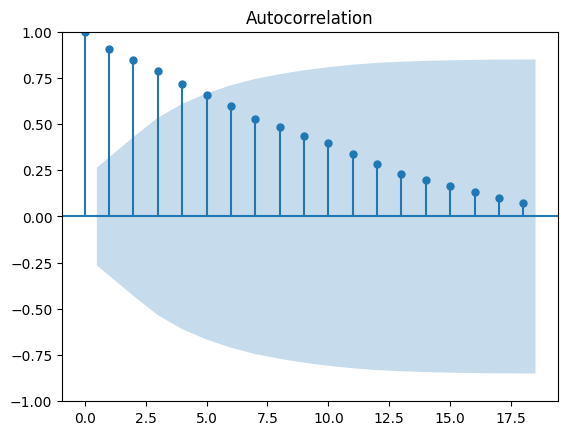

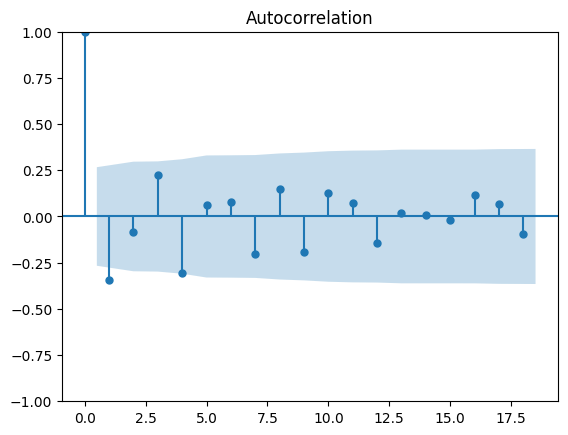

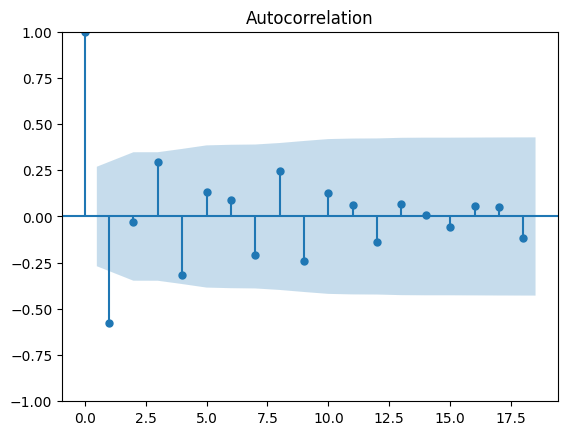

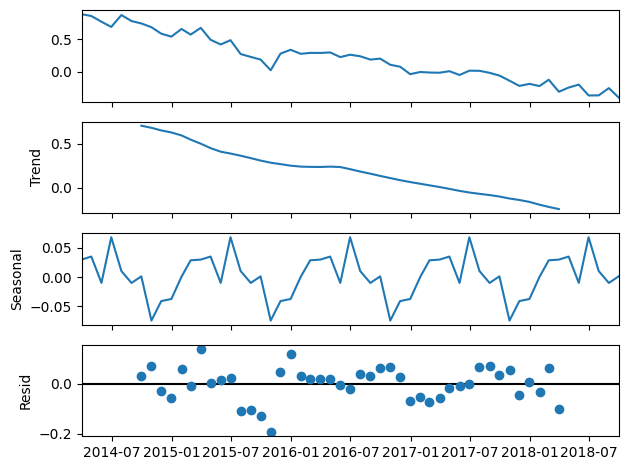

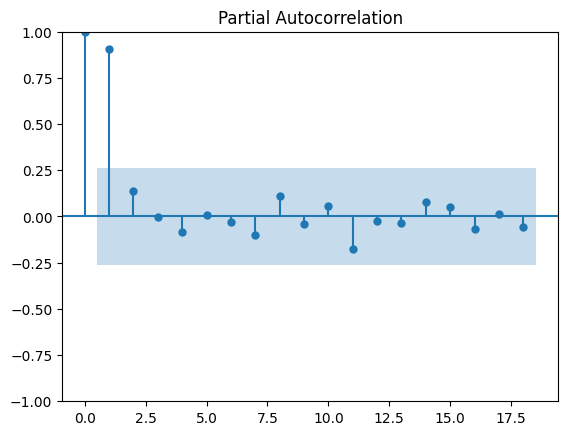

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.55 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-37.137, Time=0.07 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-61.396, Time=0.41 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.97 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-39.137, Time=0.08 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-51.815, Time=0.17 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-61.312, Time=1.54 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-62.049, Time=1.14 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.51 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-59.648, Time=2.13 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=3.04 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=1.17 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=-57.991, Time=2.93 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.10 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=-61.093, Time=

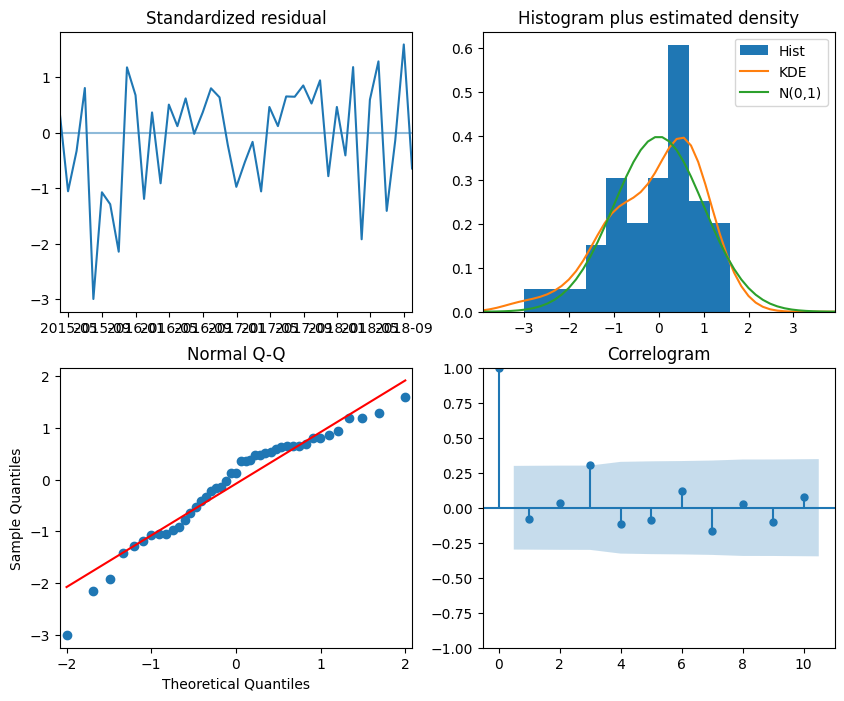

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(1, 1, [1], 12)   Log Likelihood                  37.039
Date:                              Sat, 11 May 2024   AIC                            -64.079
Time:                                      08:34:29   BIC                            -55.273
Sample:                                  03-31-2014   HQIC                           -60.831
                                       - 09-30-2018                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0010      0.001      0.791      0.429      -0.001       0.004
ar.L1          0.47

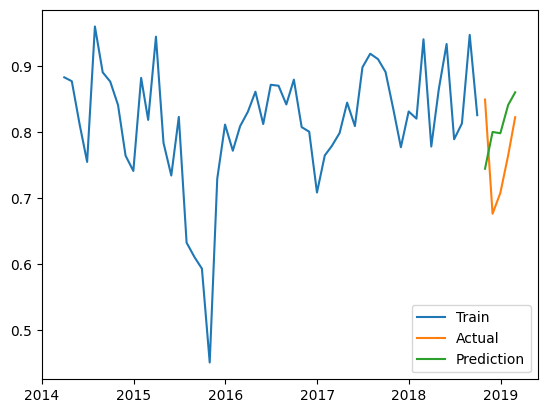

[0.0163741] [[-0.01560203]] [[0.01714616]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5194272701185765

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.0163741] [[-0.01560203]] [[0.01714616]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

Mean of Residuals -0.01917272073001126
Mean of Residuals -0.01917272073001126


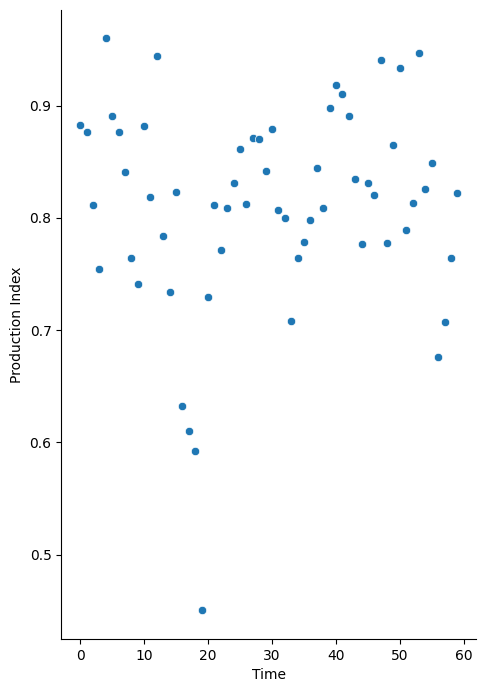

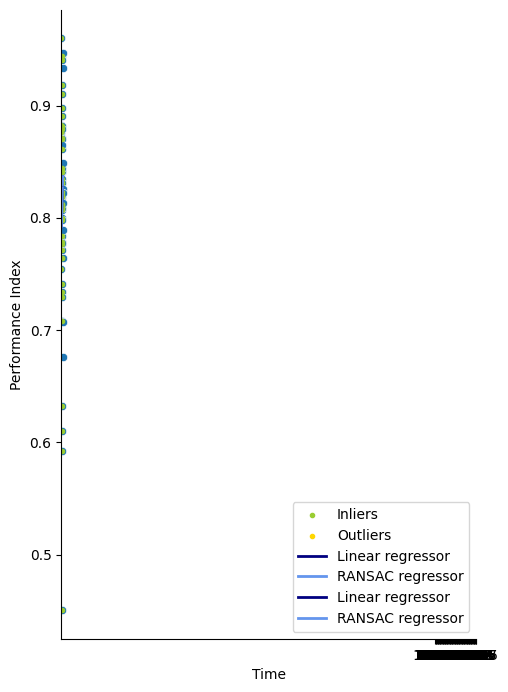

                       Åsen II
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2023-12-28 04:00:00  16.366346
2023-12-31 16:00:00  18.222593
2023-12-31 21:00:00  18.708921
2023-12-31 22:00:00  18.576893
2023-12-31 23:00:00  18.256630

[193552 rows x 1 columns]


<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

In [38]:
#Running one wind farm
def run_one_windfarm(selected_windfarm, power_curve = None, regression_curve = None):

  #Choose the windfarm we want to analyze
  Vindpark_navn = selected_windfarm
  file_wind_farm = chosen_windfarm[Vindpark_navn]
  Vindpark= portfolio[Vindpark_navn]
  Vindpark_start_dato = Vindpark["Idriftsatt"]


  #Combine all the data into one file
  combine_nc_dataset(file_wind_farm)

  #Opening weather file
  ds = xr.open_dataset(file_wind_farm +'_combined.nc')

  #Import production data
  if Vindpark_navn == 'Sandøy':
    production_data = pd.read_csv('nve_prod_chosen.csv')
    production_data.set_index('time',inplace=True)
  else:
    production_data = pd.read_csv('nve_prod_chosen_2023.csv')
    production_data.set_index('time',inplace=True)


  #Creating columns from imported weather data
  u10 = construct_columns('u100',ds)
  v10 = construct_columns('v100',ds)
  fg10 = construct_columns('i10fg',ds)
  t2m = construct_columns('t2m', ds)
  fsr = construct_columns('fsr',ds)
  sp = construct_columns('sp',ds)

  columns = [u10,v10,fg10,t2m, fsr, sp]

  #Creating distance dataframe
  df_distance = get_df_distance(ds, Vindpark_navn)

  #Creating direction
  direction = create_wind_direction_df(v10, u10)

  #Finding first production hour and the same hour one year later. The latter is the selected startpoint
  _ , one_year = first_valid_hour(production_data[Vindpark_navn])
  direction = direction[one_year:]
  #Create weather dataframe

  #Constructing weatherdata dataframe
  weather_data = construct_weather_data(u10, v10,t2m, sp,fsr)

  #Selecting productiondata for one wind farm
  energy_prod = production_data[[Vindpark_navn]]

  #Creating a dataframe with valid productionhours
  start_hour, one_year = first_valid_hour(energy_prod)

  #Selecting relevant parts of the data
  valid_energy_prod = energy_prod[one_year:]
  valid_energy_prod.index = pd.to_datetime(valid_energy_prod.index)

  fg10.rename({'value': 'fg10'}, axis=1, inplace=True)

  #Creating a common dataframe with weather and producction data among otther data
  valid_weather_data = weather_data[one_year:]
  wind=pd.DataFrame()
  wind=pd.concat([valid_weather_data,valid_energy_prod, direction, fg10], axis=1)
  wind.dropna(inplace=True)

  #Creating a windrose showing wind direction
  create_windrose(wind)

  #Calculating cumulative maximum effect
  df_cumulative_effect =  cumulative_effect_wind_farm(Vindpark)

  #Finding rows considered downtime
  df_weather_downtime = wind[['wind_speed', Vindpark_navn]]
  df_downtime_zero_production = downtime(df_weather_downtime, Vindpark_navn)

  #Making a dataframe suitable to windpowerlib
  df_weather_windpowerlib = construct_weather_windpowerlib(valid_weather_data)
  print(df_weather_windpowerlib)

  #remove zero entries
  df_weather_windpowerlib_without_zero_downtime = remove_downtime_points(df_weather_windpowerlib, df_downtime_zero_production)
  df_valid_prod_without_zero_downtime = remove_downtime_points(valid_energy_prod, df_downtime_zero_production)

  #Simulating data
  simulated_data, my_turbine = windpowerlib_simulation(Vindpark,Vindpark_navn, df_weather_windpowerlib)

  df_data_statistics = pd.DataFrame({'Observasjoner tot prod': production_data[Vindpark_navn].shape[0],
                                    'Observasjoner valid prod':valid_energy_prod.shape[0] ,
                                    'Missing values prod':valid_energy_prod.isnull().sum(),
                                    'Negative values prod':(valid_energy_prod < 0).values.sum(),
                                    'Zero values prod':(valid_energy_prod == 0).values.sum(),
                                    'Prod over capacity':(valid_energy_prod >Vindpark['Maksimal effekt']).sum(),
                                    'Observasjoner df_windpowerlib':df_weather_windpowerlib.shape[0] ,
                                    'Missing values wind_peed':df_weather_windpowerlib['wind_speed'].isnull().sum(),
                                    'Missing values temperature':df_weather_windpowerlib['temperature'].isnull().sum(),
                                     'Missing values pressure':df_weather_windpowerlib['pressure'].isnull().sum(),
                                     'Missing values roughness_length':df_weather_windpowerlib['roughness_length'].isnull().sum(),
                                    'Observasjoner sim':simulated_data.shape[0],
                                    'Zero values sim':(simulated_data == 0).values.sum()}, index = [Vindpark_navn])
  print(df_data_statistics)
  valid_energy_prod = data_cleaning(valid_energy_prod, Vindpark_navn, Vindpark)

  power_curve_wind_farm = windfarm_powercurve(my_turbine, Vindpark)
  new_power_curve = create_80_power_curve(power_curve_wind_farm)
  df_under_pc = find_points_under_powercurve(df_weather_downtime, new_power_curve, Vindpark_navn)

  #Finding downtime near cumulative effect-lines
  df_neigbours = find_neigbour_points(df_cumulative_effect,df_under_pc)

  df_downtime_neigbors = pd.DataFrame(df_neigbours[['wind_speed']])
  df_downtime_windfarm = pd.concat([pd.DataFrame(df_downtime_zero_production['wind_speed']),df_downtime_neigbors])

  df_downtime = pd.DataFrame(index=pd.to_datetime(production_data.index), columns = ['wind_speed'])
  df_downtime = pd.concat([df_downtime, pd.DataFrame(df_downtime_zero_production['wind_speed']),df_downtime_neigbors])
  df_downtime.rename(columns={"wind_speed": Vindpark_navn}, inplace=True)

  df_annual_downtime_percent = ((df_downtime.notnull().astype('int').resample('A').sum()/valid_energy_prod.resample('A').count())*100)
  print(df_annual_downtime_percent, type(df_annual_downtime_percent))
  df_weather_windpowerlib_without_downtime = remove_downtime_points(df_weather_windpowerlib_without_zero_downtime, df_neigbours)
  df_valid_prod_without_downtime = remove_downtime_points(df_valid_prod_without_zero_downtime, df_neigbours)


  simulated_data_without_downtime,_ = windpowerlib_simulation(Vindpark,Vindpark_navn, df_weather_windpowerlib_without_downtime)
  plot_production_powercurve(Vindpark_navn,df_weather_downtime,df_under_pc,df_neigbours,df_cumulative_effect,power_curve_wind_farm,new_power_curve)
  confidence_interval = pd.DataFrame()

  #Running the regression models
  df_results_lifetime,df_conf_int_life, lr_metrics_lf, ran_metrics_lf, arima_metrics_lf, lr_residuals_lf,ran_residuals_lf = methods_regression(simulated_data,valid_energy_prod,Vindpark_navn, 'Month')
  df_results_lr_season,df_results_ran_season, lr_metrics_s, ran_metrics_s = methods_regression(simulated_data,valid_energy_prod,Vindpark_navn, 'Season')
  df_results_lifetime_downtime,df_conf_int_dt,lr_metrics_lf_d, ran_metrics_lf_d,arima_metrics_d, lr_residuals_lf_d,ran_residuals_lf_d = methods_regression(simulated_data_without_downtime,df_valid_prod_without_downtime, Vindpark_navn, 'Month')

  df_results_lr_season_downtime,df_results_ran_season_downtime, lr_metrics_s_d, ran_metrics_s_d = methods_regression(simulated_data_without_downtime,df_valid_prod_without_downtime,Vindpark_navn, 'Season')

  df_results_three_years,df_conf_int_five, lr_metrics_y, ran_metrics_y,arima_metrics_y, lr_residuals_y,ran_residuals_y = methods_regression(simulated_data,valid_energy_prod,Vindpark_navn,'Month', 5)

  df_confidence_interval = pd.concat([confidence_interval,df_conf_int_life,df_conf_int_dt,df_conf_int_five], axis = 1)
  df_confidence_interval.columns = ['CI lin results', 'CI ran results', 'CI lin results wo/DT', 'CI ran results wo/DT', 'CI lin results five year', 'CI ran results five year']
  print(df_downtime)

  return df_results_lifetime ,df_results_lr_season,df_results_ran_season,df_results_lifetime_downtime,df_results_lr_season_downtime,df_results_ran_season_downtime, df_results_three_years,df_confidence_interval,df_data_statistics, df_downtime,df_annual_downtime_percent, df_distance, lr_metrics_lf, ran_metrics_lf, lr_residuals_lf,ran_residuals_lf, lr_metrics_s, ran_metrics_s, arima_metrics_lf,arima_metrics_d,arima_metrics_y

df_results_lifetime ,df_results_lr_season,df_results_ran_season,df_results_lifetime_downtime,df_results_lr_season_downtime,df_results_ran_season_downtime, df_results_three_years,df_confidence_interval,df_data_statistics, df_downtime,df_annual_downtime_percent, df_distance, lr_metrics_lf, ran_metrics_lf, lr_residuals_lf,ran_residuals_lf, lr_metrics_s, ran_metrics_s,arima_metrics_lf,arima_metrics_d,arima_metrics_y = run_one_windfarm('Åsen II')

##################Egersund###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2018-08-10 10:00:00  12.636320  287.387054  99372.750000         0.508206
2018-08-10 11:00:00  13.287251  287.839630  99601.031250         0.508229
2018-08-10 12:00:00  11.447332  287.980255  99762.960938         0.512496
2018-08-10 13:00:00   9.664333  287.958496  99823.812500         0.524151
2018-08-10 14:00:00   9.110192  288.231750  99929.273438         0.535489
...                        ...         ...           ...              ...
2023-12-31 19:00:00  22.934090  275.939362  98312.148438         0.547109
2023-12-31 20:00:00  22.563707  275.735107  98332.882812         0.546796
2023-12-31 21:00:00  22.933268  275.561066  98380.734375         0.546494
2023-12-31 22:00:00  19.309565  275.671967  98353.054688         0

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    2.531723e+06
dtype: float64
          Observasjoner tot prod  Observasjoner valid prod  \
Egersund                  192840                     47270   

          Missing values prod  Negative values prod  Zero values prod  \
Egersund                    0                     0              3544   

          Prod over capacity  Observasjoner df_windpowerlib  \
Egersund                   0                          47270   

          Missing values wind_peed  Missing values temperature  \
Egersund                       NaN                         NaN   

          Missing values pressure  Missing values roughness_length  \
Egersund                      NaN                              NaN   

          Observasjoner sim  Zero values sim  
Egersund              47270             2531  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Egersund
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31       NaN
2014-12-31       NaN
2015-12-31       NaN
2016-12-31       NaN
2017-12-31       NaN
2018-12-31  0.551364
2019-12-31  0.205479
2020-12-31  0.591985
2021-12-31  0.422374
2022-12-31  0.159817
2023-12-31  0.296804 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    2.525439e+06
dtype: float64


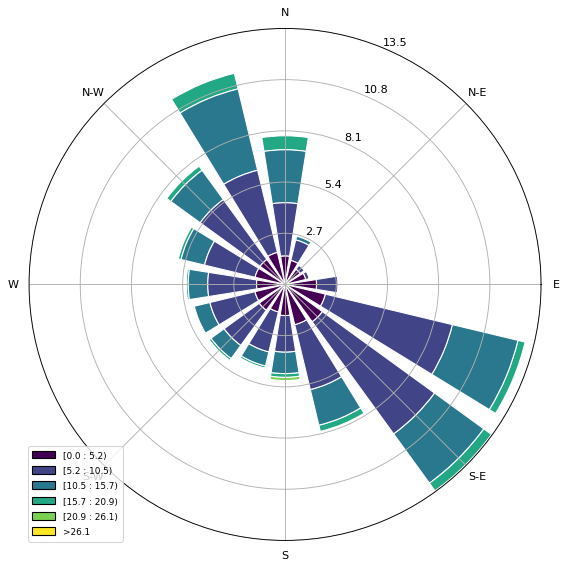

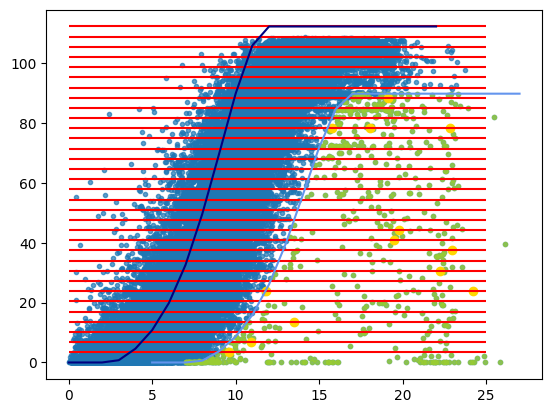

               Production Index  Time
DateTimeIndex                        
2018-08-31             0.768008     0
2018-09-30             0.776462     1
2018-10-31             0.823269     2
2018-11-30             0.832115     3
2018-12-31             0.819019     4
...                         ...   ...
2023-08-31             0.766372    60
2023-09-30             0.728565    61
2023-10-31             0.720503    62
2023-11-30             0.807665    63
2023-12-31             0.763130    64

[65 rows x 2 columns]


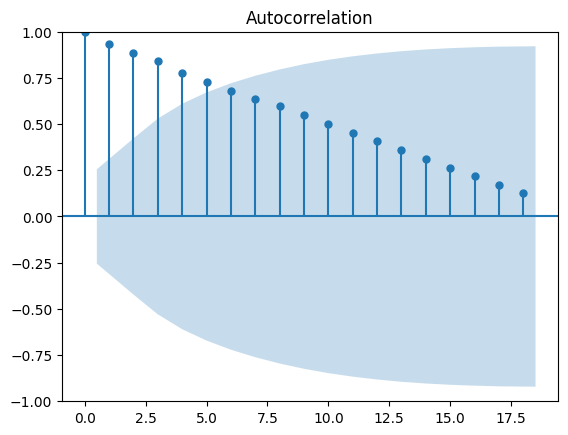

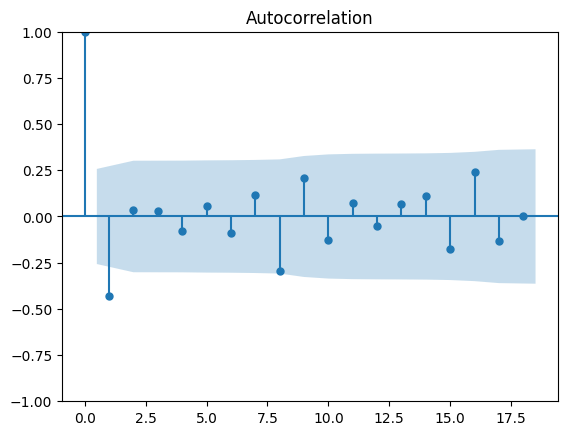

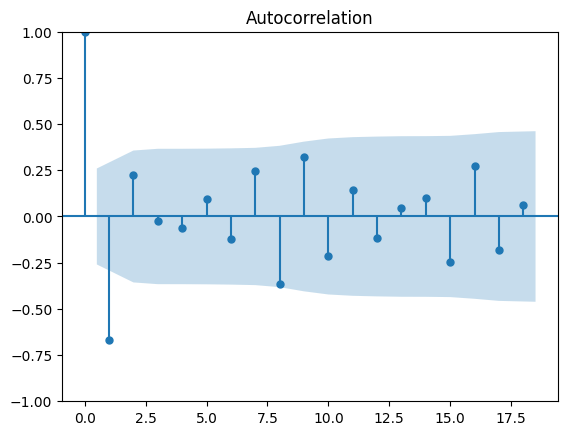

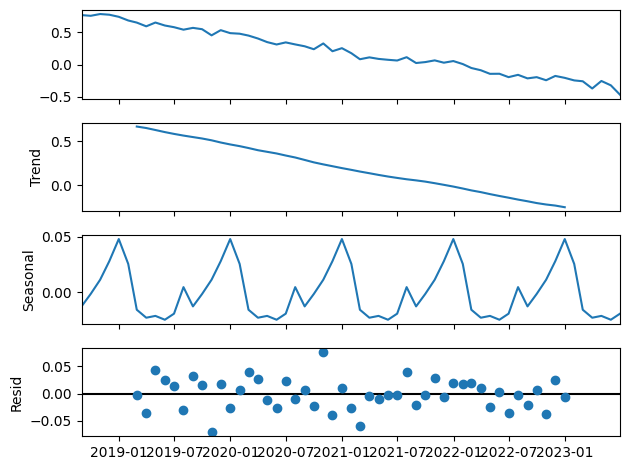

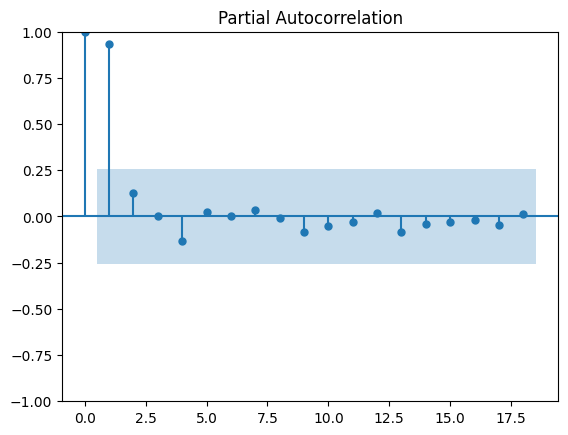

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.95 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-135.079, Time=0.06 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-138.066, Time=0.45 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.96 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-137.079, Time=0.14 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-133.231, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-141.403, Time=2.36 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-141.121, Time=1.96 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-141.221, Time=1.66 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-143.424, Time=1.55 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-140.051, Time=1.35 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-143.313, Time=2.35 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-141.208, Time=0.38 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-141.272, Time=0.85 sec
 ARIMA(1,0,1)(2,1,0)[12] inte

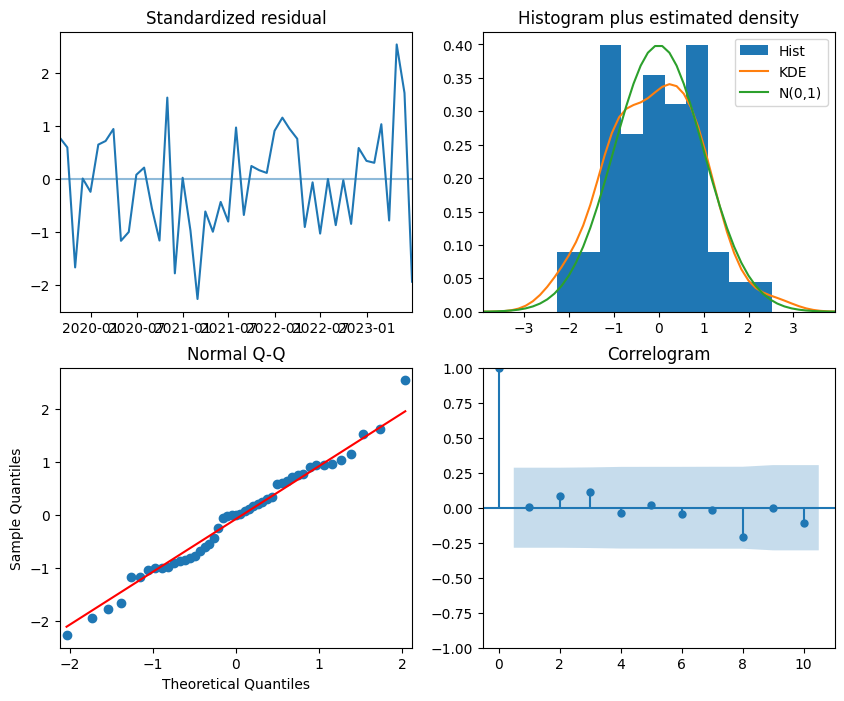

                                 SARIMAX Results                                  
Dep. Variable:                          y   No. Observations:                   59
Model:             SARIMAX(2, 1, [1], 12)   Log Likelihood                  78.224
Date:                    Sat, 11 May 2024   AIC                           -146.447
Time:                            08:35:13   BIC                           -137.197
Sample:                        08-31-2018   HQIC                          -142.966
                             - 06-30-2023                                         
Covariance Type:                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0006      0.000     -1.890      0.059      -0.001    2.29e-05
ar.S.L12      -0.1855      0.658     -0.282      0.778      -1.475       1.104
ar.S.L24      -0.302

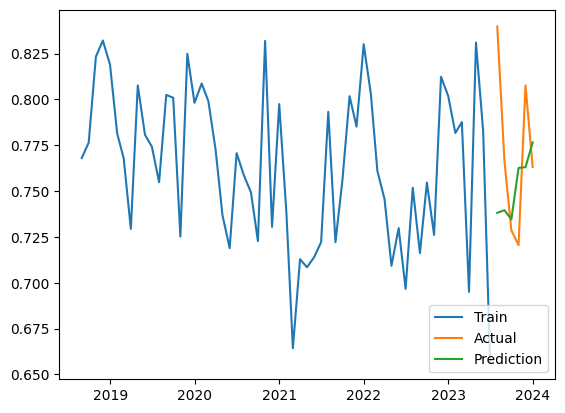

[0.01094456] [[-0.01193935]] [[0.00994977]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.10938535332517371

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.01094456] [[-0.01193935]] [[0.00994977]]
Mean of Residuals 0.034878328416779854
Mean of Residuals 0.034878328416779854


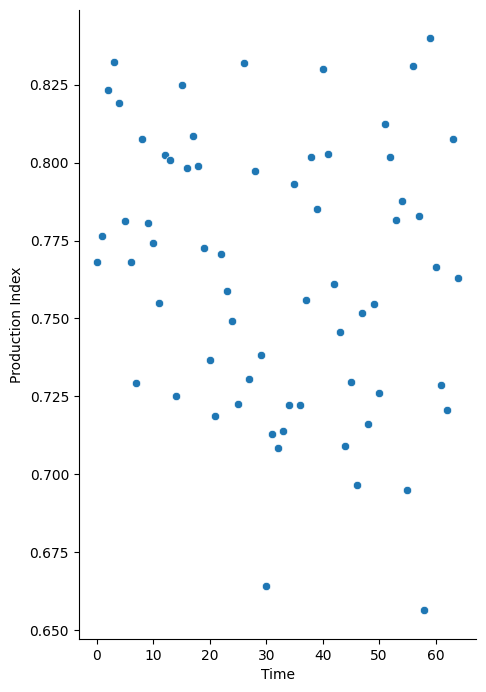

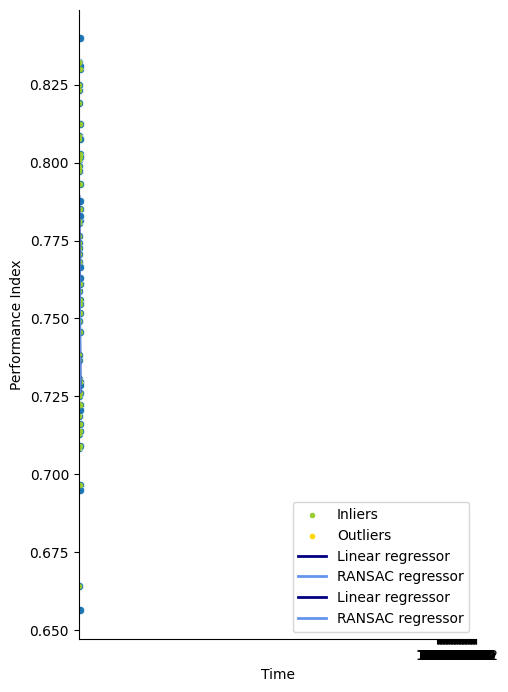

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[0.96141149] [[-0.96042451]] [[0.96239847]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3357.902123321187

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.96141149] [[-0.96042451]] [[0.96239847]]
[0.75795663] [[-0.76570053]] [[0.75021273]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.4625938554516

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.75795663] [[-0.76570053]] [[0.75021273]]
[1.42527634] [[-1.42719532]] [[1.42335735]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8654755439411433

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.42527634] [[-1.42719532]] [[1.42335735]]
[0.72467861] [[-0.72261806]] [[0.72673917]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -938.8377120502089

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.72467861] [[-0.72261806]] [[0.72673917]]
[1.46102627] [[-1.45022818]] [[1.47182436]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.250477666510506

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.46102627] [[-1.45022818]] [[1.47182436]]
[0.43468734] [[-0.43738355]] [[0.43199112]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8095454880278279

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.43468734] [[-0.43738355]] [[0.43199112]]
[2.06185117] [[-2.06846935]] [[2.055233]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.455532435413456

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.06185117] [[-2.06846935]] [[2.055233]]
[1.23152595] [[-1.23201117]] [[1.23104074]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -383.36302753541383

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.23152595] [[-1.23201117]] [[1.23104074]]
[1.09817384] [[-1.10490457]] [[1.0914431]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5076174238384827

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.09817384] [[-1.10490457]] [[1.0914431]]
[2.01264369] [[-2.03051332]] [[1.99477406]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.145812927031276

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.01264369] [[-2.03051332]] [[1.99477406]]
[2.68477586] [[-2.67233474]] [[2.69721699]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.56382365562814

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.68477586] [[-2.67233474]] [[2.69721699]]
[2.15119419] [[-2.16966199]] [[2.13272638]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -29.357574581493246

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.15119419] [[-2.16966199]] [[2.13272638]]
[1.56992663] [[-1.57712702]] [[1.56272623]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.263408753297053

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.56992663] [[-1.57712702]] [[1.56272623]]
[1.30089705] [[-1.31256489]] [[1.28922921]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.895475932282292

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.30089705] [[-1.31256489]] [[1.28922921]]
[2.1826738] [[-2.19280263]] [[2.17254496]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6493918250792522

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.1826738] [[-2.19280263]] [[2.17254496]]
[0.69167101] [[-0.69449832]] [[0.6888437]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.197455716415826

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.69167101] [[-0.69449832]] [[0.6888437]]
[1.05320835] [[-1.04741699]] [[1.05899971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.754467140508694

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05320835] [[-1.04741699]] [[1.05899971]]
[1.74776599] [[-1.74592355]] [[1.74960843]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.828099504950412

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.74776599] [[-1.74592355]] [[1.74960843]]
[2.13384656] [[-2.13808189]] [[2.12961122]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -10.429073301939297

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.13384656] [[-2.13808189]] [[2.12961122]]
[3.03088127] [[-3.03156118]] [[3.03020136]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.60442842673138

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.03088127] [[-3.03156118]] [[3.03020136]]
[1.48402959] [[-1.47565844]] [[1.49240075]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4005630626948813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.48402959] [[-1.47565844]] [[1.49240075]]
               Production Index  Time
DateTimeIndex                        
2018-08-31             0.768008     0
2018-09-30             0.785347     1
2018-10-31             0.823269     2
2018-11-30             0.835004     3
2018-12-31             0.819249     4
...                         ...   ...
2023-08-31             0.767187    60
2023-09-30             0.728565    61
2023-10-31             0.721472    62
2023-11-30             0.807665    63
2023-12-31             0.763825    64

[65 rows x 2 columns]


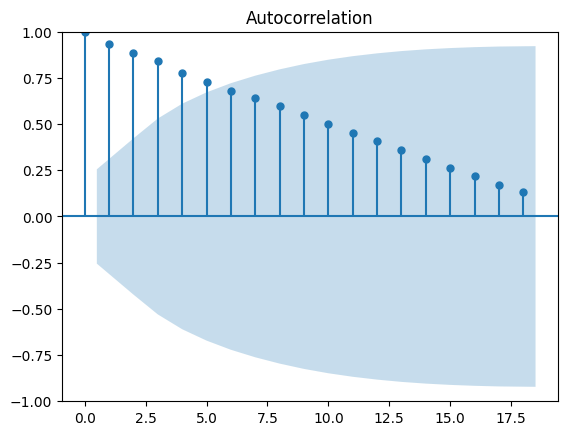

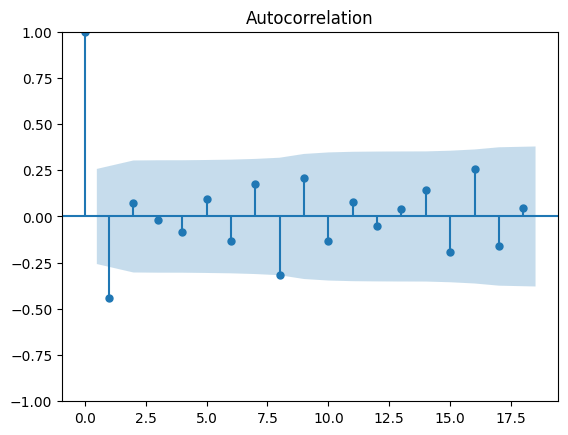

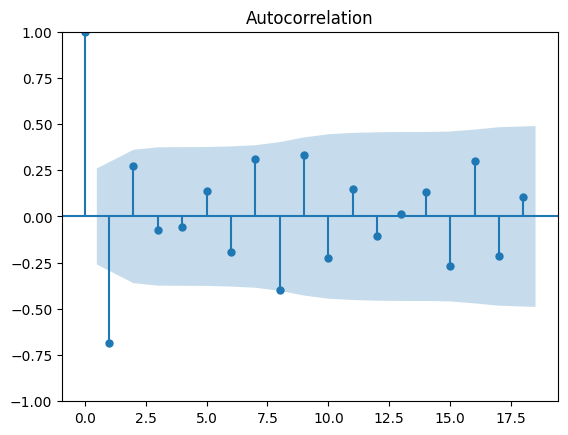

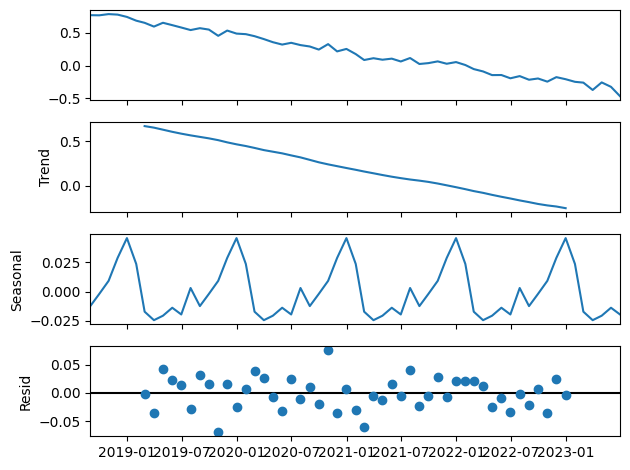

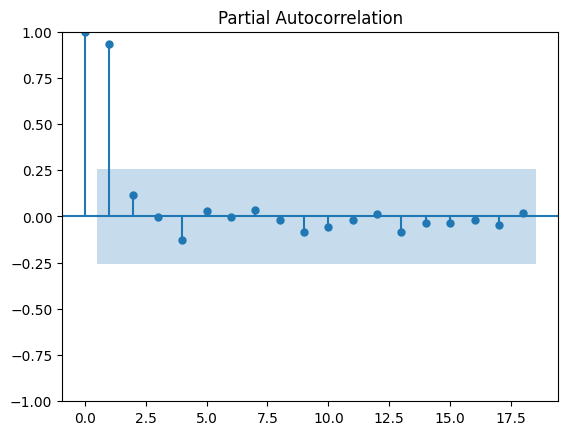

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-145.864, Time=1.78 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-137.281, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-141.101, Time=0.55 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.46 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-139.281, Time=0.14 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-133.674, Time=0.23 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-141.217, Time=0.60 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=-143.507, Time=1.52 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-139.534, Time=0.58 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-141.266, Time=1.96 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=2.52 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.24 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=-145.409, Time=1.15 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=1.00 sec
 ARIMA(0,0,2)(0,1,1)[12] intercept   : 

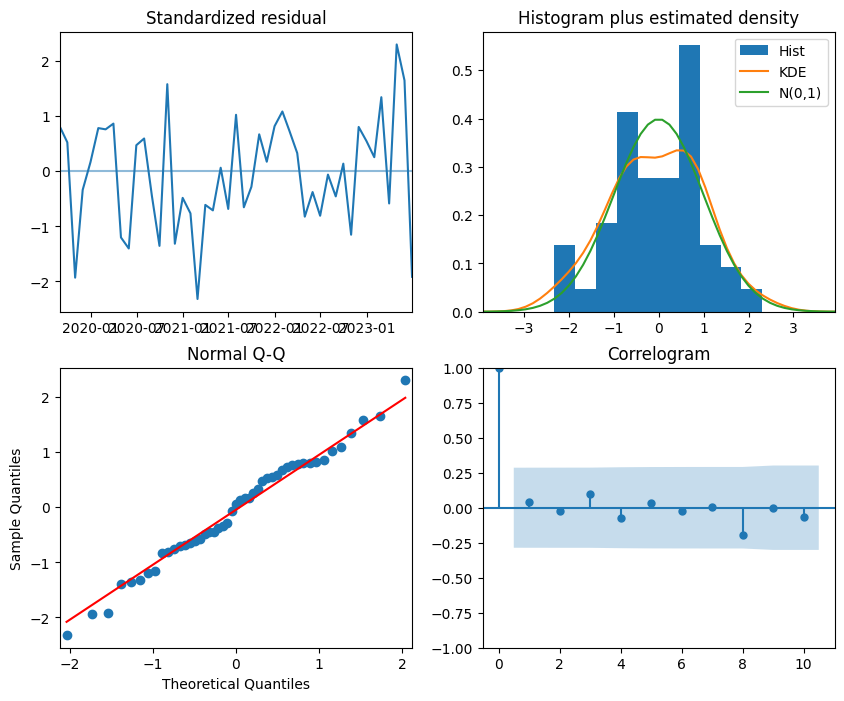

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   59
Model:             SARIMAX(0, 0, 2)x(0, 1, [1], 12)   Log Likelihood                  79.771
Date:                              Sat, 11 May 2024   AIC                           -147.543
Time:                                      08:35:52   BIC                           -136.442
Sample:                                  08-31-2018   HQIC                          -143.365
                                       - 06-30-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2482   3.01e-05   8234.582      0.000       0.248       0.248
Time          -0.02

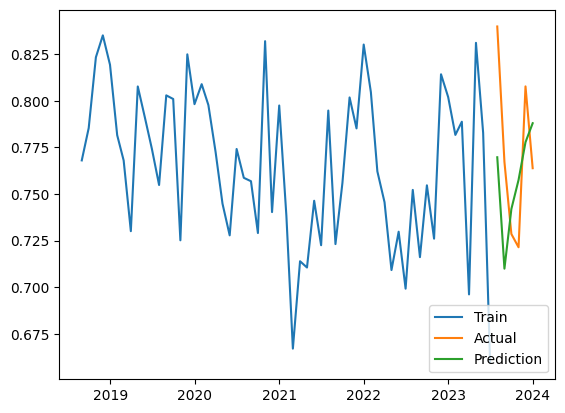

[0.01071118] [[-0.01171494]] [[0.00970742]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.12678244446807357

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.01071118] [[-0.01171494]] [[0.00970742]]
Mean of Residuals 0.03355538593686566
Mean of Residuals 0.03355538593686566


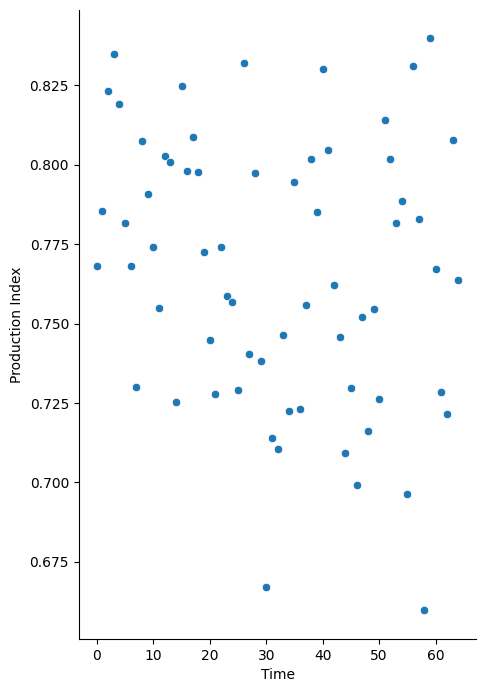

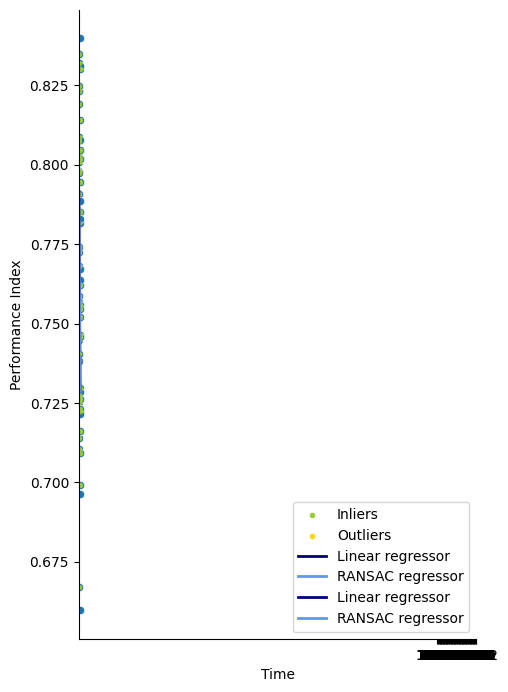

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[0.90975557] [[-0.90804351]] [[0.91146763]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2979.4811243632294

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.90975557] [[-0.90804351]] [[0.91146763]]
[0.78170486] [[-0.78944497]] [[0.77396474]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.09387565673255

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.78170486] [[-0.78944497]] [[0.77396474]]
[1.44339953] [[-1.44414473]] [[1.44265433]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7465450491921999

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.44339953] [[-1.44414473]] [[1.44265433]]
[0.72402989] [[-0.72198266]] [[0.72607712]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -944.5646205585396

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.72402989] [[-0.72198266]] [[0.72607712]]
[1.46102627] [[-1.45022818]] [[1.47182436]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.250477666510506

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.46102627] [[-1.45022818]] [[1.47182436]]
[0.45338948] [[-0.4564939]] [[0.45028507]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.729240324105331

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.45338948] [[-0.4564939]] [[0.45028507]]
[2.01778377] [[-2.02399223]] [[2.0115753]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.148170547640536

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.01778377] [[-2.02399223]] [[2.0115753]]
[1.15387933] [[-1.15366828]] [[1.15409038]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -32.57969253055664

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.15387933] [[-1.15366828]] [[1.15409038]]
[0.9965425] [[-1.00279203]] [[0.99029298]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8593446776719924

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.9965425] [[-1.00279203]] [[0.99029298]]
[1.94295638] [[-1.96039561]] [[1.92551715]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.9541820570556268

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.94295638] [[-1.96039561]] [[1.92551715]]
[3.0612355] [[-3.04713223]] [[3.07533876]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.8524985006609

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.0612355] [[-3.04713223]] [[3.07533876]]
[2.16297368] [[-2.18181865]] [[2.14412872]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.955806317387363

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.16297368] [[-2.18181865]] [[2.14412872]]
[1.56992663] [[-1.57712702]] [[1.56272623]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.263408753297053

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.56992663] [[-1.57712702]] [[1.56272623]]
[1.27948987] [[-1.29101864]] [[1.26796109]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.805343496728643

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.27948987] [[-1.29101864]] [[1.26796109]]
[2.13149843] [[-2.14123301]] [[2.12176385]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6151848494899895

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.13149843] [[-2.14123301]] [[2.12176385]]
[0.69182023] [[-0.69468107]] [[0.68895939]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.220405203912433

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.69182023] [[-0.69468107]] [[0.68895939]]
[1.05054606] [[-1.04455484]] [[1.05653728]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18.12598479718079

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05054606] [[-1.04455484]] [[1.05653728]]
[1.78630389] [[-1.78413368]] [[1.7884741]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.57713107745627

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.78630389] [[-1.78413368]] [[1.7884741]]
[2.02604256] [[-2.0305455]] [[2.02153961]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -11.123035880320796

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.02604256] [[-2.0305455]] [[2.02153961]]
[3.03226891] [[-3.03303144]] [[3.03150639]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.954007426389047

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.03226891] [[-3.03303144]] [[3.03150639]]
[1.44054291] [[-1.43222302]] [[1.4488628]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3943460907371626

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.44054291] [[-1.43222302]] [[1.4488628]]
               Production Index  Time
DateTimeIndex                        
2019-08-31             0.802436     0
2019-09-30             0.800912     1
2019-10-31             0.725196     2
2019-11-30             0.824836     3
2019-12-31             0.798146     4
2020-01-31             0.808657     5
2020-02-29             0.798999     6
2020-03-31             0.772639     7
2020-04-30             0.736737     8
2020-05-31             0.718876     9
2020-06-30             0.770683    10
2020-07-31             0.758685    11
2020-08-31             0.749267    12
2020-09-30             0.7

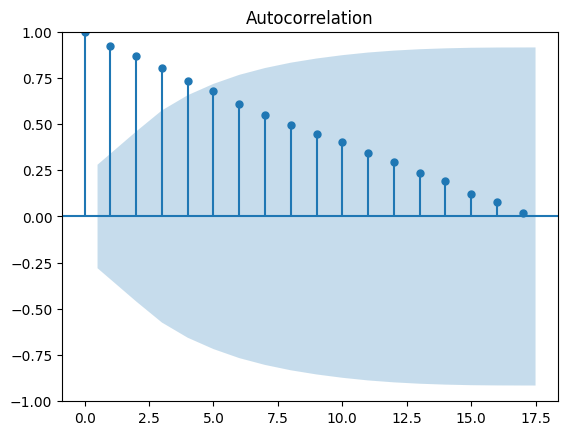

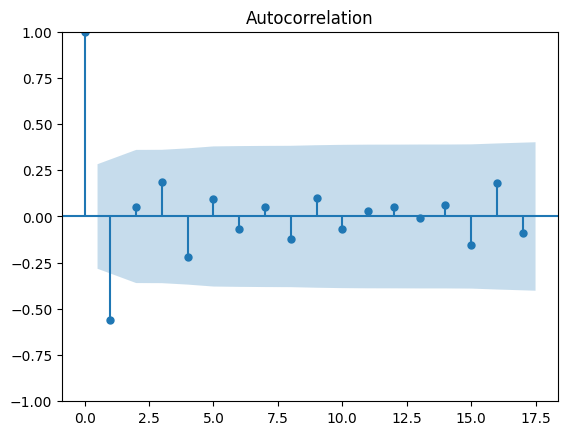

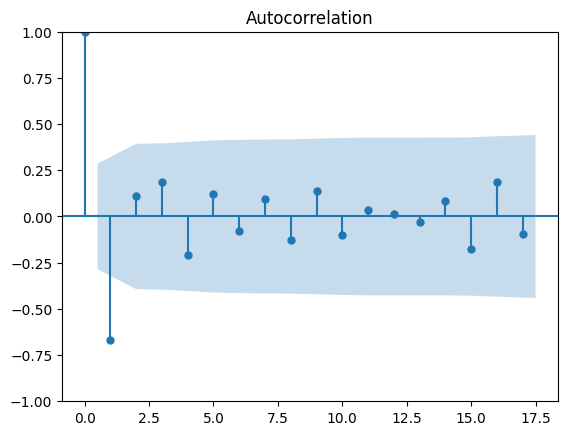

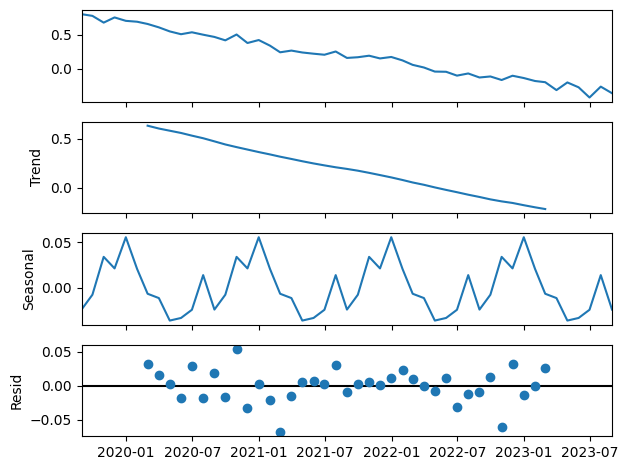

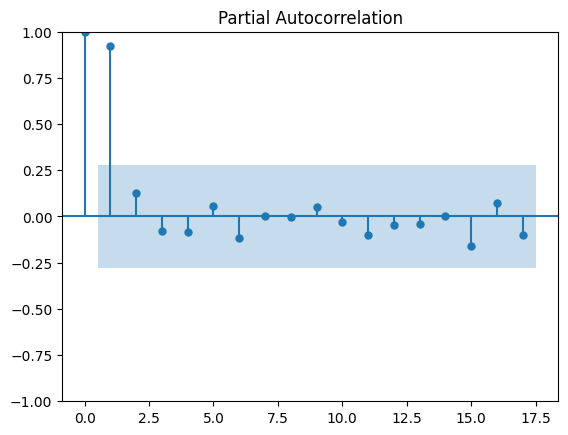

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-98.043, Time=0.84 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-76.198, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-91.942, Time=0.81 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-97.762, Time=0.49 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-95.168, Time=0.23 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-96.047, Time=0.89 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-96.045, Time=2.04 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-97.116, Time=0.58 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-94.048, Time=1.29 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-92.467, Time=0.55 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-98.344, Time=1.00 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-95.818, Time=0.30 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-96.654, Time=1.24 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-96.826, Time=2.73 sec
 ARIMA(2,1,1)(1,1,0)[12]         

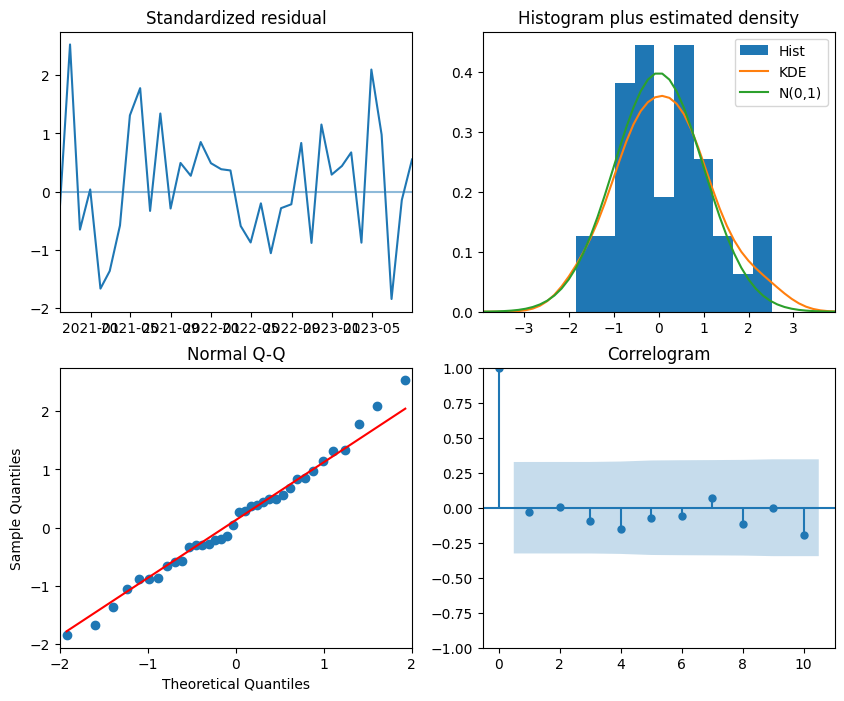

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   49
Model:             SARIMAX(2, 1, 0)x(0, 1, [1], 12)   Log Likelihood                  55.157
Date:                              Sat, 11 May 2024   AIC                           -100.313
Time:                                      08:36:29   BIC                            -92.396
Sample:                                  08-31-2019   HQIC                           -97.550
                                       - 08-31-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time        1.409e-08    9.8e-09      1.438      0.151   -5.12e-09    3.33e-08
ar.L1         -0.95

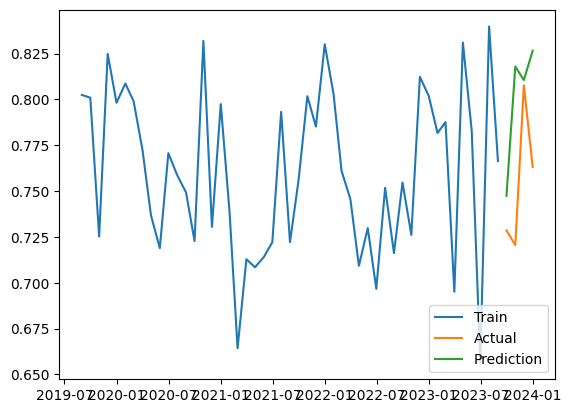

[0.01358005] [[-0.0141275]] [[0.01303261]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8499622805589464

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 33.

--------------------------------------------------------------------------------
27 fits failed with the foll

[0.01358005] [[-0.0141275]] [[0.01303261]]
Mean of Residuals 0.017032341629969874
Mean of Residuals 0.017032341629969874


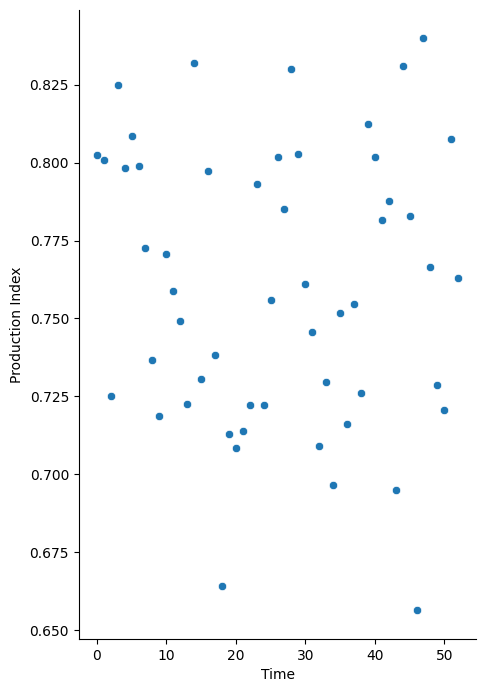

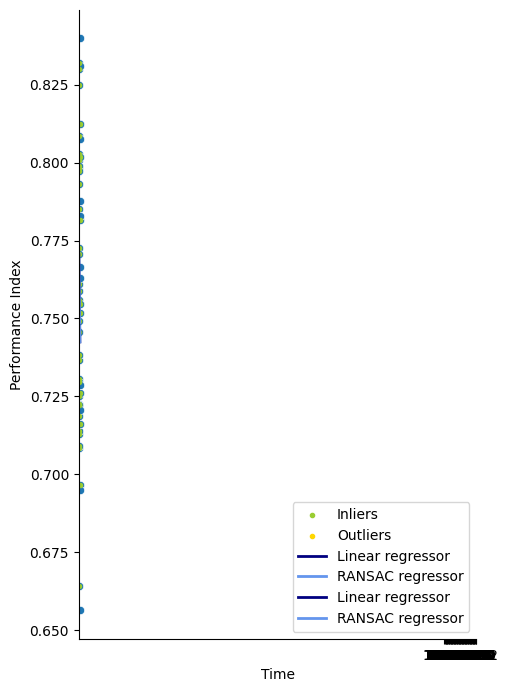

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                      Egersund
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2022-11-16 11:00:00  19.756773
2018-09-22 01:00:00  18.032328
2020-02-23 06:00:00  15.745713
2020-02-29 14:00:00  22.844919
2023-08-08 10:00:00  19.148678

[193006 rows x 1 columns]
##################Fakken###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2013-07-02 10:00:00   1.368836  285.359619   98403.085938         0.101200
2013-07-02 11:00:00   2.145295  285.098663   98362.828125         0.099414
2013-07-02 12:00:00   2.159615  285.238556   98350.554688         0.101580
2013-07-02 13:00:00   2.731737  285.469269   98324.570312         0.102182
2013-07-02 14:00:00   3.094135  

<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

              Fakken
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31  0.684619
2014-12-31  0.627854
2015-12-31  0.696347
2016-12-31  0.580601
2017-12-31  0.981735
2018-12-31  0.810502
2019-12-31  0.936073
2020-12-31  0.603370
2021-12-31  0.502283
2022-12-31  0.684932
2023-12-31  0.593607 <class 'pandas.core.frame.DataFrame'>
feedin_power_plant    832684.866617
dtype: float64


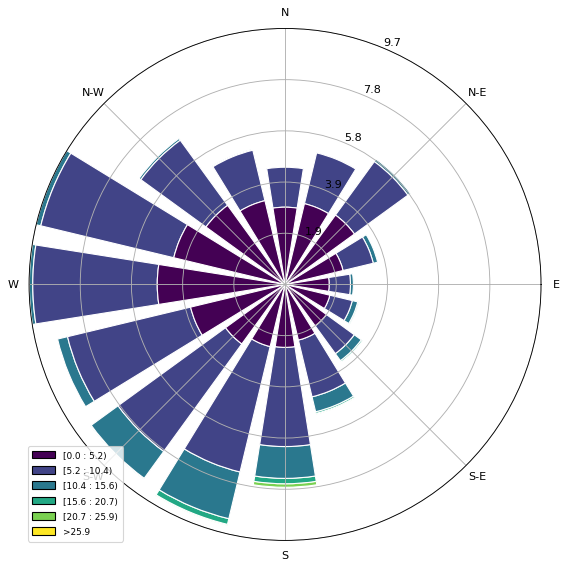

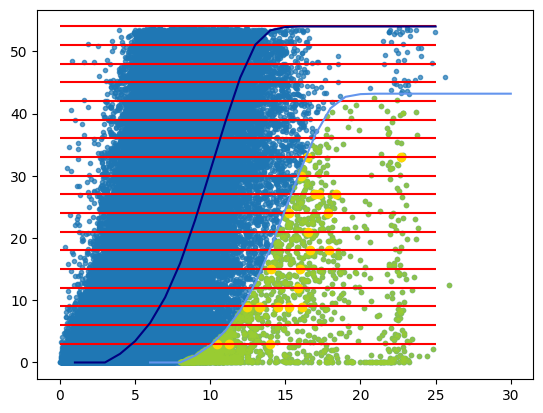

               Production Index  Time
DateTimeIndex                        
2013-07-31             1.086468     0
2013-08-31             1.050580     1
2013-09-30             2.327471     2
2013-10-31             1.459806     3
2013-11-30             1.360940     4
...                         ...   ...
2023-08-31             2.343387   121
2023-09-30             1.268747   122
2023-10-31             1.836975   123
2023-11-30             2.717083   124
2023-12-31             2.454225   125

[126 rows x 2 columns]


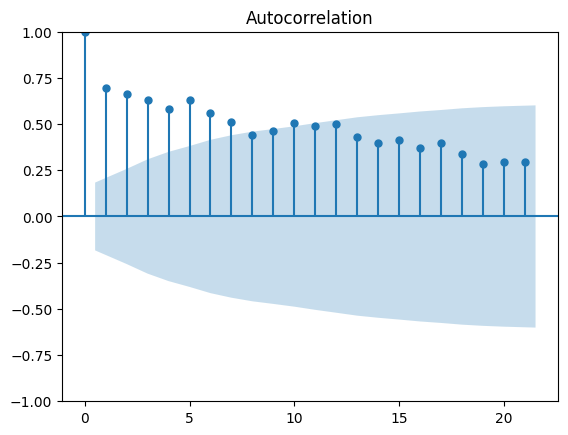

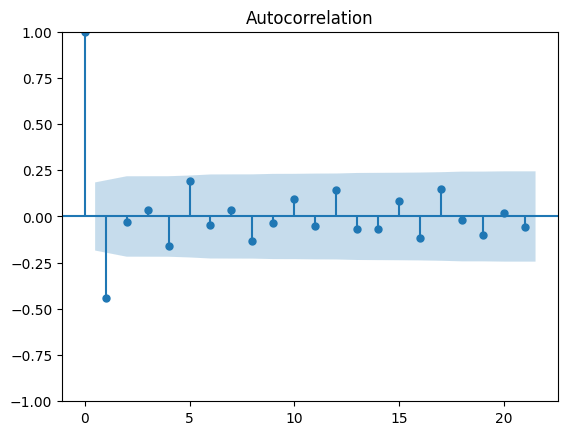

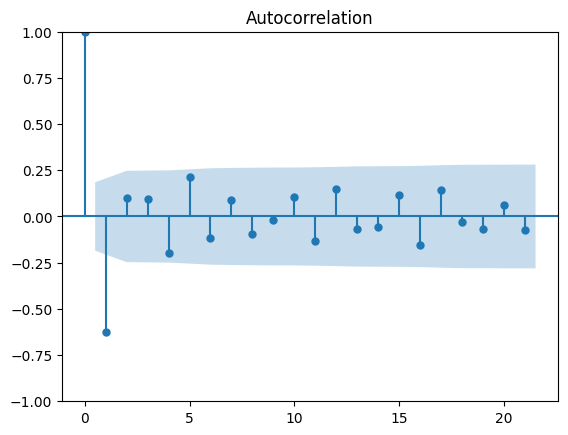

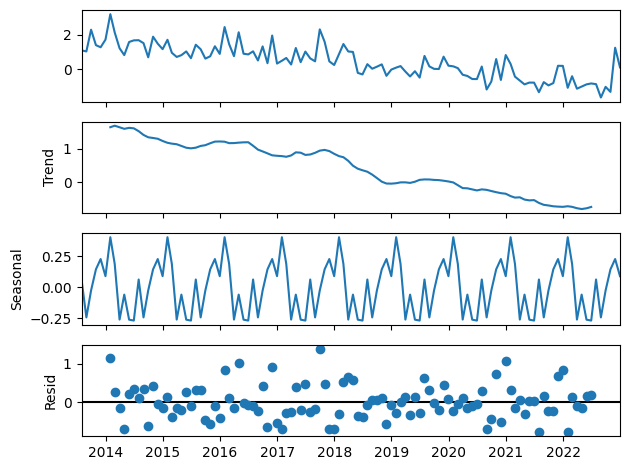

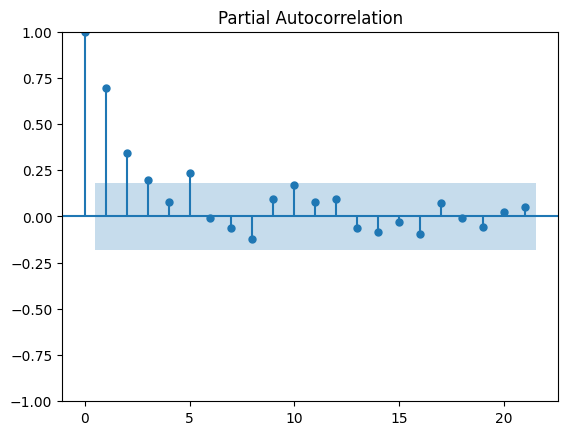

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=203.349, Time=1.81 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=226.740, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=211.443, Time=0.63 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=200.880, Time=0.84 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=224.740, Time=0.10 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=226.819, Time=0.13 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=202.296, Time=1.69 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=202.307, Time=2.33 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=211.440, Time=0.46 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=204.325, Time=2.03 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=199.616, Time=0.99 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=201.305, Time=0.88 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=201.337, Time=2.39 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=209.491, Time=0.67 sec
 ARIMA(0,0,0)(1,1,2)[12] intercep

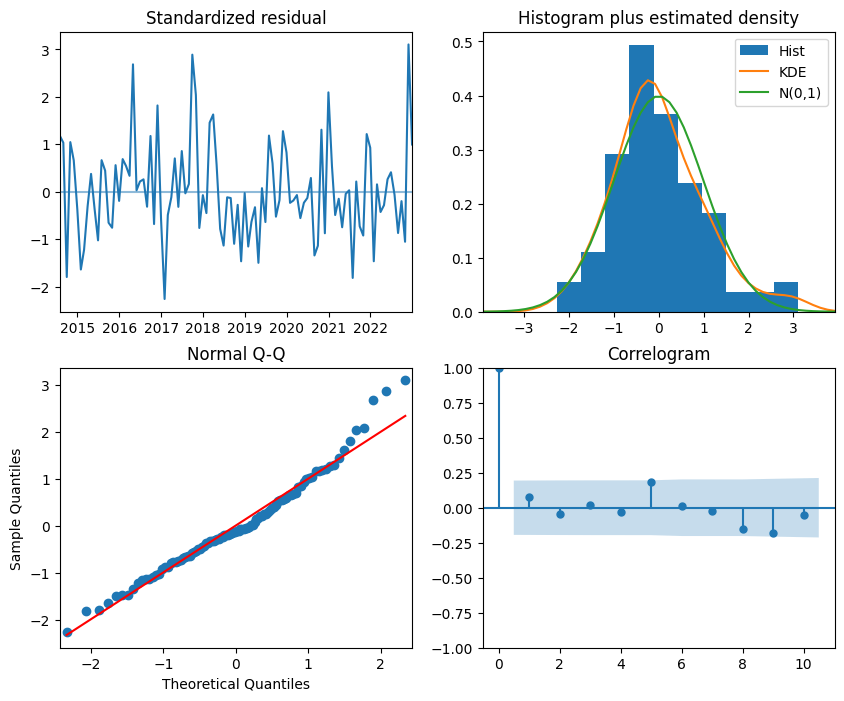

                                 SARIMAX Results                                  
Dep. Variable:                          y   No. Observations:                  114
Model:             SARIMAX(0, 1, [1], 12)   Log Likelihood                 -95.808
Date:                    Sat, 11 May 2024   AIC                            197.616
Time:                            08:37:12   BIC                            205.491
Sample:                        07-31-2013   HQIC                           200.804
                             - 12-31-2022                                         
Covariance Type:                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0004      0.002      0.182      0.856      -0.004       0.005
ma.S.L12      -0.7246      0.143     -5.084      0.000      -1.004      -0.445
sigma2         0.351

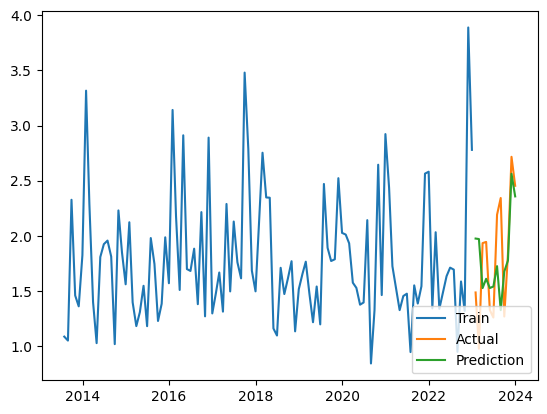

[0.03815176] [[-0.03888035]] [[0.03742317]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=30, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.07759772617868829

 The best parameters across ALL searched params:
 {'min_samples': 30, 'residual_threshold': 1.5}
[0.03839713] [[-0.03912572]] [[0.03766854]]
Mean of Residuals 0.1558352616126692
Mean of Residuals 0.17386325325094706


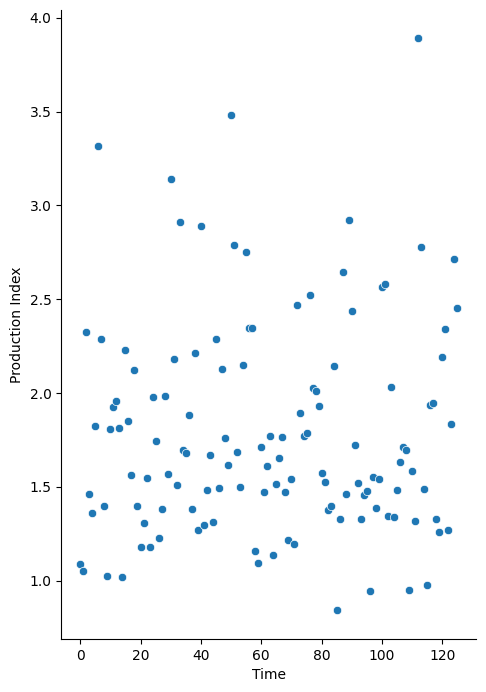

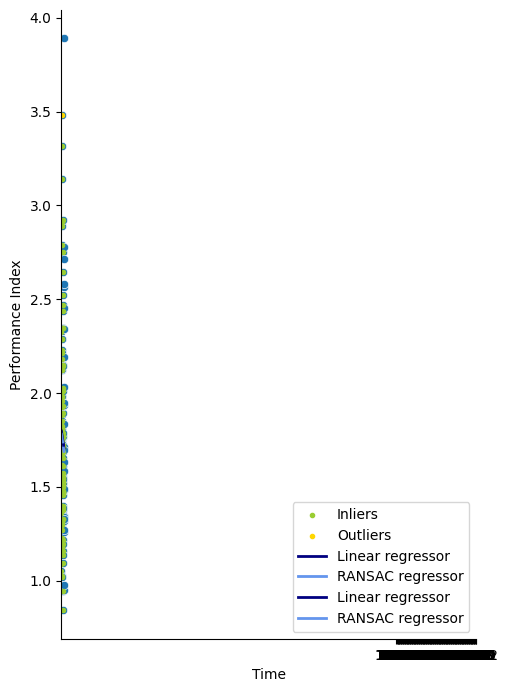

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[26.17479219] [[-26.23521973]] [[26.11436464]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.552543367454827

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[27.90062721] [[-27.96105476]] [[27.84019967]]
[10.2974327] [[-10.34009684]] [[10.25476855]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -260.49794250594374

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[14.94255866] [[-14.98522281]] [[14.89989451]]
[9.70811036] [[-9.94920102]] [[9.4670197]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.379264118580662

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[12.06082274] [[-12.3019134]] [[11.81973208]]
[11.0955413] [[-11.02106331]] [[11.17001929]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -384.3930366306232

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[8.29405098] [[-8.21957298]] [[8.36852897]]
[11.39070636] [[-11.46679379]] [[11.31461893]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.2888502269160027

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[10.60207213] [[-10.67815956]] [[10.5259847]]
[20.72191523] [[-20.8214102]] [[20.62242026]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.6904849106049312

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[28.01569289] [[-28.11518786]] [[27.91619792]]
[8.86401246] [[-8.92037392]] [[8.807651]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -6.094512142271518

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[9.75798114] [[-9.8143426]] [[9.70161968]]
[27.06892089] [[-27.19147327]] [[26.94636851]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -2924.521545394871

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[27.06892089] [[-27.19147327]] [[26.94636851]]
[17.13288424] [[-17.13862594]] [[17.12714254]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.41112632252369696

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[22.01383648] [[-22.01957817]] [[22.00809478]]
[12.65800123] [[-12.6212821]] [[12.69472037]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -8.762675257312967

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[18.23904297] [[-18.20232384]] [[18.27576211]]
[13.42133509] [[-13.61958912]] [[13.22308106]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -223.92953532715222

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[13.42133509] [[-13.61958912]] [[13.22308106]]
[11.91521723] [[-12.01819231]] [[11.81224216]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5775302285173673

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.14517285] [[-12.24814792]] [[12.04219778]]
[27.73066427] [[-27.80492623]] [[27.65640232]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -17.250762338097417

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[31.7685063] [[-31.84276825]] [[31.69424435]]
[52.95638315] [[-52.72511655]] [[53.18764974]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -42.435606672547486

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[35.72270924] [[-35.49144264]] [[35.95397584]]
[22.71588774] [[-22.60543808]] [[22.8263374]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -5176.8401402103045

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[5.45992827] [[-5.34947861]] [[5.57037792]]
[6.21391041] [[-6.28287795]] [[6.14494288]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -20.07529463499834

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[17.66017376] [[-17.7291413]] [[17.59120623]]
[40.66848023] [[-40.70676769]] [[40.63019276]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.0527506797566253

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[47.38561646] [[-47.42390392]] [[47.34732899]]
[21.61895153] [[-21.83386527]] [[21.40403779]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1.2705438407333918

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[26.68148847] [[-26.89640221]] [[26.46657473]]
[65.27891894] [[-64.99825347]] [[65.5595844]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[88.37647469] [[-88.09580922]] [[88.65714015]]
[11.46740114] [[-11.75312886]] [[11.18167342]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
93 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.54737504343417

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[19.35263101] [[-19.63835873]] [[19.06690329]]
[12.30448354] [[-12.28759713]] [[12.32136995]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.49881782046371337

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[15.91772053] [[-15.90083412]] [[15.93460694]]
[13.90841376] [[-13.95804084]] [[13.85878668]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -153.4189251193771

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[17.34862654] [[-17.39825362]] [[17.29899946]]
[7.16745775] [[-7.21996383]] [[7.11495168]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -66.99044221671207

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[17.42455645] [[-17.47706253]] [[17.37205037]]
[14.36092587] [[-14.33796027]] [[14.38389147]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -2.134433301341404

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[14.63608926] [[-14.61312366]] [[14.65905486]]
[12.59836316] [[-12.77293341]] [[12.42379292]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.010385507630207246

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[13.48886098] [[-13.66343123]] [[13.31429074]]
[10.51276494] [[-10.53647328]] [[10.48905659]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
96 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
6 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -20.209766151359997

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[26.89575962] [[-26.91946796]] [[26.87205127]]
[20.00620262] [[-19.92384927]] [[20.08855597]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.565212845625547

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[23.93876488] [[-23.85641153]] [[24.02111823]]
[19.88731362] [[-19.85317721]] [[19.92145002]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -37.42614935438165

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[10.83391152] [[-10.79977511]] [[10.86804792]]
[8.07104555] [[-8.16513317]] [[7.97695794]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -38.99348345757506

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[7.78967578] [[-7.88376339]] [[7.69558816]]
[42.9562763] [[-43.11605589]] [[42.79649671]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -124.38571530841509

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[65.54311929] [[-65.70289887]] [[65.3833397]]
[34.58221226] [[-34.73049233]] [[34.4339322]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -8.327216978466009

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[34.40751752] [[-34.55579759]] [[34.25923746]]
[9.40010261] [[-9.41011458]] [[9.39009064]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -691.8055885856802

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[12.67971761] [[-12.68972958]] [[12.66970564]]
[18.33581475] [[-18.26454433]] [[18.40708516]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -102.1227764602129

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[18.33629857] [[-18.26502816]] [[18.40756899]]
[21.41825863] [[-21.18716771]] [[21.64934955]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -93.51126888944528

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.37850443] [[-15.14741351]] [[15.60959535]]
[10.66987754] [[-10.66500946]] [[10.67474562]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -154.49594038365836

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.53343502] [[-6.52856694]] [[6.5383031]]
[13.38755932] [[-13.29033067]] [[13.48478798]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.9456690377570913

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[16.53518639] [[-16.43795773]] [[16.63241505]]
[5.86522407] [[-5.88330785]] [[5.8471403]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -18.046517208251682

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[16.59530823] [[-16.613392]] [[16.57722446]]
[26.49490152] [[-26.14046781]] [[26.84933522]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
93 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -6.336795244709703

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[41.62714419] [[-41.27271048]] [[41.98157789]]
[53.19985755] [[-53.33766238]] [[53.06205272]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.9199666120755303

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[52.50365386] [[-52.64145869]] [[52.36584903]]
[18.82273675] [[-18.89952849]] [[18.745945]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -54.773629670574074

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[18.84192695] [[-18.9187187]] [[18.76513521]]
[29.65564578] [[-29.56842001]] [[29.74287156]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -72.39071942299105

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[21.604459] [[-21.51723322]] [[21.69168477]]
[21.51612002] [[-21.39617532]] [[21.63606472]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8938724686065218

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[11.74182075] [[-11.62187606]] [[11.86176545]]
               Production Index  Time
DateTimeIndex                        
2013-07-31             1.091673     0
2013-08-31             1.060785     1
2013-09-30             2.327471     2
2013-10-31             1.477343     3
2013-11-30             1.360940     4
...                         ...   ...
2023-08-31             2.367536   121
2023-09-30             1.271873   122
2023-10-31             1.844903   123
2023-11-30             2.717083   124
2023-12-31             2.454225   125

[126 rows x 2 columns]


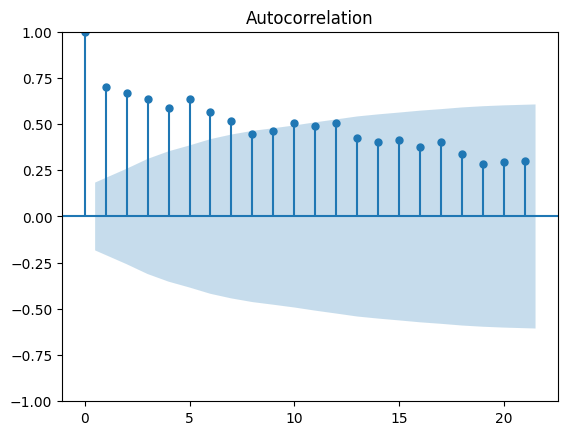

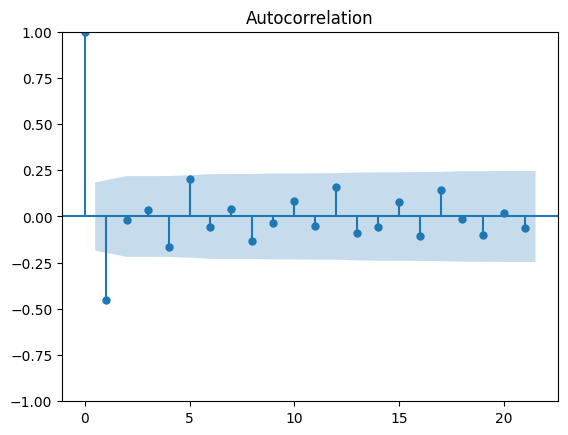

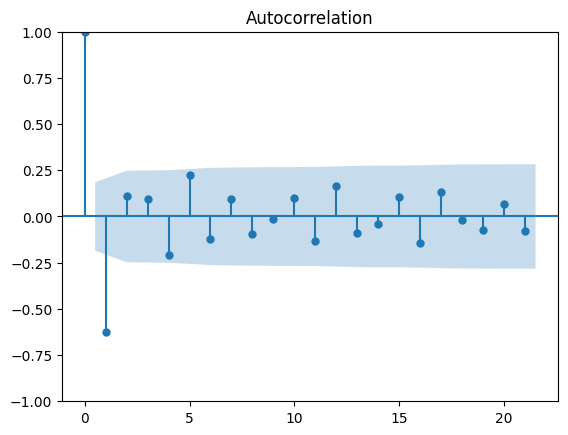

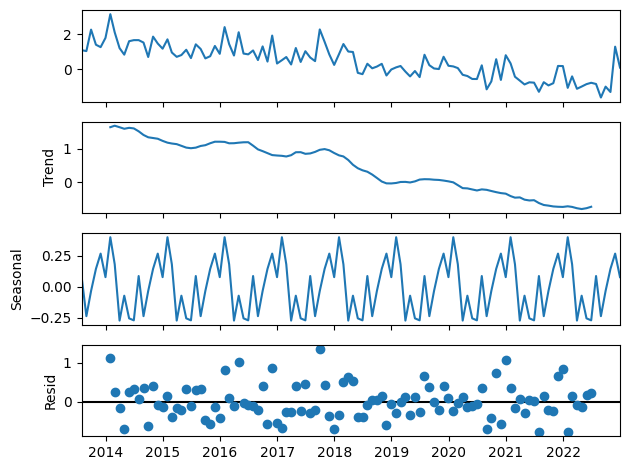

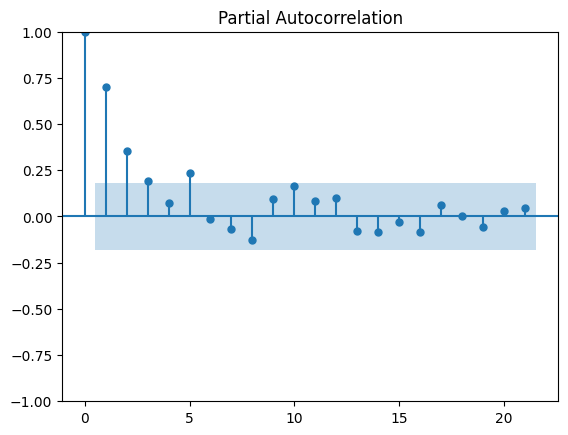

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.84 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=225.958, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=210.903, Time=0.89 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=200.779, Time=0.77 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=223.958, Time=0.12 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=225.635, Time=0.14 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=201.986, Time=1.44 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=202.025, Time=1.60 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=210.903, Time=0.49 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=204.156, Time=2.39 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=199.642, Time=0.48 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=201.212, Time=0.79 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=201.268, Time=1.48 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=209.044, Time=0.75 sec
 ARIMA(0,0,0)(1,1,2)[12] intercept   

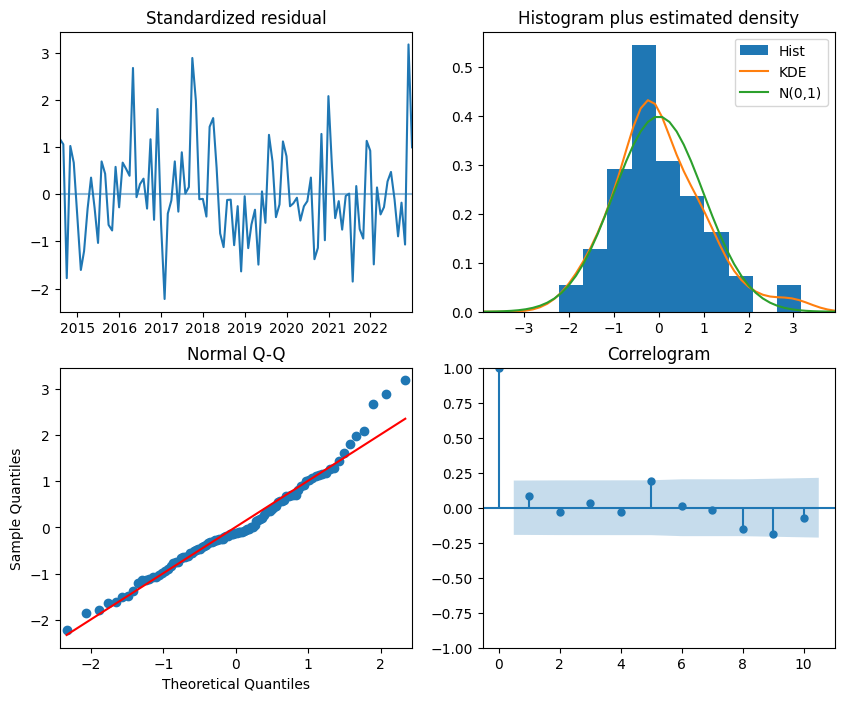

                                 SARIMAX Results                                  
Dep. Variable:                          y   No. Observations:                  114
Model:             SARIMAX(0, 1, [1], 12)   Log Likelihood                 -95.821
Date:                    Sat, 11 May 2024   AIC                            197.642
Time:                            08:38:21   BIC                            205.517
Sample:                        07-31-2013   HQIC                           200.831
                             - 12-31-2022                                         
Covariance Type:                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0004      0.002      0.165      0.869      -0.004       0.005
ma.S.L12      -0.7267      0.148     -4.897      0.000      -1.018      -0.436
sigma2         0.350

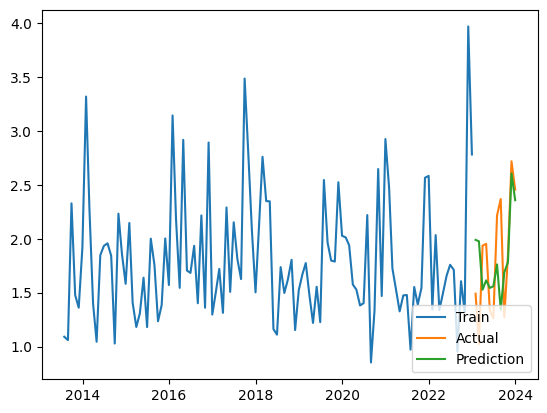

[0.03841511] [[-0.03917592]] [[0.0376543]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=40, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.0893198674426559

 The best parameters across ALL searched params:
 {'min_samples': 40, 'residual_threshold': 1.5}
[0.03865089] [[-0.0394117]] [[0.03789008]]
Mean of Residuals 0.1519488773853453
Mean of Residuals 0.1698183459197128


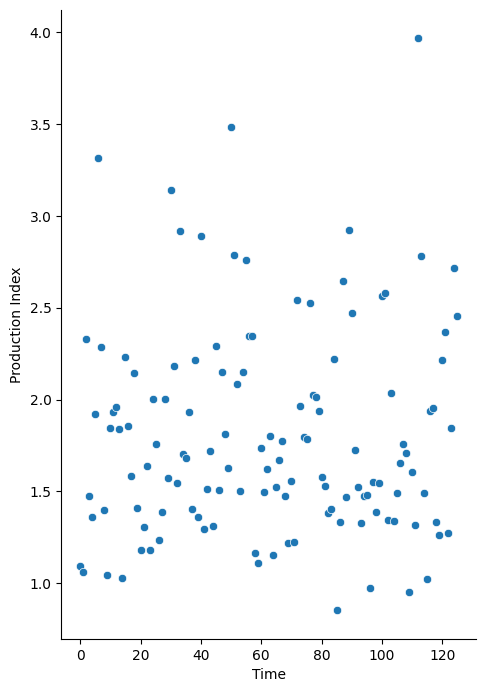

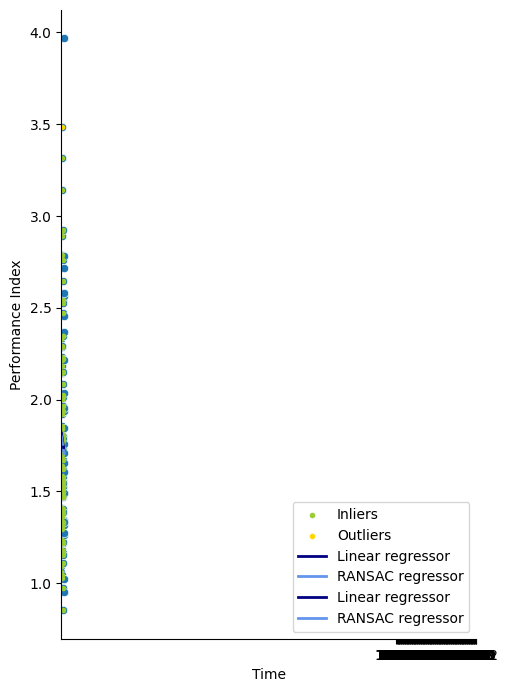

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[25.83005847] [[-25.89297722]] [[25.76713973]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.7161235102379553

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[27.52906701] [[-27.59198575]] [[27.46614826]]
[9.58726275] [[-9.61918463]] [[9.55534088]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -448.97613666465224

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.68360501] [[-13.71552688]] [[13.65168313]]
[9.70811036] [[-9.94920102]] [[9.4670197]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.379264118580662

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[12.06082274] [[-12.3019134]] [[11.81973208]]
[12.02673707] [[-11.94721672]] [[12.10625742]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -9.633557718644866

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[9.00331855] [[-8.9237982]] [[9.08283891]]
[11.50399867] [[-11.57821266]] [[11.42978468]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.2783387762496436

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[10.1801501] [[-10.25436409]] [[10.10593611]]
[20.52145144] [[-20.61924234]] [[20.42366054]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.7160834503624226

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[27.65371887] [[-27.75150977]] [[27.55592797]]
[8.92190213] [[-8.98303003]] [[8.86077422]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -4.518512240350228

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[9.91197542] [[-9.97310332]] [[9.85084751]]
[26.13650079] [[-26.25556321]] [[26.01743837]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -64.34770827545518

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[18.3581803] [[-18.47724272]] [[18.23911788]]
[16.99696792] [[-17.00125592]] [[16.99267992]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.469717268169971

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[21.54732079] [[-21.55160879]] [[21.54303279]]
[12.70843696] [[-12.67163236]] [[12.74524155]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -7.42689076671334

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[18.29188783] [[-18.25508323]] [[18.32869243]]
[13.19269969] [[-13.39007743]] [[12.99532195]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -47.61064511785488

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[13.19269969] [[-13.39007743]] [[12.99532195]]
[11.83936287] [[-11.94226092]] [[11.73646482]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.621361072098867

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.05955551] [[-12.16245356]] [[11.95665746]]
[26.9269904] [[-27.00252675]] [[26.85145404]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -21.34326274902741

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[26.9269904] [[-27.00252675]] [[26.85145404]]
[52.26600093] [[-52.04544889]] [[52.48655298]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -170.45508240959182

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[35.08384897] [[-34.86329692]] [[35.30440101]]
[23.18096391] [[-23.06849989]] [[23.29342793]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -54.332895732956516

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[7.60154389] [[-7.48907987]] [[7.71400791]]
[6.18665026] [[-6.25552938]] [[6.11777113]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -20.23462520885932

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[17.62283637] [[-17.6917155]] [[17.55395725]]
[41.19865889] [[-41.25321683]] [[41.14410096]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -10.448298738887056

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[47.31931456] [[-47.37387249]] [[47.26475662]]
[15.39260096] [[-15.5076289]] [[15.27757301]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -2.3118723287518868

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 1.0}
[26.08807081] [[-26.20309876]] [[25.97304286]]
[65.33301471] [[-65.04733275]] [[65.61869667]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[95.68007998] [[-95.39439802]] [[95.96576193]]
[11.86971847] [[-12.15457956]] [[11.58485738]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
93 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.589098295345325

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[19.79745685] [[-20.08231793]] [[19.51259576]]
[11.93807999] [[-11.92064179]] [[11.95551818]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.9347770993072103

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[16.2575826] [[-16.2401444]] [[16.27502079]]
[14.26579581] [[-14.31896188]] [[14.21262973]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -11.68527510584785

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[17.96463005] [[-18.01779612]] [[17.91146398]]
[7.22797523] [[-7.28053397]] [[7.17541648]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -71.72322426798817

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[17.39446394] [[-17.44702268]] [[17.3419052]]
[18.37988101] [[-18.35431892]] [[18.40544309]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -2.5732412528262594

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[18.41786108] [[-18.39229899]] [[18.44342317]]
[12.15491421] [[-12.33111951]] [[11.97870892]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.04793726267929273

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[12.47492991] [[-12.6511352]] [[12.29872461]]
[10.51276494] [[-10.53647328]] [[10.48905659]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
96 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
6 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -20.209766151359997

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[26.89575962] [[-26.91946796]] [[26.87205127]]
[20.20309173] [[-20.1192618]] [[20.28692167]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.111451296652438

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[24.15267325] [[-24.06884331]] [[24.23650318]]
[20.11250528] [[-20.075671]] [[20.14933956]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -36.37061739458449

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[20.11250528] [[-20.075671]] [[20.14933956]]
[7.47998106] [[-7.57619067]] [[7.38377145]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.542594732284972

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[21.51087378] [[-21.6070834]] [[21.41466417]]
[42.94058144] [[-43.10031209]] [[42.78085078]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -124.38517925807628

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[65.49732445] [[-65.6570551]] [[65.33759379]]
[34.63507991] [[-34.78662363]] [[34.48353619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -8.567833324735934

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[36.19558221] [[-36.34712593]] [[36.04403849]]
[9.43658772] [[-9.44610695]] [[9.4270685]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -1236.5984075623205

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[20.13678133] [[-20.14630055]] [[20.1272621]]
[18.31943096] [[-18.2486244]] [[18.39023752]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -122.59981952293658

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[18.31762112] [[-18.24681456]] [[18.38842768]]
[21.40475813] [[-21.17391405]] [[21.63560221]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -94.38163834509065

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.37611666] [[-15.14527257]] [[15.60696074]]
[10.66010083] [[-10.65544085]] [[10.6647608]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -196.41765628033798

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.52539441] [[-6.52073444]] [[6.53005439]]
[13.7632328] [[-13.65660005]] [[13.86986555]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.528591495400346

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[19.3469368] [[-19.24030405]] [[19.45356955]]
[6.04111985] [[-6.06575004]] [[6.01648966]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -20.634637929663747

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.04111985] [[-6.06575004]] [[6.01648966]]
[28.92760603] [[-28.55667878]] [[29.29853328]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
94 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -199.41041984912425

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[44.23989736] [[-43.86897011]] [[44.61082461]]
[52.45695638] [[-52.58931385]] [[52.3245989]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.7030204879879125

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[51.75126136] [[-51.88361884]] [[51.61890389]]
[21.73649603] [[-21.81357005]] [[21.659422]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -50.591699370022354

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[21.73813347] [[-21.81520749]] [[21.66105944]]
[30.01184809] [[-29.92692562]] [[30.09677055]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -79.28732851280988

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[22.24248486] [[-22.1575624]] [[22.32740733]]
[21.44054022] [[-21.32191444]] [[21.55916599]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -0.9674711083253357

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[19.00403273] [[-18.88540696]] [[19.1226585]]
               Production Index  Time
DateTimeIndex                        
2014-07-31             1.957318     0
2014-08-31             1.812319     1
2014-09-30             1.018295     2
2014-10-31             2.230883     3
2014-11-30             1.850313     4
2014-12-31             1.560998     5
2015-01-31             2.123622     6
2015-02-28             1.397382     7
2015-03-31             1.181733     8
2015-04-30             1.308475     9
2015-05-31             1.547256    10
2015-06-30             1.181170    11
2015-07-31             1.980354    12
2015-08-31             1.74

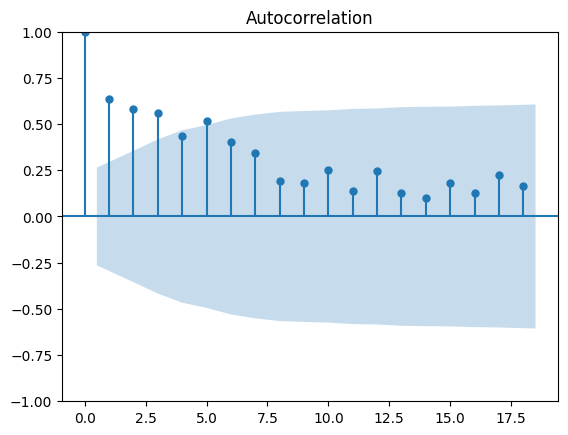

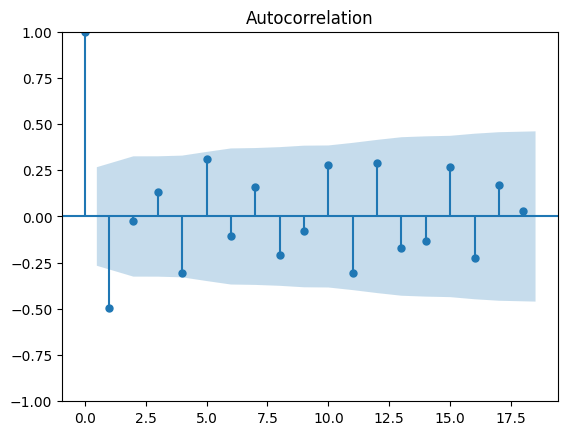

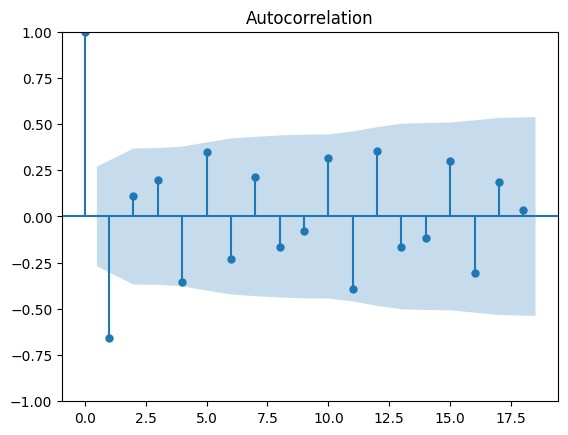

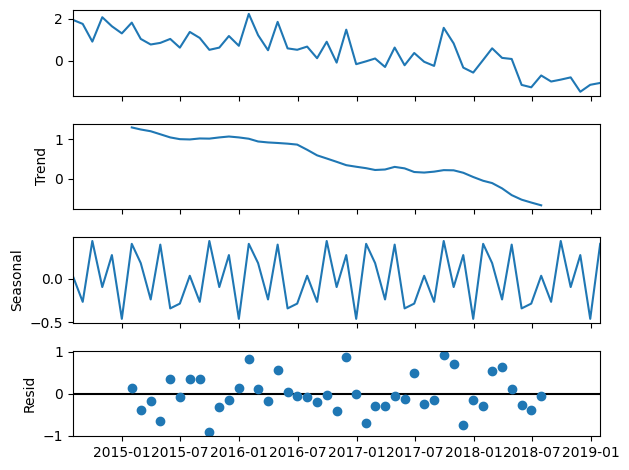

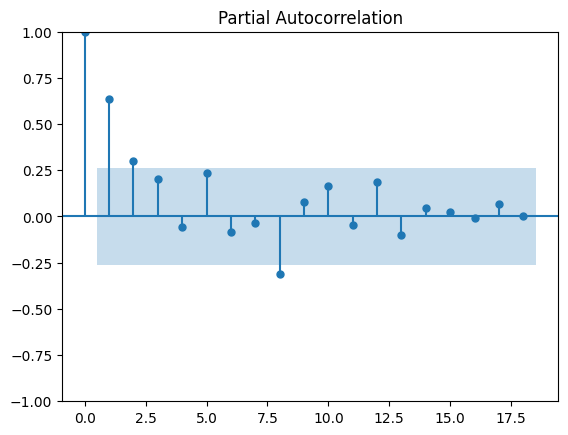

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=99.460, Time=0.83 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=105.552, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=101.022, Time=0.80 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=97.805, Time=0.30 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=103.552, Time=0.06 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=104.037, Time=0.08 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=inf, Time=0.95 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=1.75 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=101.214, Time=0.27 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=2.43 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=96.819, Time=0.35 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=0.98 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=100.055, Time=0.33 sec
 ARIMA(0,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=1.9

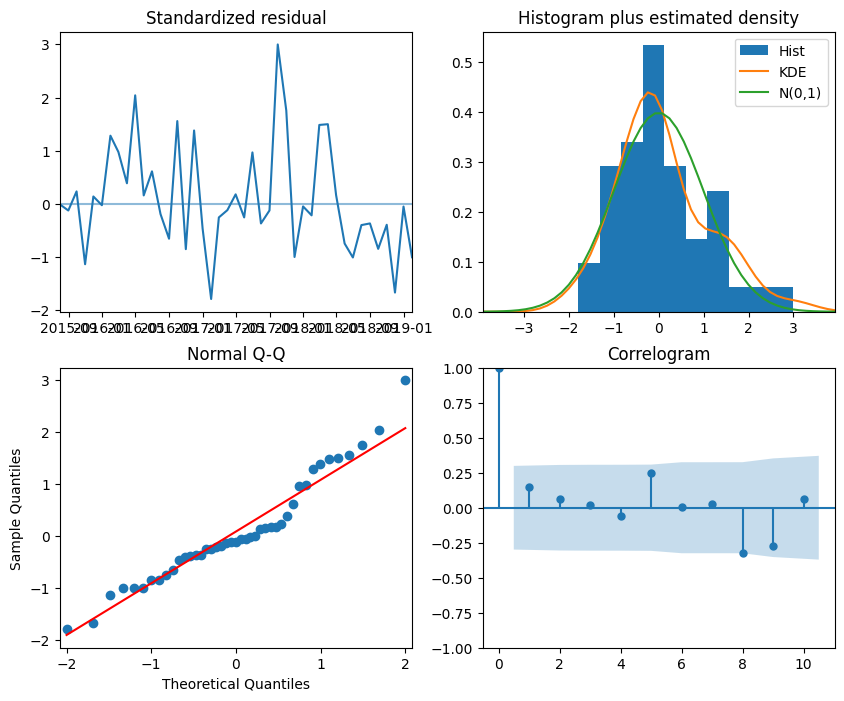

                                 SARIMAX Results                                  
Dep. Variable:                          y   No. Observations:                   55
Model:             SARIMAX(0, 1, [1], 12)   Log Likelihood                 -44.410
Date:                    Sat, 11 May 2024   AIC                             94.819
Time:                            08:39:26   BIC                            100.103
Sample:                        07-31-2014   HQIC                            96.768
                             - 01-31-2019                                         
Covariance Type:                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0024      0.006      0.427      0.670      -0.009       0.013
ma.S.L12      -0.8200      0.482     -1.700      0.089      -1.766       0.126
sigma2         0.355

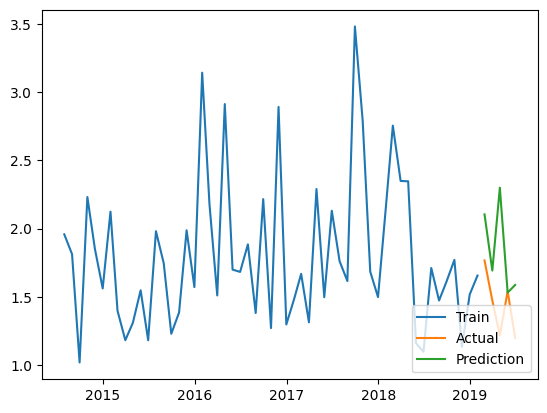

[0.12847471] [[-0.11993559]] [[0.13701383]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.013562818233228224

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 1.5}
[0.12847471] [[-0.11993559]] [[0.13701383]]
Mean of Residuals -0.5879746443031131
Mean of Residuals -0.5879746443031131


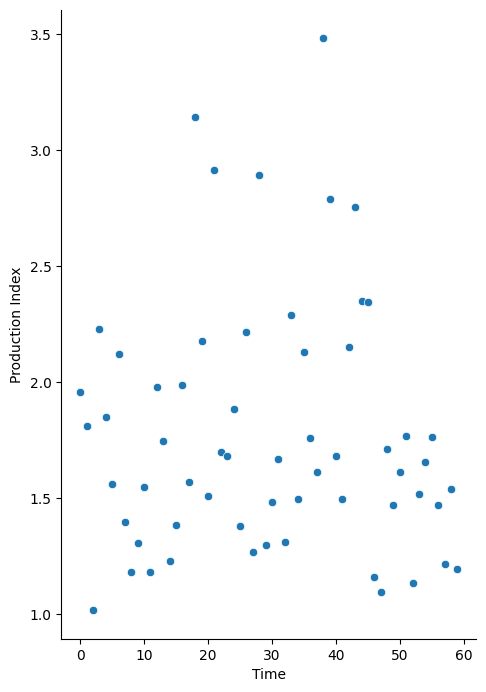

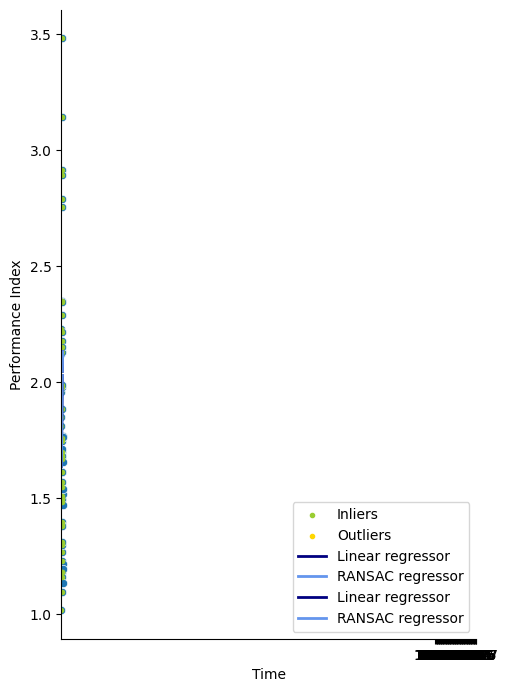

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                        Fakken
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2023-02-12 20:00:00  16.979935
2023-02-13 02:00:00  17.229507
2023-02-08 14:00:00  16.041264
2014-12-06 14:00:00  16.444767
2021-01-22 02:00:00  22.675207

[193485 rows x 1 columns]
##################Hamnefjell###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2018-07-16 23:00:00   3.945096  283.988800  99490.359375         0.176815
2018-07-17 00:00:00   4.668067  284.530029  99472.281250         0.176801
2018-07-17 01:00:00   4.897106  284.710419  99478.273438         0.176803
2018-07-17 02:00:00   5.149993  285.914886  99455.875000         0.176825
2018-07-17 03:00:00   5.561546  287

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    811868.482881
dtype: float64
            Observasjoner tot prod  Observasjoner valid prod  \
Hamnefjell                  192840                     47857   

            Missing values prod  Negative values prod  Zero values prod  \
Hamnefjell                    0                     0              3681   

            Prod over capacity  Observasjoner df_windpowerlib  \
Hamnefjell                   1                          47857   

            Missing values wind_peed  Missing values temperature  \
Hamnefjell                       NaN                         NaN   

            Missing values pressure  Missing values roughness_length  \
Hamnefjell                      NaN                              NaN   

            Observasjoner sim  Zero values sim  
Hamnefjell              47857             4550  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Hamnefjell
2002-12-31         NaN
2003-12-31         NaN
2004-12-31         NaN
2005-12-31         NaN
2006-12-31         NaN
2007-12-31         NaN
2008-12-31         NaN
2009-12-31         NaN
2010-12-31         NaN
2011-12-31         NaN
2012-12-31         NaN
2013-12-31         NaN
2014-12-31         NaN
2015-12-31         NaN
2016-12-31         NaN
2017-12-31         NaN
2018-12-31    0.223159
2019-12-31    0.114155
2020-12-31    0.591985
2021-12-31    0.513699
2022-12-31    0.867580
2023-12-31    1.563927 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    804474.592233
dtype: float64


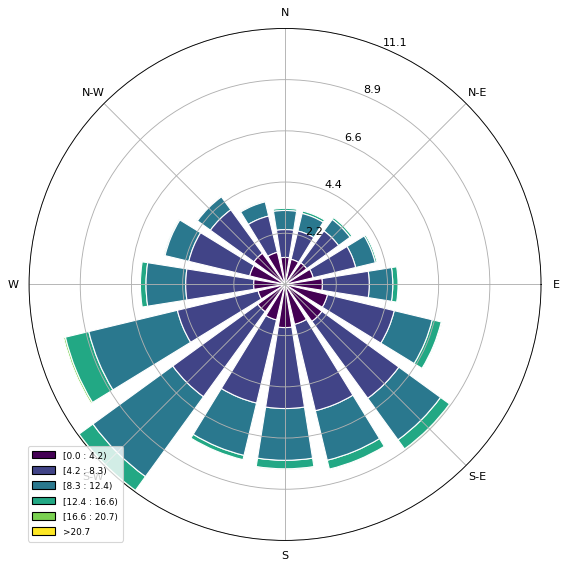

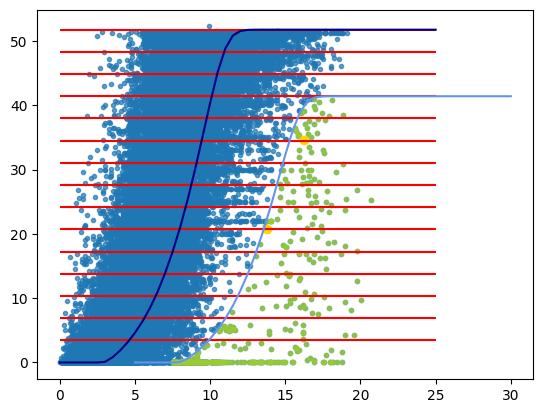

               Production Index  Time
DateTimeIndex                        
2018-07-31             2.834454     0
2018-08-31             1.524923     1
2018-09-30             1.493874     2
2018-10-31             1.618100     3
2018-11-30             1.276070     4
...                         ...   ...
2023-08-31             1.288681    61
2023-09-30             0.774205    62
2023-10-31             1.384876    63
2023-11-30             1.552308    64
2023-12-31             1.246328    65

[66 rows x 2 columns]


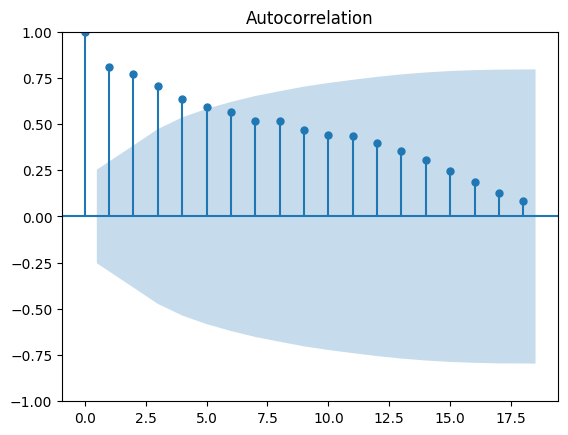

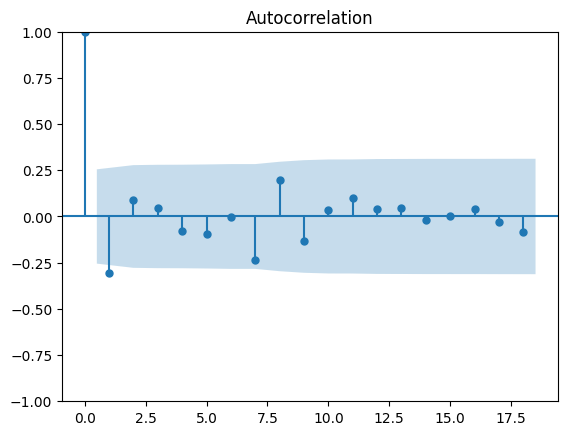

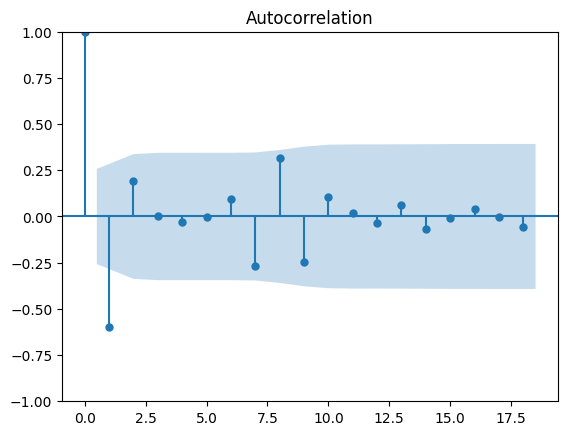

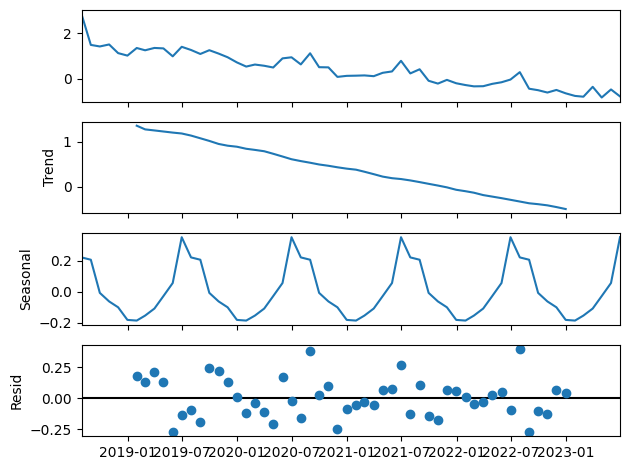

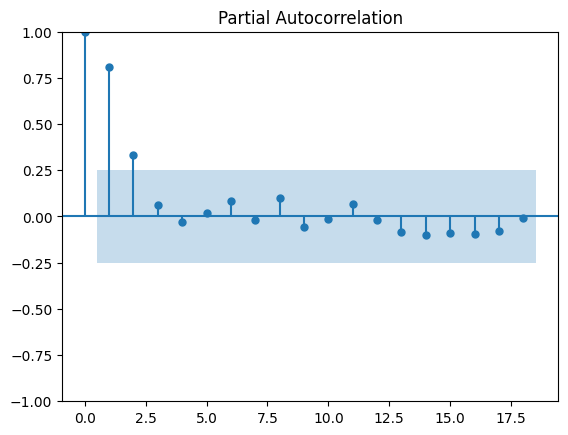

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.83 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=20.111, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=21.623, Time=0.45 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.80 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=18.111, Time=0.08 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=21.663, Time=0.23 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.56 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.77 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=20.590, Time=0.19 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=20.265, Time=0.12 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=19.123, Time=0.26 sec

Best model:  ARIMA(0,0,0)(0,1,0)[12]          
Total fit time: 5.396 seconds


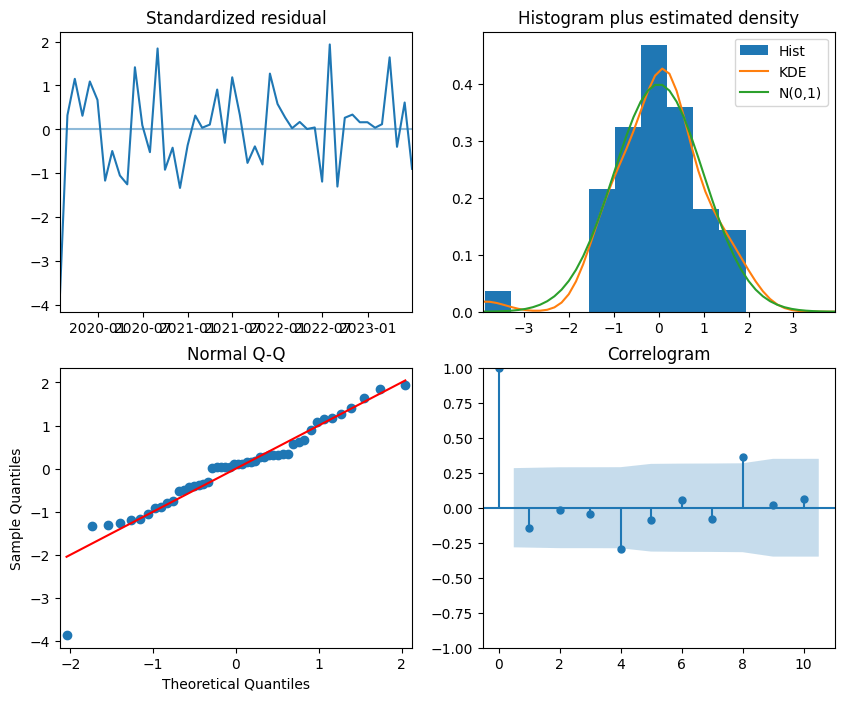

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   60
Model:             SARIMAX(0, 1, 0, 12)   Log Likelihood                  -7.056
Date:                  Sat, 11 May 2024   AIC                             18.111
Time:                          08:39:44   BIC                             21.854
Sample:                      07-31-2018   HQIC                            19.526
                           - 06-30-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0036      0.004     -0.988      0.323      -0.011       0.004
sigma2         0.0786      0.011      7.032      0.000       0.057       0.100
Ljung-Box (L1) (Q):                 

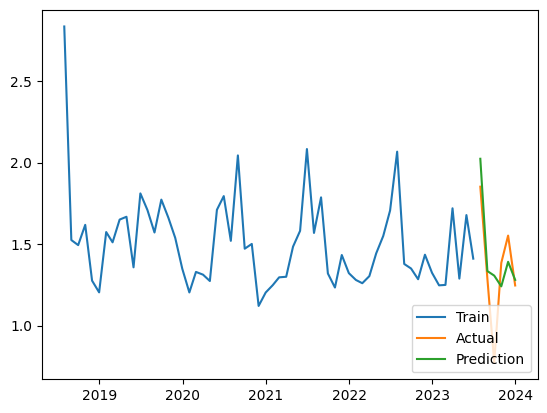

[0.03944222] [[-0.04379631]] [[0.03508813]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 0.0024396900563171454

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.625}
[0.04029866] [[-0.04465275]] [[0.03594457]]
Mean of Residuals 0.015957033437647403
Mean of Residuals -0.052637156526435816


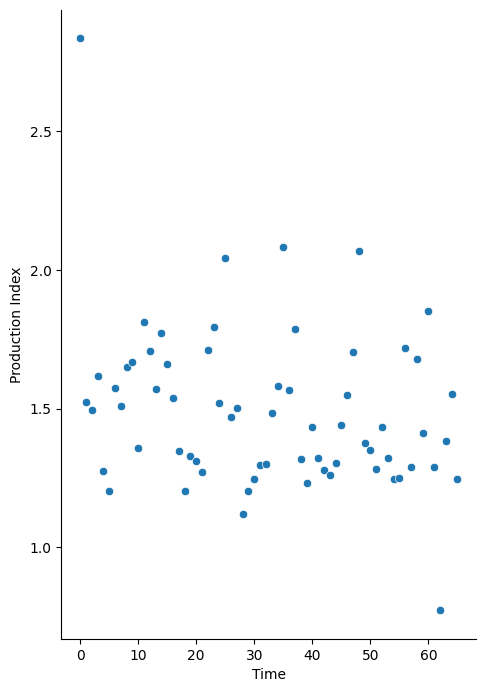

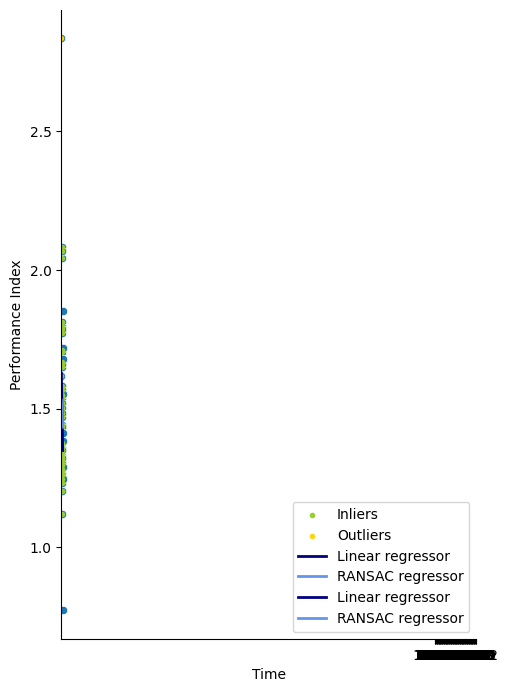

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[11.28002281] [[-11.50347116]] [[11.05657447]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[16.60105616] [[-16.8245045]] [[16.37760781]]
[6.19698317] [[-6.27560791]] [[6.11835843]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -8.64288812779111

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[6.19698317] [[-6.27560791]] [[6.11835843]]
[2.8822995] [[-2.88660701]] [[2.877992]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -31.75362173740796

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.16846854] [[-4.17277604]] [[4.16416103]]
[4.11763913] [[-4.13007742]] [[4.10520084]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.4212091468269808

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.11763913] [[-4.13007742]] [[4.10520084]]
[18.29761173] [[-18.40786169]] [[18.18736177]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -89.41937023771105

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[18.29761173] [[-18.40786169]] [[18.18736177]]
[4.83325268] [[-4.85593529]] [[4.81057007]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6608756011427188

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.6096512] [[-5.63233381]] [[5.58696859]]
[3.5574213] [[-3.53281267]] [[3.58202993]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -50.14634260231897

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.5574213] [[-3.53281267]] [[3.58202993]]
[6.51917792] [[-6.44489556]] [[6.59346029]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8967.487055370533

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[10.3614299] [[-10.28714754]] [[10.43571227]]
[7.52256016] [[-7.53662929]] [[7.50849103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.17309700570809797

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.52862624] [[-6.54269536]] [[6.51455711]]
[5.30846283] [[-5.36755338]] [[5.24937228]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.8653110085253393

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.30846283] [[-5.36755338]] [[5.24937228]]
[4.34000832] [[-4.31433359]] [[4.36568305]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5226994335511566

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.28009819] [[-2.25442346]] [[2.30577292]]
[4.40429377] [[-4.34568793]] [[4.46289961]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4702443196120939

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.27182718] [[-6.21322134]] [[6.33043302]]
[8.99212801] [[-9.00005915]] [[8.98419687]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.8903589423839288

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[9.61023798] [[-9.61816912]] [[9.60230684]]
[4.11655108] [[-4.07705823]] [[4.15604394]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -404.0035665300281

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.11655108] [[-4.07705823]] [[4.15604394]]
[2.5652756] [[-2.59989064]] [[2.53066055]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -130.71066413166048

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.5652756] [[-2.59989064]] [[2.53066055]]
[9.24547132] [[-9.13766566]] [[9.35327697]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7635027189156098

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[7.64928643] [[-7.54148078]] [[7.75709209]]
[6.3069416] [[-6.38266134]] [[6.23122185]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.16246381425474626

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[9.35122885] [[-9.42694859]] [[9.2755091]]
[8.16703965] [[-8.15682271]] [[8.1772566]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -44.07456524084781

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.26755023] [[-6.25733328]] [[6.27776718]]
[3.46360737] [[-3.43143904]] [[3.4957757]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.27971615989756843

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.4366345] [[-4.40446618]] [[4.46880283]]
[7.78656488] [[-7.72491526]] [[7.84821449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.463355028047434

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[11.69893841] [[-11.6372888]] [[11.76058802]]
[12.05839387] [[-12.09814946]] [[12.01863828]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.7513001036654878

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[10.24587201] [[-10.28562759]] [[10.20611642]]
[8.58771791] [[-8.55881456]] [[8.61662127]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.302174508999969

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[9.4214625] [[-9.39255914]] [[9.45036585]]
               Production Index  Time
DateTimeIndex                        
2018-07-31             2.834454     0
2018-08-31             1.555205     1
2018-09-30             1.493874     2
2018-10-31             1.618100     3
2018-11-30             1.276070     4
...                         ...   ...
2023-08-31             1.316173    61
2023-09-30             1.000401    62
2023-10-31             1.384876    63
2023-11-30             1.554164    64
2023-12-31             1.246328    65

[66 rows x 2 columns]


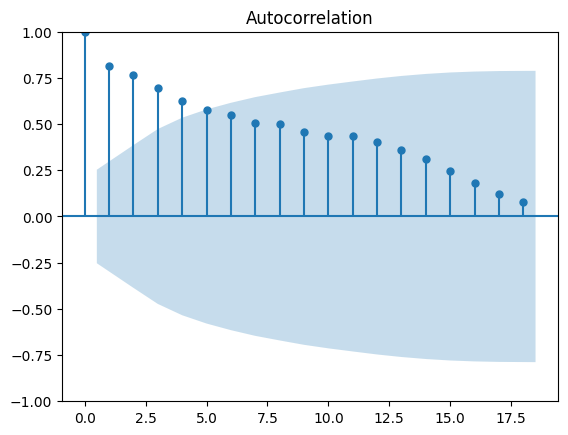

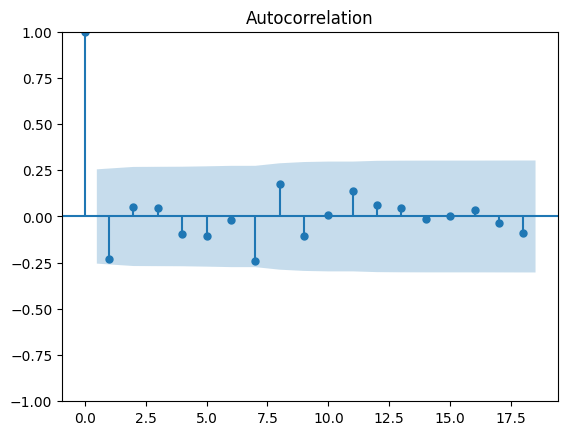

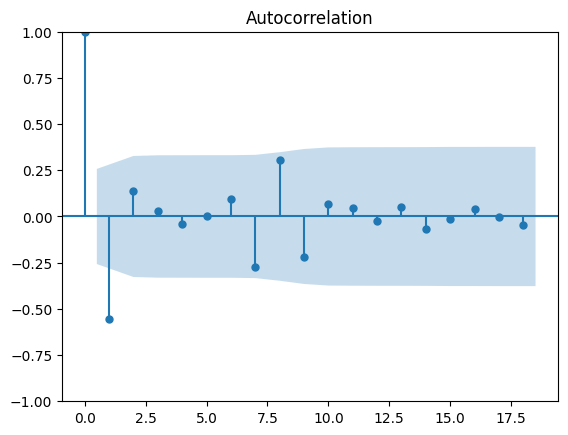

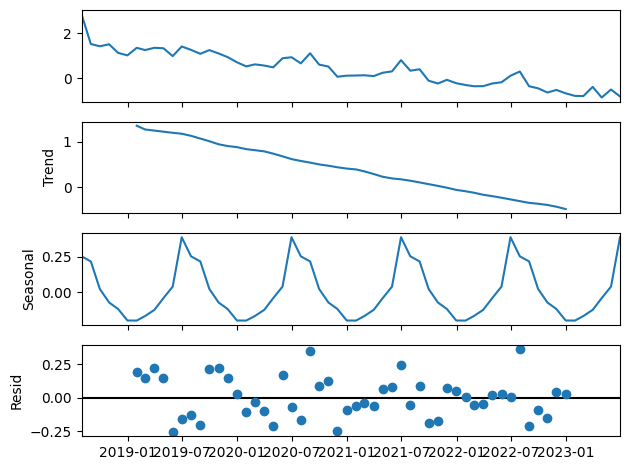

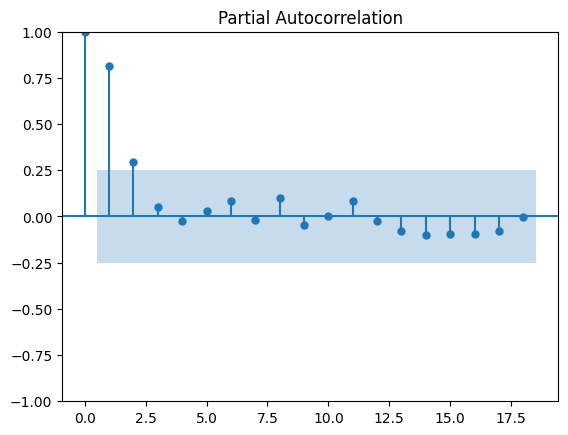

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.32 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=19.271, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=22.016, Time=0.40 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.24 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=17.271, Time=0.10 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=20.750, Time=0.32 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.49 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.10 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=20.798, Time=0.13 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=20.651, Time=0.11 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=18.883, Time=0.18 sec

Best model:  ARIMA(0,0,0)(0,1,0)[12]          
Total fit time: 5.513 seconds


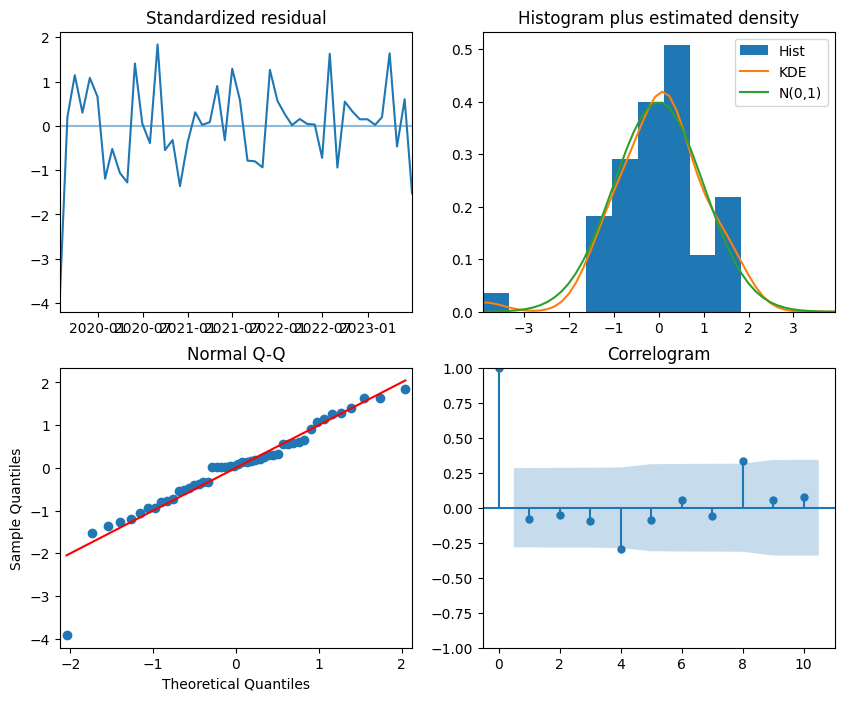

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   60
Model:             SARIMAX(0, 1, 0, 12)   Log Likelihood                  -6.635
Date:                  Sat, 11 May 2024   AIC                             17.271
Time:                          08:40:06   BIC                             21.013
Sample:                      07-31-2018   HQIC                            18.685
                           - 06-30-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0033      0.004     -0.878      0.380      -0.011       0.004
sigma2         0.0772      0.011      6.982      0.000       0.056       0.099
Ljung-Box (L1) (Q):                 

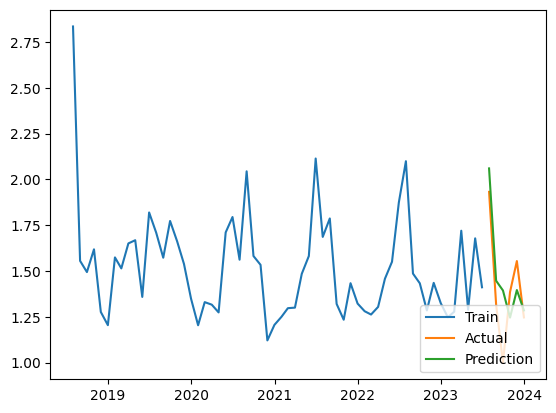

[0.03564337] [[-0.03916093]] [[0.03212581]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.006970938090621148

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.625}
[0.0372732] [[-0.04079075]] [[0.03375564]]
Mean of Residuals -0.0008951304244674592
Mean of Residuals -0.06984033576622217


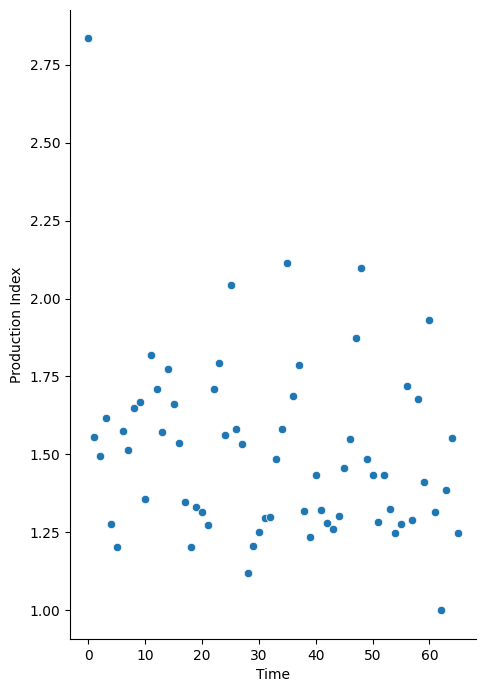

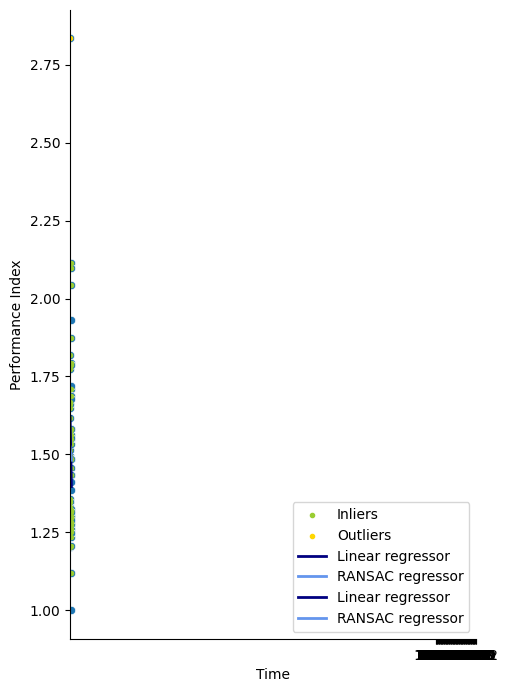

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[10.5327259] [[-10.74982822]] [[10.31562358]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.25718819] [[-15.47429051]] [[15.04008587]]
[6.19698317] [[-6.27560791]] [[6.11835843]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -8.64288812779111

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[6.19698317] [[-6.27560791]] [[6.11835843]]
[2.91511263] [[-2.91929594]] [[2.91092932]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -31.467070467675835

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.20336225] [[-4.20754557]] [[4.19917894]]
[4.18415047] [[-4.19633298]] [[4.17196795]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.4202017813637555

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.18415047] [[-4.19633298]] [[4.17196795]]
[18.28305804] [[-18.39319038]] [[18.17292571]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -90.90963251666886

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[18.28305804] [[-18.39319038]] [[18.17292571]]
[4.83325268] [[-4.85593529]] [[4.81057007]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6608756011427188

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.6096512] [[-5.63233381]] [[5.58696859]]
[3.52415364] [[-3.49953536]] [[3.54877191]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -50.07552021371619

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.52415364] [[-3.49953536]] [[3.54877191]]
[6.51917792] [[-6.44489556]] [[6.59346029]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8967.487055370533

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[10.3614299] [[-10.28714754]] [[10.43571227]]
[4.86699955] [[-4.88784777]] [[4.84615133]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.9239309882094997

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[3.36039541] [[-3.38124363]] [[3.33954719]]
[5.80774833] [[-5.87581887]] [[5.73967779]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8716647578992092

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.02160218] [[-5.08967272]] [[4.95353164]]
[4.34152296] [[-4.31595719]] [[4.36708872]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5554885708522623

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.28378356] [[-2.25821779]] [[2.30934932]]
[3.9621079] [[-3.90350206]] [[4.02071374]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4702443196120939

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.80404102] [[-5.74543518]] [[5.86264686]]
[8.58915799] [[-8.6406986]] [[8.53761738]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.31350009986553984

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[9.9350811] [[-9.98662171]] [[9.88354049]]
[4.11655108] [[-4.07705823]] [[4.15604394]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -404.0035665300281

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.11655108] [[-4.07705823]] [[4.15604394]]
[2.53461064] [[-2.568875]] [[2.50034629]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -131.48216700451442

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.53461064] [[-2.568875]] [[2.50034629]]
[8.22672079] [[-8.12013817]] [[8.3333034]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7497554643143696

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[8.26873748] [[-8.16215487]] [[8.3753201]]
[6.07488618] [[-6.15620791]] [[5.99356445]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -1.3352421013316602

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[8.62585214] [[-8.70717387]] [[8.54453041]]
[8.72768509] [[-8.7272084]] [[8.72816178]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -44.08996781725572

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.26755023] [[-6.26707354]] [[6.26802692]]
[3.23178073] [[-3.19830496]] [[3.2652565]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.319365931733546

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.18111011] [[-4.14763435]] [[4.21458588]]
[7.78656488] [[-7.72491526]] [[7.84821449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.463355028047434

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[11.69893841] [[-11.6372888]] [[11.76058802]]
[8.46697535] [[-8.51647299]] [[8.4174777]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.1031730504907358

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[9.90715318] [[-9.95665083]] [[9.85765553]]
[8.65744213] [[-8.6335612]] [[8.68132305]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.4301722876908007

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[9.24176681] [[-9.21788588]] [[9.26564773]]
               Production Index  Time
DateTimeIndex                        
2019-07-31             1.709014     0
2019-08-31             1.571241     1
2019-09-30             1.772793     2
2019-10-31             1.661474     3
2019-11-30             1.538092     4
2019-12-31             1.348624     5
2020-01-31             1.203626     6
2020-02-29             1.329450     7
2020-03-31             1.312691     8
2020-04-30             1.273650     9
2020-05-31             1.710325    10
2020-06-30             1.794365    11
2020-07-31             1.520064    12
2020-08-31             2.

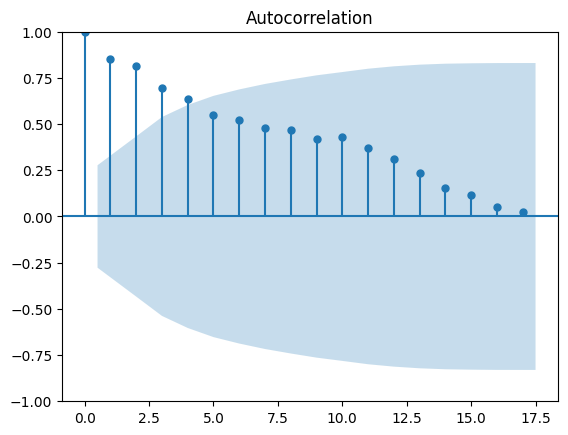

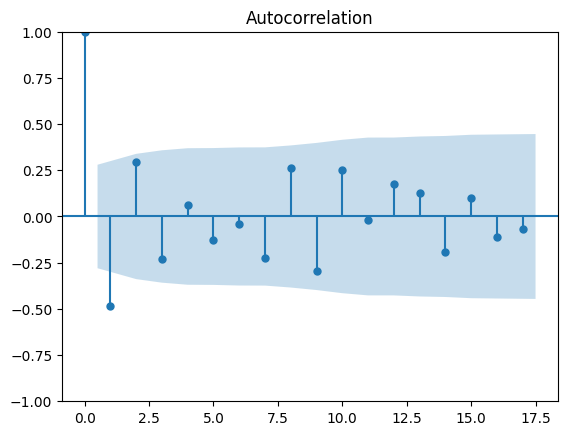

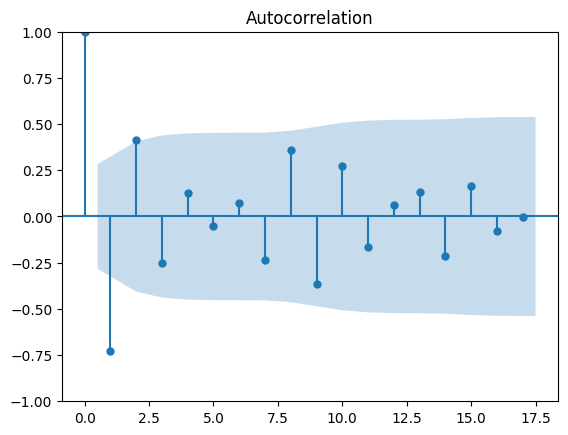

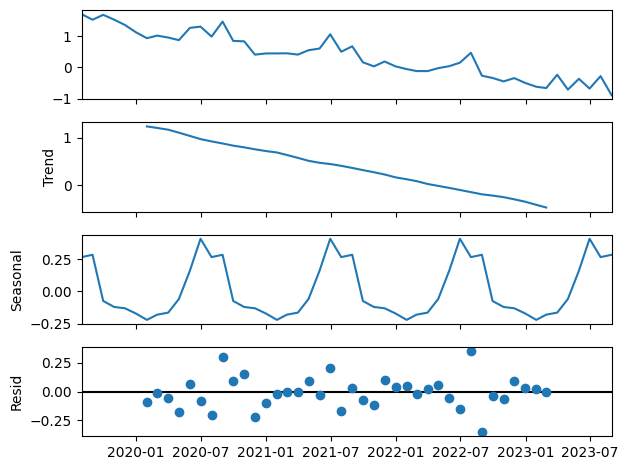

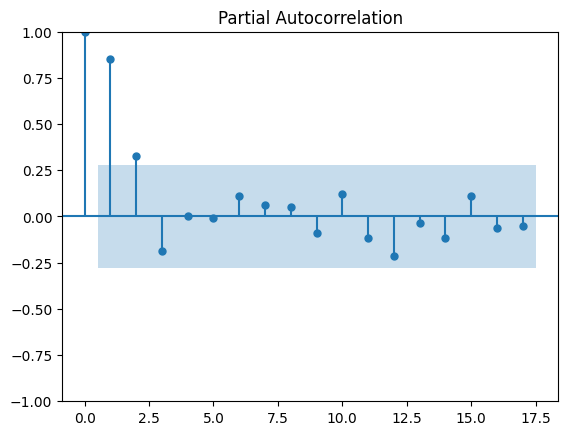

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=0.478, Time=1.07 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-0.353, Time=0.05 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-0.191, Time=0.44 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-0.280, Time=0.49 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-2.353, Time=0.07 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=1.228, Time=0.82 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=0.643, Time=0.68 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.55 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-1.710, Time=0.18 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-1.375, Time=0.08 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-0.117, Time=0.12 sec

Best model:  ARIMA(0,0,0)(0,1,0)[12]          
Total fit time: 5.591 seconds


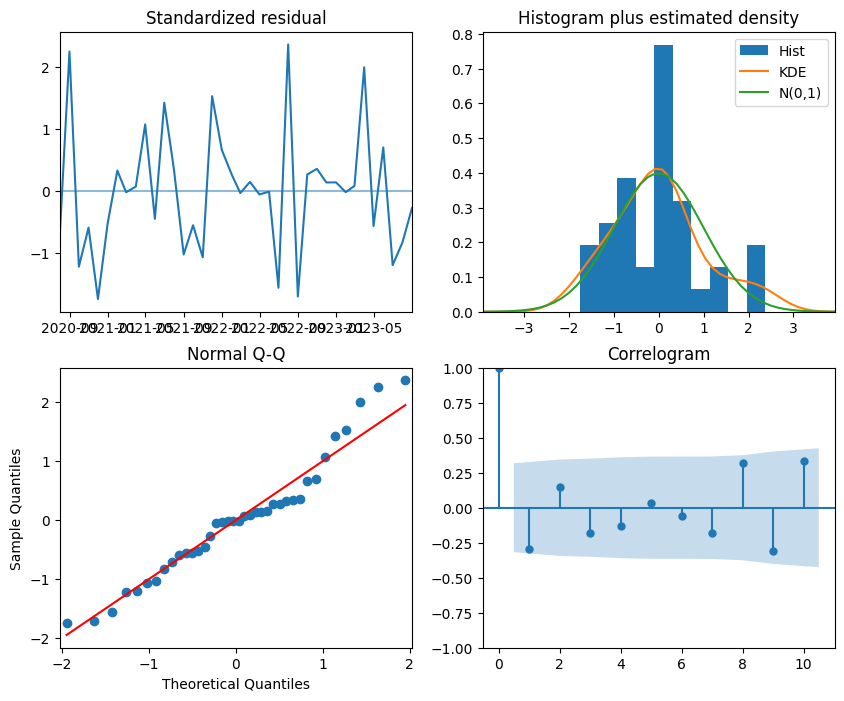

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   50
Model:             SARIMAX(0, 1, 0, 12)   Log Likelihood                   3.177
Date:                  Sat, 11 May 2024   AIC                             -2.353
Time:                          08:40:27   BIC                              0.922
Sample:                      07-31-2019   HQIC                            -1.188
                           - 08-31-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0024      0.003     -0.748      0.455      -0.009       0.004
sigma2         0.0495      0.012      4.129      0.000       0.026       0.073
Ljung-Box (L1) (Q):                 

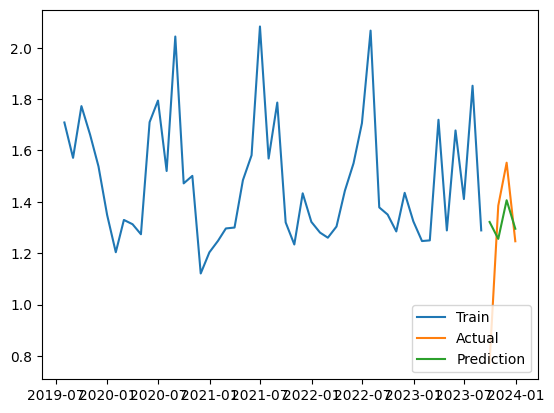

[0.06662454] [[-0.06975009]] [[0.06349899]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 34.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.146477503961351

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.06970171] [[-0.07282726]] [[0.06657616]]
Mean of Residuals 0.014707547328406734
Mean of Residuals 0.08929767125020854


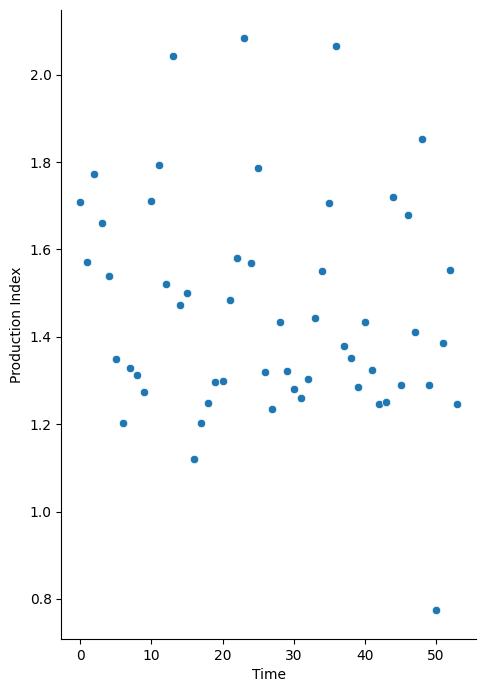

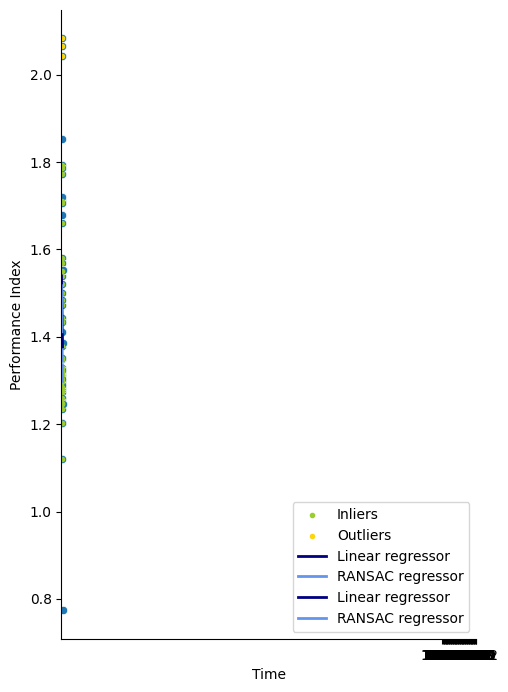

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Hamnefjell
2002-01-01 00:00:00         NaN
2002-01-01 01:00:00         NaN
2002-01-01 02:00:00         NaN
2002-01-01 03:00:00         NaN
2002-01-01 04:00:00         NaN
...                         ...
2023-09-30 22:00:00    5.284699
2023-11-13 14:00:00    6.011120
2023-11-13 15:00:00    5.284146
2023-09-20 05:00:00   13.753038
2022-02-27 21:00:00   16.253592

[193169 rows x 1 columns]
##################Hitra###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2005-08-16 07:00:00  11.492796  283.892700   99880.109375         0.638426
2005-08-16 08:00:00  11.822795  283.921692   99964.851562         0.638583
2005-08-16 09:00:00  11.053720  284.098328  100031.398438         0.640993
2005-08-16 10:00:00  11.585934  284.577942  100072.765625         0.644033
2005-08-16 11:00:00  

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('wind_speed', 100), ('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.941504e+06
dtype: float64
       Observasjoner tot prod  Observasjoner valid prod  Missing values prod  \
Hitra                  192840                    161081                    0   

       Negative values prod  Zero values prod  Prod over capacity  \
Hitra                     0             17114                 317   

       Observasjoner df_windpowerlib  Missing values wind_peed  \
Hitra                         161081                       NaN   

       Missing values temperature  Missing values pressure  \
Hitra                         NaN                      NaN   

       Missing values roughness_length  Observasjoner sim  Zero values sim  
Hitra                              NaN             161081            33551  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

                Hitra
2002-12-31        NaN
2003-12-31        NaN
2004-12-31        NaN
2005-12-31   0.121029
2006-12-31   0.148402
2007-12-31   0.319635
2008-12-31   0.432605
2009-12-31   0.331050
2010-12-31   0.445205
2011-12-31   0.433790
2012-12-31   0.318761
2013-12-31   0.365297
2014-12-31   0.079909
2015-12-31   0.536530
2016-12-31   0.136612
2017-12-31   1.461187
2018-12-31  11.141553
2019-12-31   0.901826
2020-12-31   0.739982
2021-12-31   0.410959
2022-12-31   0.342466
2023-12-31   0.251142 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('wind_speed', 100), ('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.896077e+06
dtype: float64


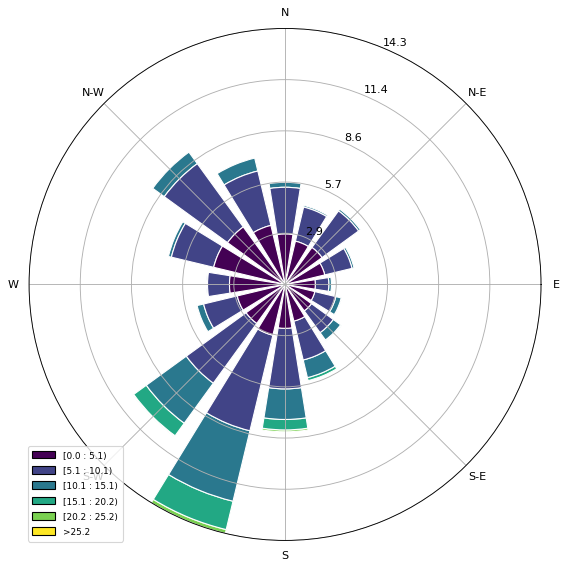

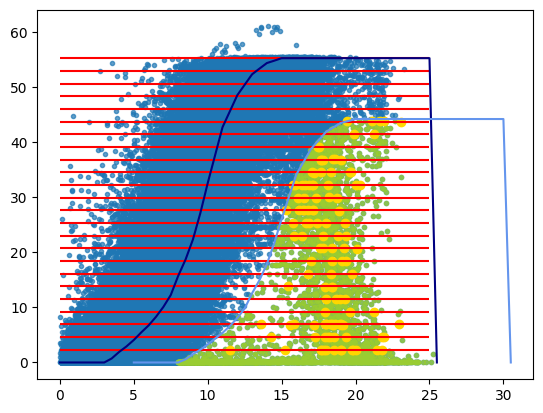

               Production Index  Time
DateTimeIndex                        
2005-08-31             1.225626     0
2005-09-30             1.261523     1
2005-10-31             1.407938     2
2005-11-30             1.354150     3
2005-12-31             1.260000     4
...                         ...   ...
2023-08-31             0.927769   216
2023-09-30             1.227497   217
2023-10-31             0.995914   218
2023-11-30             1.115981   219
2023-12-31             1.221625   220

[221 rows x 2 columns]


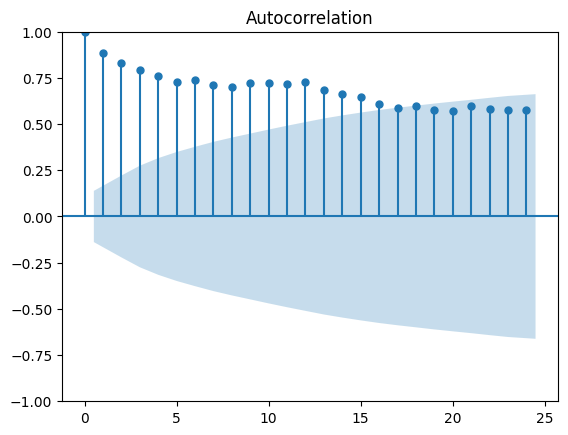

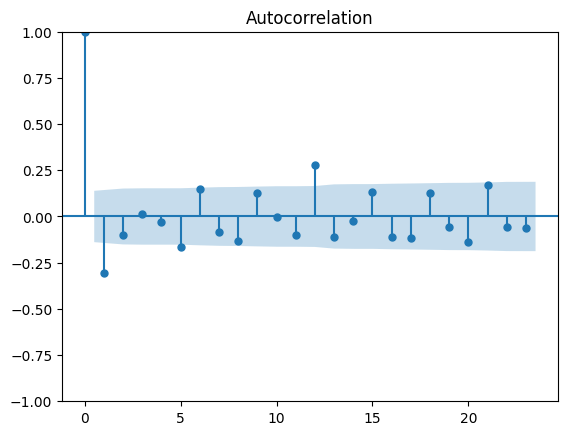

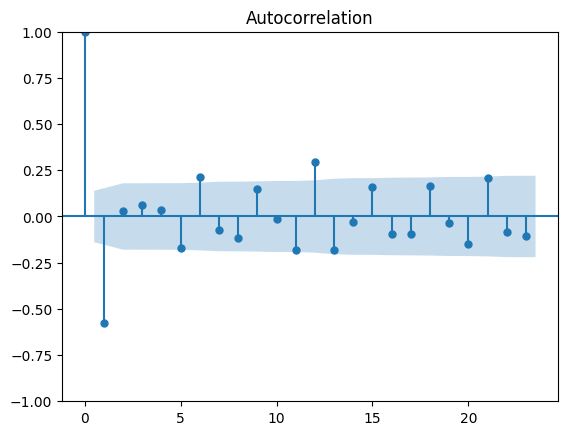

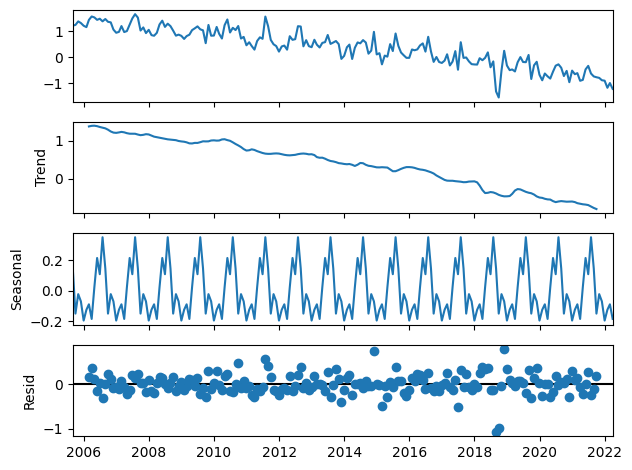

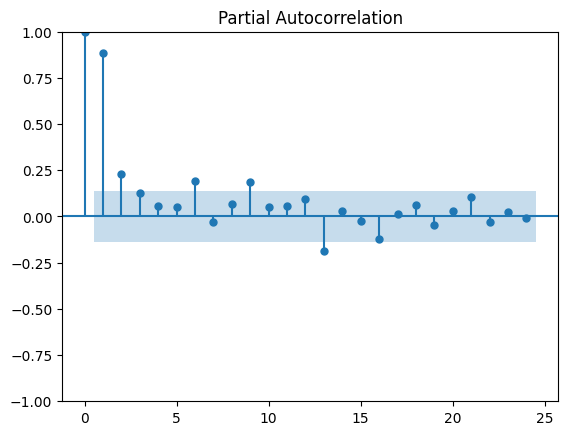

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.30 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=139.021, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=77.070, Time=1.22 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.66 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=137.021, Time=0.14 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=118.520, Time=0.17 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=60.127, Time=2.89 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=6.27 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=4.18 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=75.160, Time=2.00 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=61.775, Time=3.48 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=61.944, Time=6.45 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=61.438, Time=2.45 sec
 ARIMA(2,0,1)(2,1,0)[12] intercept   : AIC=64.002, Time=6.22 sec
 ARIMA(1,0,0)(2,1,0)[12]             : AIC=58.127, Time=

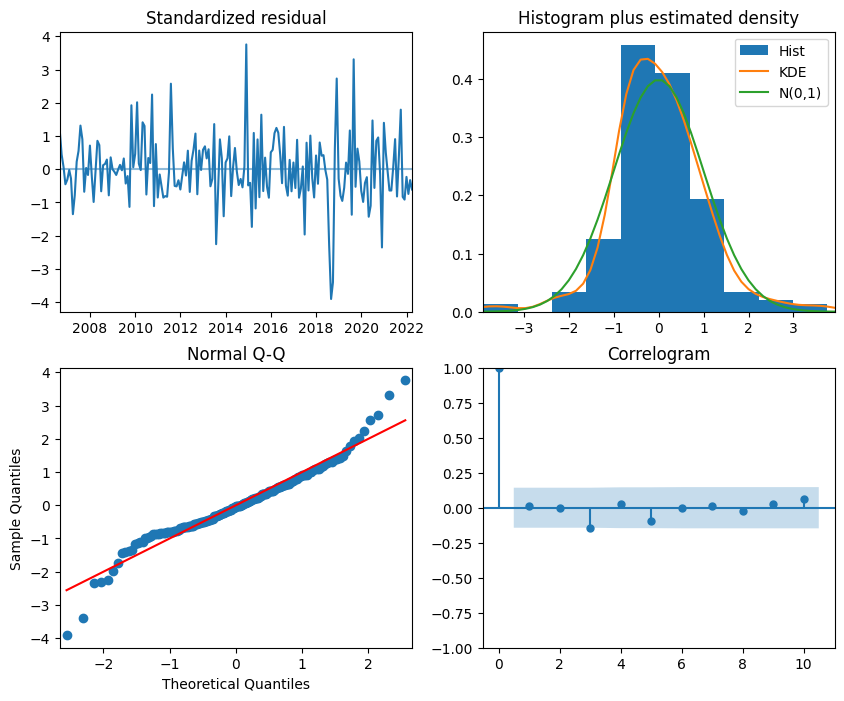

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  200
Model:             SARIMAX(1, 0, 0)x(2, 1, 0, 12)   Log Likelihood                 -24.063
Date:                            Sat, 11 May 2024   AIC                             58.127
Time:                                    08:42:06   BIC                             74.309
Sample:                                08-31-2005   HQIC                            64.683
                                     - 03-31-2022                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0015      0.001     -1.082      0.279      -0.004       0.001
ar.L1          0.2978      0.058   

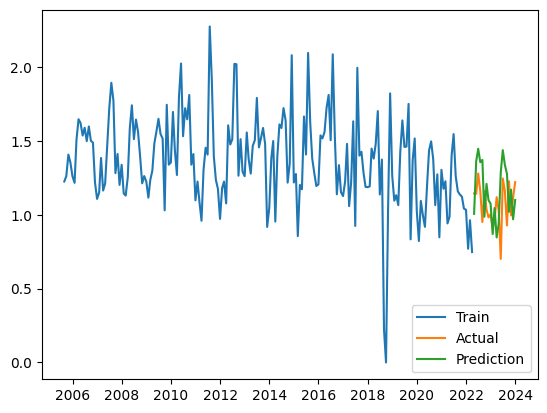

[0.00599884] [[-0.00697979]] [[0.0050179]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.04491885162554436

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.5}
[0.00598801] [[-0.00696896]] [[0.00500706]]
Mean of Residuals -0.17486422313495903
Mean of Residuals -0.17364169646185565


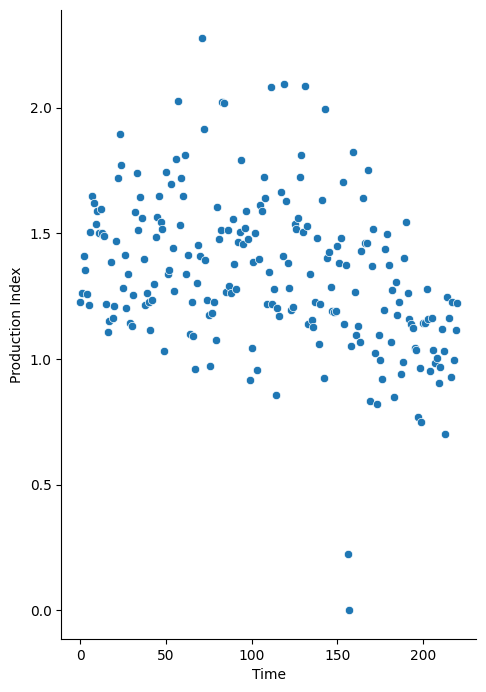

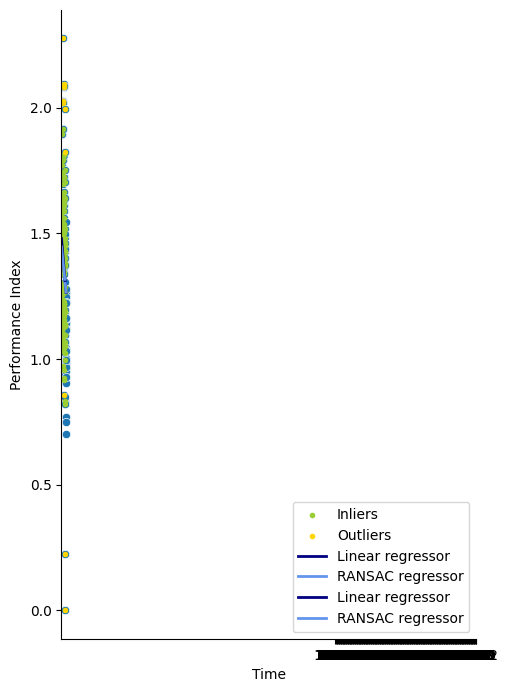

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.67544578] [[-4.70678625]] [[4.64410532]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8518073948120343

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.64024585] [[-4.67158631]] [[4.60890538]]
[10.15114214] [[-10.19150613]] [[10.11077814]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.683960016874236

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[6.0016155] [[-6.04197949]] [[5.9612515]]
[16.92870541] [[-16.97353755]] [[16.88387327]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.721819188659354

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[18.25698755] [[-18.30181969]] [[18.21215541]]
[5.47516031] [[-5.53504253]] [[5.41527808]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -96.0969854576117

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[4.88429852] [[-4.94418075]] [[4.8244163]]
[2.08302661] [[-2.13326984]] [[2.03278338]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5873027075954133

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.40422756] [[-4.45447079]] [[4.35398433]]
[14.08023531] [[-13.97365154]] [[14.18681908]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.45305631] [[-10.34647254]] [[10.55964008]]
[4.8208051] [[-4.78188597]] [[4.85972423]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.7660920264893466

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.75715066] [[-4.71823153]] [[4.79606978]]
[3.17494475] [[-3.29389844]] [[3.05599105]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -7.27222776752146

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[3.17494475] [[-3.29389844]] [[3.05599105]]
[4.86915624] [[-4.90985479]] [[4.82845769]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.1193549682114505

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.86915624] [[-4.90985479]] [[4.82845769]]
[8.04671112] [[-8.07725252]] [[8.01616973]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9933381390136495

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.05959699] [[-10.09013839]] [[10.0290556]]
[4.62348059] [[-4.62949356]] [[4.61746762]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -87.26155161176385

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.69491974] [[-5.70093271]] [[5.68890677]]
[5.11508048] [[-5.10211573]] [[5.12804524]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2185.74398809889

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.98915291] [[-4.97618816]] [[5.00211767]]
[5.85005093] [[-5.81253364]] [[5.88756823]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.9219418097668082

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.85005093] [[-5.81253364]] [[5.88756823]]
[4.26739171] [[-4.22634606]] [[4.30843736]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -74.21189636607491

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.8519944] [[-2.81094875]] [[2.89304005]]
[5.11761878] [[-5.12675233]] [[5.10848523]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -123.95735468288883

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.40846511] [[-7.41759866]] [[7.39933156]]
[9.95298633] [[-9.97048787]] [[9.93548479]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2900.7529938929397

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[6.6878945] [[-6.70539604]] [[6.67039296]]
[7.32727923] [[-7.34177109]] [[7.31278737]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -6.696376780154724

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[8.32055705] [[-8.33504891]] [[8.30606519]]
[7.22988738] [[-7.28801174]] [[7.17176302]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9141580537263314

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.70816196] [[-15.76628632]] [[15.6500376]]
[7.91859231] [[-7.95076959]] [[7.88641503]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.4012717086921542

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[8.13262893] [[-8.16480621]] [[8.10045165]]
[7.74812825] [[-7.78502308]] [[7.71123343]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4533680586419881

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[7.74812825] [[-7.78502308]] [[7.71123343]]
[10.93825572] [[-10.94744997]] [[10.92906147]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0602313340462652

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.4367823] [[-13.44597655]] [[13.42758805]]
[8.78403209] [[-8.75043498]] [[8.81762921]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -7.531386940772651

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[8.78403209] [[-8.75043498]] [[8.81762921]]
[4.92947686] [[-4.95192167]] [[4.90703206]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.8357745723370877

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[11.17834789] [[-11.20079269]] [[11.15590308]]
[12.47672004] [[-12.4538686]] [[12.49957149]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.1426733993767684

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[3.39586095] [[-3.3730095]] [[3.4187124]]
[1.33529379] [[-1.34753957]] [[1.323048]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18143.47348747931

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.47757449] [[-4.48982027]] [[4.4653287]]
[5.33296834] [[-5.323545]] [[5.34239168]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -6241.979841949788

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[5.33296834] [[-5.323545]] [[5.34239168]]
[2.19168738] [[-2.19849282]] [[2.18488195]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -227.64617120304806

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.32706338] [[-4.33386881]] [[4.32025794]]
[15.17960861] [[-15.14694539]] [[15.21227182]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -33.52334925806879

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[8.37994263] [[-8.34727942]] [[8.41260585]]
[2.408764] [[-2.42110266]] [[2.39642535]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.9732560285680745

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.94263822] [[-1.95497687]] [[1.93029956]]
[3.88466394] [[-3.92606088]] [[3.84326699]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9.297553892219161

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[8.23089819] [[-8.27229514]] [[8.18950125]]
[12.23113467] [[-12.19350765]] [[12.26876169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -81.83809146751807

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[13.06000696] [[-13.02237994]] [[13.09763398]]
[4.60670534] [[-4.57436596]] [[4.63904472]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -4.6932158594929

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.60670534] [[-4.57436596]] [[4.63904472]]
[7.51075624] [[-7.60760332]] [[7.41390917]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.794753157281674

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.69118417] [[-8.78803125]] [[8.59433709]]
[13.03773234] [[-13.08821405]] [[12.98725064]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -194325.28325264028

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[13.28937014] [[-13.33985184]] [[13.23888843]]
[8.41917331] [[-8.36008932]] [[8.4782573]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1.3827890681219799

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[8.41917331] [[-8.36008932]] [[8.4782573]]
[11.25973595] [[-11.29961335]] [[11.21985856]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.297540401861273

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.75032829] [[-11.79020568]] [[11.71045089]]
[12.86206646] [[-12.80588608]] [[12.91824683]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -44.358828495215484

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[5.08965315] [[-5.03347278]] [[5.14583352]]
[3.4039968] [[-3.41796015]] [[3.39003346]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -44.560425246674626

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.54752641] [[-2.56148976]] [[2.53356307]]
[3.20659907] [[-3.20918304]] [[3.20401511]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -1.173524245522209

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[3.20659907] [[-3.20918304]] [[3.20401511]]
[2.25058584] [[-2.35008368]] [[2.15108799]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -10.518585335511577

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.75}
[2.25058584] [[-2.35008368]] [[2.15108799]]
[4.83903001] [[-4.89519624]] [[4.78286378]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.039453447490908

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.59383866] [[-6.65000489]] [[6.53767243]]
[3.93008497] [[-3.93467929]] [[3.92549065]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -532.8318134385755

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[4.00677084] [[-4.01136516]] [[4.00217652]]
[0.46809347] [[-0.49754838]] [[0.43863856]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -137.3595091301677

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[0.46809347] [[-0.49754838]] [[0.43863856]]
[8.56068747] [[-8.64368526]] [[8.47768968]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -52.98875017386155

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[11.95917418] [[-12.04217197]] [[11.87617639]]
[9.88241256] [[-9.99181183]] [[9.77301328]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -7287.2426750807235

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[14.98388661] [[-15.09328589]] [[14.87448733]]
[7.57662696] [[-7.54982287]] [[7.60343106]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2.7240295537331223

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[5.68770158] [[-5.66089749]] [[5.71450568]]
[20.17255779] [[-20.10619522]] [[20.23892036]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.947889580241212

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[20.17255779] [[-20.10619522]] [[20.23892036]]
[9.0732708] [[-9.19063041]] [[8.95591118]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6656958348134373

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[7.59572101] [[-7.71308062]] [[7.4783614]]
[1.86215163] [[-1.87551231]] [[1.84879095]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.154143950238365

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.86215163] [[-1.87551231]] [[1.84879095]]
[8.90810687] [[-8.82482364]] [[8.9913901]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.14075771] [[-10.05747448]] [[10.22404094]]
[11.38671256] [[-11.35414497]] [[11.41928015]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -19.49840781240407

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[11.38671256] [[-11.35414497]] [[11.41928015]]
[7.50686397] [[-7.69621215]] [[7.31751579]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.92433501368285

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.22355382] [[-6.412902]] [[6.03420564]]
[10.68031862] [[-10.57431236]] [[10.78632488]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -122.67262298743131

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[7.97809127] [[-7.87208501]] [[8.08409753]]
[8.37526789] [[-8.33653135]] [[8.41400444]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.9944613610024615

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.37526789] [[-8.33653135]] [[8.41400444]]
[6.25807455] [[-6.22225364]] [[6.29389546]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.793301133044505

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.25807455] [[-6.22225364]] [[6.29389546]]
[14.15771484] [[-14.14669467]] [[14.16873502]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9805276540372425

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[17.28398689] [[-17.27296672]] [[17.29500707]]
[7.35563614] [[-7.47343164]] [[7.23784064]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.756817125545546

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[13.55030349] [[-13.66809899]] [[13.43250799]]
[5.63962262] [[-5.59174012]] [[5.68750513]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9112661538110305

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.63962262] [[-5.59174012]] [[5.68750513]]
[3.32048285] [[-3.278451]] [[3.36251471]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -327.21318629358365

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.32048285] [[-3.278451]] [[3.36251471]]
[6.74186976] [[-6.76146857]] [[6.72227095]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.501424228395065

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.94276327] [[-12.96236208]] [[12.92316445]]
[9.19093502] [[-9.21536403]] [[9.166506]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.671556496299876

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[8.44823807] [[-8.47266708]] [[8.42380906]]
[3.63291132] [[-3.646057]] [[3.61976565]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -58.23600730577611

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.42811262] [[-2.4412583]] [[2.41496694]]
[8.52754743] [[-8.42765361]] [[8.62744125]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -514.2344104492295

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[8.52754743] [[-8.42765361]] [[8.62744125]]
[6.66310562] [[-6.71045272]] [[6.61575853]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.369706490288071

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.37420534] [[-5.42155243]] [[5.32685824]]
[4.90056634] [[-4.91240918]] [[4.8887235]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.697909886250317

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.90056634] [[-4.91240918]] [[4.8887235]]
[2.14940859] [[-2.18623296]] [[2.11258421]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -169.57335423277905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.14940859] [[-2.18623296]] [[2.11258421]]
[4.63216069] [[-4.57145637]] [[4.69286502]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9.210693815127872

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.63216069] [[-4.57145637]] [[4.69286502]]
[9.16097752] [[-9.15961424]] [[9.1623408]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -68.4085834495851

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[8.08081029] [[-8.07944701]] [[8.08217357]]
[3.91773324] [[-3.90284187]] [[3.93262462]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -212.90851737878393

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.91773324] [[-3.90284187]] [[3.93262462]]
[4.40572433] [[-4.39237545]] [[4.41907321]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -3.357416010018696

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.40572433] [[-4.39237545]] [[4.41907321]]
[3.69042676] [[-3.70174244]] [[3.67911108]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -127.53773825345857

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[12.01412754] [[-12.02544323]] [[12.00281186]]
[5.69679373] [[-5.7280705]] [[5.66551696]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -3.365244850952199

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[5.69679373] [[-5.7280705]] [[5.66551696]]
[3.23872952] [[-3.21991618]] [[3.25754287]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5658850600752062

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.33963732] [[-1.32082397]] [[1.35845066]]
               Production Index  Time
DateTimeIndex                        
2005-08-31             1.274161     0
2005-09-30             1.261523     1
2005-10-31             1.407959     2
2005-11-30             1.354244     3
2005-12-31             1.265316     4
...                         ...   ...
2023-08-31             0.931930   216
2023-09-30             1.227497   217
2023-10-31             0.996232   218
2023-11-30             1.122224   219
2023-12-31             1.221625   220

[221 rows x 2 columns]


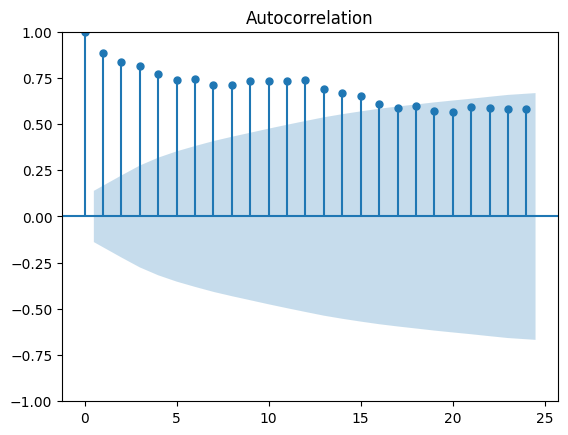

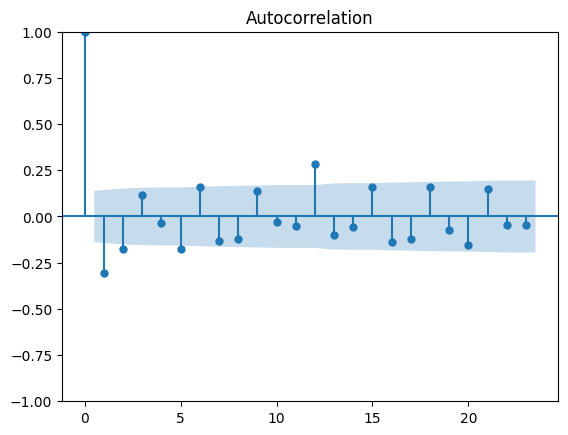

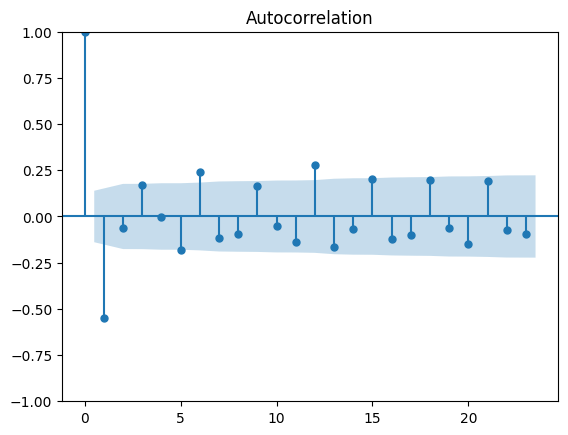

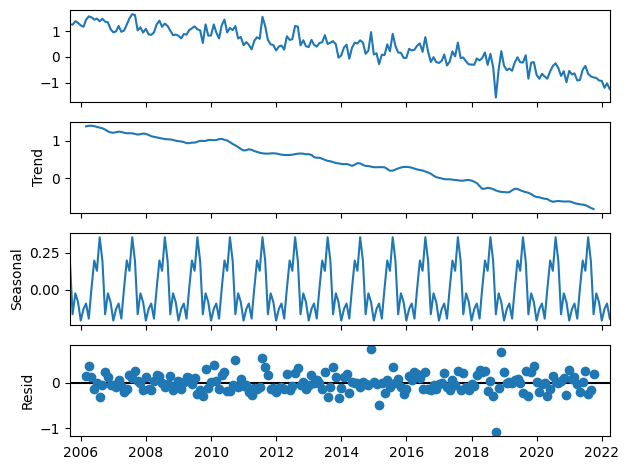

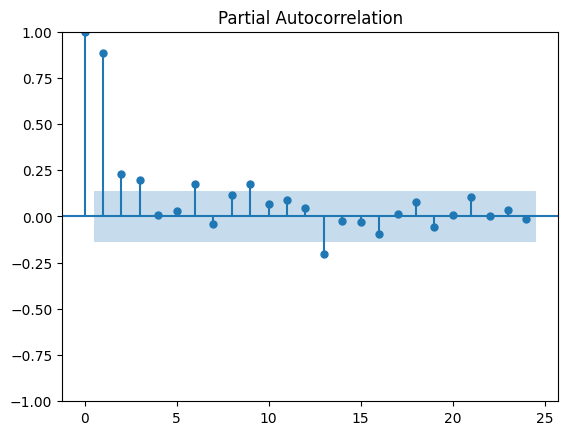

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=3.02 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=101.749, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=52.321, Time=1.66 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.59 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=99.749, Time=0.14 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=92.959, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=33.908, Time=3.30 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=7.48 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=2.11 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=39.628, Time=3.35 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=34.932, Time=3.61 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=35.178, Time=5.51 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=33.183, Time=1.87 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=51.507, Time=1.23 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=inf, Time=5.30 

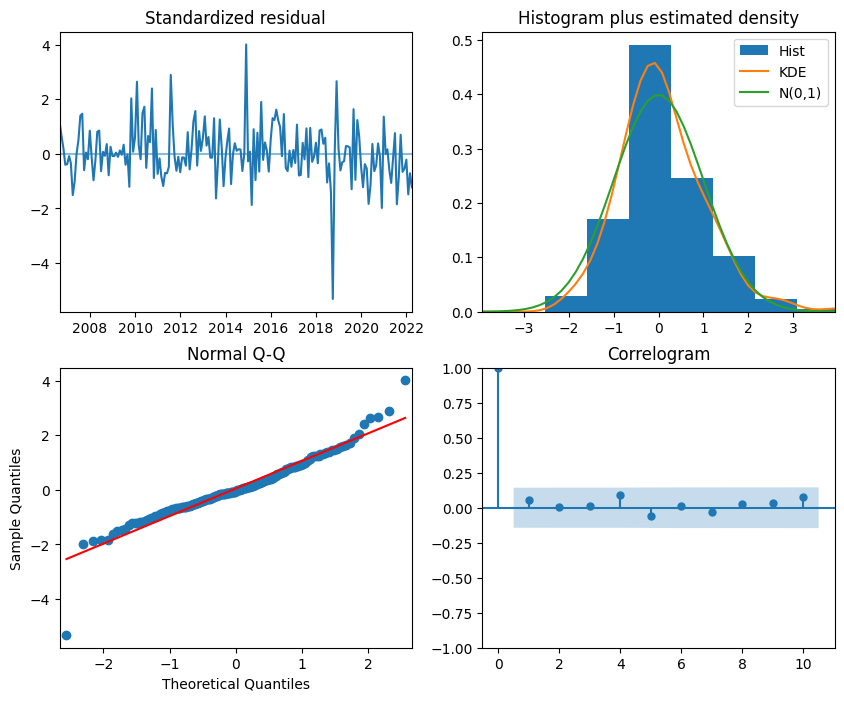

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  200
Model:             SARIMAX(0, 0, 1)x(1, 1, 1, 12)   Log Likelihood                   0.627
Date:                            Sat, 11 May 2024   AIC                             10.746
Time:                                    08:44:06   BIC                             30.165
Sample:                                08-31-2005   HQIC                            18.614
                                     - 03-31-2022                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.1360      0.000   1103.411      0.000       0.136       0.136
Time          -0.0133      0.001   

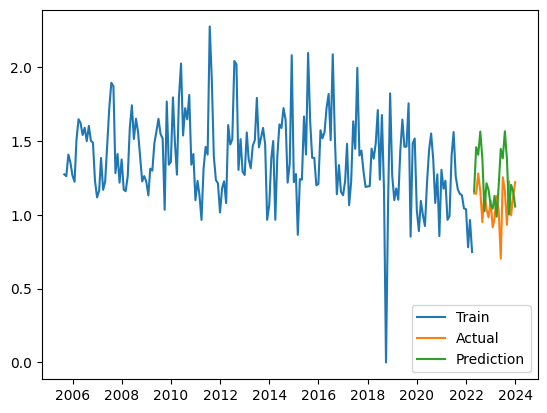

[0.00676833] [[-0.00747656]] [[0.00606011]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=25, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.028202826882990452

 The best parameters across ALL searched params:
 {'min_samples': 25, 'residual_threshold': 0.5}
[0.00654923] [[-0.00725746]] [[0.005841]]
Mean of Residuals -0.21754953224769172
Mean of Residuals -0.20490076687488876


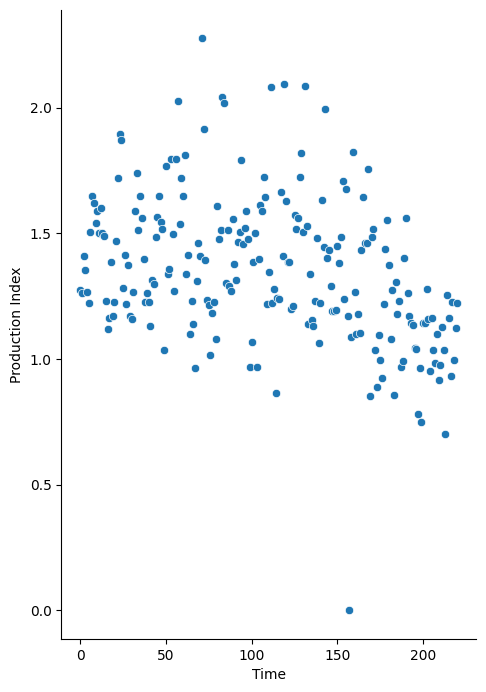

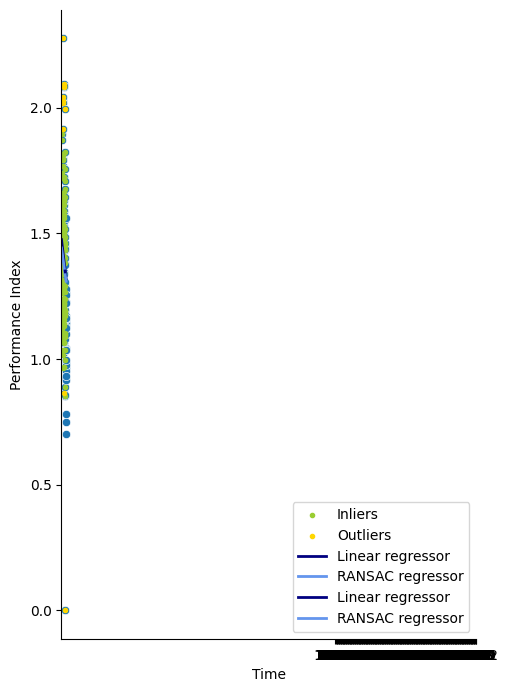

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.59273715] [[-4.6240709]] [[4.5614034]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8514365938606762

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.5569527] [[-4.58828645]] [[4.52561895]]
[10.15540011] [[-10.19618198]] [[10.11461824]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.707650832045083

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[6.88703795] [[-6.92781982]] [[6.84625609]]
[16.82750341] [[-16.87147425]] [[16.78353258]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5742311569605283

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[18.14154201] [[-18.18551284]] [[18.09757118]]
[5.41967675] [[-5.47887541]] [[5.36047809]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -84.71454763626754

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[6.05869361] [[-6.11789227]] [[5.99949495]]
[1.99822454] [[-2.04770353]] [[1.94874554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6116463696725865

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.35647414] [[-4.40595314]] [[4.30699515]]
[13.97781241] [[-13.87262293]] [[14.08300189]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.30934526] [[-10.20415578]] [[10.41453473]]
[4.77494641] [[-4.73731281]] [[4.81258002]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8149205430341911

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.77211302] [[-4.73447941]] [[4.80974662]]
[2.70297621] [[-2.81618107]] [[2.58977136]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -7.183481139434069

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[2.70297621] [[-2.81618107]] [[2.58977136]]
[1.8833317] [[-1.89624184]] [[1.87042156]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.023903144311849

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.8833317] [[-1.89624184]] [[1.87042156]]
[7.69983306] [[-7.72788872]] [[7.6717774]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -66.45722844953296

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[9.66563928] [[-9.69369494]] [[9.63758363]]
[4.63573773] [[-4.64175134]] [[4.62972412]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -81.70692339444614

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.70786571] [[-5.71387932]] [[5.7018521]]
[5.09717571] [[-5.08461574]] [[5.10973568]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2424.6005745740163

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.97224313] [[-4.95968316]] [[4.9848031]]
[5.83895346] [[-5.80204725]] [[5.87585967]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.7825435614390304

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.83895346] [[-5.80204725]] [[5.87585967]]
[4.59414924] [[-4.55164257]] [[4.63665591]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -138.8714279599175

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.83959167] [[-2.797085]] [[2.88209834]]
[5.11761878] [[-5.12675233]] [[5.10848523]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -123.95735468288883

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.40846511] [[-7.41759866]] [[7.39933156]]
[9.89532593] [[-9.91282747]] [[9.87782439]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2900.7529938929397

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[6.630322] [[-6.64782354]] [[6.61282046]]
[7.34558874] [[-7.36302992]] [[7.32814757]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -3.493535585821456

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.5829011] [[-7.60034228]] [[7.56545993]]
[7.35173112] [[-7.41692955]] [[7.2865327]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5925641697798016

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[14.88396826] [[-14.94916668]] [[14.81876983]]
[7.94587672] [[-7.98176643]] [[7.90998702]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3853898621769296

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.19589931] [[-8.23178901]] [[8.1600096]]
[7.74812825] [[-7.78502308]] [[7.71123343]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4533680586419881

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[7.74812825] [[-7.78502308]] [[7.71123343]]
[10.92323753] [[-10.93243178]] [[10.91404328]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0602313340462652

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.43211687] [[-13.44131113]] [[13.42292262]]
[8.81760569] [[-8.78429193]] [[8.85091944]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -12.050209146270372

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[8.81760569] [[-8.78429193]] [[8.85091944]]
[4.58502224] [[-4.60199504]] [[4.56804944]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.840499647543413

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[11.17834789] [[-11.19532068]] [[11.16137509]]
[12.47672004] [[-12.4538686]] [[12.49957149]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.1426733993767684

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[3.39586095] [[-3.3730095]] [[3.4187124]]
[1.24038038] [[-1.24712894]] [[1.23363181]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7960.491308529326

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.86660182] [[-3.87335038]] [[3.85985325]]
[5.17290905] [[-5.16573039]] [[5.1800877]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -6008.90878460597

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[5.17290905] [[-5.16573039]] [[5.1800877]]
[2.215171] [[-2.22246332]] [[2.20787868]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -141.9582003918018

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.37466329] [[-4.38195561]] [[4.36737097]]
[15.44593997] [[-15.41316006]] [[15.47871988]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -30.92668547126836

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[8.16805261] [[-8.1352727]] [[8.20083251]]
[3.62835744] [[-3.63107902]] [[3.62563585]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.509092782352791

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.94263822] [[-1.9453598]] [[1.93991663]]
[3.74031962] [[-3.77996676]] [[3.70067248]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -10.676851468027497

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[7.96741837] [[-8.00706551]] [[7.92777123]]
[12.23113467] [[-12.19350765]] [[12.26876169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -81.83809146751807

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[13.06000696] [[-13.02237994]] [[13.09763398]]
[4.60670534] [[-4.57436596]] [[4.63904472]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -4.6932158594929

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.60670534] [[-4.57436596]] [[4.63904472]]
[7.10287446] [[-7.19629011]] [[7.00945882]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.931542290973716

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[8.25098619] [[-8.34440183]] [[8.15757055]]
[12.97984185] [[-13.03032356]] [[12.92936014]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -194325.28325264028

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[13.23709011] [[-13.28757182]] [[13.18660841]]
[8.41917331] [[-8.36008932]] [[8.4782573]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1.3827890681219799

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[8.41917331] [[-8.36008932]] [[8.4782573]]
[11.18717656] [[-11.22568435]] [[11.14866877]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.234425170253767

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.65585229] [[-11.69436008]] [[11.6173445]]
[12.86206646] [[-12.80588608]] [[12.91824683]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -44.358828495215484

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[5.08965315] [[-5.03347278]] [[5.14583352]]
[4.52127998] [[-4.5349445]] [[4.50761546]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -41.96530051434188

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.17352447] [[-3.18718899]] [[3.15985996]]
[3.10967334] [[-3.11694048]] [[3.1024062]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -1.359978019451993

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[3.10967334] [[-3.11694048]] [[3.1024062]]
[2.49469055] [[-2.5941884]] [[2.39519271]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -10.518585335511577

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.75}
[2.49469055] [[-2.5941884]] [[2.39519271]]
[5.07584039] [[-5.13849264]] [[5.01318813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.834704911528563

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.92191799] [[-3.98457025]] [[3.85926574]]
[3.93129852] [[-3.93621912]] [[3.92637791]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -533.8502479225108

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[4.00677084] [[-4.01169144]] [[4.00185024]]
[0.35260825] [[-0.38133595]] [[0.32388055]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -118.50883774740382

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[0.35260825] [[-0.38133595]] [[0.32388055]]
[8.56068747] [[-8.64368526]] [[8.47768968]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -52.98875017386155

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[11.95917418] [[-12.04217197]] [[11.87617639]]
[9.84953312] [[-9.958544]] [[9.74052225]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -7344.672367402729

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[14.94427889] [[-15.05328976]] [[14.83526802]]
[7.48194479] [[-7.45560096]] [[7.50828863]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2.7796778410545273

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[5.57192062] [[-5.54557679]] [[5.59826445]]
[8.14292199] [[-8.07672196]] [[8.20912202]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.530501140440967

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.14292199] [[-8.07672196]] [[8.20912202]]
[9.0985681] [[-9.21587572]] [[8.98126048]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6648521377263578

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[7.58191278] [[-7.6992204]] [[7.46460516]]
[1.84826389] [[-1.86251975]] [[1.83400803]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.410478619409123

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.84826389] [[-1.86251975]] [[1.83400803]]
[8.90177608] [[-8.81869028]] [[8.98486188]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.13477956] [[-10.05169376]] [[10.21786536]]
[11.36312284] [[-11.32962547]] [[11.3966202]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -30.632575560169414

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.13100967] [[-12.09751231]] [[12.16450704]]
[8.93051821] [[-9.16824]] [[8.69279641]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -20.48537975644757

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.73629512] [[-7.97401692]] [[7.49857333]]
[10.36292785] [[-10.26202816]] [[10.46382753]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -117.45707908400183

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[7.70666726] [[-7.60576757]] [[7.80756695]]
[8.19927024] [[-8.15848642]] [[8.24005405]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.672293238467067

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.19927024] [[-8.15848642]] [[8.24005405]]
[6.39057286] [[-6.35441257]] [[6.42673314]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.55143032588746

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.39057286] [[-6.35441257]] [[6.42673314]]
[12.26446856] [[-12.25332003]] [[12.27561709]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.6163359672632622

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.1011222] [[-15.08997367]] [[15.11227073]]
[7.50221729] [[-7.62317224]] [[7.38126234]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8015717271356866

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[13.75262325] [[-13.8735782]] [[13.6316683]]
[5.20052574] [[-5.15993366]] [[5.24111782]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.792627790008032

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.20052574] [[-5.15993366]] [[5.24111782]]
[3.25739091] [[-3.2157834]] [[3.29899843]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -448.8628427414642

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.25739091] [[-3.2157834]] [[3.29899843]]
[6.705286] [[-6.72650077]] [[6.68407124]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -30.23161488496

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[12.9950943] [[-13.01630906]] [[12.97387954]]
[9.16996858] [[-9.19431158]] [[9.14562558]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.6708499165345

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[8.44823807] [[-8.47258107]] [[8.42389507]]
[3.57990521] [[-3.59218045]] [[3.56762997]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -74.49511213031158

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.35886314] [[-2.37113838]] [[2.3465879]]
[8.20405491] [[-8.1062016]] [[8.30190822]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -970.9754807008785

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[8.20405491] [[-8.1062016]] [[8.30190822]]
[6.58249207] [[-6.62871888]] [[6.53626525]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.465087157412709

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.38268568] [[-5.42891249]] [[5.33645886]]
[4.95417245] [[-4.96808572]] [[4.94025918]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0477731422429137

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.95417245] [[-4.96808572]] [[4.94025918]]
[2.14619115] [[-2.18354311]] [[2.10883919]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -167.5964472846544

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.14619115] [[-2.18354311]] [[2.10883919]]
[4.63216069] [[-4.57145637]] [[4.69286502]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9.210693815127872

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.63216069] [[-4.57145637]] [[4.69286502]]
[9.16097752] [[-9.15961424]] [[9.1623408]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -68.4085834495851

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[8.08081029] [[-8.07944701]] [[8.08217357]]
[3.91773324] [[-3.90284187]] [[3.93262462]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -212.90851737878393

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.91773324] [[-3.90284187]] [[3.93262462]]
[4.97906722] [[-4.97589094]] [[4.98224349]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.070183050980793

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.97906722] [[-4.97589094]] [[4.98224349]]
[3.68568977] [[-3.69694261]] [[3.67443692]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -127.70003304052041

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[12.08654706] [[-12.0977999]] [[12.07529421]]
[5.73764088] [[-5.77062418]] [[5.70465758]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -3.199093558157088

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[5.73764088] [[-5.77062418]] [[5.70465758]]
[3.248872] [[-3.23007987]] [[3.26766413]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5556296611756804

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.33160694] [[-1.31281481]] [[1.35039907]]
               Production Index  Time
DateTimeIndex                        
2006-08-31             1.598231     0
2006-09-30             1.501625     1
2006-10-31             1.488518     2
2006-11-30             1.220472     3
2006-12-31             1.107734     4
2007-01-31             1.151210     5
2007-02-28             1.385071     6
2007-03-31             1.164237     7
2007-04-30             1.212097     8
2007-05-31             1.470821     9
2007-06-30             1.720001    10
2007-07-31             1.894303    11
2007-08-31             1.771946    12
2007-09-30             1.

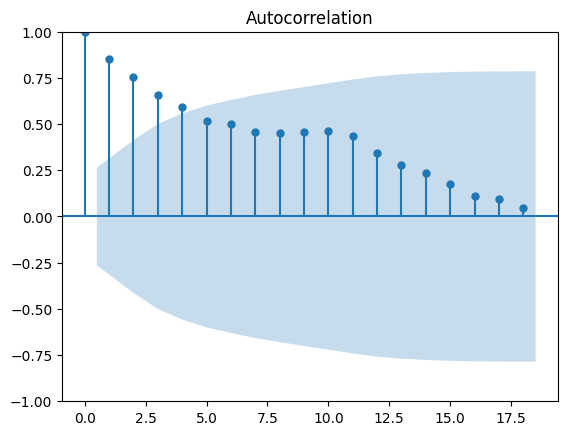

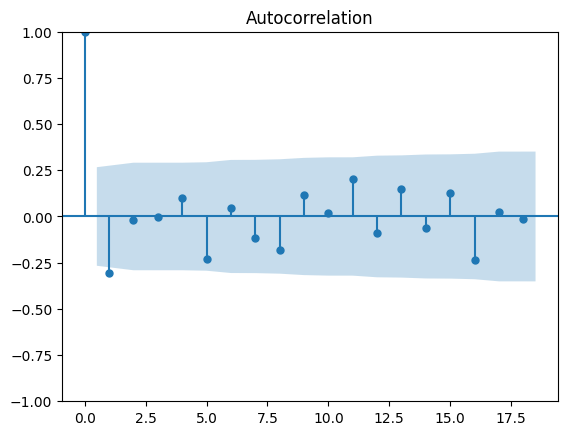

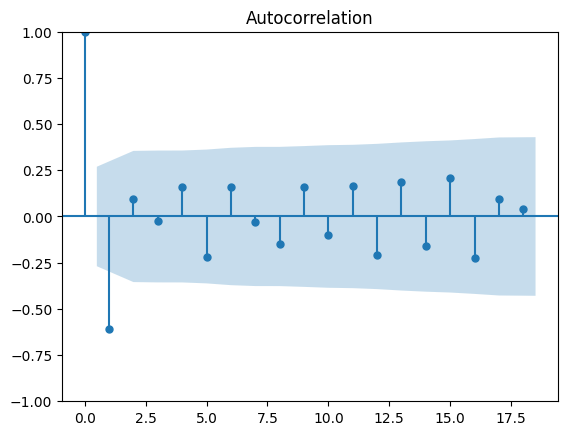

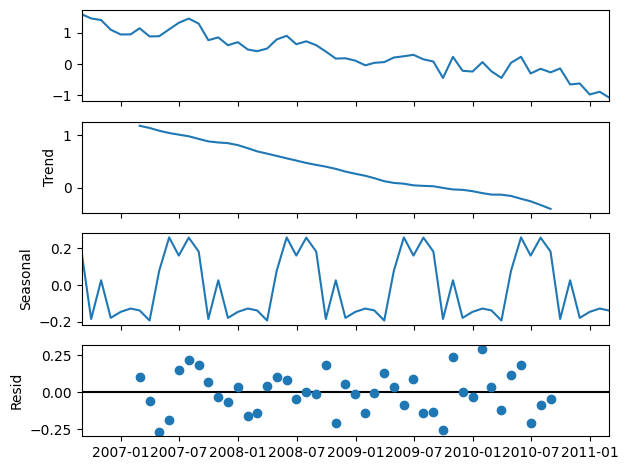

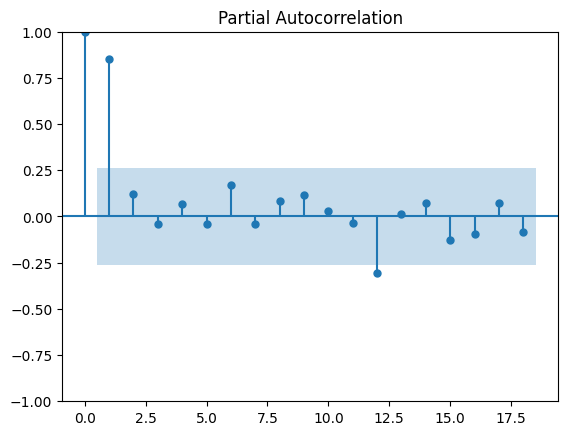

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.90 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=14.728, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-2.748, Time=1.18 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.00 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=12.728, Time=0.11 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=16.560, Time=0.08 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-1.939, Time=1.24 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-2.180, Time=1.02 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.63 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=0.058, Time=2.03 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-2.393, Time=0.37 sec
 ARIMA(2,0,0)(1,1,0)[12] intercept   : AIC=-0.756, Time=0.81 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-0.368, Time=0.91 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-2.643, Time=0.49 sec
 ARIMA(2,0,1)(1,1,0)[12] intercept   : AIC=1.250, Time=1.

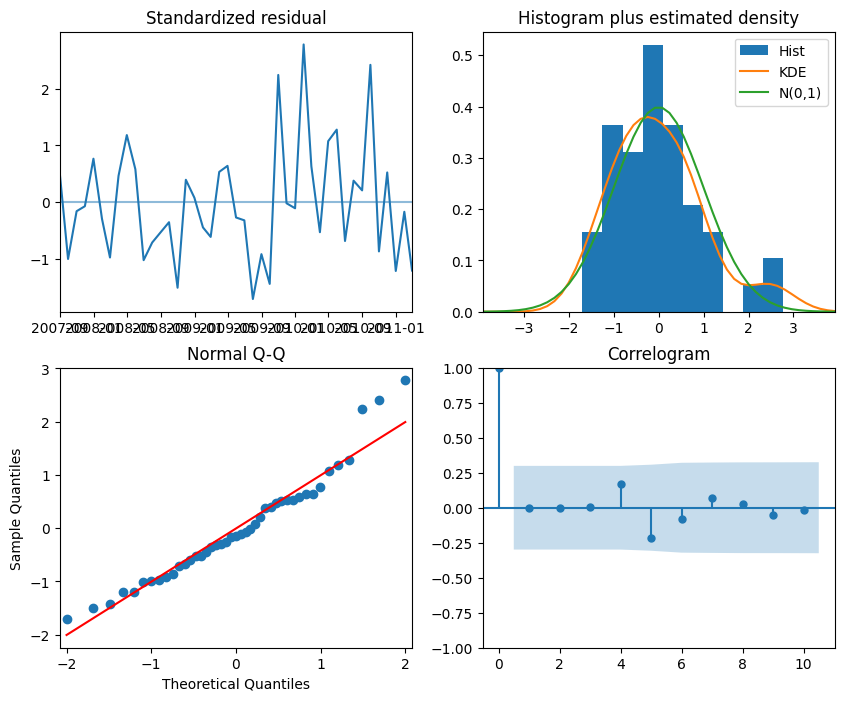

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(1, 1, 0, 12)   Log Likelihood                   6.374
Date:                            Sat, 11 May 2024   AIC                             -4.748
Time:                                    08:45:08   BIC                              2.296
Sample:                                08-31-2006   HQIC                            -2.151
                                     - 02-28-2011                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0021      0.002      0.927      0.354      -0.002       0.007
ar.L1          0.2383      0.173   

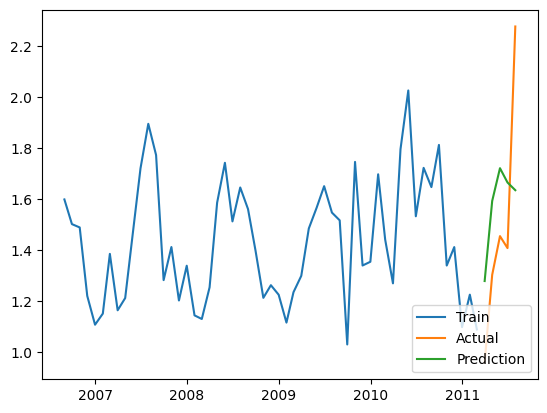

[0.07584697] [[-0.07167056]] [[0.08002339]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.08796884727191304

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.07535867] [[-0.07118226]] [[0.07953509]]
Mean of Residuals -0.14331950340548774
Mean of Residuals -0.13710156231994433


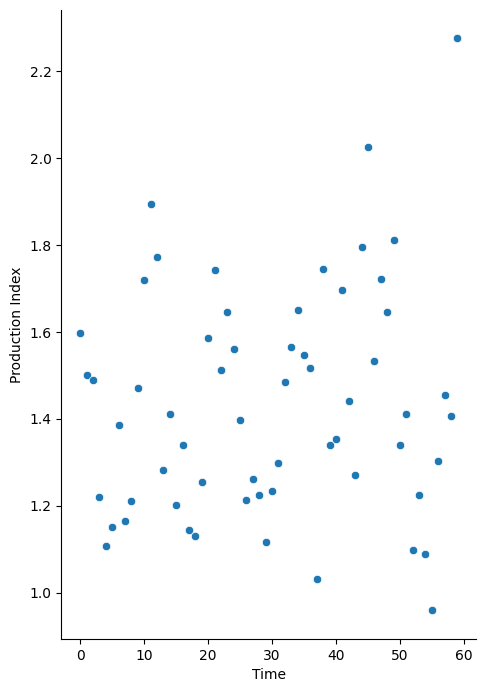

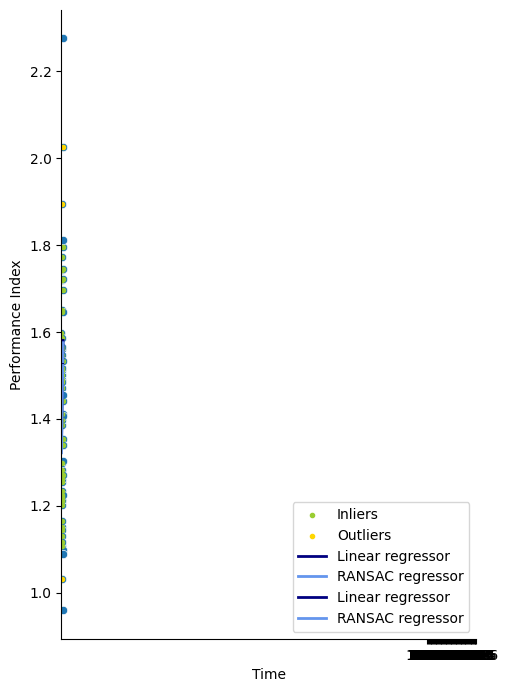

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                         Hitra
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2017-09-20 06:00:00  21.918982
2017-10-02 03:00:00  21.665161
2017-10-02 05:00:00  23.059935
2023-04-13 19:00:00  21.124432
2023-11-03 19:00:00  19.423389

[194491 rows x 1 columns]
##################Kjøllefjord###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2007-09-24 23:00:00   5.866519  279.702454   99135.843750         0.094395
2007-09-25 00:00:00   5.862122  279.514038   99125.773438         0.094529
2007-09-25 01:00:00   5.352455  279.499725   99110.851562         0.094620
2007-09-25 02:00:00   4.995168  279.380310   99069.234375         0.094742
2007-09-25 03:00:00   4.984

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.637430e+06
dtype: float64
             Observasjoner tot prod  Observasjoner valid prod  \
Kjøllefjord                  192840                    142609   

             Missing values prod  Negative values prod  Zero values prod  \
Kjøllefjord                    0                     0             13354   

             Prod over capacity  Observasjoner df_windpowerlib  \
Kjøllefjord                  39                         142609   

             Missing values wind_peed  Missing values temperature  \
Kjøllefjord                       NaN                         NaN   

             Missing values pressure  Missing values roughness_length  \
Kjøllefjord                      NaN                              NaN   

             Observasjoner sim  Zero values sim  
Kjøllefjord             142609            16399  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Kjøllefjord
2002-12-31          NaN
2003-12-31          NaN
2004-12-31          NaN
2005-12-31          NaN
2006-12-31          NaN
2007-12-31     0.212495
2008-12-31     0.626138
2009-12-31     0.205479
2010-12-31     0.433790
2011-12-31     0.696347
2012-12-31     0.933515
2013-12-31     0.833333
2014-12-31     0.353881
2015-12-31     0.148402
2016-12-31     0.489526
2017-12-31     3.424658
2018-12-31     0.388128
2019-12-31     0.445205
2020-12-31     1.923953
2021-12-31     3.675799
2022-12-31     1.289954
2023-12-31     1.917808 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.608318e+06
dtype: float64


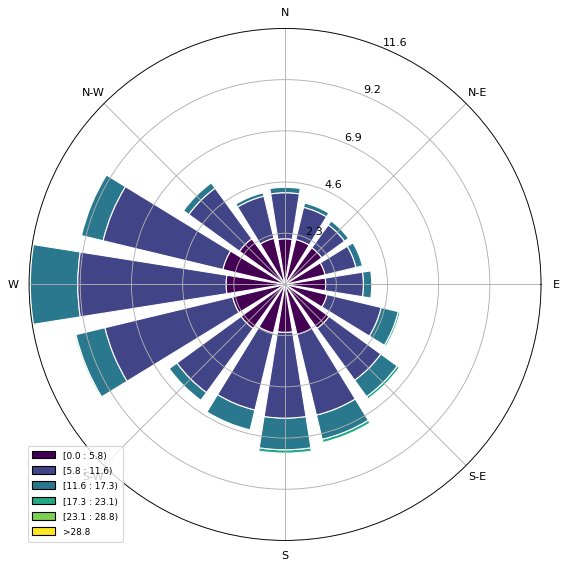

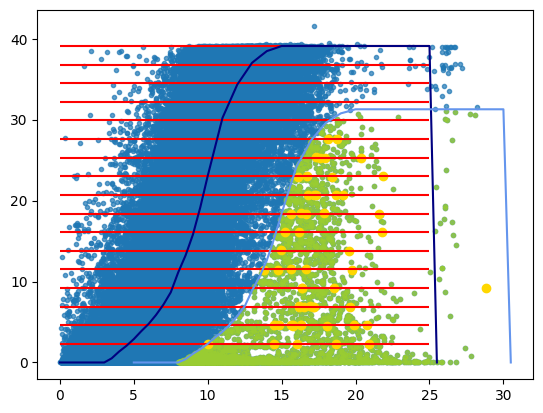

               Production Index  Time
DateTimeIndex                        
2007-09-30             1.049667     0
2007-10-31             1.149751     1
2007-11-30             1.112439     2
2007-12-31             1.011310     3
2008-01-31             1.029838     4
...                         ...   ...
2023-08-31             0.731285   191
2023-09-30             1.056558   192
2023-10-31             1.131534   193
2023-11-30             1.336707   194
2023-12-31             1.099492   195

[196 rows x 2 columns]


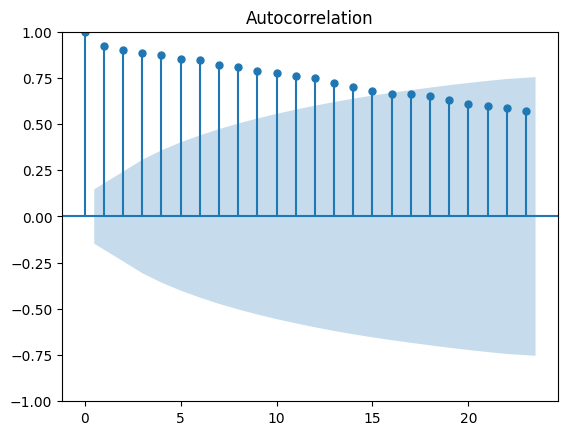

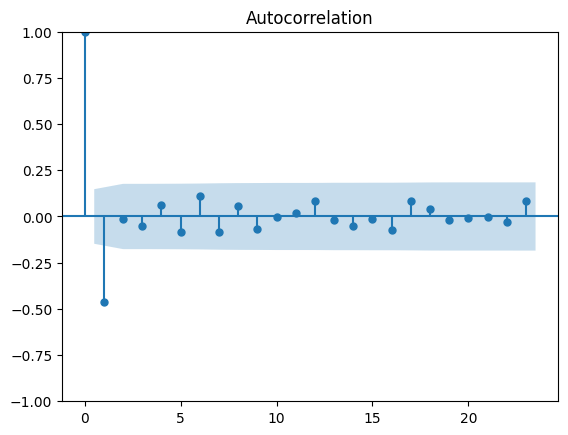

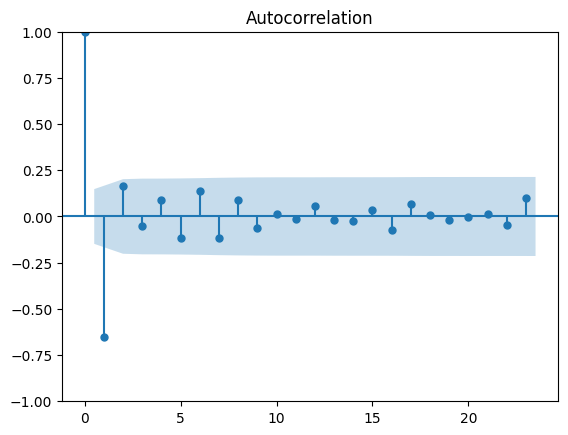

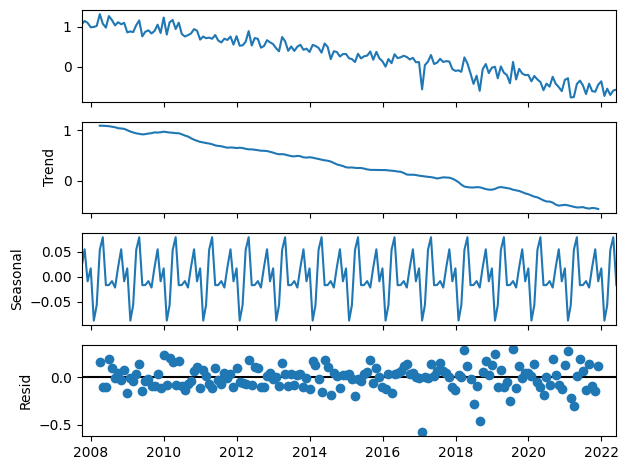

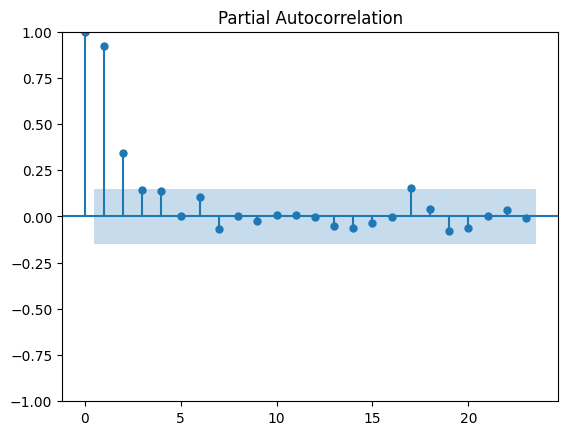

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.75 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-70.490, Time=0.11 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-99.934, Time=1.59 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-138.014, Time=2.80 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-72.490, Time=0.18 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-69.554, Time=0.14 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=inf, Time=4.06 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=7.64 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-99.866, Time=1.77 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=3.42 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=1.88 sec
 ARIMA(0,0,2)(0,1,1)[12] intercept   : AIC=inf, Time=3.07 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=3.65 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=inf, Time=2.81 sec
 ARIMA(0,0,1)(0,1,1)[12]             : AIC=inf, Time=1.84 sec

B

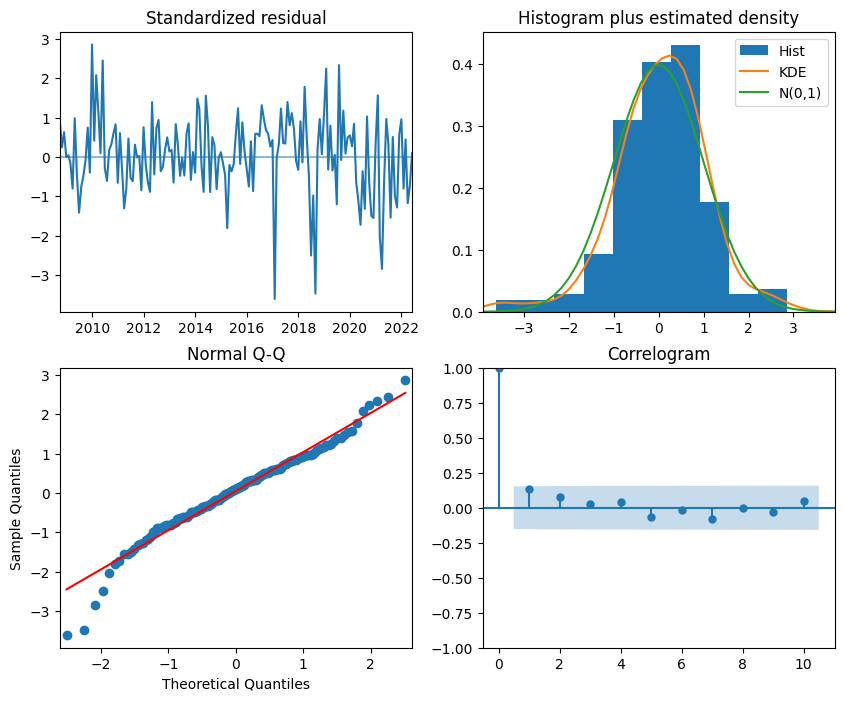

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  177
Model:             SARIMAX(0, 0, 1)x(0, 1, 1, 12)   Log Likelihood                  74.007
Date:                            Sat, 11 May 2024   AIC                           -138.014
Time:                                    08:46:10   BIC                           -122.484
Sample:                                09-30-2007   HQIC                          -131.710
                                     - 05-31-2022                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0851   1.94e-05   4378.532      0.000       0.085       0.085
Time          -0.0072      0.000   

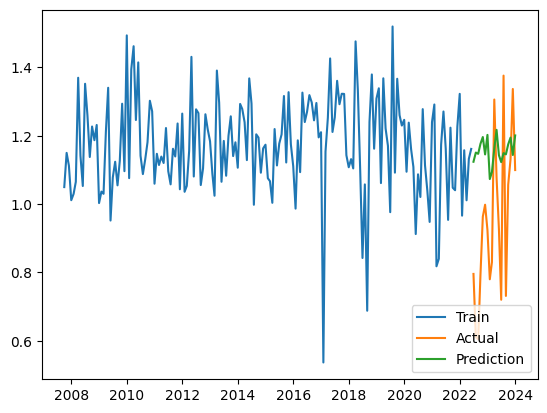

[0.00742477] [[-0.00723974]] [[0.00760981]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -0.020698195510396887

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.75}
[0.00742477] [[-0.00723974]] [[0.00760981]]
Mean of Residuals -0.1664845978467879
Mean of Residuals -0.1664845978467879


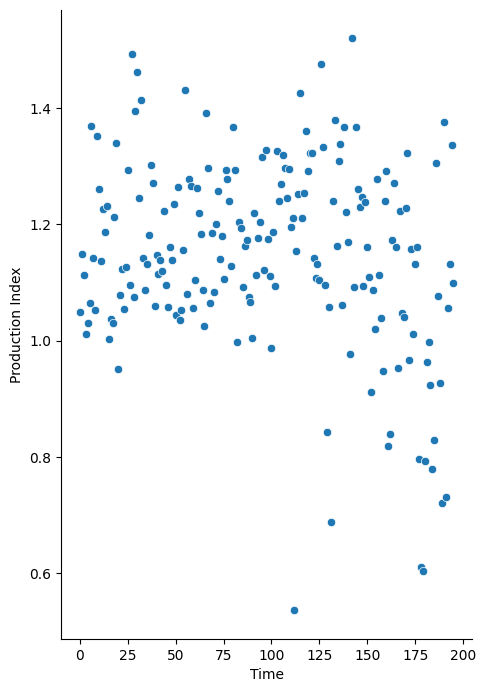

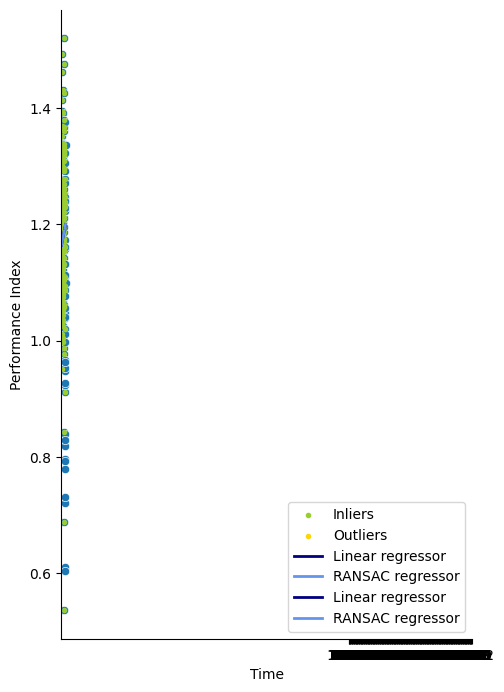

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.89323125] [[-4.88619503]] [[4.90026747]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97.00419457996637

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.89323125] [[-4.88619503]] [[4.90026747]]
[9.87233054] [[-9.86667296]] [[9.87798812]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.429040318884042

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[9.87233054] [[-9.86667296]] [[9.87798812]]
[7.70618625] [[-7.69780437]] [[7.71456813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.7397504868201232

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.70618625] [[-7.69780437]] [[7.71456813]]
[6.37294386] [[-6.37677846]] [[6.36910927]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.994238720256106

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.86333383] [[-5.86716843]] [[5.85949923]]
[5.33779074] [[-5.33491627]] [[5.34066521]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.1621344149049633

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.33779074] [[-5.33491627]] [[5.34066521]]
[2.41742324] [[-2.3895885]] [[2.44525798]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -32.1865229866066

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.41742324] [[-2.3895885]] [[2.44525798]]
[4.56737019] [[-4.62642213]] [[4.50831826]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.23220369968761

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.56737019] [[-4.62642213]] [[4.50831826]]
[1.60104961] [[-1.61358838]] [[1.58851084]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2053.374623019192

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[1.60104961] [[-1.61358838]] [[1.58851084]]
[6.65290805] [[-6.68126435]] [[6.62455176]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.743526330709665

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.65290805] [[-6.68126435]] [[6.62455176]]
[3.25396566] [[-3.22380866]] [[3.28412265]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -263.73181987792236

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[3.25396566] [[-3.22380866]] [[3.28412265]]
[2.23847315] [[-2.26743965]] [[2.20950664]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.977112673585718

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.75999126] [[-2.78895777]] [[2.73102475]]
[1.63442851] [[-1.62019462]] [[1.64866241]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -121.29832435427647

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.63442851] [[-1.62019462]] [[1.64866241]]
[1.95278535] [[-1.98153059]] [[1.9240401]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -217.02934373278086

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.80943201] [[-1.83817726]] [[1.78068677]]
[1.44372625] [[-1.43685671]] [[1.4505958]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.6224605342173

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.44372625] [[-1.43685671]] [[1.4505958]]
[2.56054199] [[-2.57877526]] [[2.54230872]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33.23969518124851

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.56054199] [[-2.57877526]] [[2.54230872]]
[3.67662862] [[-3.63611298]] [[3.71714426]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97474.43047457802

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.67662862] [[-3.63611298]] [[3.71714426]]
[6.89761181] [[-6.91525211]] [[6.87997152]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.658168849894994

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.89761181] [[-6.91525211]] [[6.87997152]]
[0.98252294] [[-0.97167732]] [[0.99336857]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -5.279585724112425

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[0.98252294] [[-0.97167732]] [[0.99336857]]
[7.00925516] [[-7.07186554]] [[6.94664477]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.7843442493616406

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.90328634] [[-6.96589672]] [[6.84067595]]
[7.25176192] [[-7.28463086]] [[7.21889297]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.311436565978067

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.25176192] [[-7.28463086]] [[7.21889297]]
[2.33149411] [[-2.35854159]] [[2.30444662]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6701963832620337

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.79309077] [[-1.82013825]] [[1.76604329]]
[2.5211799] [[-2.50632427]] [[2.53603554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.112172539509842

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[2.2466356] [[-2.23177997]] [[2.26149123]]
[6.4044223] [[-6.45511408]] [[6.35373052]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.432219433278098

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.4044223] [[-6.45511408]] [[6.35373052]]
[3.61263306] [[-3.61915029]] [[3.60611583]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.790861668230451

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.61263306] [[-3.61915029]] [[3.60611583]]
[2.46416232] [[-2.46375676]] [[2.46456789]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -64.96668676212592

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.46416232] [[-2.46375676]] [[2.46456789]]
[5.27634611] [[-5.29577647]] [[5.25691575]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6195790267292167

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.27634611] [[-5.29577647]] [[5.25691575]]
[3.19106355] [[-3.17209793]] [[3.21002917]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19503.07659167893

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.22206233] [[-3.20309671]] [[3.24102795]]
[3.29133821] [[-3.24956351]] [[3.33311291]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.231170189976977

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.29133821] [[-3.24956351]] [[3.33311291]]
[5.04648524] [[-5.07465223]] [[5.01831826]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6279582582113534

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.91787182] [[-6.9460388]] [[6.88970483]]
[2.19809828] [[-2.19226413]] [[2.20393242]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.7349504266873845

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.19809828] [[-2.19226413]] [[2.20393242]]
[3.29402391] [[-3.31049487]] [[3.27755294]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.113020610343291

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.29402391] [[-3.31049487]] [[3.27755294]]
[2.76024215] [[-2.76410006]] [[2.75638423]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.0621817258687636

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.76024215] [[-2.76410006]] [[2.75638423]]
[5.0196002] [[-5.00463009]] [[5.03457031]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.517273177478917

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.0196002] [[-5.00463009]] [[5.03457031]]
[5.87543282] [[-5.8487062]] [[5.90215944]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.870178425137135

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.87543282] [[-5.8487062]] [[5.90215944]]
[3.33893626] [[-3.35081267]] [[3.32705985]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.451947112716326

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.33893626] [[-3.35081267]] [[3.32705985]]
[1.66693895] [[-1.69351531]] [[1.64036259]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -34.28270071358859

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[1.66693895] [[-1.69351531]] [[1.64036259]]
[4.04229307] [[-4.02249448]] [[4.06209167]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -10.05221787262245

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.04229307] [[-4.02249448]] [[4.06209167]]
[6.18389636] [[-6.07782313]] [[6.28996959]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -270.78089749031267

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[11.01634619] [[-10.91027296]] [[11.12241942]]
[1.01737359] [[-1.0317194]] [[1.00302777]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -100.16897516255432

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.01737359] [[-1.0317194]] [[1.00302777]]
[7.64107066] [[-7.6560557]] [[7.62608562]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20516.734847330437

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.64107066] [[-7.6560557]] [[7.62608562]]
[5.4724434] [[-5.48375886]] [[5.46112794]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -196.94224626750363

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.26646468] [[-7.27778014]] [[7.25514923]]
[5.76601314] [[-5.74204053]] [[5.78998575]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.76601314] [[-5.74204053]] [[5.78998575]]
[4.77400487] [[-4.81711886]] [[4.73089088]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -11.224912966143654

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.77400487] [[-4.81711886]] [[4.73089088]]
[6.37426555] [[-6.37283991]] [[6.37569119]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -443534.691133499

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[6.37426555] [[-6.37283991]] [[6.37569119]]
[6.19114602] [[-6.22055289]] [[6.16173914]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.5811378858795218

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.19114602] [[-6.22055289]] [[6.16173914]]
[5.65131331] [[-5.69604911]] [[5.6065775]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -29.94755407909282

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.71444562] [[-4.75918143]] [[4.66970982]]
[3.29669827] [[-3.32322435]] [[3.27017219]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.1764519800659659

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.29669827] [[-3.32322435]] [[3.27017219]]
[7.58357547] [[-7.65214789]] [[7.51500305]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.7049569402737998

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.58357547] [[-7.65214789]] [[7.51500305]]
[2.72435822] [[-2.73418257]] [[2.71453388]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -50.068355950698695

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.72435822] [[-2.73418257]] [[2.71453388]]
[4.36404695] [[-4.33984788]] [[4.38824601]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -30.374743249173157

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.36404695] [[-4.33984788]] [[4.38824601]]
[3.30287024] [[-3.34607579]] [[3.25966469]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1404.9556158014734

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.43516315] [[-2.4783687]] [[2.3919576]]
[6.79298478] [[-6.76373118]] [[6.82223838]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -29.155168893691503

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[7.3384712] [[-7.3092176]] [[7.36772479]]
[6.25115478] [[-6.23411114]] [[6.26819842]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8482189.600027483

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.25115478] [[-6.23411114]] [[6.26819842]]
[11.11123765] [[-11.23134611]] [[10.99112919]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -28240.771586880066

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[11.11123765] [[-11.23134611]] [[10.99112919]]
[2.18482281] [[-2.18541651]] [[2.18422911]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -27.538176024978924

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.18482281] [[-2.18541651]] [[2.18422911]]
[6.25789082] [[-6.23137969]] [[6.28440195]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -10.095235236207

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[7.79248288] [[-7.76597175]] [[7.81899401]]
[2.27926234] [[-2.25053929]] [[2.30798539]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -220.2169298748654

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.27926234] [[-2.25053929]] [[2.30798539]]
[1.35362944] [[-1.36389248]] [[1.3433664]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.760469374270727

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.17736111] [[-1.18762415]] [[1.16709807]]
[3.8523867] [[-3.84917254]] [[3.85560085]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -24.457393496743833

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.8523867] [[-3.84917254]] [[3.85560085]]
[5.73972247] [[-5.74011497]] [[5.73932997]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -0.0735362579208532

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.73972247] [[-5.74011497]] [[5.73932997]]
[5.12103344] [[-5.14939163]] [[5.09267525]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.6658472731943825

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.12103344] [[-5.14939163]] [[5.09267525]]
[10.11762881] [[-10.11547042]] [[10.11978721]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.420736979106543

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.11762881] [[-10.11547042]] [[10.11978721]]
[6.10294331] [[-6.12537567]] [[6.08051095]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4531989454132777

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.10294331] [[-6.12537567]] [[6.08051095]]
[14.28412348] [[-14.38190042]] [[14.18634654]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.6901113533917068

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[17.19970303] [[-17.29747997]] [[17.10192609]]
[6.36621759] [[-6.32751939]] [[6.40491579]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -10.092309274941066

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.36621759] [[-6.32751939]] [[6.40491579]]
               Production Index  Time
DateTimeIndex                        
2007-09-30             1.049667     0
2007-10-31             1.152197     1
2007-11-30             1.112786     2
2007-12-31             1.013701     3
2008-01-31             1.078599     4
...                         ...   ...
2023-08-31             0.895015   191
2023-09-30             1.111413   192
2023-10-31             1.176208   193
2023-11-30             1.340655   194
2023-12-31             1.103733   195

[196 rows x 2 columns]


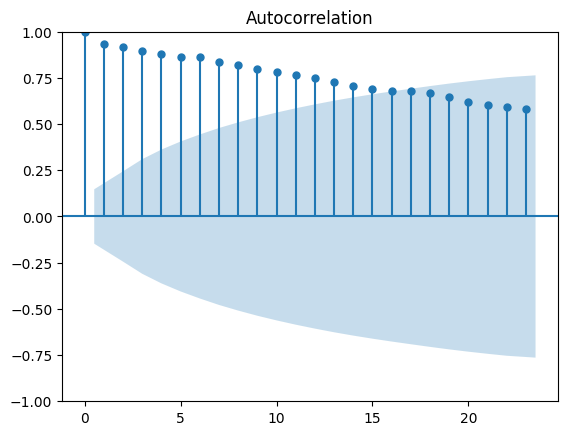

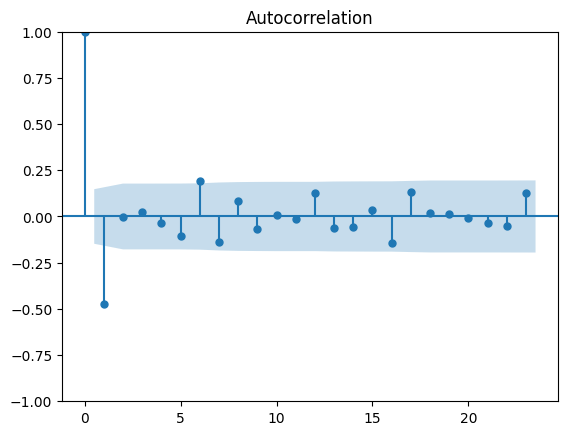

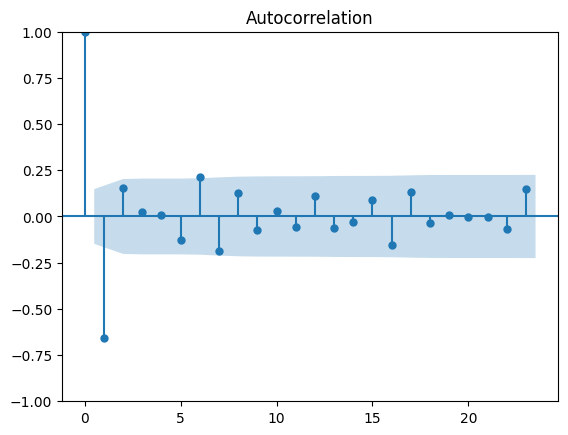

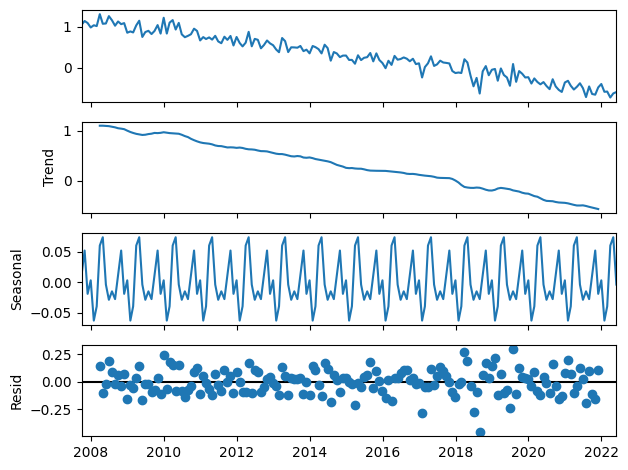

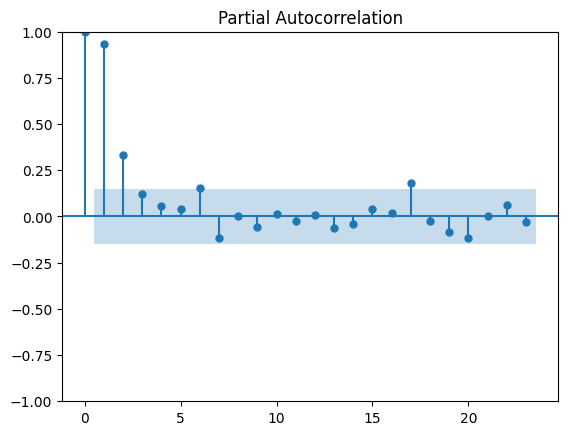

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=4.17 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-105.711, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-134.529, Time=1.05 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.40 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-107.711, Time=0.13 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-107.213, Time=0.12 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-146.812, Time=3.02 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=7.94 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-173.043, Time=3.89 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=3.01 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=-172.314, Time=4.24 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=-173.691, Time=2.63 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=-174.064, Time=2.56 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=2.35 sec
 ARIMA(0,0,0)(1,1,2)[12] intercept   : AIC=i

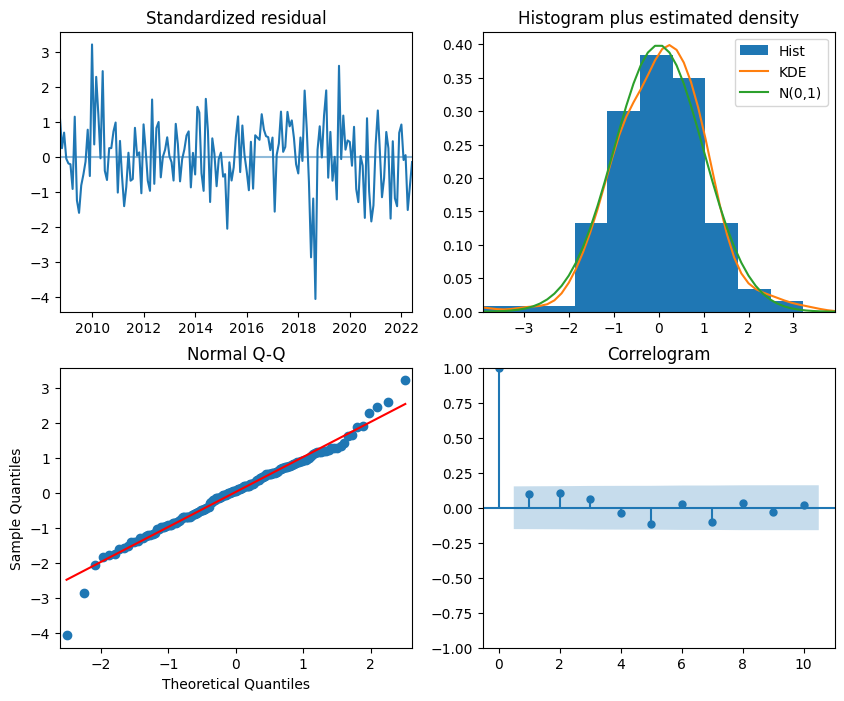

                                   SARIMAX Results                                   
Dep. Variable:                             y   No. Observations:                  177
Model:             SARIMAX(0, 1, [1, 2], 12)   Log Likelihood                  92.032
Date:                       Sat, 11 May 2024   AIC                           -174.064
Time:                               08:47:40   BIC                           -158.534
Sample:                           09-30-2007   HQIC                          -167.760
                                - 05-31-2022                                         
Covariance Type:                         opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0434   2.13e-05   2031.854      0.000       0.043       0.043
Time          -0.0036      0.000    -14.188      0.000      -0.004      -0.

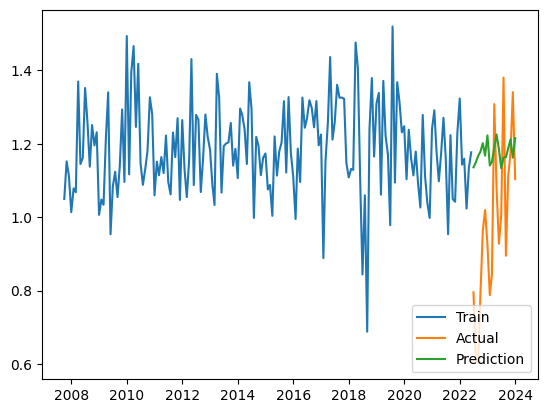

[0.00670422] [[-0.00646567]] [[0.00694278]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.02717921111098336

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00692602] [[-0.00668746]] [[0.00716458]]
Mean of Residuals -0.1463123382757298
Mean of Residuals -0.15833234790239387


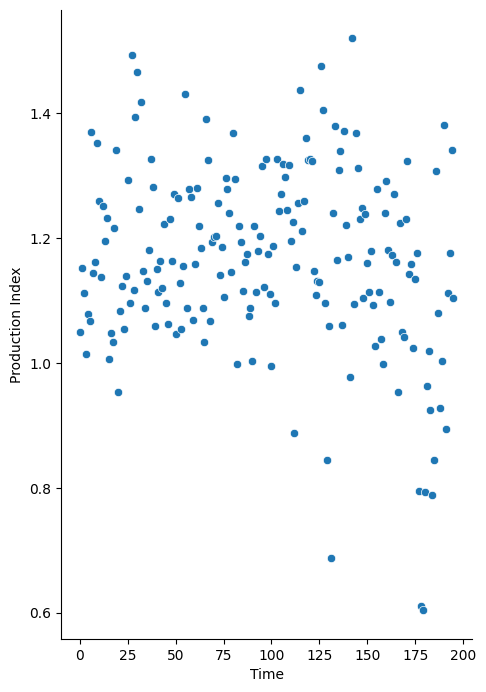

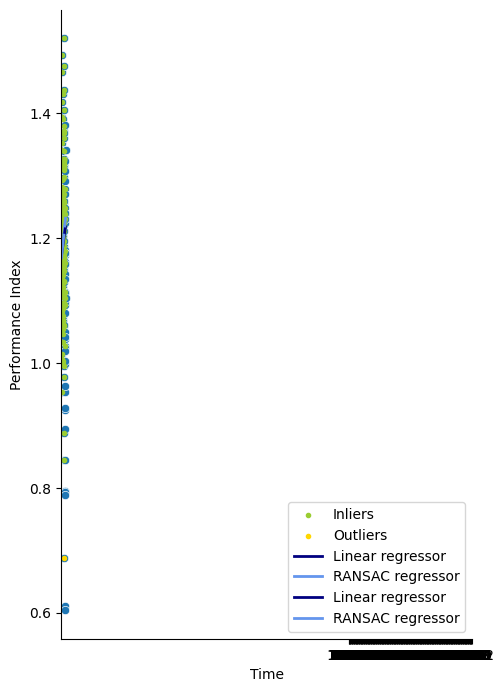

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.84551571] [[-4.83877572]] [[4.8522557]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97.70039341162244

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.84551571] [[-4.83877572]] [[4.8522557]]
[9.95045256] [[-9.94907932]] [[9.95182579]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.2269168735941065

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[9.95045256] [[-9.94907932]] [[9.95182579]]
[7.25969716] [[-7.25011642]] [[7.26927791]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -57.00725743270349

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.25969716] [[-7.25011642]] [[7.26927791]]
[6.35515173] [[-6.35898633]] [[6.35131713]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.994238720256106

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.58887884] [[-5.59271344]] [[5.58504424]]
[5.20332428] [[-5.2021232]] [[5.20452536]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0975639367331516

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.20332428] [[-5.2021232]] [[5.20452536]]
[2.32401665] [[-2.2973614]] [[2.3506719]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -32.0107744075548

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.32401665] [[-2.2973614]] [[2.3506719]]
[4.64907419] [[-4.70799736]] [[4.59015101]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.328318098632589

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.64907419] [[-4.70799736]] [[4.59015101]]
[1.83035588] [[-1.84289465]] [[1.81781711]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2053.374623019192

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[1.83035588] [[-1.84289465]] [[1.81781711]]
[6.65291068] [[-6.68126703]] [[6.62455433]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.743496956745384

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.65291068] [[-6.68126703]] [[6.62455433]]
[3.2927578] [[-3.26733475]] [[3.31818084]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0028915589413794

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.36618811] [[-5.34076506]] [[5.39161115]]
[2.19044472] [[-2.21830103]] [[2.16258842]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.179387653001337

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[2.67368213] [[-2.70153843]] [[2.64582582]]
[1.63442151] [[-1.62020631]] [[1.64863671]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -121.43162541637749

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.63442151] [[-1.62020631]] [[1.64863671]]
[1.88635698] [[-1.91427276]] [[1.85844121]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -796.3794744180716

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.67082852] [[-2.69874429]] [[2.64291274]]
[1.24520843] [[-1.23697414]] [[1.25344272]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.843236841639754

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.24520843] [[-1.23697414]] [[1.25344272]]
[2.56054199] [[-2.57877526]] [[2.54230872]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33.23969518124851

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.56054199] [[-2.57877526]] [[2.54230872]]
[4.63472786] [[-4.58803002]] [[4.68142571]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -109155.75136913572

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.63472786] [[-4.58803002]] [[4.68142571]]
[7.01923121] [[-7.04255]] [[6.99591242]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -31.20710686562104

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.01923121] [[-7.04255]] [[6.99591242]]
[1.35782823] [[-1.36313632]] [[1.35252013]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.252837717275487

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.35782823] [[-1.36313632]] [[1.35252013]]
[6.94444461] [[-7.00662888]] [[6.88226034]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.978600762857324

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.83957822] [[-6.90176249]] [[6.77739395]]
[6.35556111] [[-6.38068986]] [[6.33043235]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -26.158858861092302

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.35556111] [[-6.38068986]] [[6.33043235]]
[2.34816401] [[-2.3763294]] [[2.31999863]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.4366764874732592

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.76651482] [[-1.79468021]] [[1.73834944]]
[2.45341063] [[-2.43776911]] [[2.46905216]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.000821799528599

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.45341063] [[-2.43776911]] [[2.46905216]]
[6.42500395] [[-6.47769612]] [[6.37231178]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.3993831270973045

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.42500395] [[-6.47769612]] [[6.37231178]]
[2.79337871] [[-2.80540311]] [[2.78135431]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5583181165915496

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.25074253] [[-3.26276692]] [[3.23871813]]
[2.54512761] [[-2.54415915]] [[2.54609607]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -301.8027774705632

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.54512761] [[-2.54415915]] [[2.54609607]]
[5.27395999] [[-5.29341727]] [[5.2545027]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6153786540313377

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.27395999] [[-5.29341727]] [[5.2545027]]
[3.23025636] [[-3.21427849]] [[3.24623423]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -546.333544164722

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[3.28566361] [[-3.26968574]] [[3.30164147]]
[3.50156342] [[-3.45807066]] [[3.54505619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.5358831719041364

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.50156342] [[-3.45807066]] [[3.54505619]]
[5.168827] [[-5.19977103]] [[5.13788296]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.407616260928508

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.5108569] [[-5.54180093]] [[5.47991286]]
[2.36211654] [[-2.35523009]] [[2.36900299]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.302911191866741

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.36211654] [[-2.35523009]] [[2.36900299]]
[3.76754607] [[-3.78403665]] [[3.7510555]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.299305906879997

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.76754607] [[-3.78403665]] [[3.7510555]]
[2.76024215] [[-2.76410006]] [[2.75638423]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.0621817258687636

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.76024215] [[-2.76410006]] [[2.75638423]]
[5.0196002] [[-5.00463009]] [[5.03457031]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.517273177478917

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.0196002] [[-5.00463009]] [[5.03457031]]
[5.84938941] [[-5.82461045]] [[5.87416838]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.799211955159418

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.84938941] [[-5.82461045]] [[5.87416838]]
[3.32010866] [[-3.33187697]] [[3.30834034]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -35.66899585211257

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.32010866] [[-3.33187697]] [[3.30834034]]
[1.66633414] [[-1.69271916]] [[1.63994911]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -34.76852412912881

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[1.66633414] [[-1.69271916]] [[1.63994911]]
[3.56157356] [[-3.54436075]] [[3.57878637]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -10.633477439061314

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.90866862] [[-5.89145581]] [[5.92588143]]
[4.36614837] [[-4.29050326]] [[4.44179349]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -606.8670702287005

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[4.36614837] [[-4.29050326]] [[4.44179349]]
[0.78512699] [[-0.80003119]] [[0.77022278]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -104.25933564375137

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[0.78512699] [[-0.80003119]] [[0.77022278]]
[6.90929177] [[-6.9097554]] [[6.90882814]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.989476442910681

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.90929177] [[-6.9097554]] [[6.90882814]]
[5.53496361] [[-5.54635542]] [[5.52357179]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -204.10159145623646

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.32118694] [[-7.33257875]] [[7.30979512]]
[5.81520719] [[-5.79057367]] [[5.83984071]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.81520719] [[-5.79057367]] [[5.83984071]]
[4.72602604] [[-4.77276501]] [[4.67928708]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -305.0396012225341

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.72602604] [[-4.77276501]] [[4.67928708]]
[6.37639108] [[-6.37511381]] [[6.37766836]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -66721.1446691227

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[6.37639108] [[-6.37511381]] [[6.37766836]]
[6.1709933] [[-6.20019396]] [[6.14179264]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.5549764018145058

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.1709933] [[-6.20019396]] [[6.14179264]]
[5.65140061] [[-5.69605657]] [[5.60674465]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -29.86590156858454

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.69083934] [[-4.7354953]] [[4.64618338]]
[3.39547003] [[-3.42094809]] [[3.36999196]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.574328655459484

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.39547003] [[-3.42094809]] [[3.36999196]]
[7.57456234] [[-7.6429306]] [[7.50619409]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.665252209908258

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.57456234] [[-7.6429306]] [[7.50619409]]
[3.50798687] [[-3.53032712]] [[3.48564661]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2520.3170438988254

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.50798687] [[-3.53032712]] [[3.48564661]]
[4.37262569] [[-4.34853865]] [[4.39671274]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -31.346896380945246

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.37262569] [[-4.34853865]] [[4.39671274]]
[2.26700367] [[-2.30253559]] [[2.23147176]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1120.6624913806536

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.83026667] [[-3.86579859]] [[3.79473476]]
[6.78223612] [[-6.75377293]] [[6.81069931]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.93922431470296

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[7.33115536] [[-7.30269217]] [[7.35961855]]
[6.00052149] [[-5.97970645]] [[6.02133652]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -86560.62291389999

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.00052149] [[-5.97970645]] [[6.02133652]]
[12.13006641] [[-12.24838881]] [[12.011744]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -811.015187442844

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[12.13006641] [[-12.24838881]] [[12.011744]]
[2.18482281] [[-2.18541651]] [[2.18422911]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -27.538176024978924

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.18482281] [[-2.18541651]] [[2.18422911]]
[6.24302692] [[-6.21651579]] [[6.26953805]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -10.095235236207

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[7.77008353] [[-7.7435724]] [[7.79659466]]
[2.25755291] [[-2.22866281]] [[2.28644301]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -226.06822195021383

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.25755291] [[-2.22866281]] [[2.28644301]]
[1.01278584] [[-1.03062073]] [[0.99495095]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -82.4929764872323

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.01278584] [[-1.03062073]] [[0.99495095]]
[3.99692226] [[-3.99339171]] [[4.00045282]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -5.566424558074669

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.99692226] [[-3.99339171]] [[4.00045282]]
[5.74296596] [[-5.74320425]] [[5.74272767]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -0.07405086920240005

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.74296596] [[-5.74320425]] [[5.74272767]]
[4.80986379] [[-4.83570947]] [[4.78401811]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -4.853129974893817

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.80986379] [[-4.83570947]] [[4.78401811]]
[10.00926135] [[-10.00700955]] [[10.01151315]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4781012424412337

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.00926135] [[-10.00700955]] [[10.01151315]]
[4.41468424] [[-4.43798194]] [[4.39138654]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.48324458042936475

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.41468424] [[-4.43798194]] [[4.39138654]]
[13.20712247] [[-13.29374842]] [[13.12049652]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.3605427274583374

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[13.20712247] [[-13.29374842]] [[13.12049652]]
[6.5507864] [[-6.51344104]] [[6.58813175]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -15.33676907740508

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[6.5507864] [[-6.51344104]] [[6.58813175]]
               Production Index  Time
DateTimeIndex                        
2008-09-30             1.226856     0
2008-10-31             1.186889     1
2008-11-30             1.231376     2
2008-12-31             1.002956     3
2009-01-31             1.036467     4
2009-02-28             1.030002     5
2009-03-31             1.212661     6
2009-04-30             1.340222     7
2009-05-31             0.951828     8
2009-06-30             1.078052     9
2009-07-31             1.123817    10
2009-08-31             1.054793    11
2009-09-30             1.126385    12
2009-10-31             1.293578

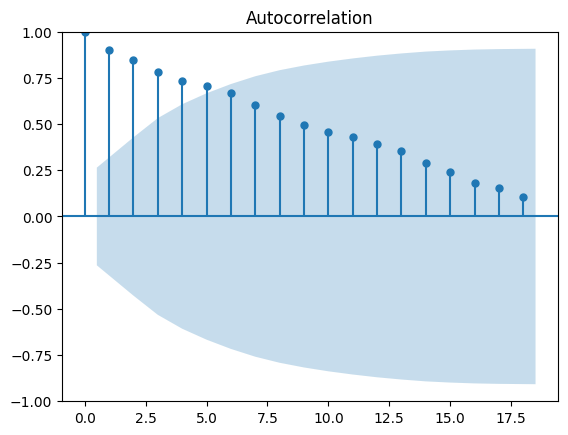

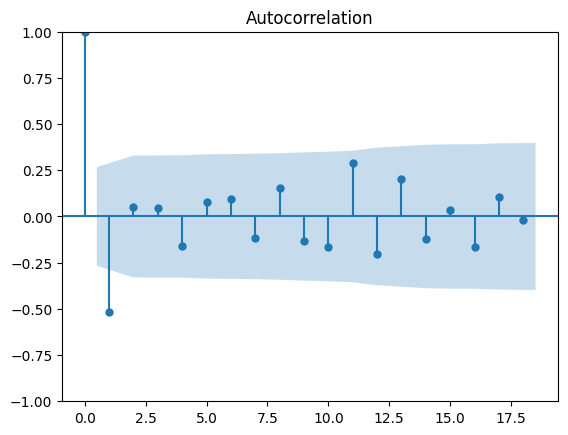

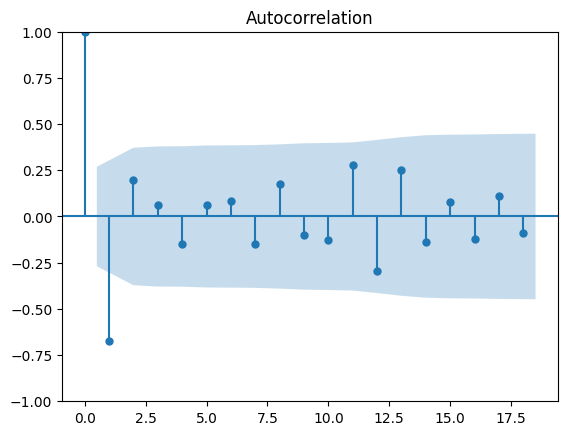

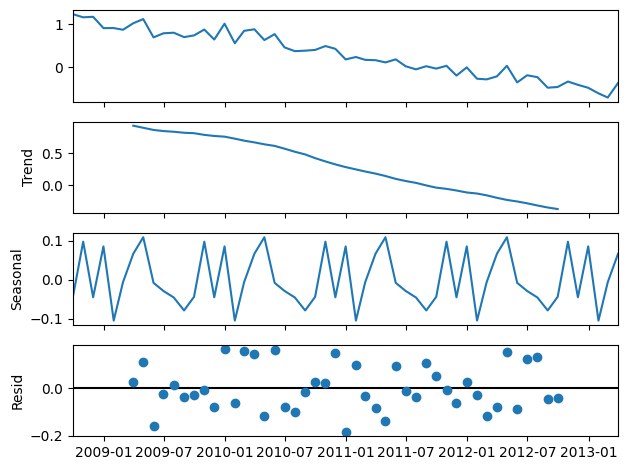

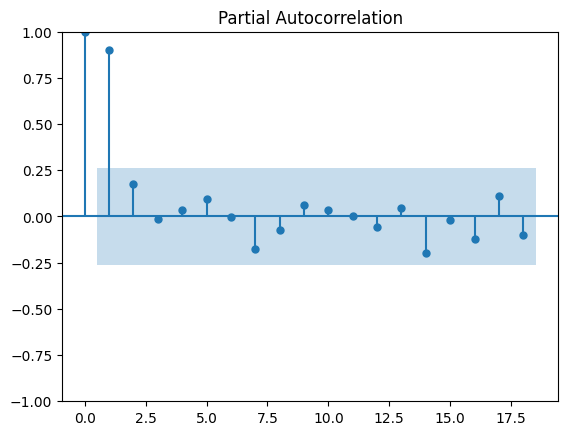

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-14.133, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-27.194, Time=0.65 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.82 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-16.133, Time=0.07 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-12.304, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-35.470, Time=1.78 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-34.607, Time=4.10 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.17 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-37.441, Time=1.40 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-28.922, Time=0.37 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=2.21 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.27 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-35.462, Time=1.89 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-33.687, T

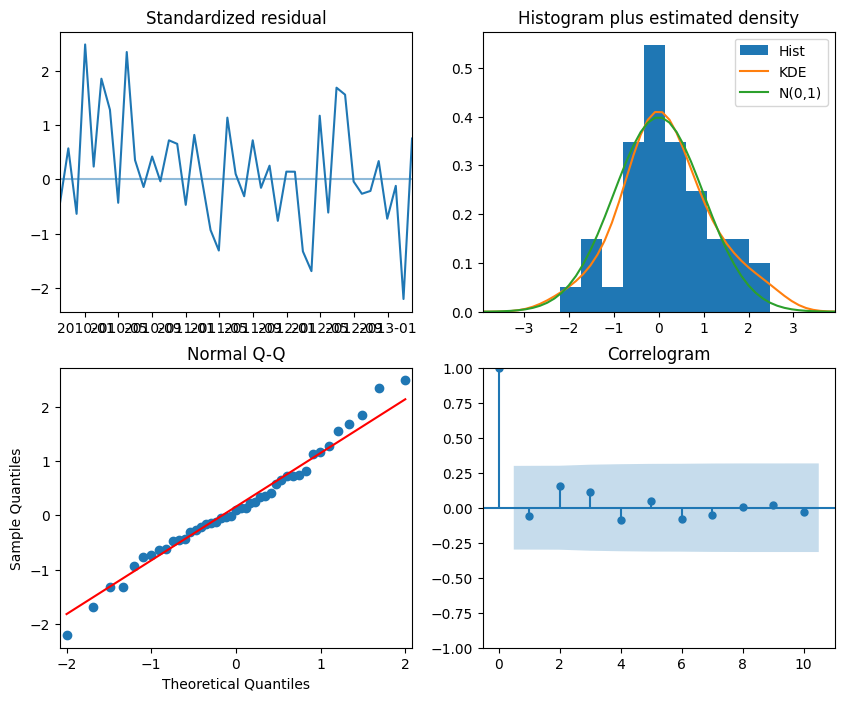

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   55
Model:             SARIMAX(2, 1, 0, 12)   Log Likelihood                  23.720
Date:                  Sat, 11 May 2024   AIC                            -39.441
Time:                          08:48:34   BIC                            -32.396
Sample:                      09-30-2008   HQIC                           -36.843
                           - 03-31-2013                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0006      0.001     -0.719      0.472      -0.002       0.001
ar.S.L12      -1.1565      0.136     -8.479      0.000      -1.424      -0.889
ar.S.L24      -0.5941      0.113    

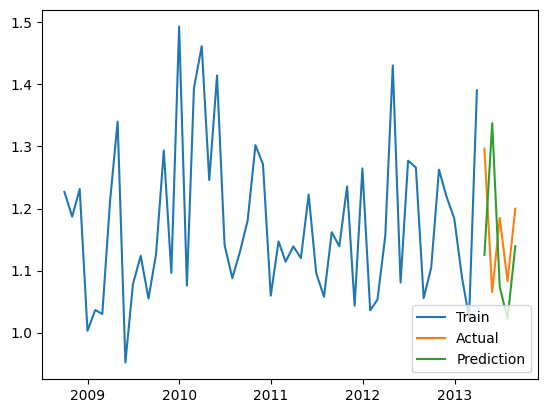

[0.02104412] [[-0.0209558]] [[0.02113244]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.37440212489656033

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.02104412] [[-0.0209558]] [[0.02113244]]
Mean of Residuals -0.0013804409307968113
Mean of Residuals -0.0013804409307968113


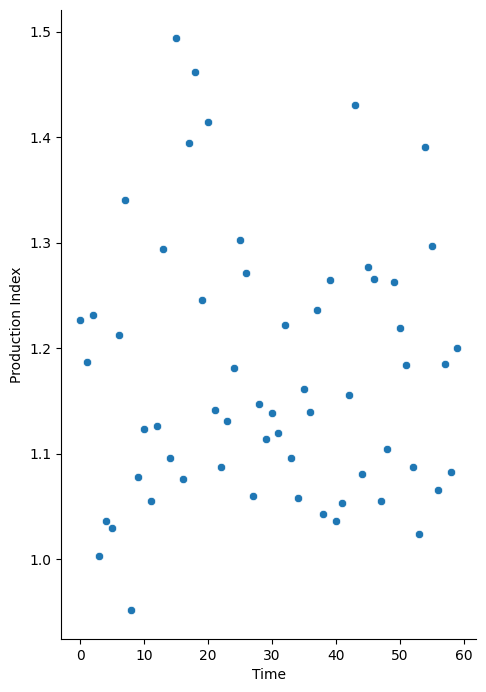

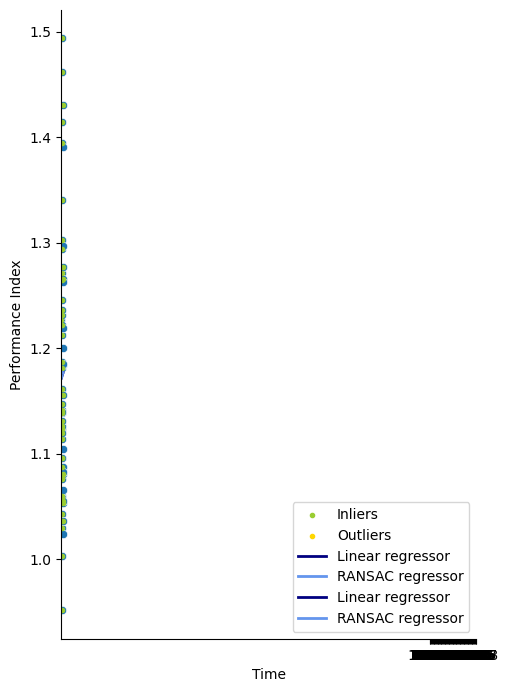

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Kjøllefjord
2002-01-01 00:00:00          NaN
2002-01-01 01:00:00          NaN
2002-01-01 02:00:00          NaN
2002-01-01 03:00:00          NaN
2002-01-01 04:00:00          NaN
...                          ...
2021-09-22 15:00:00    17.337242
2022-02-15 01:00:00    17.613440
2023-11-22 12:00:00    20.340168
2009-05-30 08:00:00    18.738392
2022-01-25 05:00:00    18.138018

[194404 rows x 1 columns]
##################Lista###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2013-08-27 13:00:00   3.485111  290.588074  101261.492188         0.457768
2013-08-27 14:00:00   3.697962  290.441650  101237.890625         0.457768
2013-08-27 15:00:00   3.804062  290.218048  101225.406250         0.457768
2013-08-27 16:00:00   3.584085  290.139435  101202.203125         0.457767
2013-08-2

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('temperature', 2)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    3.251223e+06
dtype: float64
       Observasjoner tot prod  Observasjoner valid prod  Missing values prod  \
Lista                  192840                     90683                    0   

       Negative values prod  Zero values prod  Prod over capacity  \
Lista                     0              5338                   0   

       Observasjoner df_windpowerlib  Missing values wind_peed  \
Lista                          90683                       NaN   

       Missing values temperature  Missing values pressure  \
Lista                         NaN                      NaN   

       Missing values roughness_length  Observasjoner sim  Zero values sim  
Lista                              NaN              90683             8025  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

               Lista
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31  0.329489
2014-12-31  0.388128
2015-12-31  0.251142
2016-12-31  0.147996
2017-12-31  0.296804
2018-12-31  0.639269
2019-12-31  0.205479
2020-12-31  0.318761
2021-12-31  0.867580
2022-12-31  0.171233
2023-12-31  0.433790 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('temperature', 2)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    3.242269e+06
dtype: float64


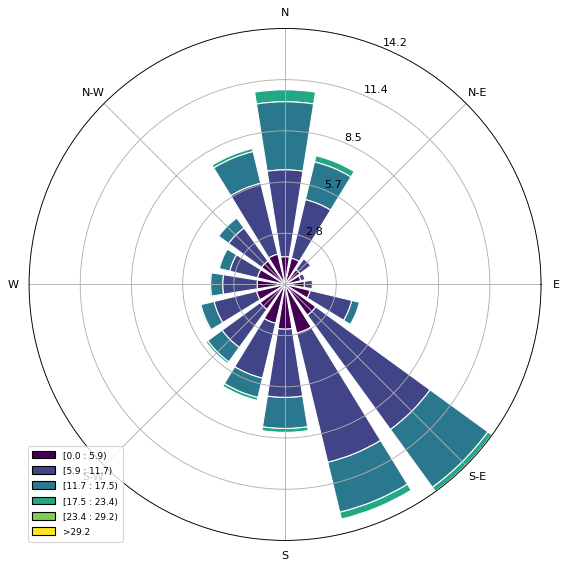

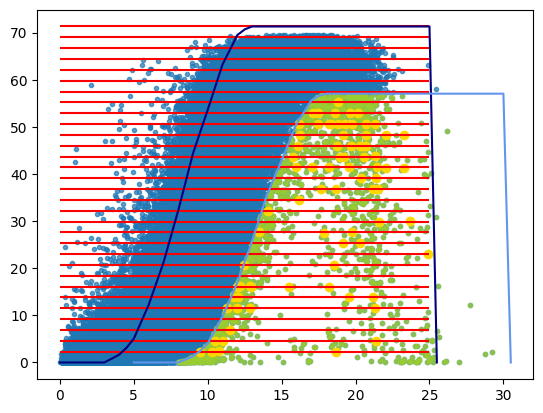

               Production Index  Time
DateTimeIndex                        
2013-08-31             0.753844     0
2013-09-30             0.761287     1
2013-10-31             0.748265     2
2013-11-30             0.729576     3
2013-12-31             0.712352     4
...                         ...   ...
2023-08-31             0.783126   120
2023-09-30             0.694938   121
2023-10-31             0.724588   122
2023-11-30             0.730712   123
2023-12-31             0.693418   124

[125 rows x 2 columns]


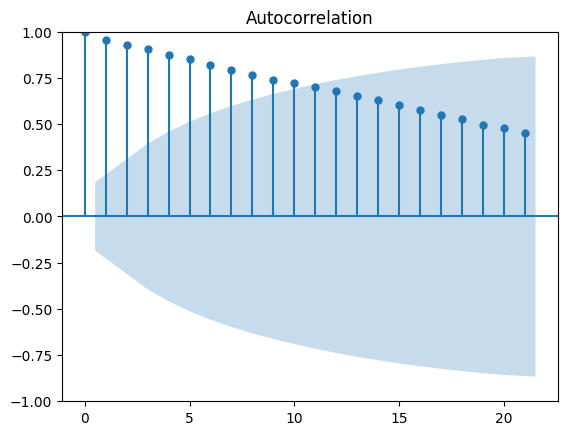

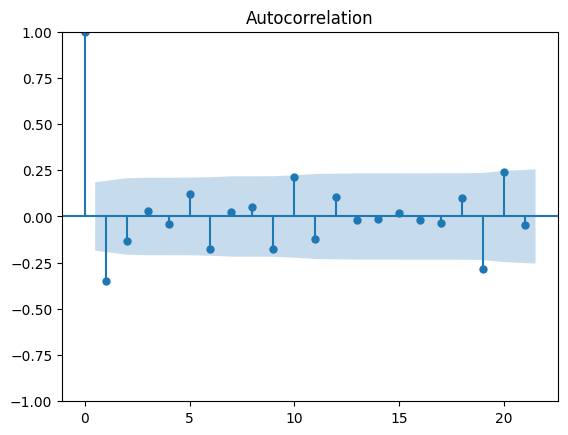

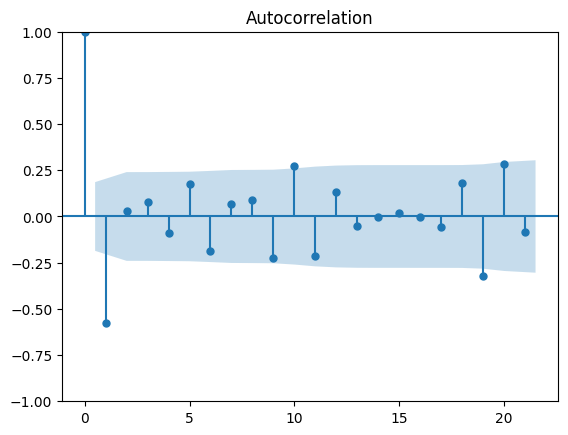

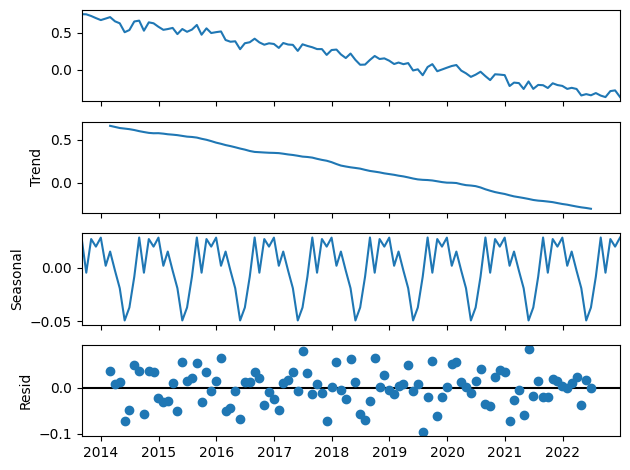

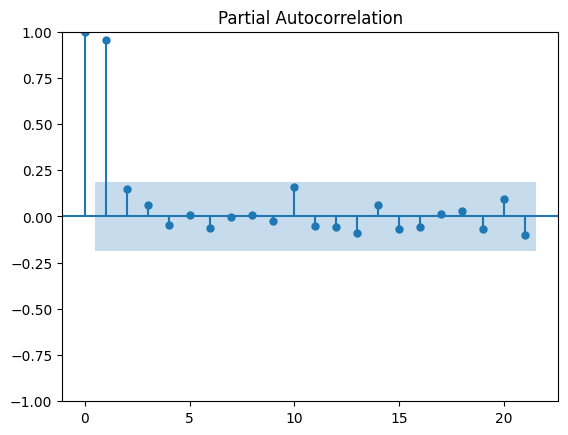

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-307.516, Time=1.22 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-261.506, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-303.288, Time=0.84 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-312.439, Time=2.40 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-263.506, Time=0.13 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-268.276, Time=0.14 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=-308.017, Time=2.31 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=-311.361, Time=5.25 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-303.314, Time=1.39 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=-310.400, Time=4.24 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-307.088, Time=1.74 sec
 ARIMA(0,0,2)(0,1,1)[12] intercept   : AIC=-310.357, Time=2.57 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-310.451, Time=2.07 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=-303.951, Time=6.04 sec
 ARIMA(0,0,1)(0,1,1

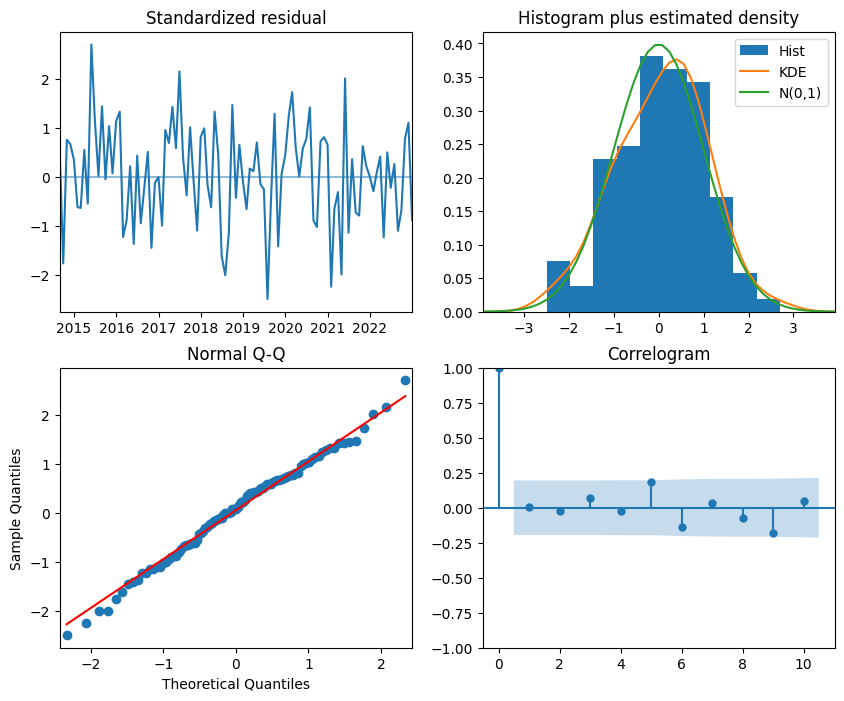

                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  113
Model:             SARIMAX(0, 0, 1)x(0, 1, [1, 2], 12)   Log Likelihood                 162.077
Date:                                 Sat, 11 May 2024   AIC                           -314.153
Time:                                         08:49:43   BIC                           -301.078
Sample:                                     08-31-2013   HQIC                          -308.860
                                          - 12-31-2022                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time       -9.253e-05      0.000     -0.600      0.549      -0.000       0

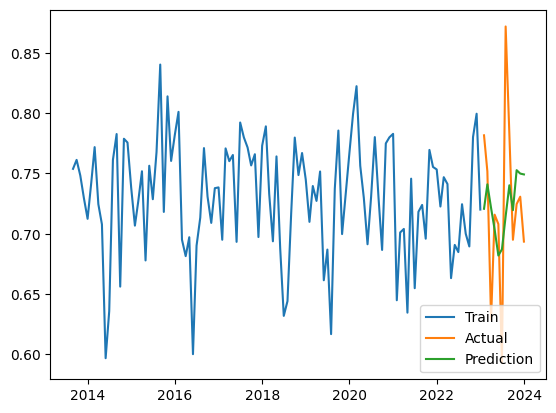

[0.00331478] [[-0.00340365]] [[0.00322592]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.05996146897249299

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00331478] [[-0.00340365]] [[0.00322592]]
Mean of Residuals -0.0019138430592080668
Mean of Residuals -0.0019138430592080668


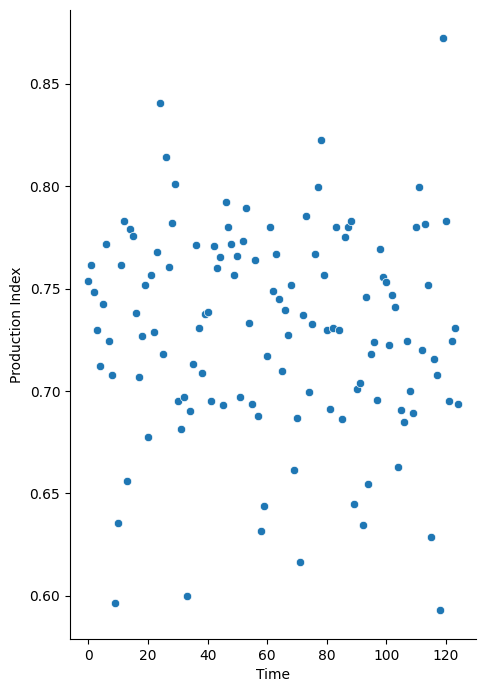

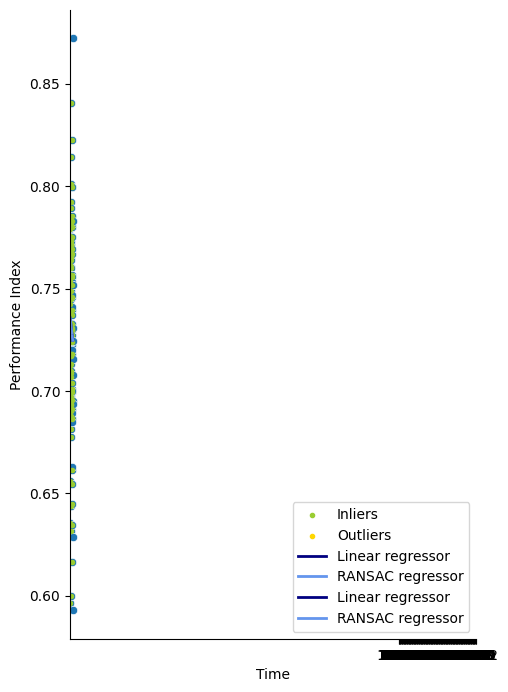

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.26931358] [[-1.27794758]] [[1.26067959]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.380407963464612

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.26931358] [[-1.27794758]] [[1.26067959]]
[1.57712208] [[-1.57164752]] [[1.58259665]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.985835274363712

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.57712208] [[-1.57164752]] [[1.58259665]]
[1.4422146] [[-1.44292752]] [[1.44150169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -145088.12536373347

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.4422146] [[-1.44292752]] [[1.44150169]]
[3.88290043] [[-3.87853469]] [[3.88726618]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -220.41159422429564

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.88290043] [[-3.87853469]] [[3.88726618]]
[0.41158672] [[-0.41485654]] [[0.4083169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.9712211977641625

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.41158672] [[-0.41485654]] [[0.4083169]]
[0.43510341] [[-0.42605999]] [[0.44414684]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.839120600950942

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.43510341] [[-0.42605999]] [[0.44414684]]
[2.40226851] [[-2.38275886]] [[2.42177816]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.7763005447078086

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.40226851] [[-2.38275886]] [[2.42177816]]
[0.21962705] [[-0.22224361]] [[0.21701049]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.365139634707015

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.21962705] [[-0.22224361]] [[0.21701049]]
[0.95734612] [[-0.97047528]] [[0.94421696]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -75.84289879052932

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.95734612] [[-0.97047528]] [[0.94421696]]
[2.21229284] [[-2.22034847]] [[2.2042372]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.43027561114437

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.21229284] [[-2.22034847]] [[2.2042372]]
[2.14144079] [[-2.15545327]] [[2.12742831]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8069445376334545

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.14144079] [[-2.15545327]] [[2.12742831]]
[2.55003281] [[-2.54478989]] [[2.55527573]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.152608577476223

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.55003281] [[-2.54478989]] [[2.55527573]]
[0.84327525] [[-0.8425886]] [[0.8439619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.699674457801726

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84327525] [[-0.8425886]] [[0.8439619]]
[1.48353872] [[-1.46964829]] [[1.49742915]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.424366987726117

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.48353872] [[-1.46964829]] [[1.49742915]]
[1.53154961] [[-1.53328187]] [[1.52981734]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.492907981455028

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.53154961] [[-1.53328187]] [[1.52981734]]
[0.27478135] [[-0.28392352]] [[0.26563917]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -76.15026655898941

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.27478135] [[-0.28392352]] [[0.26563917]]
[1.82581105] [[-1.83133221]] [[1.82028988]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.706771092315793

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.82581105] [[-1.83133221]] [[1.82028988]]
[0.15252641] [[-0.16673999]] [[0.13831283]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.15252641] [[-0.16673999]] [[0.13831283]]
[1.07022515] [[-1.07838265]] [[1.06206764]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97.53826550733162

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.07022515] [[-1.07838265]] [[1.06206764]]
[2.49650211] [[-2.46636812]] [[2.5266361]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.149781828484014

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.49650211] [[-2.46636812]] [[2.5266361]]
[1.43628469] [[-1.42693497]] [[1.44563442]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.999737751433349

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.43628469] [[-1.42693497]] [[1.44563442]]
[1.27901457] [[-1.27084994]] [[1.2871792]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7142664772863132

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.27901457] [[-1.27084994]] [[1.2871792]]
[2.02589286] [[-2.03263427]] [[2.01915145]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.057128675181923

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.02589286] [[-2.03263427]] [[2.01915145]]
[1.06011863] [[-1.03921766]] [[1.0810196]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -131.7348086781988

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.06011863] [[-1.03921766]] [[1.0810196]]
[1.58635558] [[-1.58320059]] [[1.58951057]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.711655607105667

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58635558] [[-1.58320059]] [[1.58951057]]
[1.36566342] [[-1.36383599]] [[1.36749086]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.79167363440588

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.36566342] [[-1.36383599]] [[1.36749086]]
[1.40774004] [[-1.41254773]] [[1.40293236]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.06077428812204

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.40774004] [[-1.41254773]] [[1.40293236]]
[2.16799279] [[-2.18026331]] [[2.15572227]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.504196220873457

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.16799279] [[-2.18026331]] [[2.15572227]]
[0.35145207] [[-0.35033515]] [[0.352569]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -56.34063731396732

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.35145207] [[-0.35033515]] [[0.352569]]
[1.27934217] [[-1.26911488]] [[1.28956945]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -85.15473092112086

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.27934217] [[-1.26911488]] [[1.28956945]]
[2.98680539] [[-2.96955013]] [[3.00406065]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -166.5031765349201

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.98680539] [[-2.96955013]] [[3.00406065]]
[1.38290517] [[-1.38807111]] [[1.37773924]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.632018776346993

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.38290517] [[-1.38807111]] [[1.37773924]]
[2.6468857] [[-2.64745798]] [[2.64631341]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -554.5974848938254

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.6468857] [[-2.64745798]] [[2.64631341]]
[1.5079677] [[-1.51605438]] [[1.49988101]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.081094595801435

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.5079677] [[-1.51605438]] [[1.49988101]]
[1.99693075] [[-2.00094677]] [[1.99291473]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.1842965702014174

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.99693075] [[-2.00094677]] [[1.99291473]]
[1.05955992] [[-1.05933191]] [[1.05978793]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.683612021412833

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05955992] [[-1.05933191]] [[1.05978793]]
[0.3697727] [[-0.37256699]] [[0.36697842]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3936662037804324

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.3697727] [[-0.37256699]] [[0.36697842]]
[1.36980282] [[-1.38274892]] [[1.35685672]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.733118658848965

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.36980282] [[-1.38274892]] [[1.35685672]]
[2.77764374] [[-2.77128082]] [[2.78400666]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.803269335340527

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.77764374] [[-2.77128082]] [[2.78400666]]
[2.50111685] [[-2.51468867]] [[2.48754502]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -31.07260554113436

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.50111685] [[-2.51468867]] [[2.48754502]]
[0.71981165] [[-0.72372531]] [[0.715898]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5723145607735118

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.71981165] [[-0.72372531]] [[0.715898]]
               Production Index  Time
DateTimeIndex                        
2013-08-31             0.753844     0
2013-09-30             0.762411     1
2013-10-31             0.748265     2
2013-11-30             0.729576     3
2013-12-31             0.719426     4
...                         ...   ...
2023-08-31             0.783126   120
2023-09-30             0.696227   121
2023-10-31             0.725852   122
2023-11-30             0.730937   123
2023-12-31             0.693753   124

[125 rows x 2 columns]


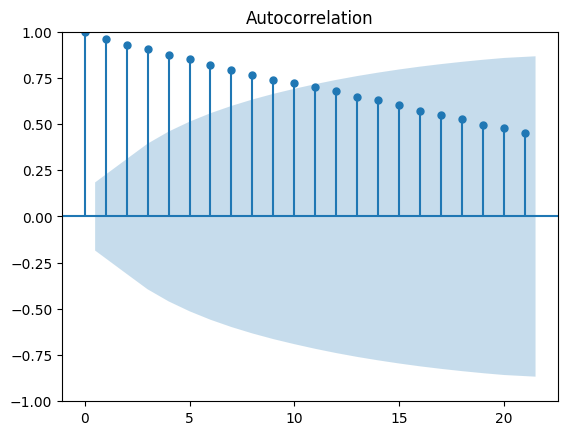

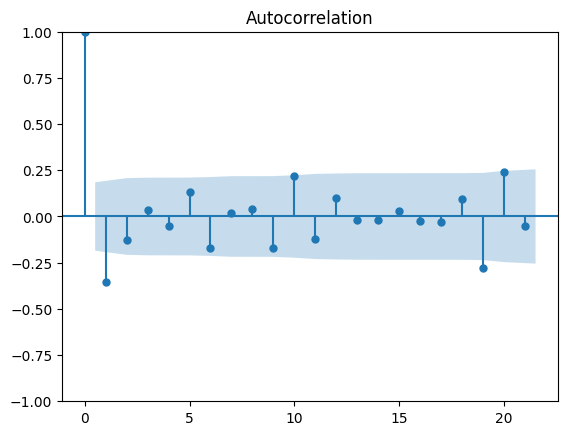

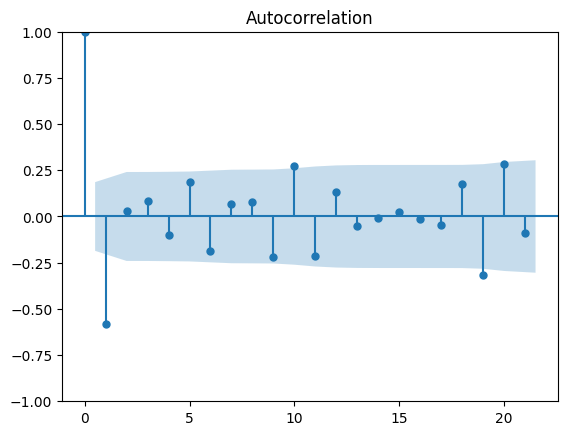

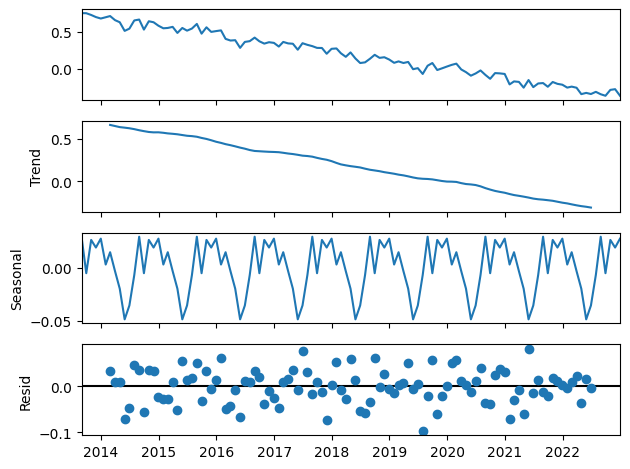

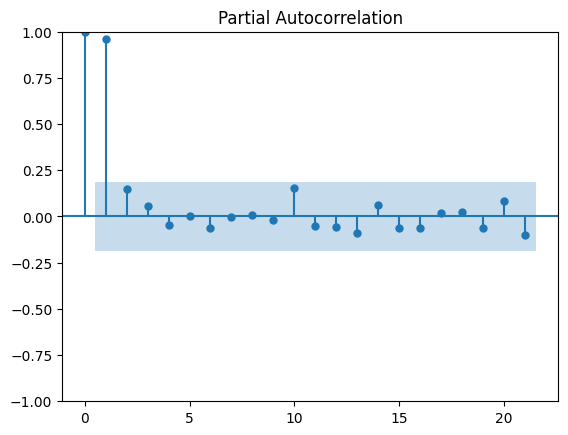

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-311.145, Time=1.68 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-265.180, Time=0.38 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-306.414, Time=1.26 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-313.540, Time=1.11 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-267.180, Time=0.14 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-271.442, Time=0.14 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=-309.568, Time=1.14 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=3.99 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-306.415, Time=0.83 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=-314.116, Time=3.09 sec
 ARIMA(0,0,1)(2,1,2)[12] intercept   : AIC=-302.559, Time=3.72 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=-307.923, Time=2.47 sec
 ARIMA(0,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=4.41 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-311.178, Time=3.63 sec
 ARIMA(0,0,2)(1,1,2)[12] inte

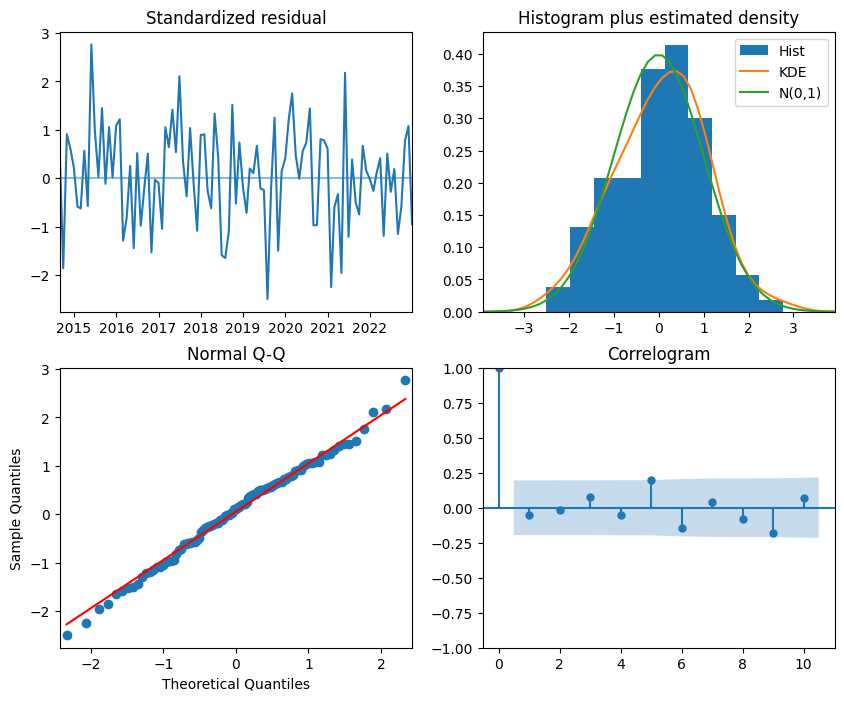

                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  113
Model:             SARIMAX(0, 0, 1)x(1, 1, [1, 2], 12)   Log Likelihood                 164.058
Date:                                 Sat, 11 May 2024   AIC                           -314.116
Time:                                         08:50:42   BIC                           -295.810
Sample:                                     08-31-2013   HQIC                          -306.705
                                          - 12-31-2022                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0876      0.002     54.881      0.000       0.084       0

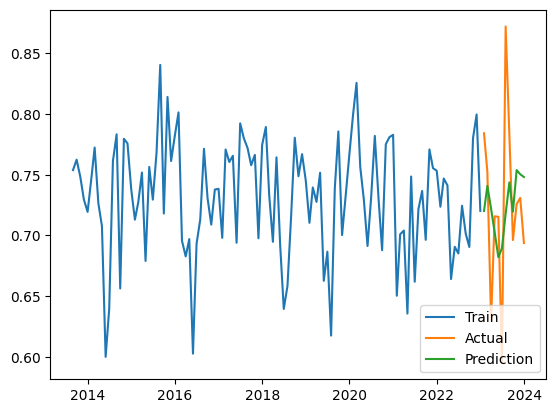

[0.00329245] [[-0.00337282]] [[0.00321207]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.05200733065040464

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00329245] [[-0.00337282]] [[0.00321207]]
Mean of Residuals -0.0028221946423299072
Mean of Residuals -0.0028221946423299072


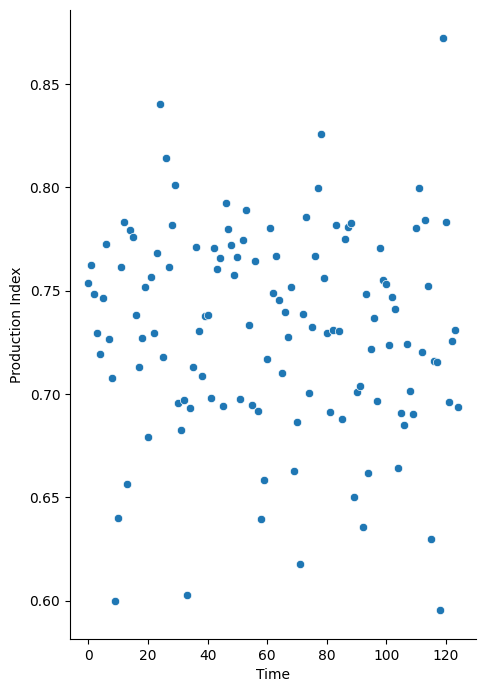

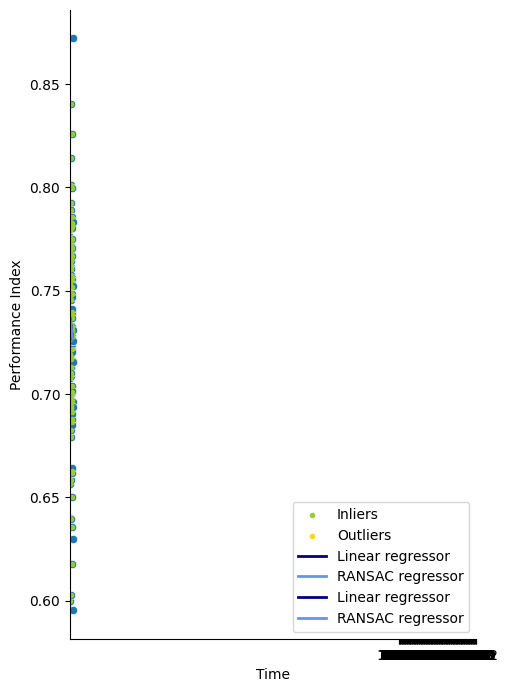

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.41569272] [[-1.42406579]] [[1.40731965]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.3903205693587495

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.41569272] [[-1.42406579]] [[1.40731965]]
[1.52689667] [[-1.52165319]] [[1.53214014]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.468233367699516

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.52689667] [[-1.52165319]] [[1.53214014]]
[1.42755193] [[-1.42794174]] [[1.42716213]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -143919.46585871294

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.42755193] [[-1.42794174]] [[1.42716213]]
[3.89245999] [[-3.88820641]] [[3.89671357]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97.82676928832777

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.89245999] [[-3.88820641]] [[3.89671357]]
[0.40820795] [[-0.41164701]] [[0.40476888]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.9567021505205237

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.40820795] [[-0.41164701]] [[0.40476888]]
[0.43734253] [[-0.42930284]] [[0.44538222]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.437953828517287

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.43734253] [[-0.42930284]] [[0.44538222]]
[2.39038814] [[-2.37097344]] [[2.40980284]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.909025288062135

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.39038814] [[-2.37097344]] [[2.40980284]]
[0.21842122] [[-0.22110084]] [[0.21574161]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.379769239197577

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.21842122] [[-0.22110084]] [[0.21574161]]
[0.93911584] [[-0.95209537]] [[0.92613631]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -52.50550932495791

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.93911584] [[-0.95209537]] [[0.92613631]]
[2.1938992] [[-2.20189056]] [[2.18590784]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.16675377133232

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.1938992] [[-2.20189056]] [[2.18590784]]
[2.11907601] [[-2.13255635]] [[2.10559566]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8781136851310036

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11907601] [[-2.13255635]] [[2.10559566]]
[2.5557383] [[-2.55043052]] [[2.56104608]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.2280131958146163

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.5557383] [[-2.55043052]] [[2.56104608]]
[0.84327525] [[-0.8425886]] [[0.8439619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.699674457801726

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84327525] [[-0.8425886]] [[0.8439619]]
[1.47297123] [[-1.4594545]] [[1.48648796]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -53.6808313458082

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47297123] [[-1.4594545]] [[1.48648796]]
[1.54181269] [[-1.54378977]] [[1.5398356]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.478027491239851

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.54181269] [[-1.54378977]] [[1.5398356]]
[0.29879005] [[-0.30783538]] [[0.28974471]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -76.88464548406026

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.29879005] [[-0.30783538]] [[0.28974471]]
[1.81140792] [[-1.81674879]] [[1.80606706]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.7291039181790655

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.81140792] [[-1.81674879]] [[1.80606706]]
[0.15570399] [[-0.16990535]] [[0.14150263]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.15570399] [[-0.16990535]] [[0.14150263]]
[1.16726645] [[-1.17383555]] [[1.16069735]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -139.7758536093932

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.16726645] [[-1.17383555]] [[1.16069735]]
[2.32403039] [[-2.29627969]] [[2.35178109]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.662814516418584

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.32403039] [[-2.29627969]] [[2.35178109]]
[1.43120576] [[-1.42186887]] [[1.44054265]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.986175928849013

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.43120576] [[-1.42186887]] [[1.44054265]]
[1.27860139] [[-1.27048111]] [[1.28672168]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7010929713463128

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.27860139] [[-1.27048111]] [[1.28672168]]
[2.05116183] [[-2.05796395]] [[2.04435971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.475286535647061

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.05116183] [[-2.05796395]] [[2.04435971]]
[1.05991087] [[-1.0392136]] [[1.08060815]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -137.3332490366868

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05991087] [[-1.0392136]] [[1.08060815]]
[1.58574149] [[-1.58263733]] [[1.58884565]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.094487137162431

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58574149] [[-1.58263733]] [[1.58884565]]
[1.39755172] [[-1.39559242]] [[1.39951103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.064218282405124

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.39755172] [[-1.39559242]] [[1.39951103]]
[1.40374286] [[-1.40851959]] [[1.39896613]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.055073669273833

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.40374286] [[-1.40851959]] [[1.39896613]]
[2.107379] [[-2.11980875]] [[2.09494924]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.834467971234812

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.107379] [[-2.11980875]] [[2.09494924]]
[0.34201909] [[-0.34083159]] [[0.34320658]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -55.95441285208646

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.34201909] [[-0.34083159]] [[0.34320658]]
[1.26708123] [[-1.25773669]] [[1.27642577]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -68.48029283406802

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.26708123] [[-1.25773669]] [[1.27642577]]
[2.94205303] [[-2.9244858]] [[2.95962025]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -47.97533375577964

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.94205303] [[-2.9244858]] [[2.95962025]]
[1.26669681] [[-1.27075925]] [[1.26263436]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.935381862989588

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.26669681] [[-1.27075925]] [[1.26263436]]
[2.64142533] [[-2.64215944]] [[2.64069122]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.0037526031621775

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.64142533] [[-2.64215944]] [[2.64069122]]
[1.50456587] [[-1.51267509]] [[1.49645666]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.77165730975885

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.50456587] [[-1.51267509]] [[1.49645666]]
[1.99775614] [[-2.0018598]] [[1.99365248]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0863728161988364

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.99775614] [[-2.0018598]] [[1.99365248]]
[1.06752872] [[-1.06708361]] [[1.06797383]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.661281690139481

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.06752872] [[-1.06708361]] [[1.06797383]]
[0.36051506] [[-0.36330934]] [[0.35772077]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3936662037804324

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.36051506] [[-0.36330934]] [[0.35772077]]
[1.36991769] [[-1.38321133]] [[1.35662404]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.519441372482076

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.36991769] [[-1.38321133]] [[1.35662404]]
[2.76437499] [[-2.75756899]] [[2.771181]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -87.33777515638808

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.76437499] [[-2.75756899]] [[2.771181]]
[2.49558606] [[-2.50915789]] [[2.48201424]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -31.07260554113436

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.49558606] [[-2.50915789]] [[2.48201424]]
[0.71417541] [[-0.71817257]] [[0.71017824]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5277222121560128

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.71417541] [[-0.71817257]] [[0.71017824]]
               Production Index  Time
DateTimeIndex                        
2014-08-31             0.782754     0
2014-09-30             0.656042     1
2014-10-31             0.778850     2
2014-11-30             0.775681     3
2014-12-31             0.738068     4
2015-01-31             0.706688     5
2015-02-28             0.726834     6
2015-03-31             0.751836     7
2015-04-30             0.677781     8
2015-05-31             0.756424     9
2015-06-30             0.728617    10
2015-07-31             0.767886    11
2015-08-31             0.840448    12
2015-09-30             0.

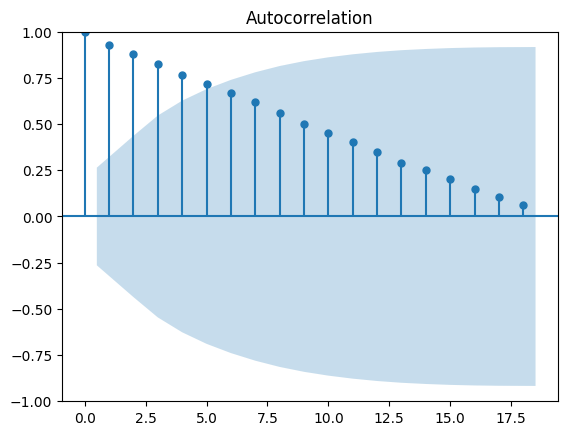

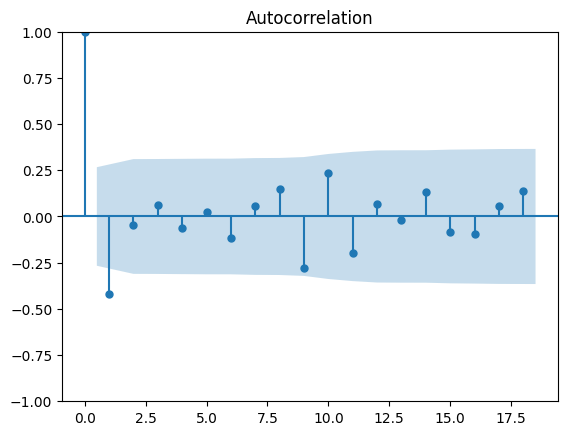

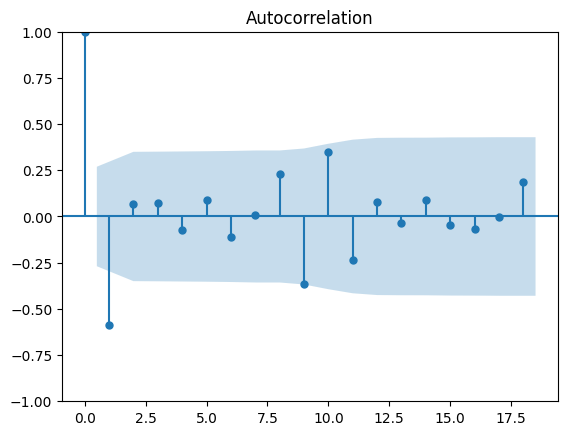

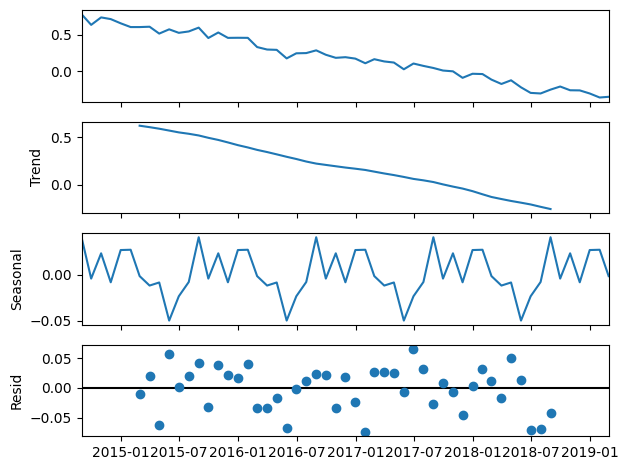

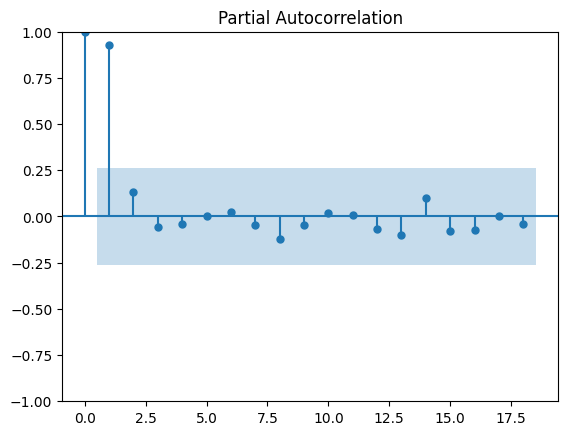

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-115.478, Time=0.81 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-101.792, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-123.622, Time=0.53 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-117.092, Time=0.89 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-103.792, Time=0.06 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-105.591, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-121.496, Time=1.14 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-121.295, Time=1.07 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.82 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-119.555, Time=1.32 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-125.007, Time=0.37 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-122.548, Time=0.87 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-122.730, Time=0.98 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.60 sec
 ARIMA(0,0,0)(2,1,1)[12] inte

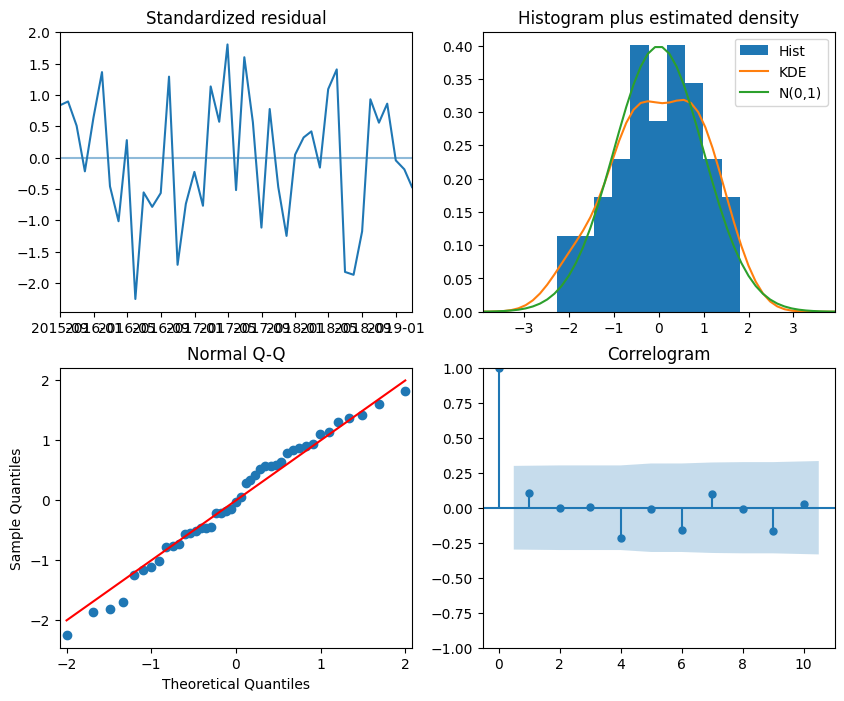

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   55
Model:             SARIMAX(1, 1, 0, 12)   Log Likelihood                  66.504
Date:                  Sat, 11 May 2024   AIC                           -127.008
Time:                          08:51:18   BIC                           -121.724
Sample:                      08-31-2014   HQIC                          -125.059
                           - 02-28-2019                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time       -9.239e-06      0.000     -0.023      0.982      -0.001       0.001
ar.S.L12      -0.7492      0.124     -6.065      0.000      -0.991      -0.507
sigma2         0.0021      0.001    

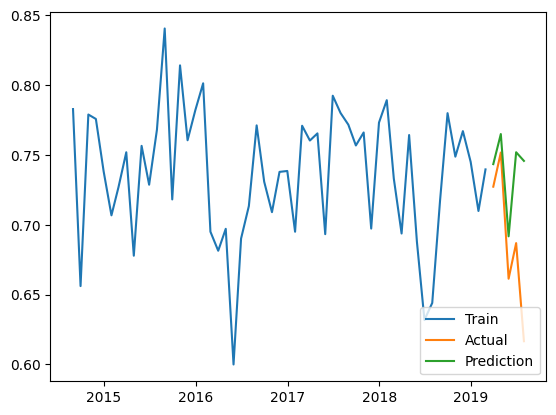

[0.00887878] [[-0.00938842]] [[0.00836915]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.9374053456287925

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00887878] [[-0.00938842]] [[0.00836915]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

Mean of Residuals 0.0008946511000009483
Mean of Residuals 0.0008946511000009483


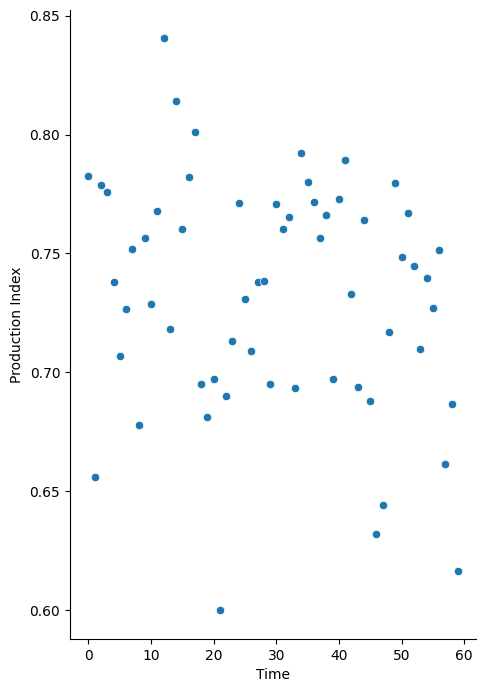

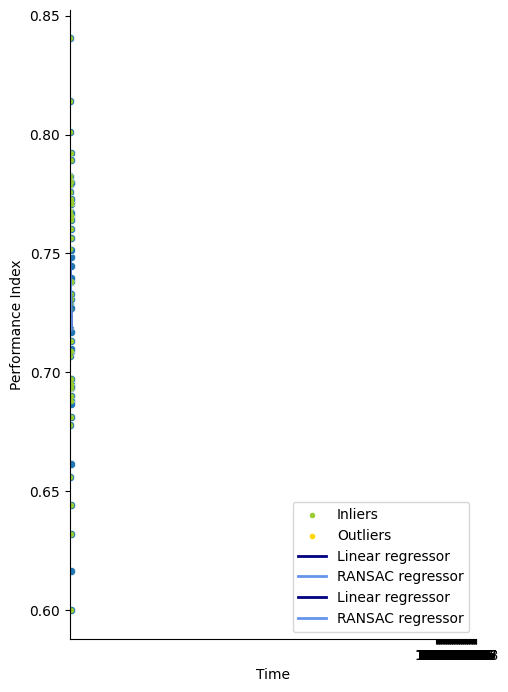

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                         Lista
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2017-01-11 16:00:00  18.613075
2018-09-21 16:00:00  19.590521
2019-06-05 06:00:00  17.459387
2019-06-05 07:00:00  17.094877
2015-01-11 12:00:00  18.794870

[193176 rows x 1 columns]
##################Raggovidda###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2015-07-23 12:00:00   0.503527  283.060638  98295.523438         0.130636
2015-07-23 13:00:00   0.809084  283.154602  98295.406250         0.130528
2015-07-23 14:00:00   1.236090  283.207794  98262.554688         0.130190
2015-07-23 15:00:00   1.512791  283.537048  98273.125000         0.130294
2015-07-23 16:00:00   2.024910  283

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    877700.209232
dtype: float64
            Observasjoner tot prod  Observasjoner valid prod  \
Raggovidda                  192840                     74004   

            Missing values prod  Negative values prod  Zero values prod  \
Raggovidda                    0                     0              5570   

            Prod over capacity  Observasjoner df_windpowerlib  \
Raggovidda                1068                          74004   

            Missing values wind_peed  Missing values temperature  \
Raggovidda                       NaN                         NaN   

            Missing values pressure  Missing values roughness_length  \
Raggovidda                      NaN                              NaN   

            Observasjoner sim  Zero values sim  
Raggovidda              74004            11995  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Raggovidda
2002-12-31         NaN
2003-12-31         NaN
2004-12-31         NaN
2005-12-31         NaN
2006-12-31         NaN
2007-12-31         NaN
2008-12-31         NaN
2009-12-31         NaN
2010-12-31         NaN
2011-12-31         NaN
2012-12-31         NaN
2013-12-31         NaN
2014-12-31         NaN
2015-12-31    0.051600
2016-12-31    0.535064
2017-12-31    0.445205
2018-12-31    0.856164
2019-12-31    0.057078
2020-12-31    2.299636
2021-12-31    0.194064
2022-12-31    0.239726
2023-12-31    0.216895 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    871359.33035
dtype: float64


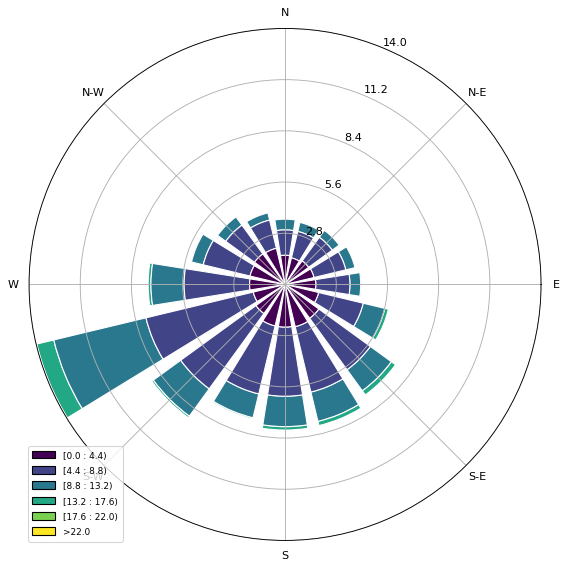

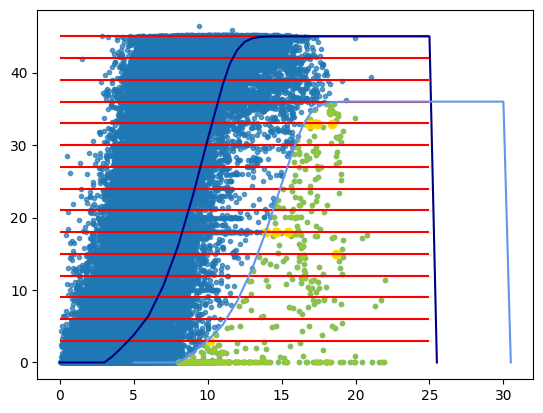

               Production Index  Time
DateTimeIndex                        
2015-07-31             1.785503     0
2015-08-31             2.733505     1
2015-09-30             1.777121     2
2015-10-31             2.396190     3
2015-11-30             1.571661     4
...                         ...   ...
2023-08-31             1.942408    97
2023-09-30             1.457212    98
2023-10-31             1.713100    99
2023-11-30             1.904257   100
2023-12-31             1.352009   101

[102 rows x 2 columns]


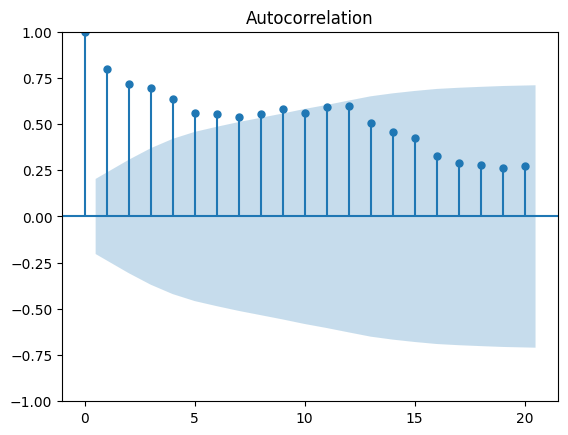

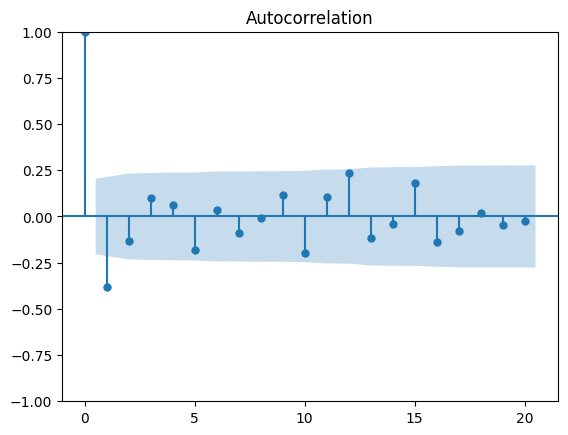

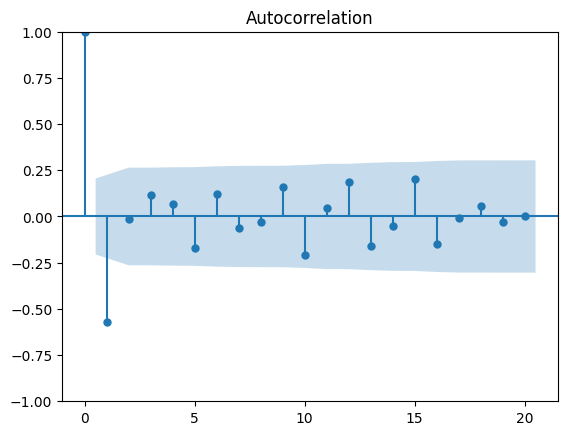

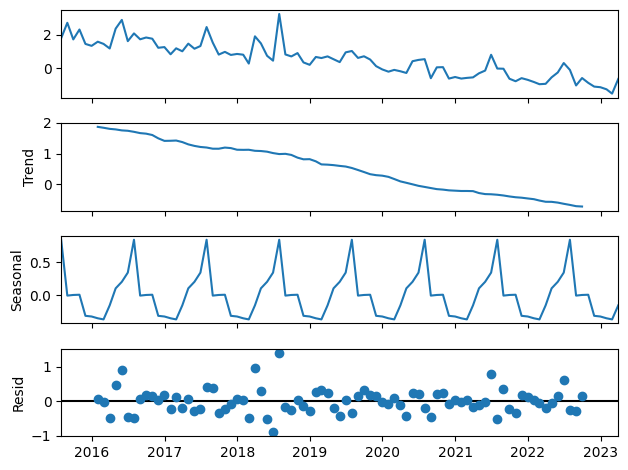

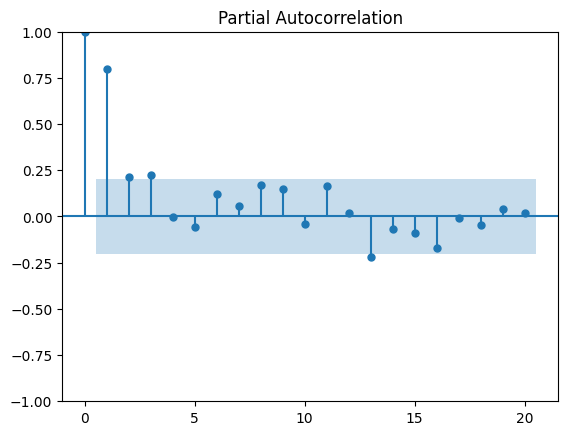

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.46 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=122.062, Time=0.13 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=117.592, Time=0.68 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=109.880, Time=0.99 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=120.062, Time=0.11 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=119.973, Time=0.10 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=inf, Time=1.48 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=4.50 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=116.506, Time=0.90 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=2.93 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=112.470, Time=0.53 sec
 ARIMA(0,0,2)(0,1,1)[12] intercept   : AIC=109.630, Time=2.29 sec
 ARIMA(0,0,2)(0,1,0)[12] intercept   : AIC=121.488, Time=0.23 sec
 ARIMA(0,0,2)(1,1,1)[12] intercept   : AIC=inf, Time=2.05 sec
 ARIMA(0,0,2)(0,1,2)[12] intercept   : AIC=inf, Time=

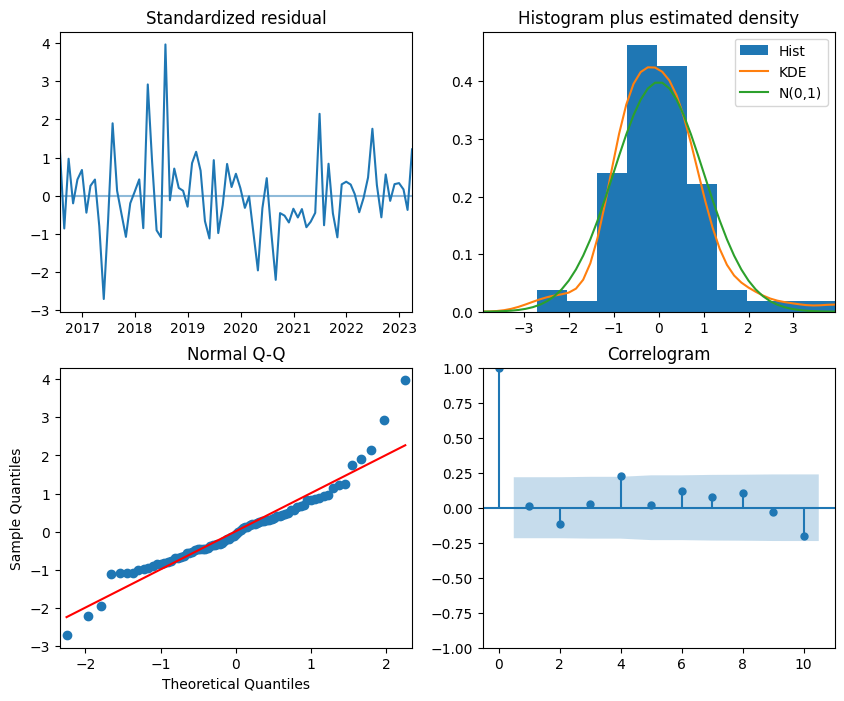

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   93
Model:             SARIMAX(0, 0, 2)x(0, 1, [1], 12)   Log Likelihood                 -48.815
Date:                              Sat, 11 May 2024   AIC                            107.630
Time:                                      08:52:20   BIC                            119.602
Sample:                                  07-31-2015   HQIC                           112.433
                                       - 03-31-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0020      0.001     -1.386      0.166      -0.005       0.001
ma.L1         -0.22

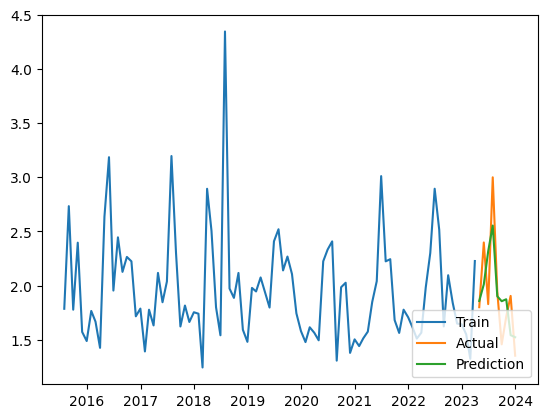

[0.03824002] [[-0.04184769]] [[0.03463235]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.03296776502179941

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 1.5}
[0.0388503] [[-0.04245798]] [[0.03524263]]
Mean of Residuals 0.1833897852498866
Mean of Residuals 0.20202789008372335


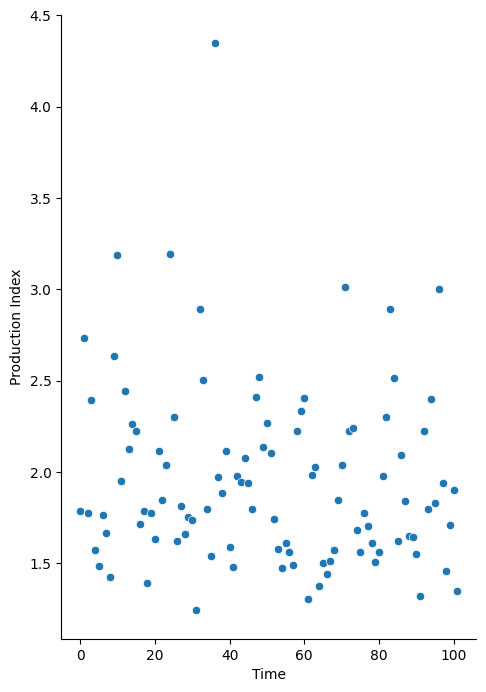

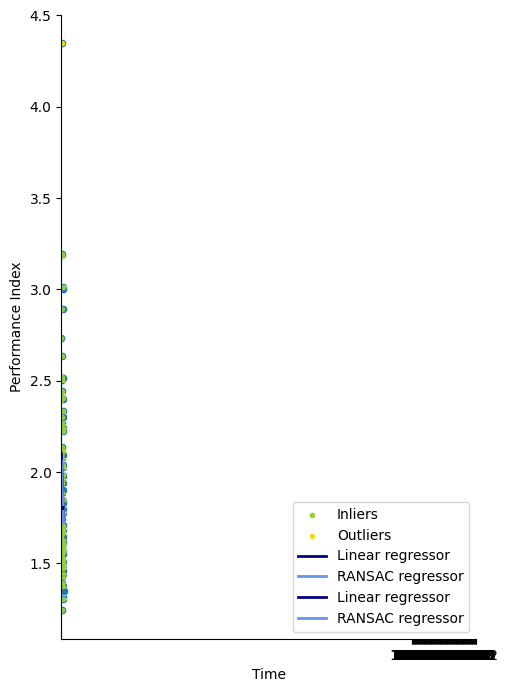

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.69885563] [[-4.7708918]] [[4.62681945]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -40.70668358875829

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[6.14375257] [[-6.21578874]] [[6.0717164]]
[8.7585273] [[-8.7643594]] [[8.7526952]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.56697681820717

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[10.8005477] [[-10.8063798]] [[10.79471561]]
[16.2872447] [[-16.21654862]] [[16.35794078]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1.6598590998255136

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[23.4150261] [[-23.34433002]] [[23.48572218]]
[22.08319803] [[-22.18332041]] [[21.98307564]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -54.90680393625017

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[30.05504296] [[-30.15516534]] [[29.95492057]]
[7.45870543] [[-7.4717392]] [[7.44567167]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -23.379949239186292

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[6.59572938] [[-6.60876315]] [[6.58269562]]
[11.3835273] [[-11.30665756]] [[11.46039703]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -392.7847032057836

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[11.3835273] [[-11.30665756]] [[11.46039703]]
[31.07035937] [[-31.08007984]] [[31.0606389]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.480464693110746

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[25.82906033] [[-25.8387808]] [[25.81933986]]
[15.25719094] [[-15.34740288]] [[15.166979]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.3626285568737142

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[13.41317423] [[-13.50338617]] [[13.32296229]]
[5.79126634] [[-5.82620704]] [[5.75632565]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.27489154709441543

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[12.97257302] [[-13.00751372]] [[12.93763233]]
[26.83403069] [[-26.75895094]] [[26.90911044]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[44.27528618] [[-44.20020643]] [[44.35036593]]
[6.41220724] [[-6.52417711]] [[6.30023737]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -2.9890397959164874

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[6.04303839] [[-6.15500826]] [[5.93106853]]
[6.34191003] [[-6.57429846]] [[6.10952161]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -22.747175226078987

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 2.5}
[6.34191003] [[-6.57429846]] [[6.10952161]]
[10.00407664] [[-10.12767713]] [[9.88047615]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7427753822898382

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.24676903] [[-6.37036953]] [[6.12316854]]
[5.01181978] [[-5.02357502]] [[5.00006454]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -57.57834200619006

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.81807464] [[-8.82982988]] [[8.8063194]]
[6.73781608] [[-6.66210053]] [[6.81353162]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.16041560771851843

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[7.47611816] [[-7.40040262]] [[7.5518337]]
[24.32355254] [[-24.5258655]] [[24.12123959]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.3056928924251685

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[17.31985134] [[-17.52216429]] [[17.11753838]]
[5.27836669] [[-5.32962918]] [[5.2271042]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -109.19155888305447

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.4279543] [[-7.47921679]] [[7.37669181]]
[7.46770856] [[-7.42693389]] [[7.50848323]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -18.5403584427033

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.46770856] [[-7.42693389]] [[7.50848323]]
[15.53882179] [[-15.38439547]] [[15.69324811]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -37.603461244767075

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[19.22596836] [[-19.07154204]] [[19.38039468]]
[23.02108194] [[-23.24985276]] [[22.79231112]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
96 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
6 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -24.843346680192656

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 2.5}
[23.02108194] [[-23.24985276]] [[22.79231112]]
[10.7745951] [[-10.90611843]] [[10.64307177]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -135.4330468765674

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[10.7745951] [[-10.90611843]] [[10.64307177]]
[5.19053601] [[-5.16709033]] [[5.21398169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -16.18806439550638

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[5.19053601] [[-5.16709033]] [[5.21398169]]
[4.80610625] [[-4.72933196]] [[4.88288055]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.3586601760265105

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.80610625] [[-4.72933196]] [[4.88288055]]
[11.9919219] [[-12.06802106]] [[11.91582273]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.37053492853705217

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[16.36797963] [[-16.44407879]] [[16.29188047]]
[6.27676648] [[-6.20215513]] [[6.35137783]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -4.414365765407728

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[6.27676648] [[-6.20215513]] [[6.35137783]]
[3.34776077] [[-3.42571901]] [[3.26980253]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4821.472250366709

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[6.55401553] [[-6.63197377]] [[6.47605729]]
[21.60686204] [[-21.32473169]] [[21.8889924]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.9426277710941001

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.77529024] [[-11.49315989]] [[12.0574206]]
[14.58672029] [[-14.72880895]] [[14.44463164]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5498417145016132

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[26.30671461] [[-26.44880327]] [[26.16462596]]
[24.50437695] [[-24.62550907]] [[24.38324483]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.341981278675139

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[18.79044549] [[-18.91157761]] [[18.66931338]]
[12.91710886] [[-12.9230632]] [[12.91115451]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.5125436609767151

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[14.60969289] [[-14.61564723]] [[14.60373854]]
[14.26730584] [[-14.17193451]] [[14.36267716]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -506.9538908068287

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[17.39088369] [[-17.29551236]] [[17.48625501]]
[26.0590571] [[-26.04627879]] [[26.07183542]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -107.8138647208156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[26.0590571] [[-26.04627879]] [[26.07183542]]
[15.43113702] [[-15.43317677]] [[15.42909727]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -2.8873810653200156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[15.43113702] [[-15.43317677]] [[15.42909727]]
               Production Index  Time
DateTimeIndex                        
2015-07-31             1.785503     0
2015-08-31             2.733505     1
2015-09-30             1.777121     2
2015-10-31             2.398929     3
2015-11-30             1.571661     4
...                         ...   ...
2023-08-31             1.942408    97
2023-09-30             1.463705    98
2023-10-31             1.713100    99
2023-11-30             1.904257   100
2023-12-31             1.352009   101

[102 rows x 2 columns]


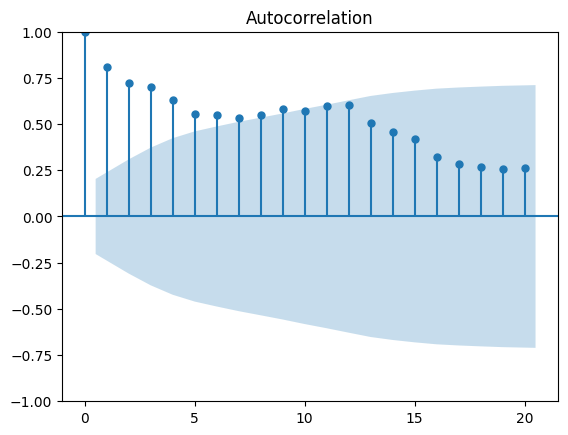

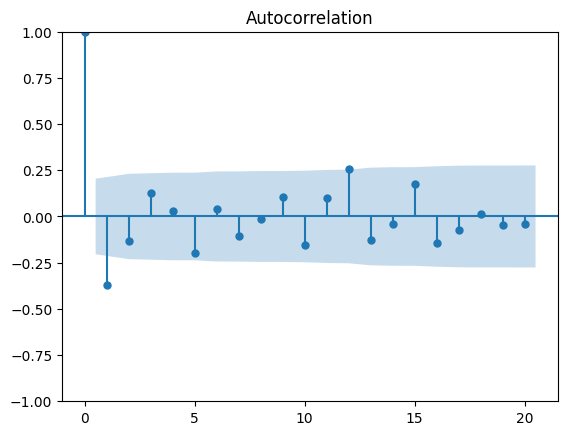

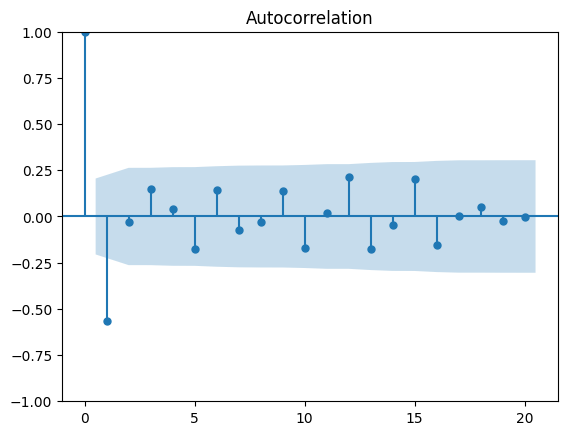

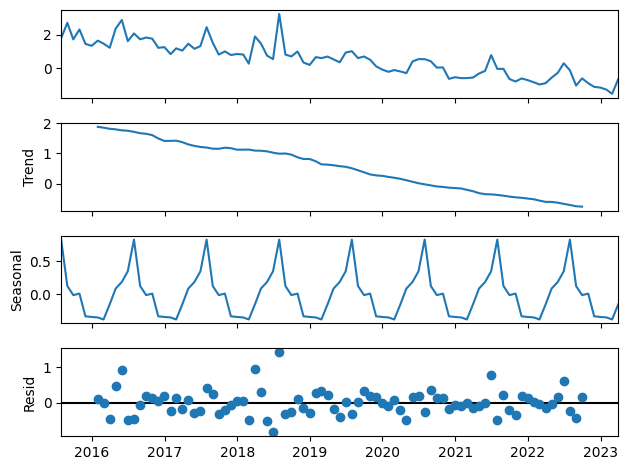

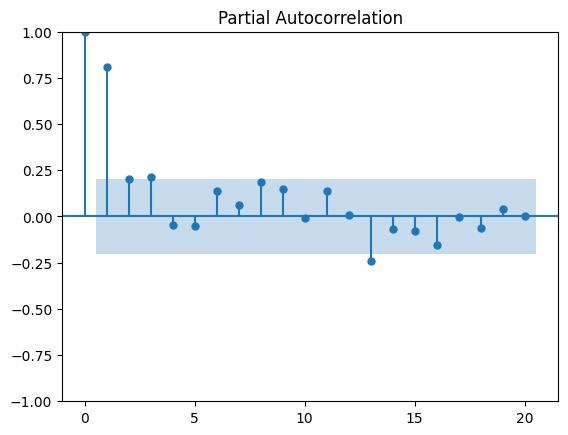

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.11 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=113.957, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=111.464, Time=0.46 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.69 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=111.957, Time=0.12 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=112.947, Time=0.13 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=110.511, Time=2.52 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=3.21 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.71 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=112.061, Time=1.01 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=108.262, Time=2.87 sec
 ARIMA(2,0,0)(1,1,0)[12] intercept   : AIC=107.755, Time=0.72 sec
 ARIMA(2,0,0)(0,1,0)[12] intercept   : AIC=111.669, Time=0.18 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.78 sec
 ARIMA(2,0,0)(0,1,1)[12] intercept   : AIC=101.917, T

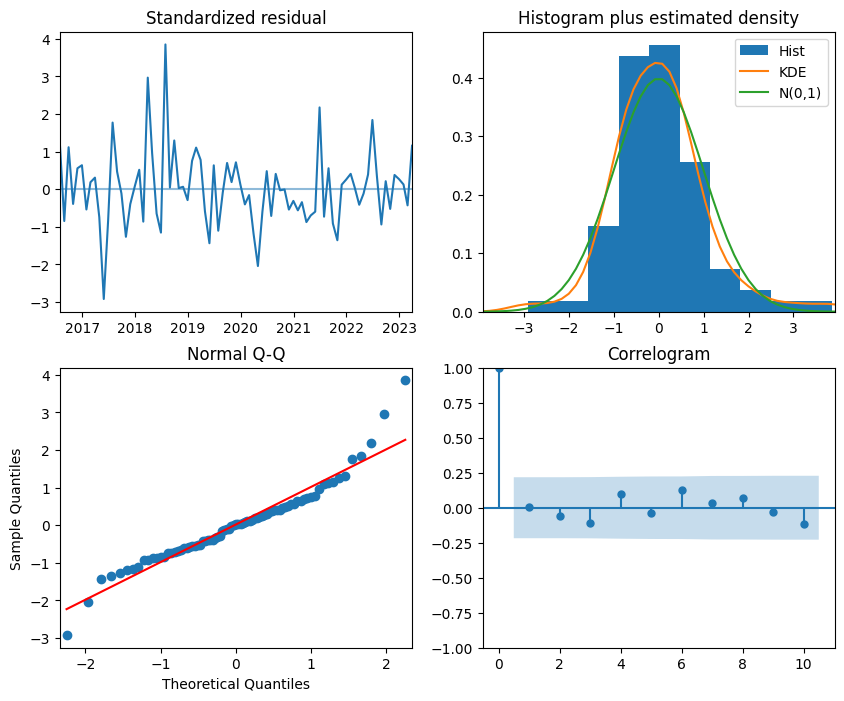

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   93
Model:             SARIMAX(2, 0, 0)x(0, 1, [1], 12)   Log Likelihood                 -44.954
Date:                              Sat, 11 May 2024   AIC                             99.908
Time:                                      08:53:38   BIC                            111.880
Sample:                                  07-31-2015   HQIC                           104.711
                                       - 03-31-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0018      0.001     -1.297      0.195      -0.005       0.001
ar.L1         -0.26

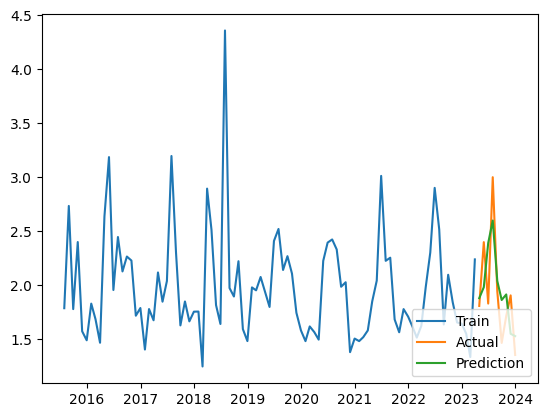

[0.03710502] [[-0.04025168]] [[0.03395837]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.04951219300906562

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 1.5}
[0.03760239] [[-0.04074904]] [[0.03445574]]
Mean of Residuals 0.14140554805399835
Mean of Residuals 0.15999414774454288


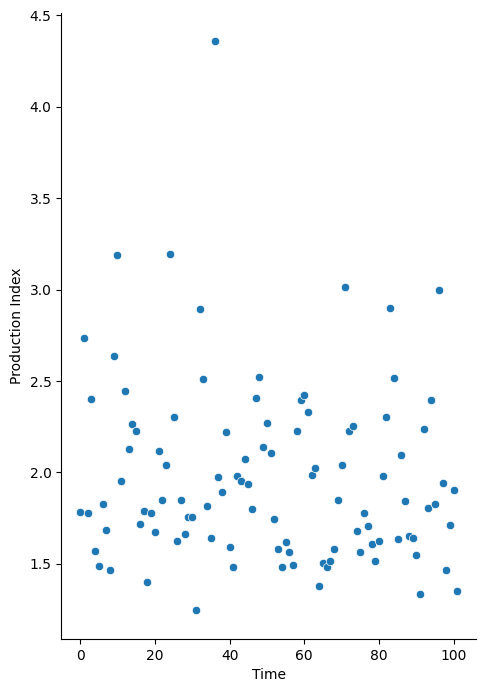

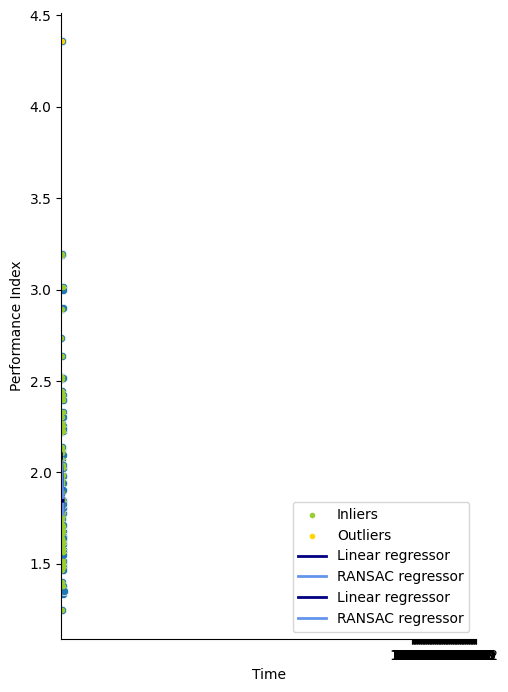

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.71720967] [[-4.78987848]] [[4.64454085]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -40.98844678525728

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[6.1983085] [[-6.27097731]] [[6.12563968]]
[8.61314579] [[-8.62001989]] [[8.60627169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -20.05064381959344

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[10.80407267] [[-10.81094677]] [[10.79719856]]
[16.29192307] [[-16.22118474]] [[16.3626614]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1.658773899724317

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[23.42082622] [[-23.35008789]] [[23.49156456]]
[22.08329833] [[-22.18342283]] [[21.98317383]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -54.90681355594322

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[30.05504296] [[-30.15516745]] [[29.95491846]]
[7.45571391] [[-7.46925612]] [[7.44217171]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -13.513219405835898

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[6.59495799] [[-6.60850019]] [[6.58141578]]
[10.56923876] [[-10.49255741]] [[10.64592011]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -387.4341621113735

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[10.56923876] [[-10.49255741]] [[10.64592011]]
[31.07035937] [[-31.08007984]] [[31.0606389]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.480464693110746

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[25.82906033] [[-25.8387808]] [[25.81933986]]
[15.25720661] [[-15.34741855]] [[15.16699466]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.3626285568737142

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[13.41320029] [[-13.50341223]] [[13.32298835]]
[5.9663519] [[-6.02882926]] [[5.90387454]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -0.39819045324182417

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[6.41382883] [[-6.4763062]] [[6.35135147]]
[26.87707859] [[-26.80434449]] [[26.94981269]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[44.34981586] [[-44.27708176]] [[44.42254996]]
[6.45022132] [[-6.56191935]] [[6.3385233]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -2.8466232535180667

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[6.08056102] [[-6.19225904]] [[5.96886299]]
[7.40496149] [[-7.65533827]] [[7.15458472]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -22.518297661255055

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 2.5}
[7.40496149] [[-7.65533827]] [[7.15458472]]
[10.75725935] [[-10.89624147]] [[10.61827722]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -15.424077684301054

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[10.75725935] [[-10.89624147]] [[10.61827722]]
[5.09927418] [[-5.11075494]] [[5.08779342]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -65.70377580537506

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.9277492] [[-8.93922996]] [[8.91626844]]
[6.73888379] [[-6.66315848]] [[6.81460911]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.16013779758671415

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[7.47377045] [[-7.39804514]] [[7.54949577]]
[24.32262794] [[-24.52493375]] [[24.12032213]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.3106945366833083

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[17.31898589] [[-17.5212917]] [[17.11668007]]
[5.27836669] [[-5.32962918]] [[5.2271042]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -109.19155888305447

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.4279543] [[-7.47921679]] [[7.37669181]]
[7.44490597] [[-7.4047146]] [[7.48509734]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -20.571822076450157

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.44490597] [[-7.4047146]] [[7.48509734]]
[14.60218985] [[-14.44773971]] [[14.75664]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -37.66773255298974

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[18.20298201] [[-18.04853186]] [[18.35743215]]
[13.64931486] [[-13.8417786]] [[13.45685112]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -6.467318818660023

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[13.64931486] [[-13.8417786]] [[13.45685112]]
[10.83493393] [[-10.9664571]] [[10.70341076]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -135.43086359844688

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[10.83493393] [[-10.9664571]] [[10.70341076]]
[5.21722014] [[-5.19474236]] [[5.23969792]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0383151052997506

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.67024161] [[-6.64776384]] [[6.69271939]]
[4.80625713] [[-4.72939738]] [[4.88311688]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.356392018351891

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.80625713] [[-4.72939738]] [[4.88311688]]
[11.9630448] [[-12.03762548]] [[11.88846412]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.3931889497703406

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[16.20541456] [[-16.27999524]] [[16.13083388]]
[6.2762294] [[-6.20163538]] [[6.35082342]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -4.393034026061666

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[6.2762294] [[-6.20163538]] [[6.35082342]]
[4.86081784] [[-4.93851346]] [[4.78312222]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4824.779041885239

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[5.29482037] [[-5.372516]] [[5.21712475]]
[21.60693802] [[-21.32481903]] [[21.88905701]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.943202658935667

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.77435292] [[-11.49223393]] [[12.05647191]]
[14.43435575] [[-14.57552389]] [[14.2931876]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.640460573269036

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[25.9132778] [[-26.05444594]] [[25.77210966]]
[24.37609159] [[-24.49615589]] [[24.2560273]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.697209664944879

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[14.85741769] [[-14.97748199]] [[14.7373534]]
[12.81424789] [[-12.8181869]] [[12.81030888]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.502498088471607

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[14.49832804] [[-14.50226705]] [[14.49438903]]
[14.23970036] [[-14.14553699]] [[14.33386373]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -504.816152020681

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[17.34964966] [[-17.25548629]] [[17.44381303]]
[25.92407839] [[-25.91130007]] [[25.9368567]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=3.0)

 The best score across ALL searched params:
 -107.8138647208156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 3.0}
[25.92407839] [[-25.91130007]] [[25.9368567]]
[15.43113702] [[-15.43317677]] [[15.42909727]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -2.8873810653200156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[15.43113702] [[-15.43317677]] [[15.42909727]]
               Production Index  Time
DateTimeIndex                        
2016-07-31             2.445494     0
2016-08-31             2.126390     1
2016-09-30             2.264445     2
2016-10-31             2.223762     3
2016-11-30             1.715927     4
2016-12-31             1.787288     5
2017-01-31             1.391346     6
2017-02-28             1.776980     7
2017-03-31             1.631598     8
2017-04-30             2.116797     9
2017-05-31             1.845939    10
2017-06-30             2.037709    11
2017-07-31             3.196462    12
2017-08-31             2.3

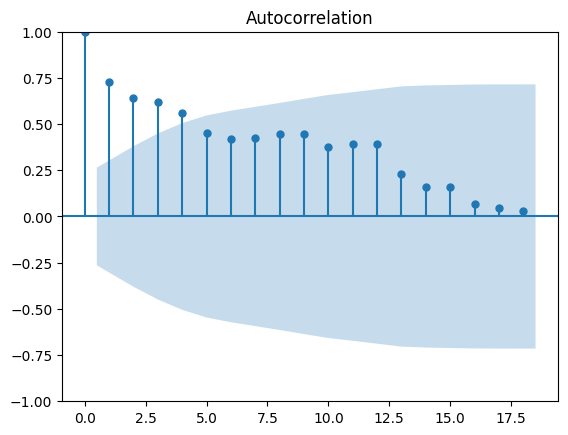

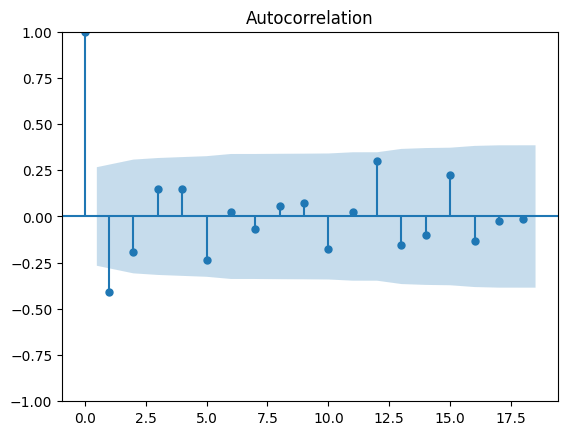

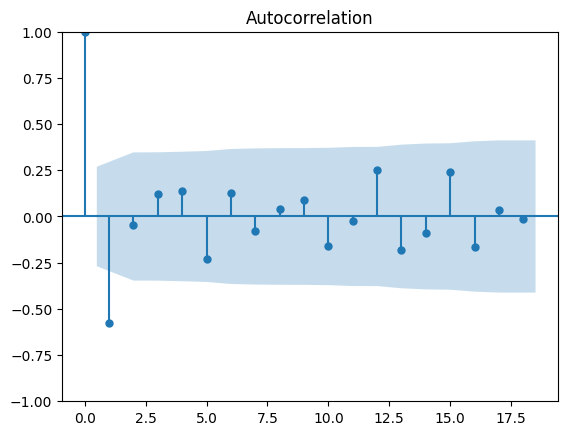

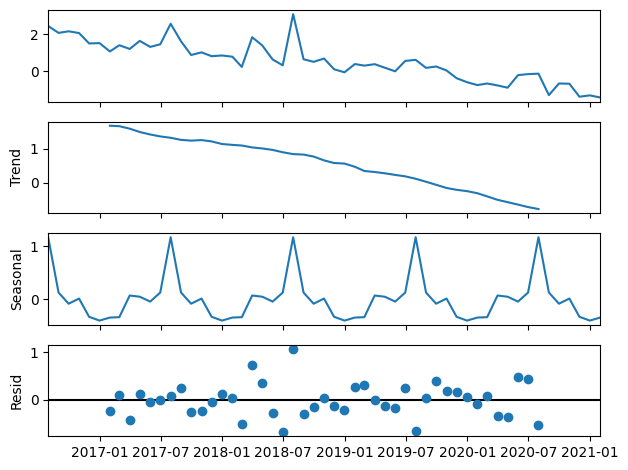

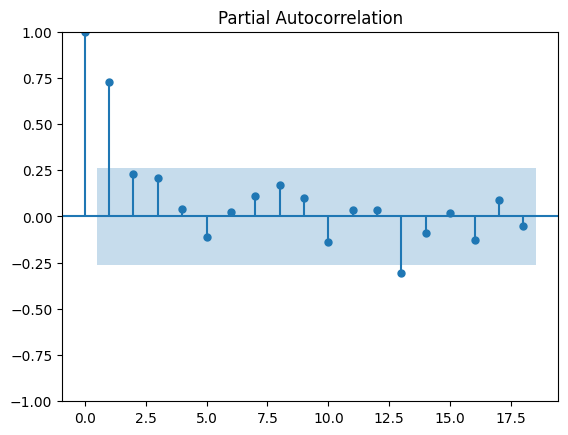

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.30 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=76.368, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=76.246, Time=0.45 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.83 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=74.368, Time=0.07 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=74.761, Time=0.24 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.67 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.07 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=76.961, Time=0.13 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=76.333, Time=0.07 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=78.186, Time=0.14 sec

Best model:  ARIMA(0,0,0)(0,1,0)[12]          
Total fit time: 5.089 seconds


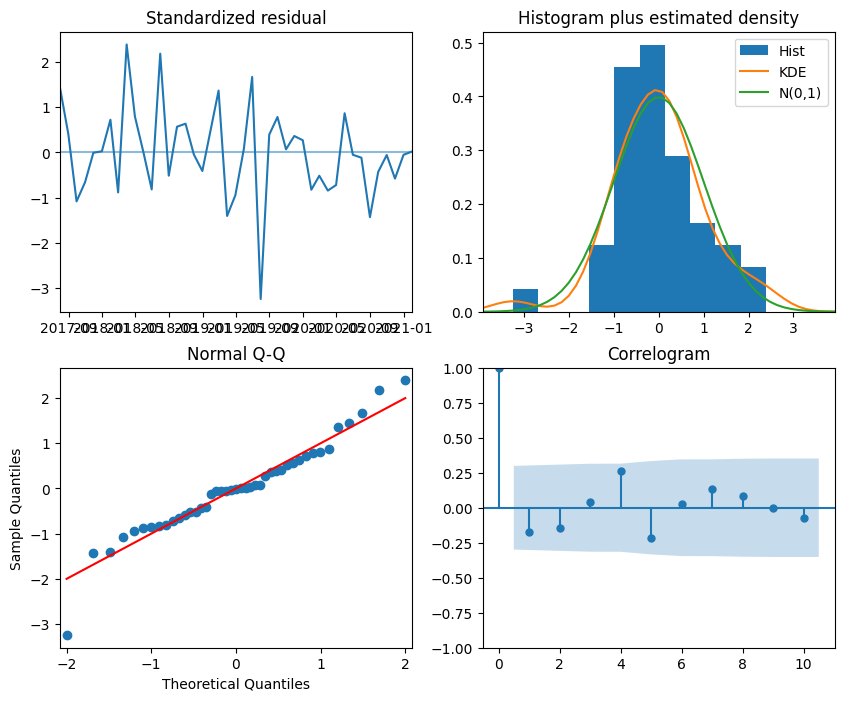

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   55
Model:             SARIMAX(0, 1, 0, 12)   Log Likelihood                 -35.184
Date:                  Sat, 11 May 2024   AIC                             74.368
Time:                          08:54:15   BIC                             77.890
Sample:                      07-31-2016   HQIC                            75.667
                           - 01-31-2021                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0040      0.007     -0.578      0.563      -0.018       0.010
sigma2         0.3008      0.049      6.173      0.000       0.205       0.396
Ljung-Box (L1) (Q):                 

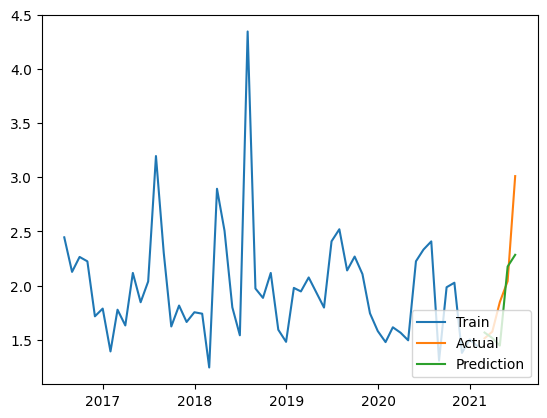

[0.0995849] [[-0.10219088]] [[0.09697891]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.4812071931678757

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 1.5}
[0.09825739] [[-0.10086337]] [[0.0956514]]
Mean of Residuals -0.08657847968158076
Mean of Residuals -0.0327256490437105


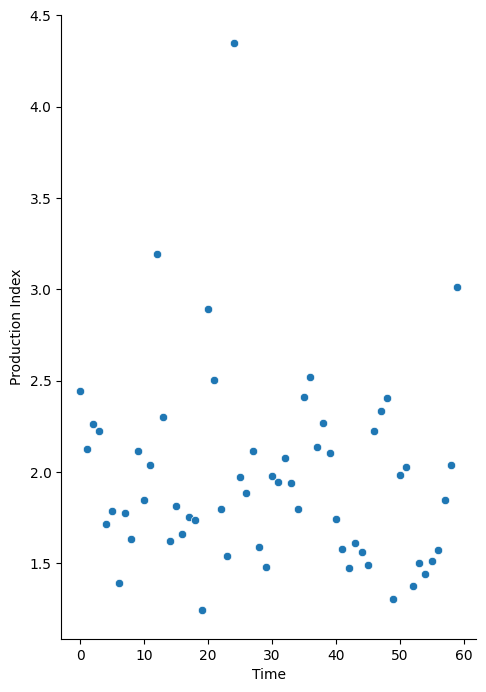

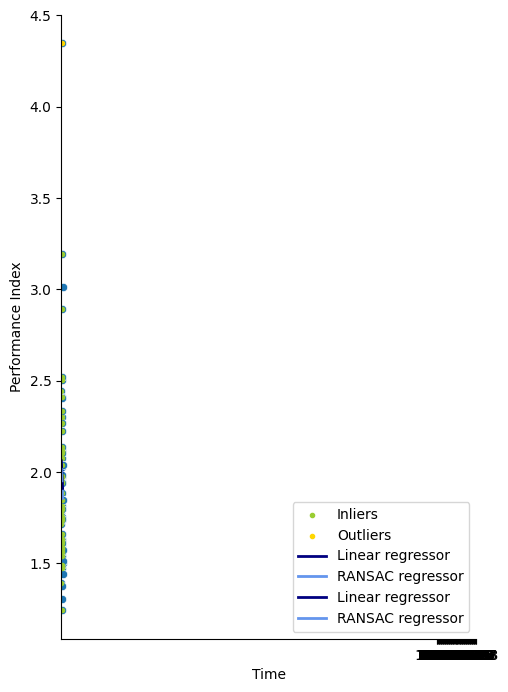

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Raggovidda
2002-01-01 00:00:00         NaN
2002-01-01 01:00:00         NaN
2002-01-01 02:00:00         NaN
2002-01-01 03:00:00         NaN
2002-01-01 04:00:00         NaN
...                         ...
2023-09-20 09:00:00   13.957150
2018-05-26 08:00:00   16.875242
2018-05-26 09:00:00   17.375954
2018-05-26 10:00:00   17.041075
2022-02-15 01:00:00   18.373873

[193267 rows x 1 columns]
##################Rye Vind###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2016-12-31 00:00:00  12.875197  277.492615  97655.585938         1.197409
2016-12-31 01:00:00  12.571404  277.602173  97610.593750         1.201609
2016-12-31 02:00:00  12.803711  277.760620  97596.437500         1.209797
2016-12-31 03:00:00  12.885748  277.627319  97535.429688         1.214577
2016-12-31 04:00:00  12.5

<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

             Rye Vind
2002-12-31        NaN
2003-12-31        NaN
2004-12-31        NaN
2005-12-31        NaN
2006-12-31        NaN
2007-12-31        NaN
2008-12-31        NaN
2009-12-31        NaN
2010-12-31        NaN
2011-12-31        NaN
2012-12-31        NaN
2013-12-31        NaN
2014-12-31        NaN
2015-12-31        NaN
2016-12-31   0.000000
2017-12-31  10.890411
2018-12-31   5.205479
2019-12-31   5.639269
2020-12-31   9.039162
2021-12-31   8.378995
2022-12-31   8.390411
2023-12-31   7.716895 <class 'pandas.core.frame.DataFrame'>
feedin_power_plant    607.589923
dtype: float64


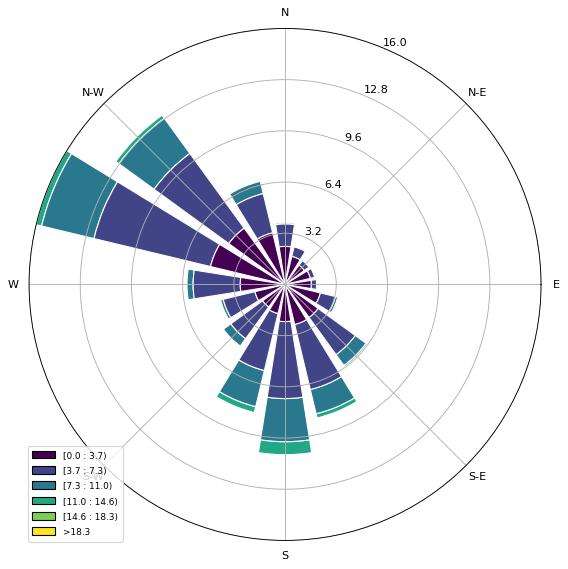

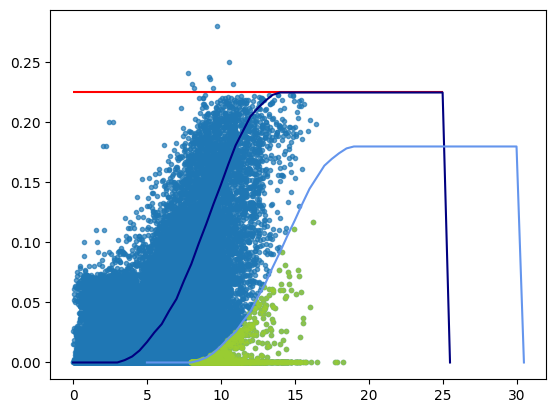

               Production Index  Time
DateTimeIndex                        
2016-12-31             1.054753     0
2017-01-31             1.783563     1
2017-02-28             1.680387     2
2017-03-31             1.823677     3
2017-04-30             1.982954     4
...                         ...   ...
2023-08-31             5.645478    80
2023-09-30             2.112379    81
2023-10-31             2.319308    82
2023-11-30             0.779526    83
2023-12-31             0.020214    84

[85 rows x 2 columns]


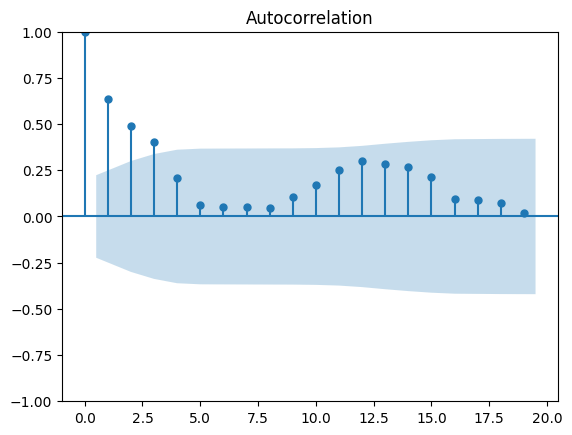

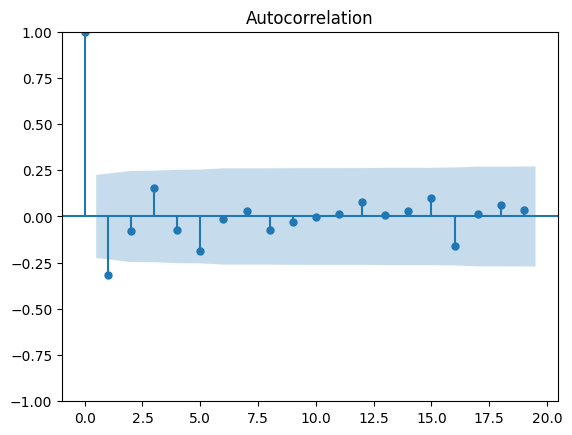

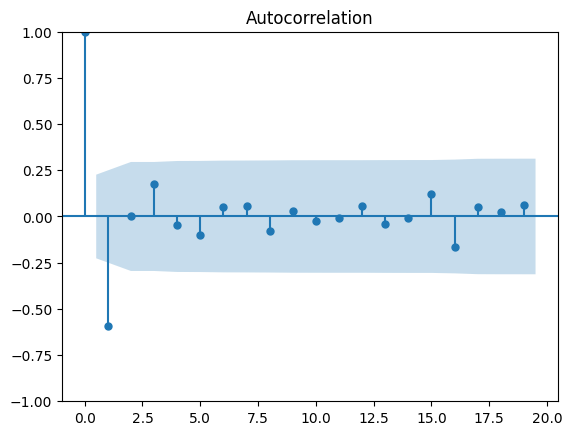

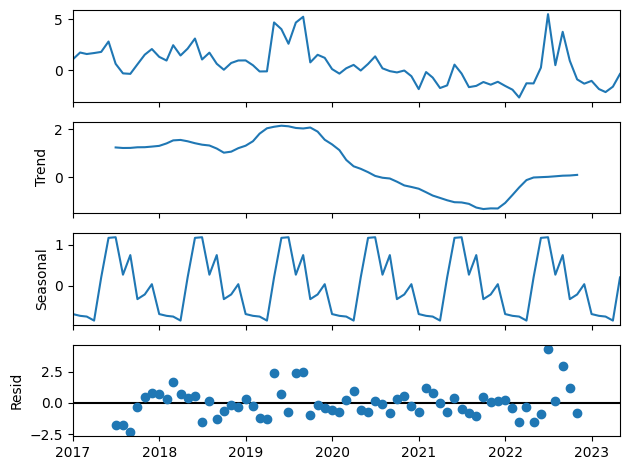

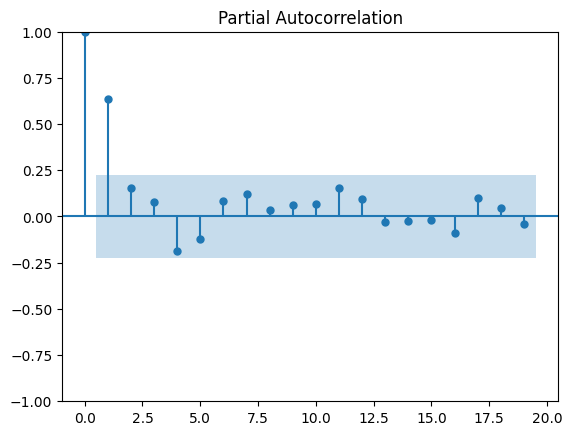

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=249.576, Time=0.45 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=279.784, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=254.671, Time=0.35 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=255.593, Time=0.42 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=277.784, Time=0.09 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=258.774, Time=0.10 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=251.530, Time=1.01 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=251.471, Time=0.96 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=254.467, Time=0.54 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=252.748, Time=1.92 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=249.846, Time=0.39 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=251.541, Time=0.83 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=251.458, Time=0.83 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=267.321, Time=0.42 sec
 ARIMA(0,0,2)(0,1,1)[12] intercep

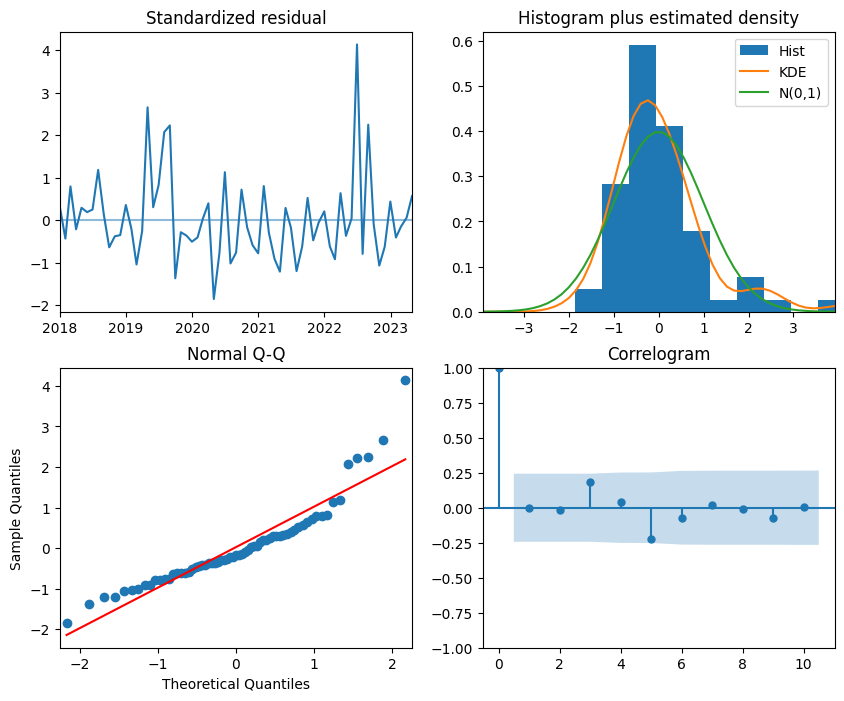

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   77
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 12)   Log Likelihood                -118.788
Date:                            Sat, 11 May 2024   AIC                            247.576
Time:                                    08:54:48   BIC                            258.448
Sample:                                12-31-2016   HQIC                           251.865
                                     - 04-30-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0143      0.031      0.461      0.645      -0.046       0.075
ar.L1          0.7494      0.206   

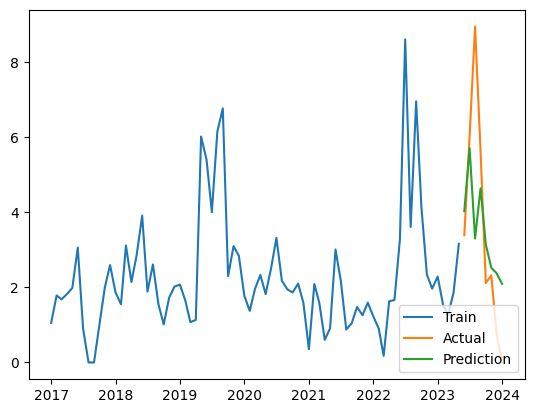

[0.27573426] [[-0.27055013]] [[0.28091839]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=30, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3806555937539922

 The best parameters across ALL searched params:
 {'min_samples': 30, 'residual_threshold': 0.375}
[0.30363663] [[-0.29845251]] [[0.30882076]]
Mean of Residuals 0.8009130742754342
Mean of Residuals 1.394333950767841


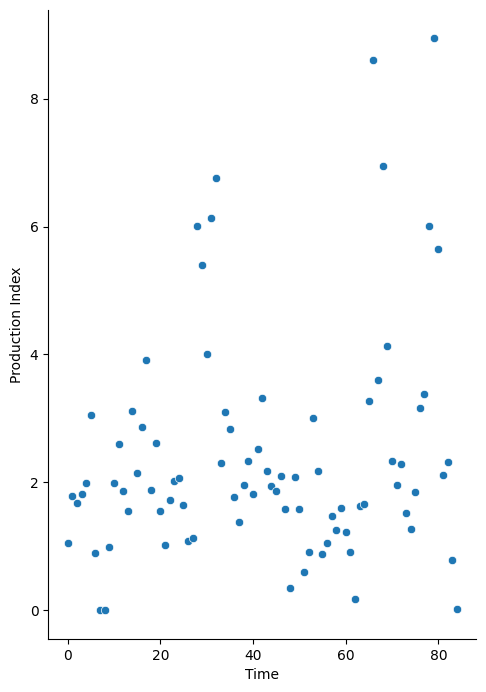

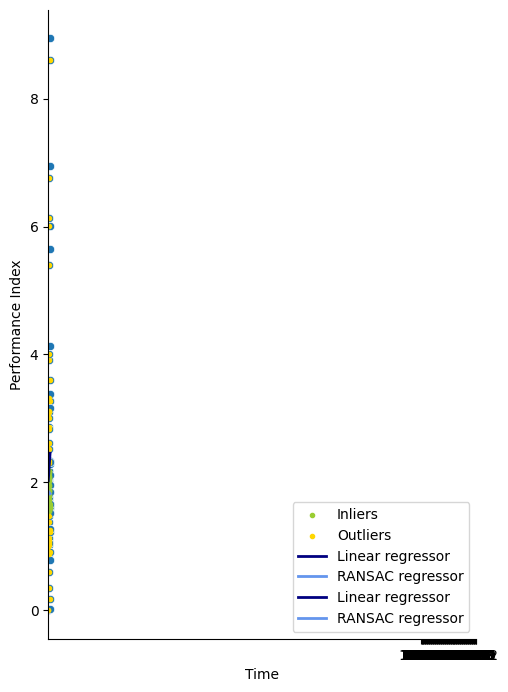

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[5.10098683] [[-5.09170088]] [[5.11027277]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -6.882130969753932

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.60659506] [[-7.59730912]] [[7.61588101]]
[48.09187966] [[-47.92178693]] [[48.2619724]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -29.92207179030847

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[88.19987557] [[-88.02978284]] [[88.36996831]]
[1.77006276] [[-1.77018263]] [[1.7699429]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.2

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.77006276] [[-1.77018263]] [[1.7699429]]
[32.58732406] [[-32.55281116]] [[32.62183696]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -79.17821197692268

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[32.96892633] [[-32.93441342]] [[33.00343923]]
[26.25442932] [[-26.01165131]] [[26.49720733]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[37.45666615] [[-37.21388814]] [[37.69944416]]
[129.22278626] [[-131.89677057]] [[126.54880195]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
120 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6532743332123728

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.08221293] [[-8.75619724]] [[3.40822862]]
[140.58640647] [[-143.26055693]] [[137.912256]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.1757123961295195

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.76479986] [[-14.43895033]] [[9.09064939]]
[11.74252359] [[-11.64375294]] [[11.84129424]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.5381356761863968

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[8.36684599] [[-8.26807534]] [[8.46561664]]
[18.16059396] [[-18.10777843]] [[18.21340949]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10546.57288624845

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[39.28063731] [[-39.22782178]] [[39.33345284]]
[288.14166585] [[-293.76485356]] [[282.51847813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
120 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.1218409674486545

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[78.81313629] [[-84.43632401]] [[73.18994858]]
[101.86450524] [[-104.85877814]] [[98.87023235]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
113 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
23 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -935.642598394386

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[117.73630588] [[-120.73057878]] [[114.74203299]]
[44.1058872] [[-45.20861327]] [[43.00316114]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
133 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
43 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.745265010212452

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[9.17548901] [[-10.27821508]] [[8.07276295]]
[14.2406029] [[-14.12659096]] [[14.35461485]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3510671500387554

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[14.79476312] [[-14.68075117]] [[14.90877506]]
[25.49641391] [[-25.38059125]] [[25.61223656]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.05383968921269431

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[25.87927033] [[-25.76344767]] [[25.99509298]]
[14.4689037] [[-14.52704028]] [[14.41076712]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.2240378372238836

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[65.89375196] [[-65.95188854]] [[65.83561537]]
[14.30524292] [[-14.42409349]] [[14.18639235]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.6531874591762504

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[1.68917168] [[-1.80802225]] [[1.5703211]]
[119.97437017] [[-119.80118336]] [[120.14755697]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
112 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
22 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -13.312520322120985

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[17.7758043] [[-17.60261749]] [[17.94899111]]
[111.160317] [[-110.47201695]] [[111.84861705]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
119 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
29 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -5.2565282428842455

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 1.0}
[66.58023463] [[-65.89193457]] [[67.26853468]]
[74.74355126] [[-75.18844067]] [[74.29866185]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -663.6436576569517

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[57.33262475] [[-57.77751417]] [[56.88773534]]
[12.49648135] [[-12.46463256]] [[12.52833014]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.0709694852685796

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[12.49648135] [[-12.46463256]] [[12.52833014]]
[44.8508767] [[-45.0142054]] [[44.68754799]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -960.3781633457575

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[68.72074701] [[-68.88407571]] [[68.5574183]]
[1219.99584976] [[-1218.63424082]] [[1221.35745871]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
93 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -12.000899061812532

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[1312.13062168] [[-1310.76901274]] [[1313.49223063]]
[1331.37517617] [[-1320.18579936]] [[1342.56455298]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
115 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -4.103054304378015

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[421.94951185] [[-410.76013504]] [[433.13888866]]
[14.28911918] [[-14.24805882]] [[14.33017955]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -4.348583083403096

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[24.66700344] [[-24.62594307]] [[24.7080638]]
[99.53131743] [[-99.66603518]] [[99.39659968]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.1903123469343546

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[98.36023873] [[-98.49495647]] [[98.22552098]]
[3134.53870779] [[-3137.45103346]] [[3131.62638212]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
116 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
26 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.136798107469147

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[3145.56403421] [[-3148.47635988]] [[3142.65170854]]
[1381.94525948] [[-1392.62403386]] [[1371.2664851]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
140 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
50 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -1.1777865679555464

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.5}
[23.56776884] [[-34.24654322]] [[12.88899446]]
[2482.62682817] [[-2469.60271261]] [[2495.65094374]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
99 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
9 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -50.821519951981905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[5.94186097] [[7.0822546]] [[18.96597653]]
               Production Index  Time
DateTimeIndex                        
2016-12-31             1.054753     0
2017-01-31             1.839997     1
2017-02-28             1.705618     2
2017-03-31             1.937009     3
2017-04-30             2.046379     4
...                         ...   ...
2023-08-31             5.875365    80
2023-09-30             2.240797    81
2023-10-31             2.327861    82
2023-11-30             1.118069    83
2023-12-31             0.314773    84

[85 rows x 2 columns]


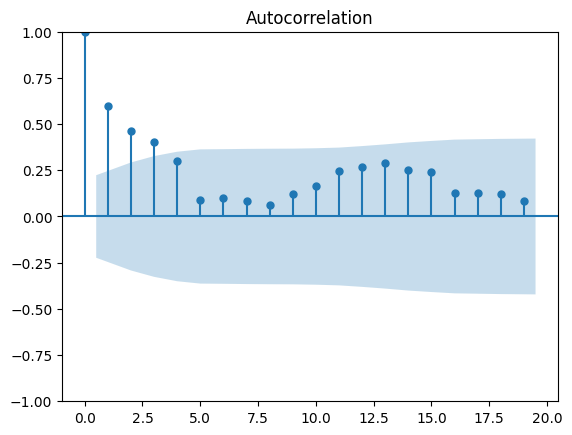

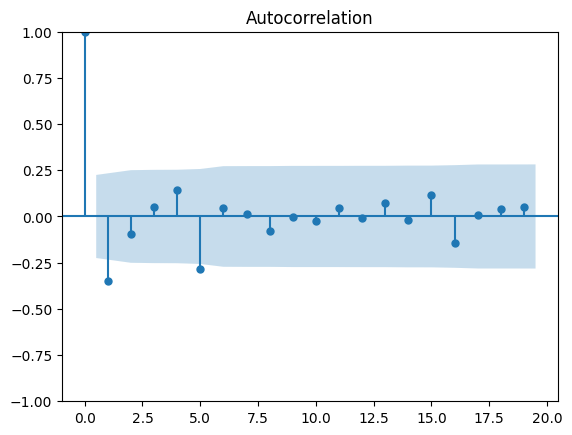

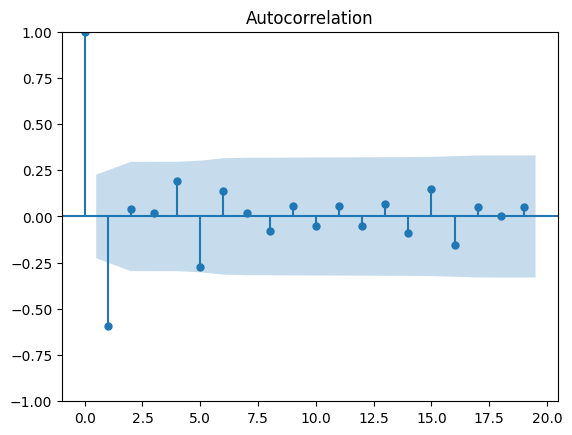

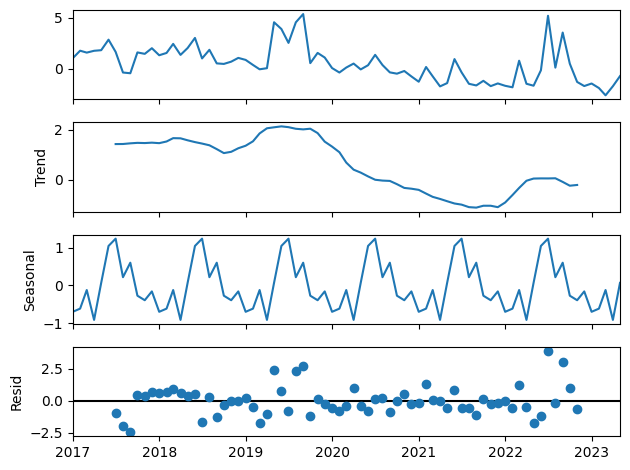

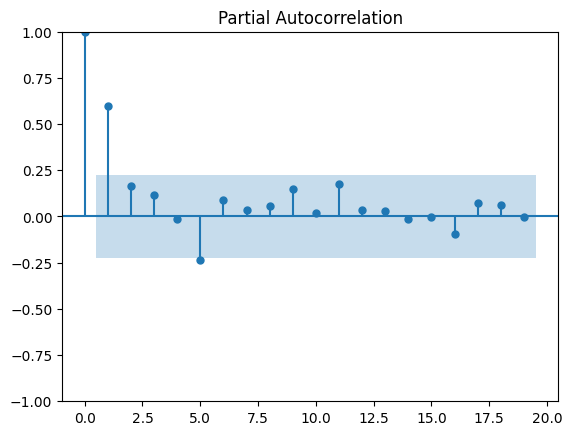

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=253.516, Time=0.86 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=278.962, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=262.208, Time=0.34 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.14 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=276.962, Time=0.09 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=266.709, Time=0.09 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=inf, Time=1.77 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=2.92 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=261.611, Time=0.41 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=2.97 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=253.353, Time=0.57 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=267.368, Time=0.08 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.65 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=2.08 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=2.51

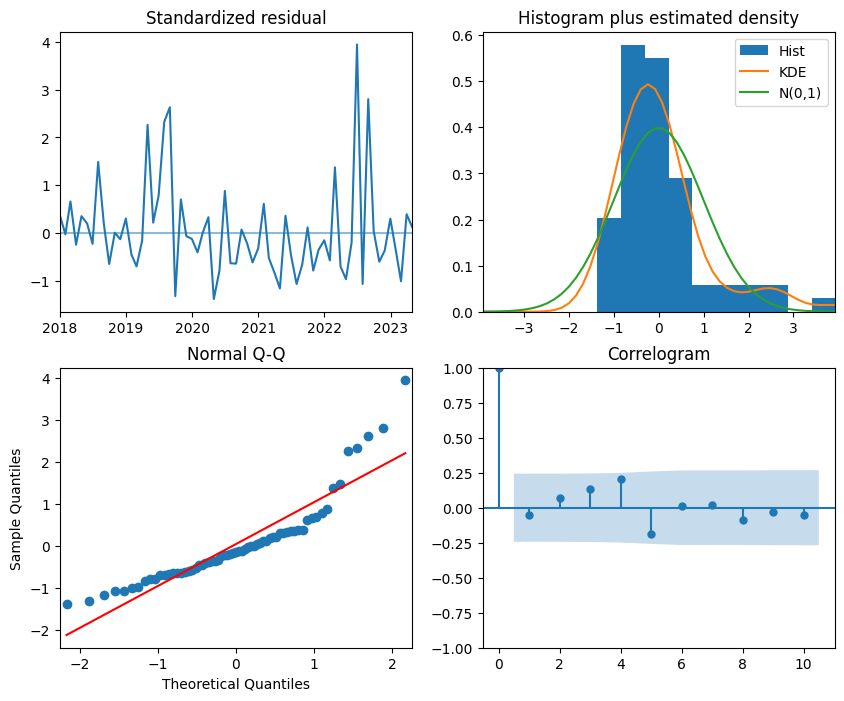

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   77
Model:             SARIMAX(1, 0, 0)x(0, 1, [1], 12)   Log Likelihood                -121.676
Date:                              Sat, 11 May 2024   AIC                            251.353
Time:                                      08:56:03   BIC                            260.050
Sample:                                  12-31-2016   HQIC                           254.785
                                       - 04-30-2023                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0124      0.017      0.716      0.474      -0.022       0.046
ar.L1          0.39

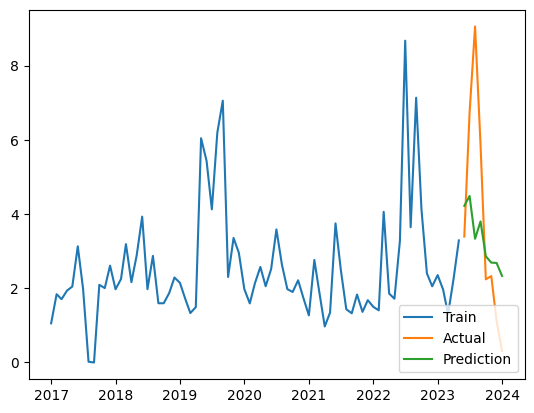

[0.26859819] [[-0.25791103]] [[0.27928534]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=40, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -0.2776122507886403

 The best parameters across ALL searched params:
 {'min_samples': 40, 'residual_threshold': 1.5}
[0.29204293] [[-0.28135578]] [[0.30273009]]
Mean of Residuals 0.47900521987730954
Mean of Residuals 1.1417011305905362


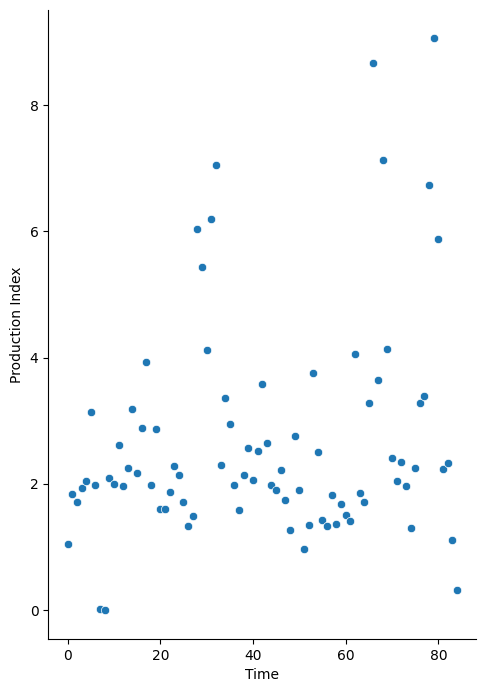

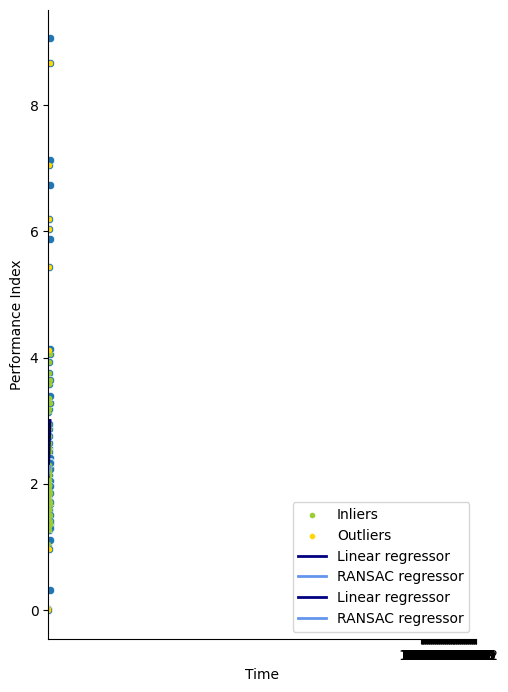

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.41860034] [[-3.40276283]] [[3.43443785]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -20.6277885102476

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[8.67233049] [[-8.65649298]] [[8.688168]]
[42.25872272] [[-42.09192479]] [[42.42552065]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -1150.6520315810644

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.75}
[83.65309467] [[-83.48629674]] [[83.8198926]]
[12.5965863] [[-12.59847144]] [[12.59470116]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.2

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.5965863] [[-12.59847144]] [[12.59470116]]
[31.73583354] [[-31.68930244]] [[31.78236465]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.961238094674448

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[31.46611849] [[-31.41958739]] [[31.5126496]]
[30.7218339] [[-30.49936162]] [[30.94430619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[21.57689678] [[-21.3544245]] [[21.79936907]]
[132.74511704] [[-135.42282814]] [[130.06740594]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
120 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.716718314784529

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[10.39645906] [[-13.07417017]] [[7.71874796]]
[148.80422866] [[-151.49942667]] [[146.10903066]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.187360631246903

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[3.37052975] [[-6.06572776]] [[0.67533174]]
[36.38519074] [[-36.11708611]] [[36.65329537]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.9452662542123811

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[10.45924188] [[-10.19113724]] [[10.72734651]]
[17.12027858] [[-17.04396493]] [[17.19659223]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -9538.875263038677

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[17.12027858] [[-17.04396493]] [[17.19659223]]
[281.61868462] [[-287.18557702]] [[276.05179222]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
122 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
32 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.9539484442259475

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[81.50931782] [[-87.07621022]] [[75.94242542]]
[98.838818] [[-101.81630158]] [[95.86133443]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
113 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
23 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -22.557043447017655

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.5}
[64.91249226] [[-67.88997584]] [[61.93500868]]
[28.4469074] [[-29.6895998]] [[27.20421499]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
132 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
42 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -4.010061231561132

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[41.92993091] [[-43.17262331]] [[40.68723851]]
[19.19060294] [[-19.06211562]] [[19.31909027]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.267325950903201

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[19.56713723] [[-19.43864991]] [[19.69562456]]
[27.57291352] [[-27.46608122]] [[27.67974581]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
91 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -0.44382104491031116

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[25.43538468] [[-25.32855239]] [[25.54221697]]
[8.39914075] [[-8.59248771]] [[8.2057938]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
92 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.439731263502905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[64.16116084] [[-64.3545078]] [[63.96781388]]
[22.88575028] [[-22.99599105]] [[22.77550952]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
95 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9095799738559096

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[22.56086274] [[-22.67110351]] [[22.45062198]]
[214.57161897] [[-214.11745859]] [[215.02577935]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
123 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
33 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.5)

 The best score across ALL searched params:
 -14.383273915535147

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.5}
[17.52881083] [[-17.07465045]] [[17.98297122]]
[285.05230472] [[-282.85033628]] [[287.25427317]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
106 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
16 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -2.5017993426588285

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[91.59485178] [[-89.39288333]] [[93.79682022]]
[226.19319899] [[-228.95454172]] [[223.43185626]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
104 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
14 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2159.1409067465847

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[49.2719574] [[-52.03330013]] [[46.51061467]]
[11.78297474] [[-11.71079345]] [[11.85515602]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -40.48856688914487

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[12.52369146] [[-12.45151017]] [[12.59587274]]
[34.33447418] [[-34.42089022]] [[34.24805815]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -4.9460157115006105

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[75.67942506] [[-75.7658411]] [[75.59300903]]
[1219.75531995] [[-1218.4022968]] [[1221.1083431]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
93 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes for

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -8.372394375776995

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[1312.17948774] [[-1310.82646459]] [[1313.53251089]]
[1330.83281415] [[-1319.68310684]] [[1341.98252146]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
116 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
26 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -5.222559472902127

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[417.99635138] [[-406.84664407]] [[429.14605869]]
[16.83388708] [[-16.78677049]] [[16.88100367]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -5.7087510871322635

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 1.0}
[27.035601] [[-26.98848441]] [[27.08271759]]
[108.94819524] [[-109.072465]] [[108.82392548]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -46.26066167401441

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[107.91620442] [[-108.04047418]] [[107.79193466]]
[3137.10452971] [[-3140.05994707]] [[3134.14911236]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
119 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
29 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -22.44464621785618

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[3146.52626045] [[-3149.4816778]] [[3143.5708431]]
[1484.06035128] [[-1493.97054678]] [[1474.15015577]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
153 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
63 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.617946168147007

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[57.76101317] [[-67.67120868]] [[47.85081766]]
[2508.06248915] [[-2494.84036573]] [[2521.28461257]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
100 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 529, in fit
    raise ValueError(
ValueError: RANSAC could not find a valid consensus set. All `max_trials` iterations were skipped because each randomly chosen sub-sample failed the passing criteria. See estimator attributes f

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -10.564816397305465

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[8.14048802] [[5.0816354]] [[21.36261144]]
               Production Index  Time
DateTimeIndex                        
2017-12-31             1.865971     0
2018-01-31             1.548941     1
2018-02-28             3.111747     2
2018-03-31             2.140604     3
2018-04-30             2.864387     4
2018-05-31             3.908986     5
2018-06-30             1.886155     6
2018-07-31             2.607188     7
2018-08-31             1.553981     8
2018-09-30             1.012130     9
2018-10-31             1.726527    10
2018-11-30             2.019301    11
2018-12-31             2.073216    12
2019-01-31             1.64006

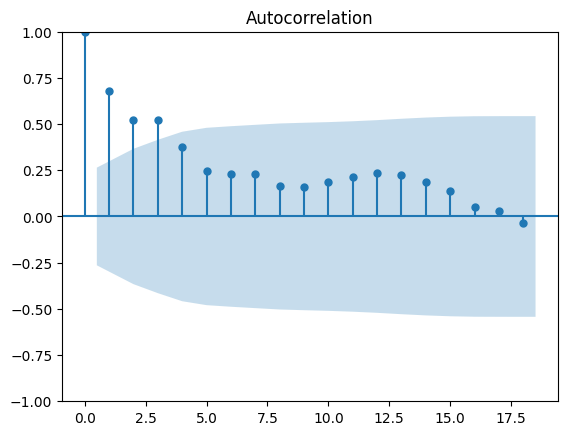

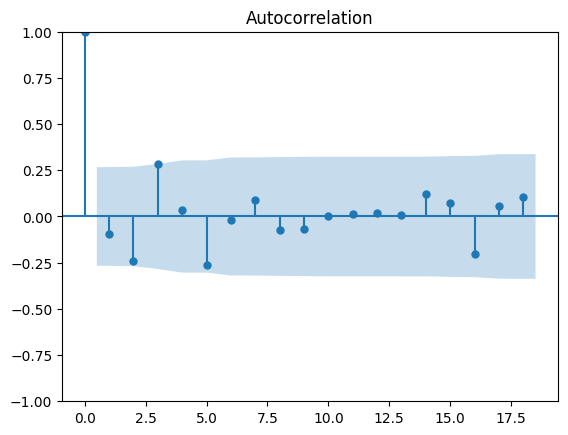

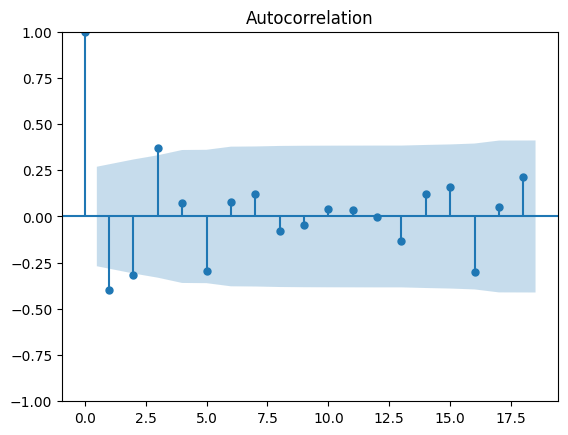

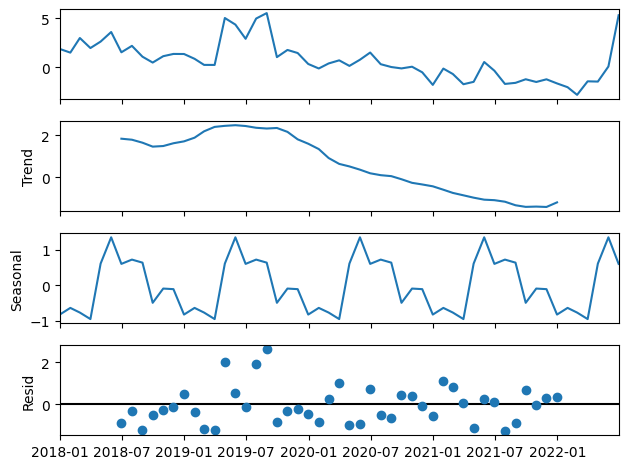

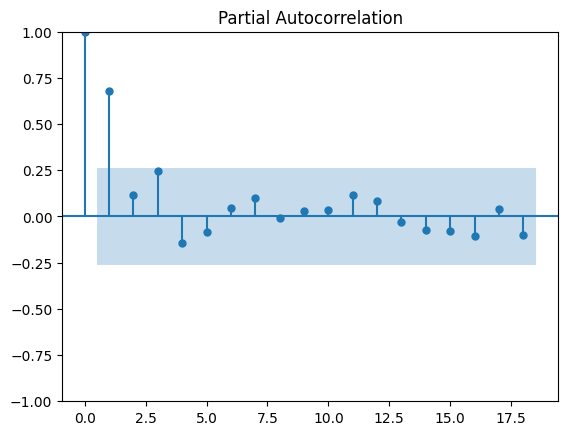

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=175.327, Time=0.41 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=184.180, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=175.508, Time=0.11 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=173.644, Time=0.33 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=180.635, Time=0.05 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=174.518, Time=0.31 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.83 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=172.958, Time=0.13 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=174.079, Time=0.36 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=inf, Time=1.86 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=175.155, Time=0.10 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=174.644, Time=0.22 sec
 ARIMA(0,1,2)(1,1,0)[12]             : AIC=173.430, Time=0.14 sec
 ARIMA(1,1,2)(1,1,0)[12]             : AIC=174.681, Time=0.26 sec
 ARIMA(0,1,1)(1,1,0)[12] intercept   : AI

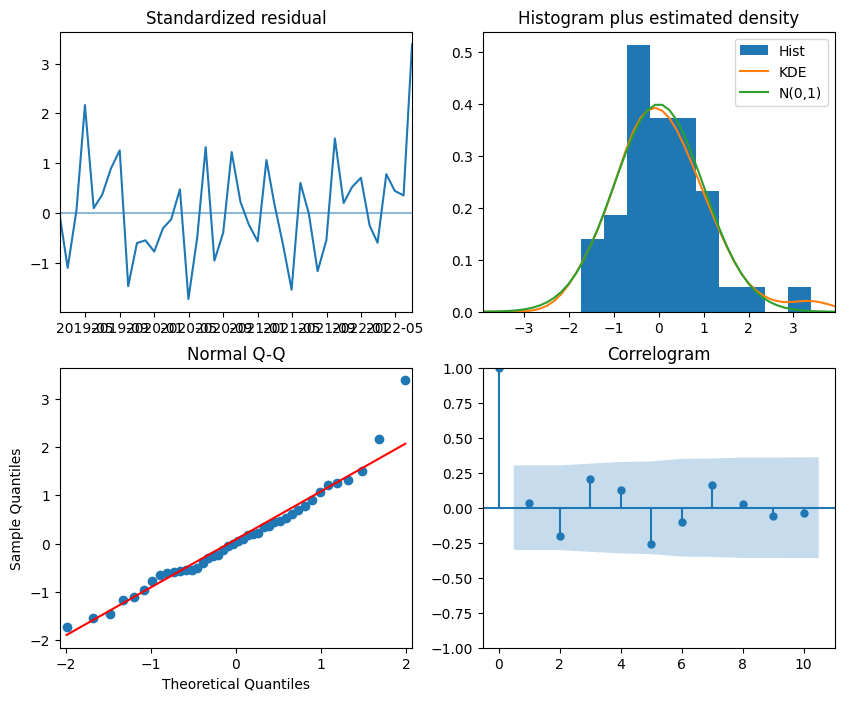

                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                   55
Model:             SARIMAX(0, 1, 1)x(1, 1, [], 12)   Log Likelihood                 -82.479
Date:                             Sat, 11 May 2024   AIC                            172.958
Time:                                     08:56:58   BIC                            179.909
Sample:                                 12-31-2017   HQIC                           175.506
                                      - 06-30-2022                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time       -2.557e-07   3.89e+05  -6.58e-13      1.000   -7.62e+05    7.62e+05
ma.L1         -0.4406      

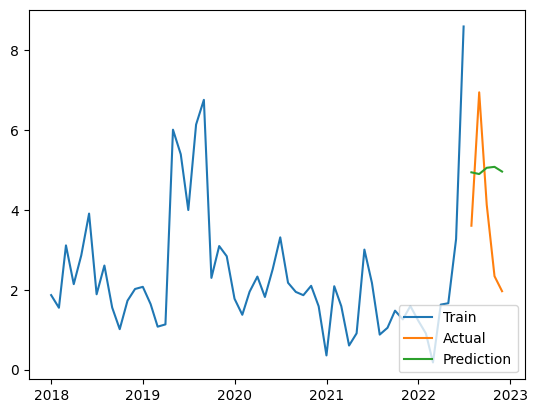

[0.59048243] [[-0.61740965]] [[0.56355521]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -0.1698175271665149

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 2.0}
[0.59400822] [[-0.62093545]] [[0.567081]]
Mean of Residuals 1.5456125292718899
Mean of Residuals 1.6004032252843698


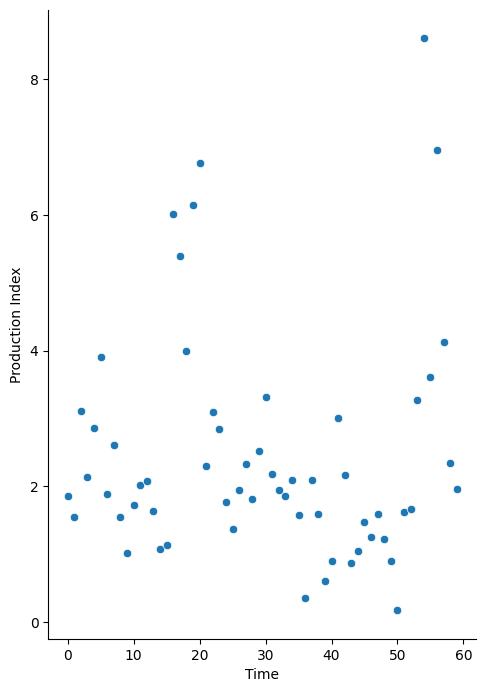

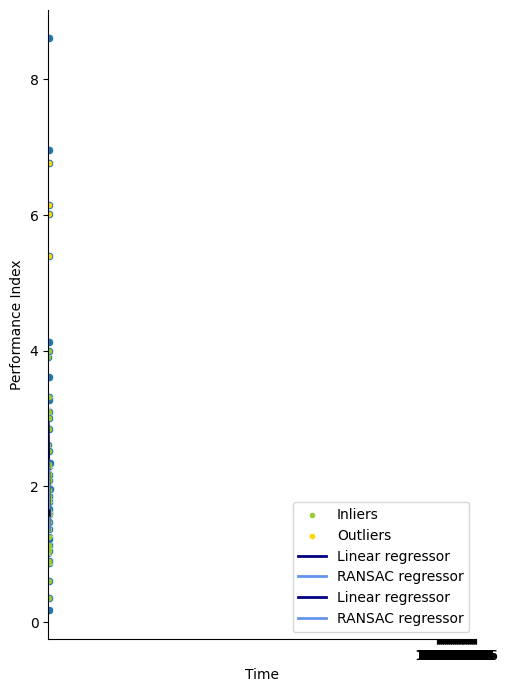

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                      Rye Vind
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2023-12-31 19:00:00  11.492371
2023-12-31 20:00:00  11.605264
2023-12-31 21:00:00  11.765419
2023-12-31 22:00:00  11.376547
2023-12-31 23:00:00  11.360726

[197683 rows x 1 columns]
##################Røyrmyra###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2016-10-03 23:00:00   6.282732  283.323303  102813.742188         0.548458
2016-10-04 00:00:00   7.030474  283.091217  102881.578125         0.548336
2016-10-04 01:00:00   7.350996  283.078491  102933.671875         0.548336
2016-10-04 02:00:00   7.902844  282.902679  102973.726562         0.548371
2016-10-04 03:00:00   8.481794

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    62537.674786
dtype: float64
          Observasjoner tot prod  Observasjoner valid prod  \
Røyrmyra                  192840                     63481   

          Missing values prod  Negative values prod  Zero values prod  \
Røyrmyra                    0                     0              2598   

          Prod over capacity  Observasjoner df_windpowerlib  \
Røyrmyra                4020                          63481   

          Missing values wind_peed  Missing values temperature  \
Røyrmyra                       NaN                         NaN   

          Missing values pressure  Missing values roughness_length  \
Røyrmyra                      NaN                              NaN   

          Observasjoner sim  Zero values sim  
Røyrmyra              63481             3349  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Røyrmyra
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31       NaN
2014-12-31       NaN
2015-12-31       NaN
2016-12-31  0.935891
2017-12-31  1.210046
2018-12-31  0.696347
2019-12-31  0.490868
2020-12-31  1.662113
2021-12-31  0.479452
2022-12-31  0.114155
2023-12-31  0.445205 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    61610.122839
dtype: float64


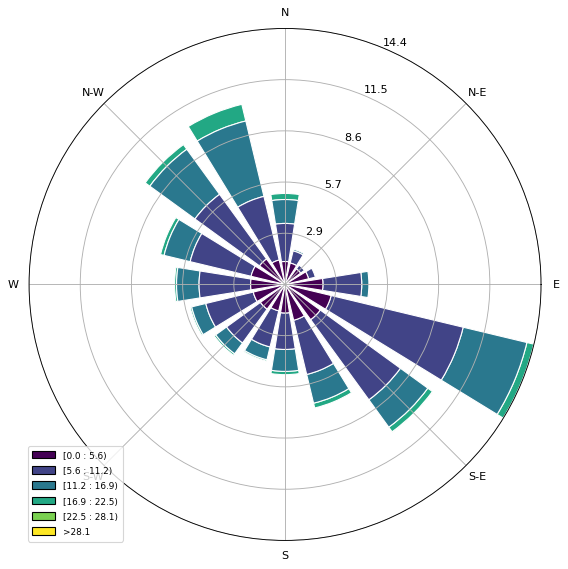

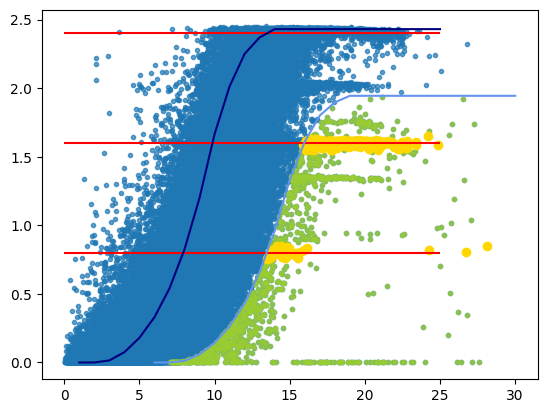

               Production Index  Time
DateTimeIndex                        
2016-10-31             0.955903     0
2016-11-30             0.888627     1
2016-12-31             0.766384     2
2017-01-31             0.739374     3
2017-02-28             0.915676     4
...                         ...   ...
2023-08-31             1.038516    82
2023-09-30             1.009485    83
2023-10-31             0.912359    84
2023-11-30             0.979984    85
2023-12-31             0.571026    86

[87 rows x 2 columns]


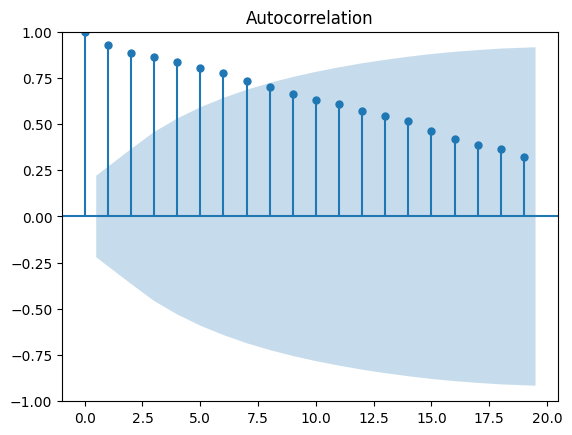

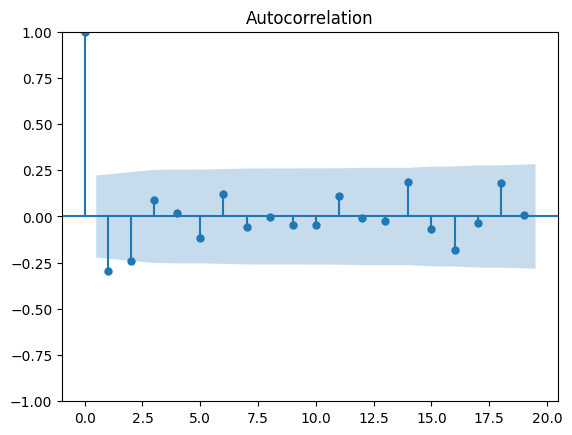

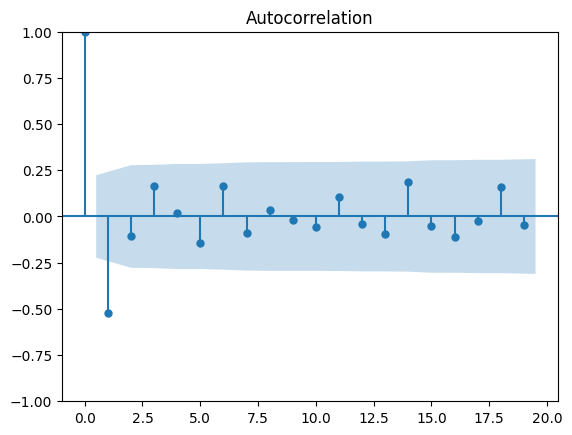

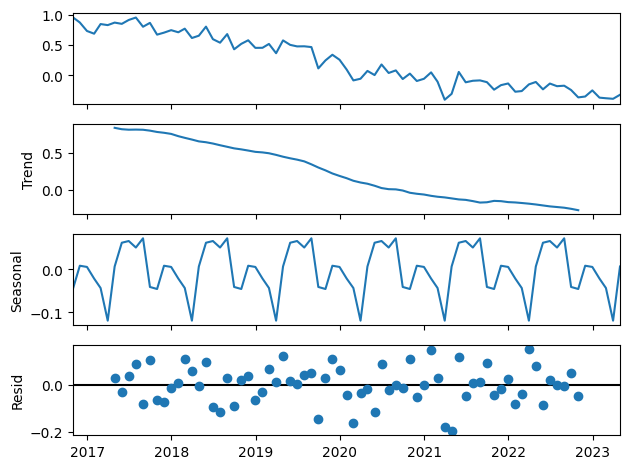

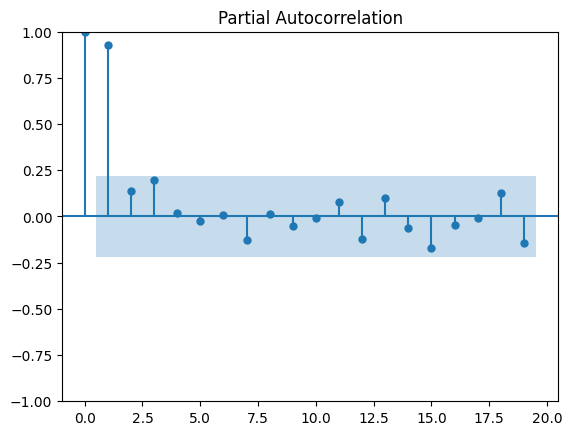

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-83.991, Time=2.01 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-51.314, Time=0.14 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-67.777, Time=0.90 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.18 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-53.314, Time=0.12 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-59.869, Time=0.38 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-80.522, Time=1.35 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=2.41 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-71.840, Time=1.35 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=2.79 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-82.351, Time=1.28 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=-78.140, Time=2.12 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=-83.556, Time=2.33 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-67.162, Time=1.87 sec
 ARIMA(0,0,2)(0,1,1)[12] intercept   : AIC=-7

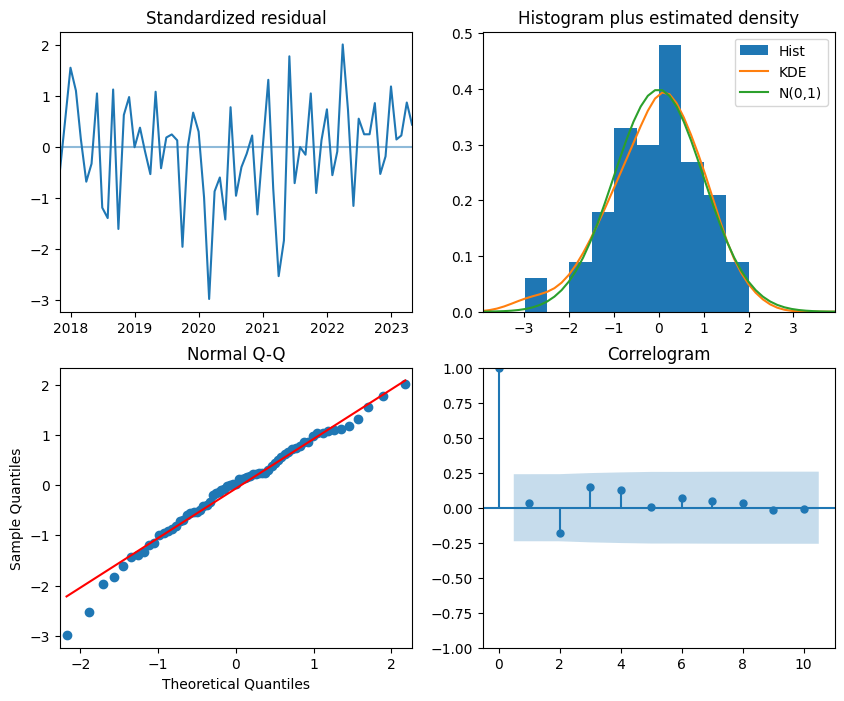

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   79
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 12)   Log Likelihood                  47.995
Date:                            Sat, 11 May 2024   AIC                            -83.991
Time:                                    08:57:38   BIC                            -70.763
Sample:                                10-31-2016   HQIC                           -78.756
                                     - 04-30-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3590      0.036     10.039      0.000       0.289       0.429
Time          -0.1298      0.099   

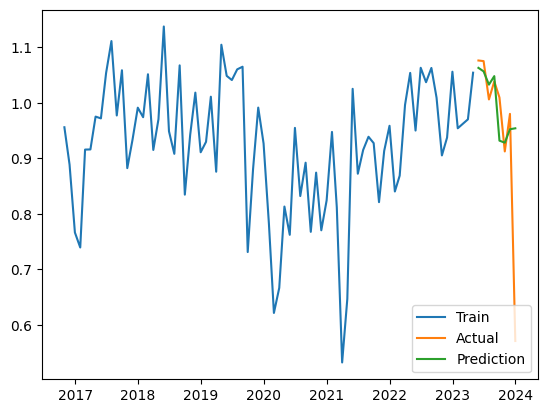

[0.0168023] [[-0.01815365]] [[0.01545094]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.0409455259149722

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.0168023] [[-0.01815365]] [[0.01545094]]
Mean of Residuals 0.12263948460188612
Mean of Residuals 0.12263948460188612


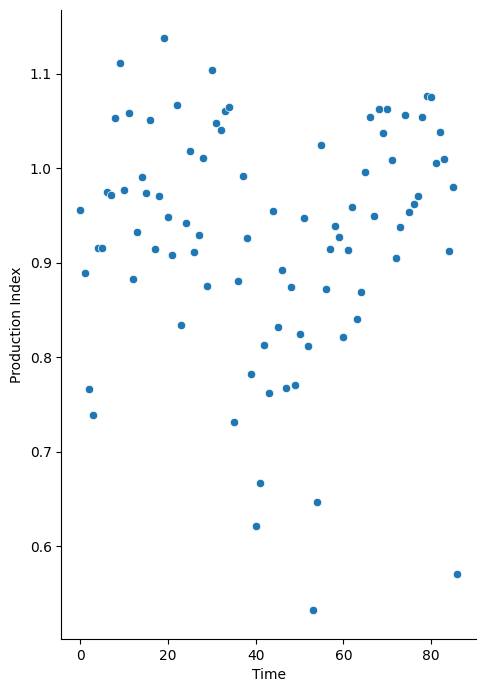

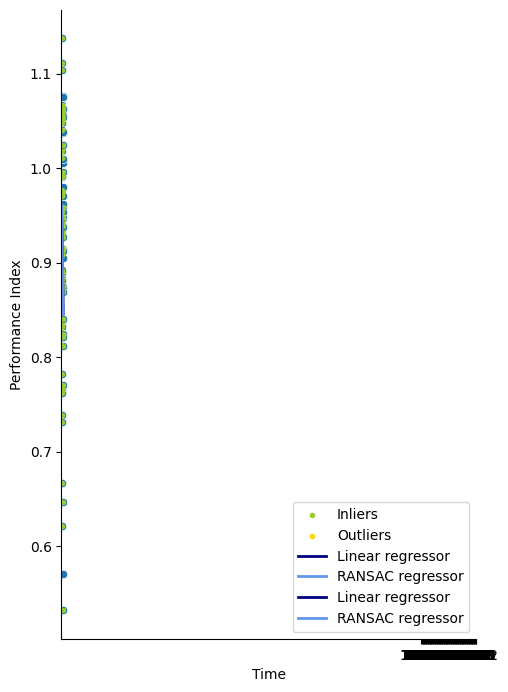

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.13379795] [[-3.1688843]] [[3.0987116]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13379795] [[-3.1688843]] [[3.0987116]]
[3.85257086] [[-3.80456399]] [[3.90057773]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -41559.30264709531

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.85257086] [[-3.80456399]] [[3.90057773]]
[2.07825717] [[-2.0935254]] [[2.06298895]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1124.2693452135256

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.07825717] [[-2.0935254]] [[2.06298895]]
[2.33717514] [[-2.34807761]] [[2.32627268]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -34.93487086733379

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.33717514] [[-2.34807761]] [[2.32627268]]
[5.97390302] [[-5.97194219]] [[5.97586386]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7598433548377492

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.97390302] [[-5.97194219]] [[5.97586386]]
[2.51669869] [[-2.51618894]] [[2.51720844]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.51669869] [[-2.51618894]] [[2.51720844]]
[6.9485571] [[-6.90491747]] [[6.99219674]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -24.80938592232128

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.9485571] [[-6.90491747]] [[6.99219674]]
[4.24305488] [[-4.23041693]] [[4.25569284]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -7.780644011470963

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.24305488] [[-4.23041693]] [[4.25569284]]
[4.39899141] [[-4.38878672]] [[4.40919609]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -16.771138778680147

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.39899141] [[-4.38878672]] [[4.40919609]]
[3.30892828] [[-3.29332477]] [[3.32453179]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.993336703165064

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.30892828] [[-3.29332477]] [[3.32453179]]
[1.69813101] [[-1.7217913]] [[1.67447073]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -212.30599438075578

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.69813101] [[-1.7217913]] [[1.67447073]]
[2.92433109] [[-2.9515539]] [[2.89710829]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.171205110432453

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.92433109] [[-2.9515539]] [[2.89710829]]
[0.62610116] [[-0.61667215]] [[0.63553017]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.5702114876227555

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.62610116] [[-0.61667215]] [[0.63553017]]
[2.62094794] [[-2.64488426]] [[2.59701161]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -51.90333648905397

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.62094794] [[-2.64488426]] [[2.59701161]]
[4.24591718] [[-4.22786834]] [[4.26396603]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18.807650860415738

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.24591718] [[-4.22786834]] [[4.26396603]]
[2.20757538] [[-2.2087759]] [[2.20637486]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -335.2232324435669

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.20757538] [[-2.2087759]] [[2.20637486]]
[0.24103619] [[-0.24726071]] [[0.23481166]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.642041992679799

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.24103619] [[-0.24726071]] [[0.23481166]]
[1.09879514] [[-1.15747102]] [[1.04011926]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -891.3534844568458

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05114905] [[-1.10982493]] [[0.99247317]]
[7.54724919] [[-7.48697868]] [[7.60751971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -97.52639974482925

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.40637234] [[-6.34610182]] [[6.46664285]]
[1.75574959] [[-1.7429716]] [[1.76852757]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.248576000531489

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.75574959] [[-1.7429716]] [[1.76852757]]
[6.27316721] [[-6.28124075]] [[6.26509366]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -544.6780682429551

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.27316721] [[-6.28124075]] [[6.26509366]]
[0.78309428] [[-0.76776672]] [[0.79842183]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.478887161287812

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.78309428] [[-0.76776672]] [[0.79842183]]
[2.53679319] [[-2.54712808]] [[2.52645831]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18.162265067894392

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.53679319] [[-2.54712808]] [[2.52645831]]
[5.72806512] [[-5.69152778]] [[5.76460247]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.0565230858857513

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.13635562] [[-7.09981828]] [[7.17289296]]
[2.19339952] [[-2.18886033]] [[2.1979387]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9269978365545177

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.19339952] [[-2.18886033]] [[2.1979387]]
[1.37941761] [[-1.38877555]] [[1.37005968]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -566.1065536131116

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.37941761] [[-1.38877555]] [[1.37005968]]
[1.82493142] [[-1.82132647]] [[1.82853636]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.165878603462649

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.64557563] [[-1.64197069]] [[1.64918057]]
[4.86612152] [[-4.83016582]] [[4.90207722]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -72.846767848138

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.86612152] [[-4.83016582]] [[4.90207722]]
[6.11426303] [[-6.1200376]] [[6.10848847]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.58027891468254

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.11426303] [[-6.1200376]] [[6.10848847]]
               Production Index  Time
DateTimeIndex                        
2016-10-31             0.956885     0
2016-11-30             0.888991     1
2016-12-31             0.801014     2
2017-01-31             0.813519     3
2017-02-28             0.919997     4
...                         ...   ...
2023-08-31             1.040812    82
2023-09-30             1.010568    83
2023-10-31             0.915957    84
2023-11-30             0.988773    85
2023-12-31             0.573052    86

[87 rows x 2 columns]


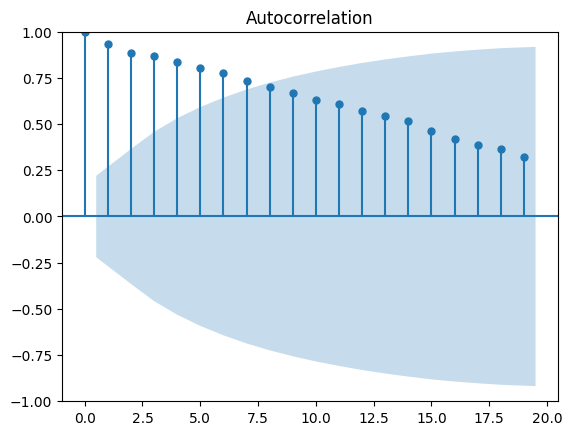

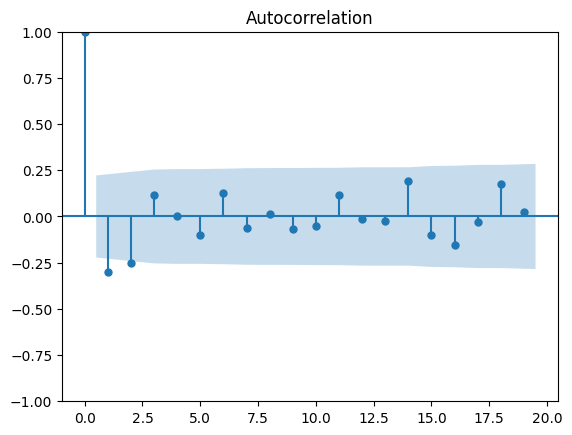

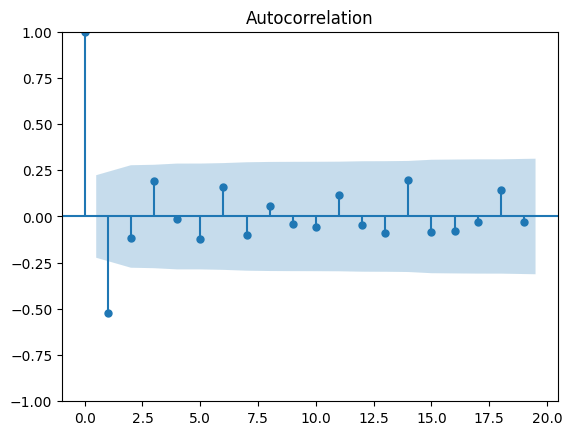

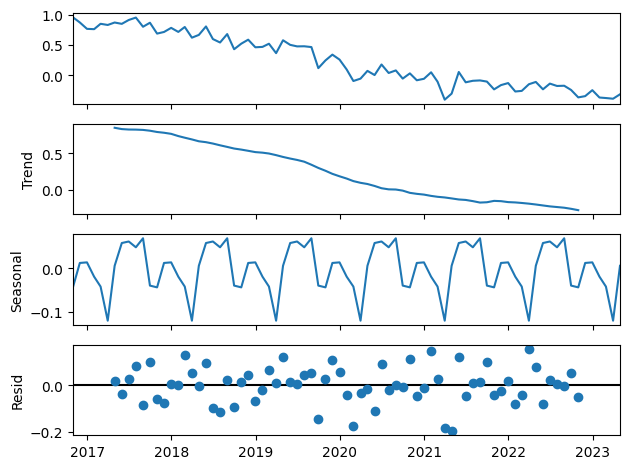

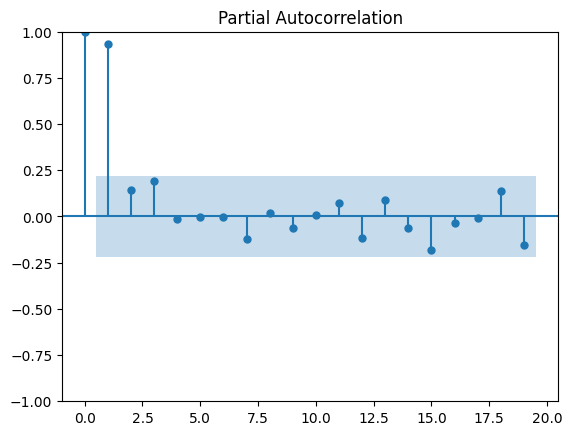

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.64 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-51.149, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-67.392, Time=0.73 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.34 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-53.149, Time=0.11 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-58.403, Time=0.10 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-74.840, Time=2.89 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-81.234, Time=5.11 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-80.927, Time=1.33 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=inf, Time=3.22 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=2.78 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-72.592, Time=1.65 sec
 ARIMA(2,0,0)(2,1,1)[12] intercept   : AIC=-80.583, Time=3.30 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=-81.443, Time=3.13 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-84.26

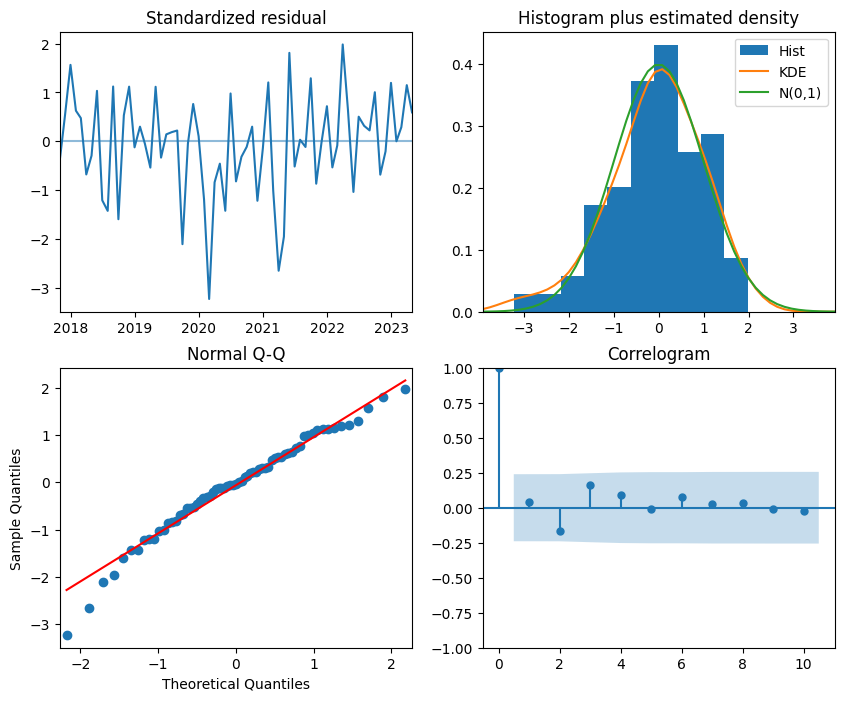

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   79
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 12)   Log Likelihood                  49.130
Date:                            Sat, 11 May 2024   AIC                            -84.260
Time:                                    08:58:48   BIC                            -68.828
Sample:                                10-31-2016   HQIC                           -78.154
                                     - 04-30-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2646      0.038      6.907      0.000       0.190       0.340
Time          -0.1128      0.090   

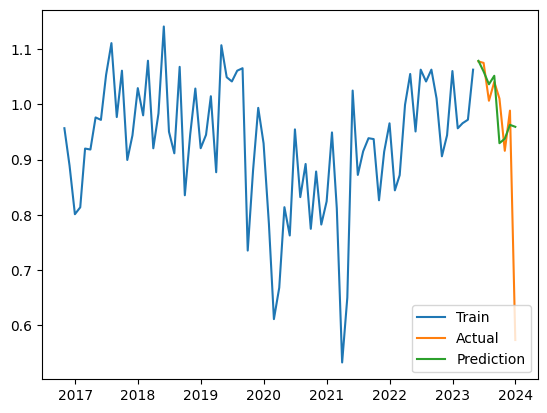

[0.01725642] [[-0.01879562]] [[0.01571722]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.1473999051574748

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.01725642] [[-0.01879562]] [[0.01571722]]
Mean of Residuals 0.12867182551074935
Mean of Residuals 0.12867182551074935


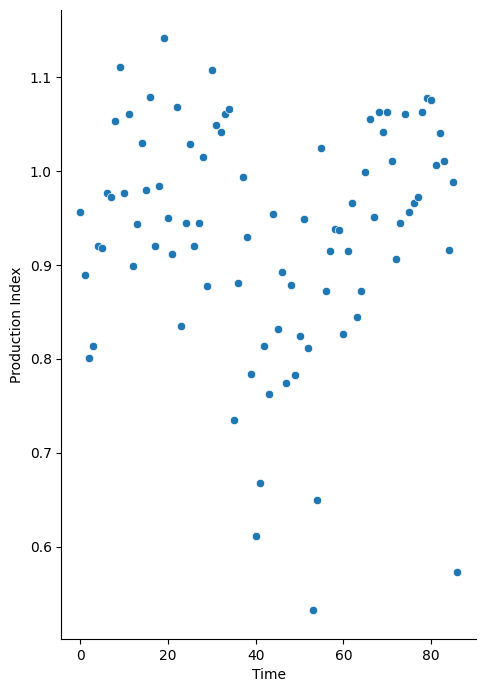

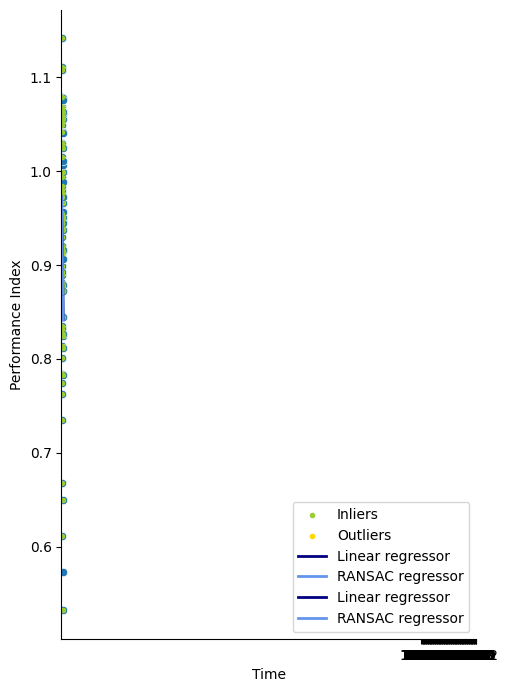

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.16146485] [[-3.19656612]] [[3.12636359]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.16146485] [[-3.19656612]] [[3.12636359]]
[3.32715235] [[-3.28943684]] [[3.36486786]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -221.3507218891976

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.32715235] [[-3.28943684]] [[3.36486786]]
[2.08456575] [[-2.10001253]] [[2.06911897]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1122.8765154114276

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.08456575] [[-2.10001253]] [[2.06911897]]
[2.32278487] [[-2.33368734]] [[2.3118824]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -34.93487086733379

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.32278487] [[-2.33368734]] [[2.3118824]]
[5.5391591] [[-5.53250485]] [[5.54581335]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.593779441481992

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.5391591] [[-5.53250485]] [[5.54581335]]
[2.94456419] [[-2.94019576]] [[2.94893261]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.94456419] [[-2.94019576]] [[2.94893261]]
[6.89779405] [[-6.85532999]] [[6.94025811]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.14295434841618

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.89779405] [[-6.85532999]] [[6.94025811]]
[4.22998674] [[-4.21757835]] [[4.24239513]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -7.889918314370794

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.22998674] [[-4.21757835]] [[4.24239513]]
[4.61263173] [[-4.60049944]] [[4.62476402]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.61301074889148

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.61263173] [[-4.60049944]] [[4.62476402]]
[3.32959942] [[-3.31414748]] [[3.34505135]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9330763034796035

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.32959942] [[-3.31414748]] [[3.34505135]]
[1.71089357] [[-1.73479883]] [[1.68698832]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -157.13731449502137

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.71089357] [[-1.73479883]] [[1.68698832]]
[2.96367003] [[-2.99097966]] [[2.9363604]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.155896225456663

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.96367003] [[-2.99097966]] [[2.9363604]]
[0.59793019] [[-0.58834626]] [[0.60751411]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.777027109509021

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.59793019] [[-0.58834626]] [[0.60751411]]
[2.71830478] [[-2.7431233]] [[2.69348626]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -70.51627169853319

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.71830478] [[-2.7431233]] [[2.69348626]]
[4.24412862] [[-4.22609304]] [[4.26216421]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18.766443923767497

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.24412862] [[-4.22609304]] [[4.26216421]]
[2.20757538] [[-2.2087759]] [[2.20637486]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -335.2232324435669

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.20757538] [[-2.2087759]] [[2.20637486]]
[0.25014685] [[-0.25660074]] [[0.24369297]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.249799427114677

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.25014685] [[-0.25660074]] [[0.24369297]]
[1.09835206] [[-1.15713477]] [[1.03956935]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2497.7444094157627

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05288675] [[-1.11166945]] [[0.99410404]]
[7.5317664] [[-7.47172388]] [[7.59180892]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -93.74303359275255

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.39148408] [[-6.33144156]] [[6.4515266]]
[1.6045644] [[-1.59178642]] [[1.61734239]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.248576000531489

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.6045644] [[-1.59178642]] [[1.61734239]]
[6.25716314] [[-6.26493375]] [[6.24939252]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -453.1248498979259

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.25716314] [[-6.26493375]] [[6.24939252]]
[0.80237029] [[-0.78744842]] [[0.81729216]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.384215761172538

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.80237029] [[-0.78744842]] [[0.81729216]]
[2.53563901] [[-2.54606017]] [[2.52521786]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -18.292694346221815

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.53563901] [[-2.54606017]] [[2.52521786]]
[5.68762078] [[-5.65144423]] [[5.72379732]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.1663008990677577

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.09840746] [[-7.06223091]] [[7.134584]]
[2.19805203] [[-2.19301888]] [[2.20308519]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.966380673186197

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.19805203] [[-2.19301888]] [[2.20308519]]
[1.3501957] [[-1.3593351]] [[1.34105629]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -464.8279019640337

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.3501957] [[-1.3593351]] [[1.34105629]]
[1.8291942] [[-1.82617174]] [[1.83221666]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.32776411238329

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.64944622] [[-1.64642376]] [[1.65246869]]
[4.87459988] [[-4.83855981]] [[4.91063996]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -66.3327881604981

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.87459988] [[-4.83855981]] [[4.91063996]]
[6.26102749] [[-6.26601947]] [[6.25603551]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.654031334462731

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.26102749] [[-6.26601947]] [[6.25603551]]
               Production Index  Time
DateTimeIndex                        
2017-10-31             0.882297     0
2017-11-30             0.932800     1
2017-12-31             0.991150     2
2018-01-31             0.973986     3
2018-02-28             1.051328     4
2018-03-31             0.915033     5
2018-04-30             0.970383     6
2018-05-31             1.137365     7
2018-06-30             0.948614     8
2018-07-31             0.908056     9
2018-08-31             1.067349    10
2018-09-30             0.834529    11
2018-10-31             0.942100    12
2018-11-30             1.0

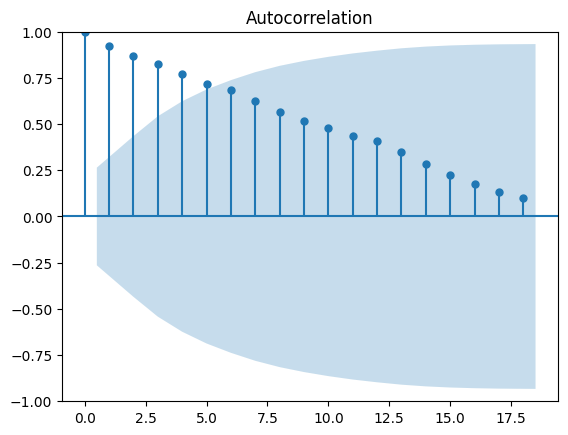

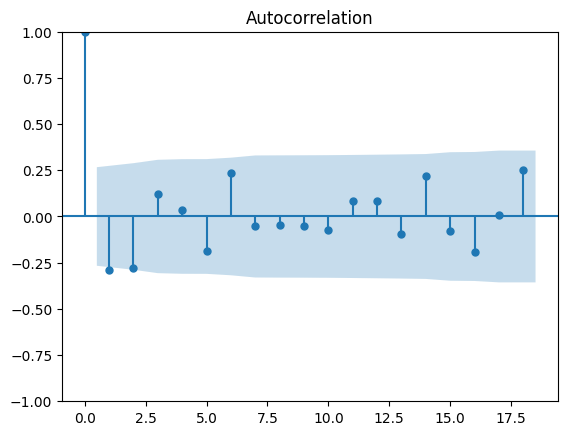

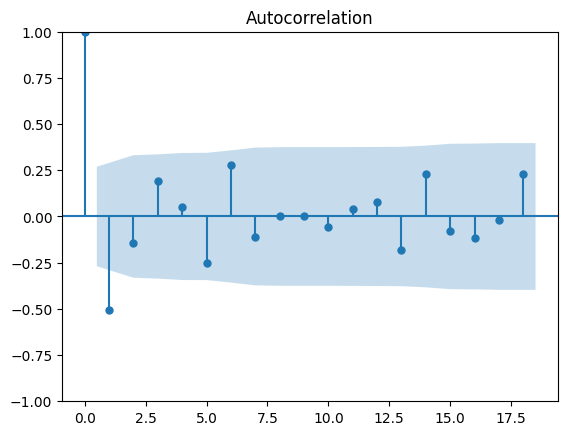

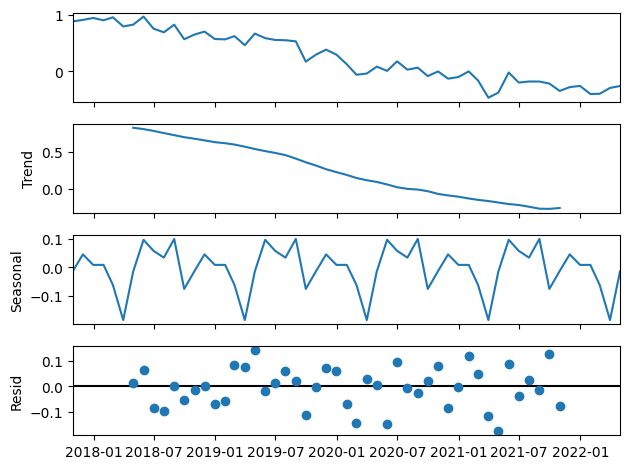

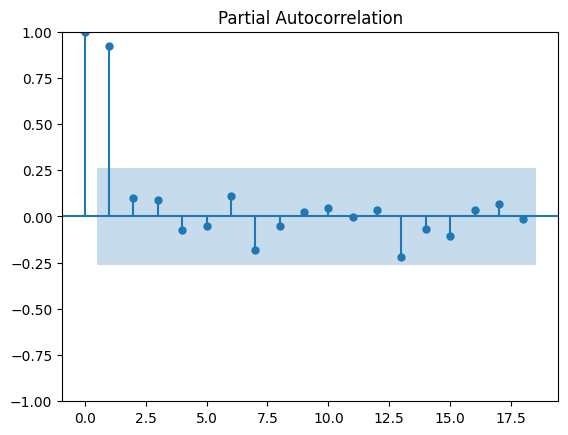

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.22 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-23.072, Time=0.06 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-35.045, Time=1.03 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.47 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-25.072, Time=0.06 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-30.065, Time=0.12 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-42.923, Time=2.35 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-42.417, Time=2.40 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.51 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-38.383, Time=1.90 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=inf, Time=2.69 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-40.894, Time=1.94 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-42.733, Time=1.46 sec
 ARIMA(2,0,1)(2,1,0)[12] intercept   : AIC=-38.998, Time=2.57 sec
 ARIMA(1,0,0)(2,1,0)[12]             : AIC=-44.92

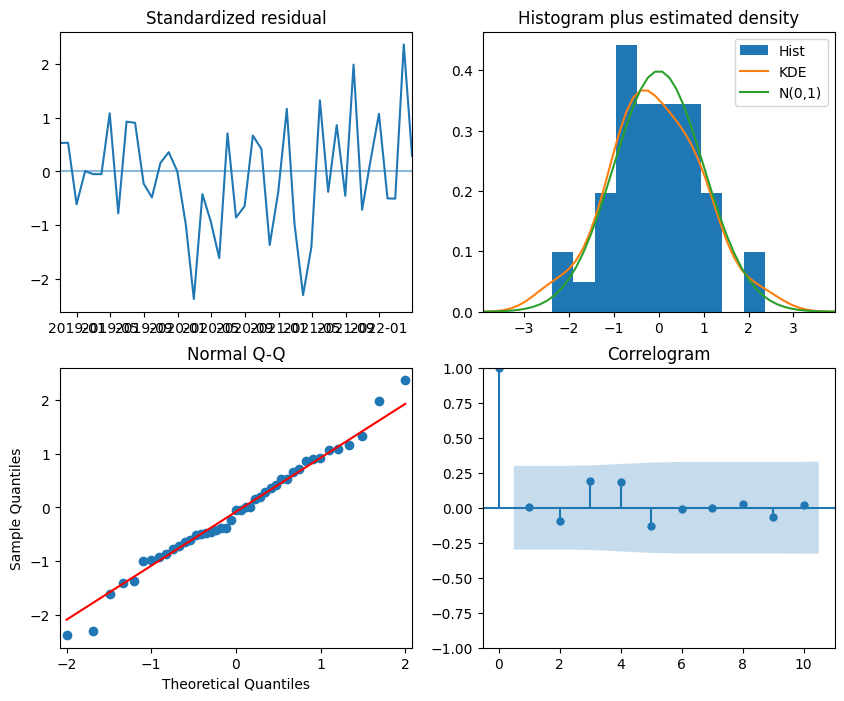

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(2, 1, [1], 12)   Log Likelihood                  29.285
Date:                              Sat, 11 May 2024   AIC                            -46.570
Time:                                      08:59:41   BIC                            -36.003
Sample:                                  10-31-2017   HQIC                           -42.673
                                       - 04-30-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0022      0.001     -2.065      0.039      -0.004      -0.000
ar.L1          0.35

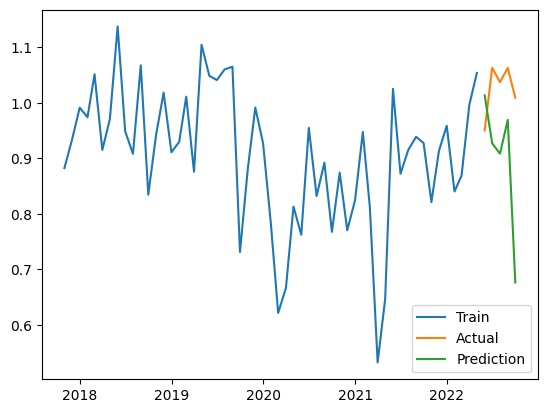

[0.04225638] [[-0.04633055]] [[0.0381822]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.24893726295141777

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.04225638] [[-0.04633055]] [[0.0381822]]
Mean of Residuals 0.18403369985858564
Mean of Residuals 0.18403369985858564


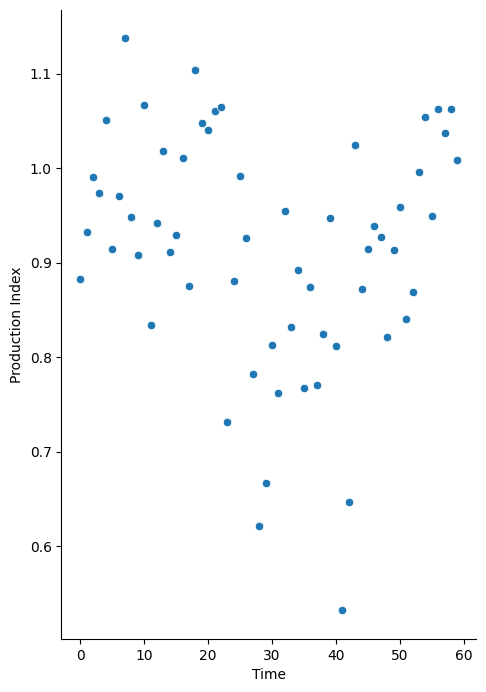

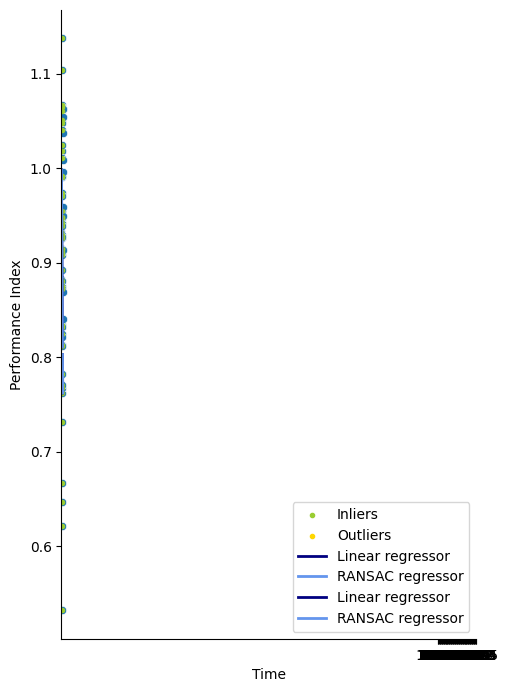

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                      Røyrmyra
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2023-12-08 12:00:00  16.084949
2023-12-08 13:00:00  16.422604
2023-12-08 14:00:00  16.181017
2023-12-21 18:00:00  24.850267
2023-12-21 19:00:00  23.369427

[193307 rows x 1 columns]
##################Sandøy###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2003-01-01 00:00:00  11.910254  275.244995  99773.328125         0.282934
2003-01-01 01:00:00  11.180261  275.018250  99758.476562         0.282808
2003-01-01 02:00:00  10.414387  274.884186  99696.031250         0.282669
2003-01-01 03:00:00   9.003632  274.677979  99646.765625         0.282486
2003-01-01 04:00:00   7.668620  274.779

<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

              Sandøy
2002-12-31       NaN
2003-12-31  1.347032
2004-12-31  0.523679
2005-12-31  2.477169
2006-12-31  1.038813
2007-12-31  0.650685
2008-12-31  1.138434
2009-12-31  0.673516
2010-12-31  0.650685
2011-12-31  1.974886
2012-12-31  0.819672
2013-12-31  0.719178
2014-12-31  0.810502
2015-12-31  1.358447
2016-12-31  1.662113
2017-12-31  0.730594
2018-12-31  0.776256
2019-12-31  0.924658
2020-12-31  1.571038
2021-12-31  3.721461
2022-12-31  4.132420 <class 'pandas.core.frame.DataFrame'>
feedin_power_plant    153706.023731
dtype: float64


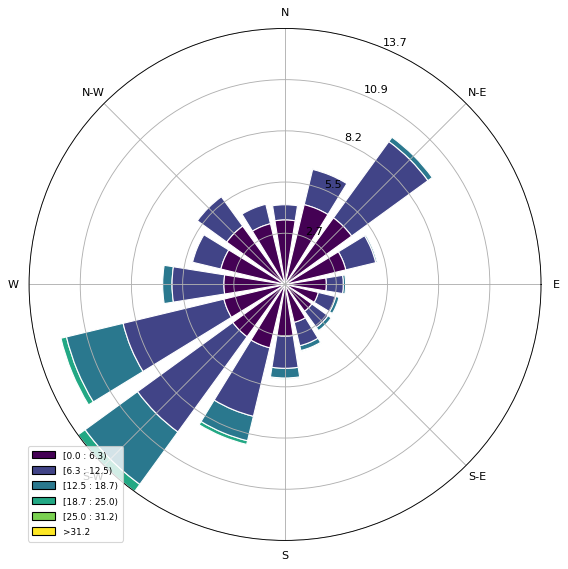

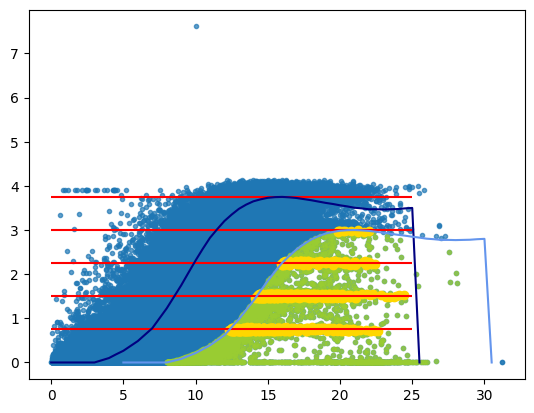

               Production Index  Time
DateTimeIndex                        
2003-01-31             1.084505     0
2003-02-28             0.896787     1
2003-03-31             1.128766     2
2003-04-30             1.221596     3
2003-05-31             1.178648     4
...                         ...   ...
2022-08-31             0.259741   235
2022-09-30             0.242028   236
2022-10-31             0.232669   237
2022-11-30             0.378454   238
2022-12-31             0.462462   239

[240 rows x 2 columns]


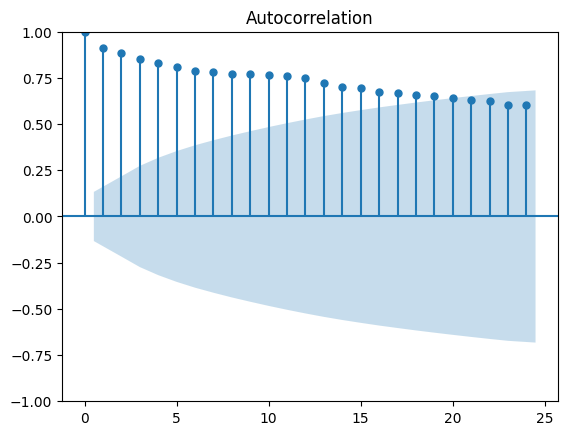

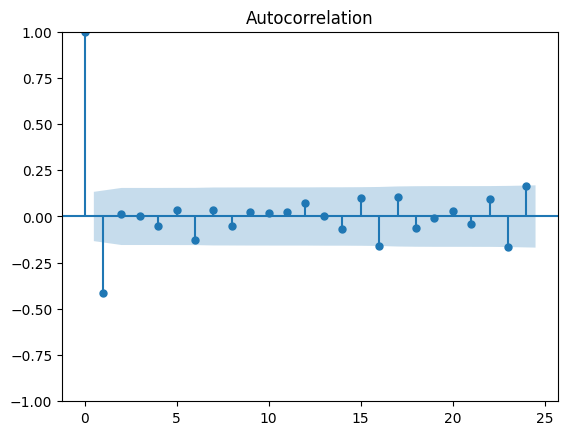

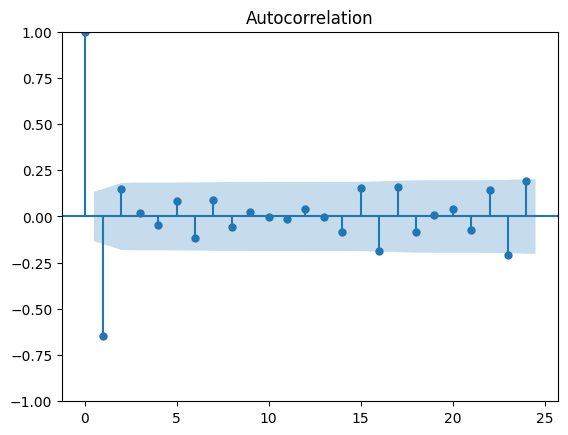

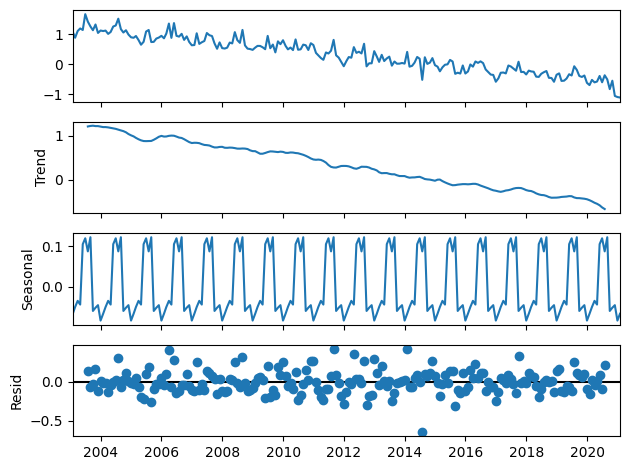

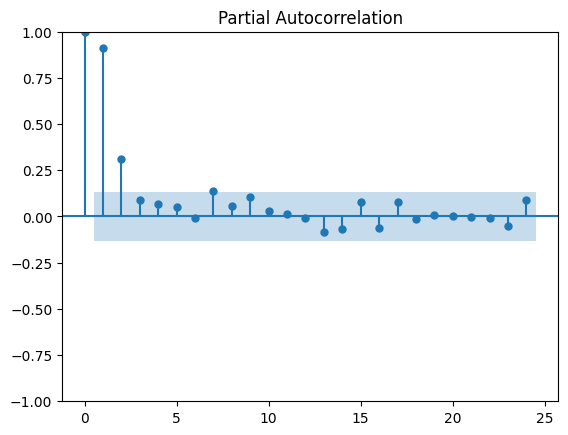

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-106.521, Time=1.91 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=0.682, Time=0.13 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-69.672, Time=1.50 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=4.45 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-1.318, Time=0.17 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-11.604, Time=0.46 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-107.688, Time=3.07 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-68.445, Time=2.94 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=inf, Time=6.93 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=7.31 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=-108.240, Time=6.61 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=8.31 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=-107.556, Time=5.20 sec
 ARIMA(2,0,1)(0,1,2)[12] intercept   : AIC=-104.499, Time=5.72 sec
 ARIMA(1,0,2)(0,1,2)[12] intercept   : AIC=-106

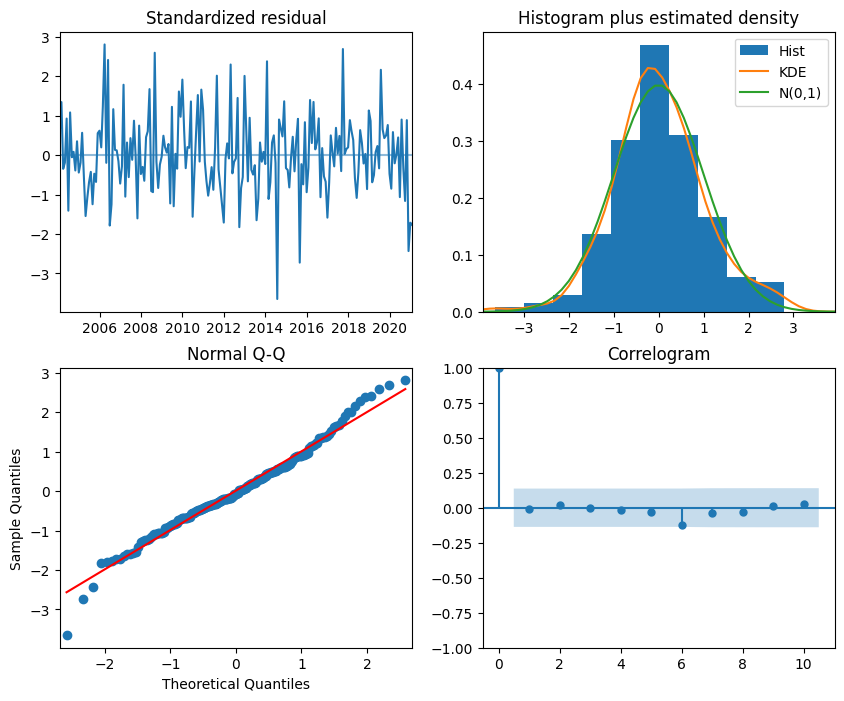

                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  217
Model:             SARIMAX(1, 0, 1)x(0, 1, [1, 2], 12)   Log Likelihood                  61.120
Date:                                 Sat, 11 May 2024   AIC                           -108.240
Time:                                         09:01:52   BIC                            -84.979
Sample:                                     01-31-2003   HQIC                           -98.832
                                          - 01-31-2021                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4515      0.009     51.628      0.000       0.434       0

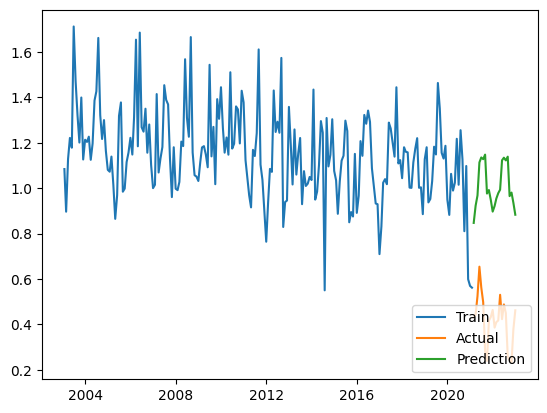

[0.00983828] [[-0.01082865]] [[0.0088479]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=40, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.05163134063702379

 The best parameters across ALL searched params:
 {'min_samples': 40, 'residual_threshold': 0.375}
[0.00969434] [[-0.01068471]] [[0.00870396]]
Mean of Residuals -0.30589342065892655
Mean of Residuals -0.2964841589556294


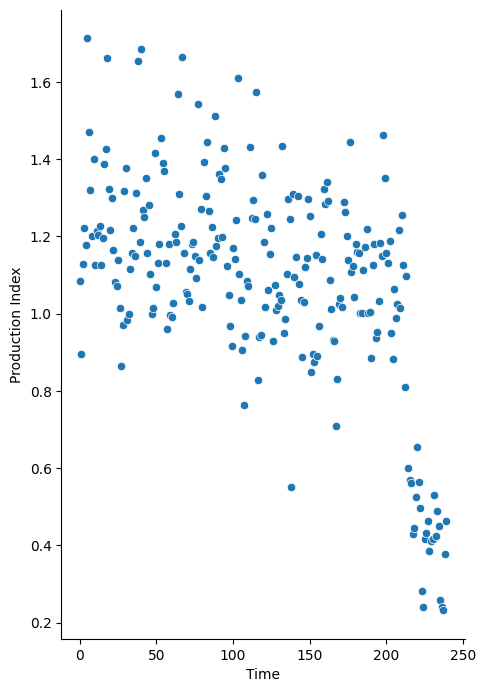

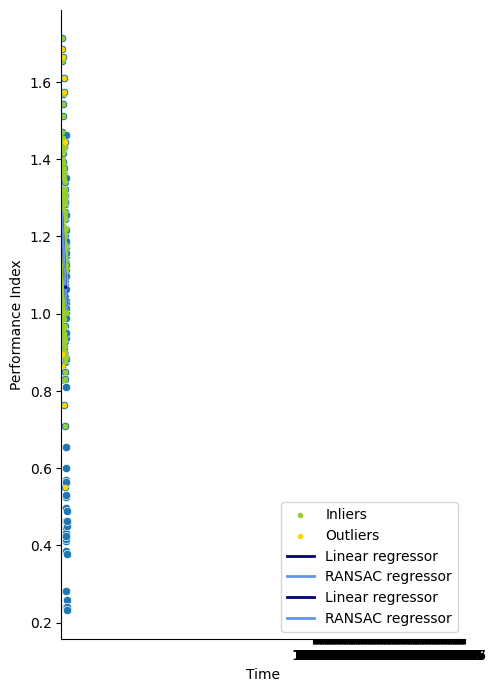

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[5.83828912] [[-5.87319065]] [[5.8033876]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.576475688592586

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.99705793] [[-8.03195946]] [[7.9621564]]
[12.0733708] [[-12.0616373]] [[12.08510431]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1118.277648680713

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.0733708] [[-12.0616373]] [[12.08510431]]
[3.67269121] [[-3.67962479]] [[3.66575763]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0353044297505347

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.05721077] [[-2.06414435]] [[2.05027719]]
[5.26824734] [[-5.33683]] [[5.19966468]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -35.800251438662585

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[7.90024719] [[-7.96882984]] [[7.83166453]]
[3.32330824] [[-3.32310842]] [[3.32350805]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -39.087026076829154

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.32330824] [[-3.32310842]] [[3.32350805]]
[8.88756093] [[-8.82395811]] [[8.95116376]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -30.57411451742731

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[10.101243] [[-10.03764017]] [[10.16484583]]
[4.14724781] [[-4.23582691]] [[4.05866871]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.29837182050271294

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.14724781] [[-4.23582691]] [[4.05866871]]
[1.94382808] [[-1.98030172]] [[1.90735444]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -14.113584839734767

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.94382808] [[-1.98030172]] [[1.90735444]]
[6.7356832] [[-6.72233955]] [[6.74902686]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7523870147749718

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.7356832] [[-6.72233955]] [[6.74902686]]
[5.75978943] [[-5.70080384]] [[5.81877502]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -100.62670916235118

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.82383084] [[-5.76484525]] [[5.88281643]]
[4.64124901] [[-4.70778432]] [[4.57471369]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3207322243875992

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.64124901] [[-4.70778432]] [[4.57471369]]
[4.06591677] [[-4.03191134]] [[4.09992221]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.2915796088779166

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.06591677] [[-4.03191134]] [[4.09992221]]
[18.51699096] [[-18.55921828]] [[18.47476365]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -4.445192827173961

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[18.51699096] [[-18.55921828]] [[18.47476365]]
[7.6905296] [[-7.6594587]] [[7.7216005]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -12.089039429794187

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.625}
[8.36505608] [[-8.33398519]] [[8.39612698]]
[8.38294673] [[-8.3704219]] [[8.39547155]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -28.461322636720684

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[8.38294673] [[-8.3704219]] [[8.39547155]]
[1.27359871] [[-1.31353891]] [[1.23365851]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -42.811431807316865

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.27359871] [[-1.31353891]] [[1.23365851]]
[16.99192742] [[-16.85742345]] [[17.12643139]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[16.99192742] [[-16.85742345]] [[17.12643139]]
[1.2480332] [[-1.23890288]] [[1.25716352]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.1821667313356867

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[5.10173584] [[-5.09260552]] [[5.11086616]]
[2.52941447] [[-2.55450561]] [[2.50432333]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.44192672803938715

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.56069079] [[-2.58578193]] [[2.53559965]]
[6.82519936] [[-6.79909177]] [[6.85130696]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -42.793893995171985

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.82519936] [[-6.79909177]] [[6.85130696]]
[4.24915103] [[-4.25499306]] [[4.243309]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9925024787289396

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.43264392] [[-1.43848595]] [[1.42680189]]
[5.95906468] [[-5.90054467]] [[6.01758469]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -4.86295330794482

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[5.95906468] [[-5.90054467]] [[6.01758469]]
[13.19177921] [[-13.1252732]] [[13.25828521]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9931981797432567

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[14.62983663] [[-14.56333063]] [[14.69634263]]
[1.89784782] [[-1.9206036]] [[1.87509204]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3985894569109531

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.89784782] [[-1.9206036]] [[1.87509204]]
[4.70799778] [[-4.70424835]] [[4.7117472]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7065365477585649

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[6.57582506] [[-6.57207563]] [[6.57957448]]
[6.72934787] [[-6.70154622]] [[6.75714952]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.4543396044904378

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[6.72934787] [[-6.70154622]] [[6.75714952]]
[5.38502469] [[-5.38643399]] [[5.38361539]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -32.27994897333548

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.98568498] [[-2.98709428]] [[2.98427568]]
[7.62196375] [[-7.64520908]] [[7.59871843]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.4728291550943213

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.43761013] [[-7.46085545]] [[7.41436481]]
[10.64089059] [[-10.73417943]] [[10.54760175]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.7557993941453085

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.82806355] [[-4.92135239]] [[4.73477471]]
[10.49933204] [[-10.44366903]] [[10.55499505]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7418743512627312

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[10.49933204] [[-10.44366903]] [[10.55499505]]
[6.30222963] [[-6.27088237]] [[6.33357689]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -2.178995459752512

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.30222963] [[-6.27088237]] [[6.33357689]]
[5.78242355] [[-5.71356621]] [[5.85128089]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -151.2127810772053

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[10.02018086] [[-9.95132351]] [[10.0890382]]
[4.70970358] [[-4.69920854]] [[4.72019861]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.34026731733559

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.75014757] [[-1.73965254]] [[1.76064261]]
[1.05937672] [[-0.99563516]] [[1.12311828]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=2.0)

 The best score across ALL searched params:
 -232.05948326364955

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 2.0}
[1.05937672] [[-0.99563516]] [[1.12311828]]
[10.21209952] [[-10.15262191]] [[10.27157714]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.568188646177947

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[10.21209952] [[-10.15262191]] [[10.27157714]]
[1.05032465] [[-1.06318282]] [[1.03746648]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5598555047930216

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.05032465] [[-1.06318282]] [[1.03746648]]
[4.91835972] [[-4.8685194]] [[4.96820005]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -112.99458652392255

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.625}
[3.94233153] [[-3.89249121]] [[3.99217185]]
[4.46872267] [[-4.48987259]] [[4.44757275]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.412863158884516

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[4.46872267] [[-4.48987259]] [[4.44757275]]
[8.91596639] [[-8.89580933]] [[8.93612344]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -153.7457577374268

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.75}
[5.76235705] [[-5.74219999]] [[5.7825141]]
[12.21709106] [[-12.18103227]] [[12.25314986]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.350353172392555

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[11.00252383] [[-10.96646504]] [[11.03858263]]
[17.9320165] [[-18.01382526]] [[17.85020775]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.148940211132716

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[15.24266794] [[-15.32447669]] [[15.16085918]]
[3.3091574] [[-3.28499748]] [[3.33331733]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.572218812613002

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.64029551] [[-4.61613558]] [[4.66445544]]
[3.71711855] [[-3.68972178]] [[3.74451531]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.64224519577381

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.71711855] [[-3.68972178]] [[3.74451531]]
[3.88997167] [[-3.87175974]] [[3.90818359]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -38.88699850713723

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.88997167] [[-3.87175974]] [[3.90818359]]
[14.83574271] [[-14.88888519]] [[14.78260023]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -63.54640057732117

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.2647476] [[-15.31789008]] [[15.21160511]]
[4.02592033] [[-4.00765218]] [[4.04418847]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.3324364767387509

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.02592033] [[-4.00765218]] [[4.04418847]]
[9.50915317] [[-9.4049907]] [[9.61331564]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -66.13325220232305

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[9.50915317] [[-9.4049907]] [[9.61331564]]
[11.11840272] [[-11.04317573]] [[11.19362971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -140.58454873440704

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.85689143] [[-5.78166444]] [[5.93211842]]
[2.11707774] [[-2.12757547]] [[2.10658002]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3402.816972209348

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11707774] [[-2.12757547]] [[2.10658002]]
[7.90354627] [[-7.91286521]] [[7.89422733]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -7.5635907650716065

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.90354627] [[-7.91286521]] [[7.89422733]]
[8.90239171] [[-8.97612602]] [[8.8286574]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1400.3707937663262

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.90239171] [[-8.97612602]] [[8.8286574]]
[7.53713497] [[-7.49507428]] [[7.57919566]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -19.33831026857738

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.53713497] [[-7.49507428]] [[7.57919566]]
[6.33543427] [[-6.30075023]] [[6.37011832]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.008827787698022

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.33543427] [[-6.30075023]] [[6.37011832]]
[2.64464778] [[-2.66088225]] [[2.62841331]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2.3616090513847143

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.64464778] [[-2.66088225]] [[2.62841331]]
[2.82039592] [[-2.84373512]] [[2.79705671]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -121.53987824794005

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.74196748] [[-1.76530669]] [[1.71862828]]
[1.44396568] [[-1.53458483]] [[1.35334654]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -145.86386346911917

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[1.44396568] [[-1.53458483]] [[1.35334654]]
[3.33242189] [[-3.29089875]] [[3.37394504]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.398429909380852

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.98883374] [[-1.94731059]] [[2.03035688]]
[6.13890001] [[-6.09232245]] [[6.18547757]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.7362921830412905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[8.58005601] [[-8.53347845]] [[8.62663357]]
[6.30979337] [[-6.32765488]] [[6.29193187]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -390.8966390278916

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[10.08040112] [[-10.09826262]] [[10.06253961]]
[1.4450247] [[-1.45513341]] [[1.43491599]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.908922638904734

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.4450247] [[-1.45513341]] [[1.43491599]]
[6.46976387] [[-6.41942451]] [[6.52010323]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.52218406] [[-7.4718447]] [[7.57252341]]
[1.92344044] [[-1.92112543]] [[1.92575544]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.648948745069013

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.92344044] [[-1.92112543]] [[1.92575544]]
[1.21509502] [[-1.23552585]] [[1.1946642]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -87.14312087834759

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.21509502] [[-1.23552585]] [[1.1946642]]
[5.33110033] [[-5.33095153]] [[5.33124913]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.452421707572828

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.33110033] [[-5.33095153]] [[5.33124913]]
[2.03072275] [[-2.05473333]] [[2.00671217]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -355.60999256287306

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[2.17840051] [[-2.20241109]] [[2.15438992]]
[2.30449915] [[-2.30733653]] [[2.30166176]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -34.556830274287286

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[2.30449915] [[-2.30733653]] [[2.30166176]]
[7.25647407] [[-7.29322687]] [[7.21972127]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0050714899179938

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[7.45287888] [[-7.48963168]] [[7.41612607]]
[3.22419137] [[-3.25993]] [[3.18845273]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -660.44062238629

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.11689462] [[-2.15263325]] [[2.08115598]]
[2.35639324] [[-2.33701736]] [[2.37576913]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -312.2421506545271

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.35639324] [[-2.33701736]] [[2.37576913]]
[5.86587974] [[-5.84143962]] [[5.89031986]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -57.9297665065141

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.86587974] [[-5.84143962]] [[5.89031986]]
[2.02467486] [[-2.06765361]] [[1.98169611]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -8.54752317966712

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[2.02467486] [[-2.06765361]] [[1.98169611]]
[4.5222649] [[-4.60489472]] [[4.43963507]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2645.0270282509455

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.5222649] [[-4.60489472]] [[4.43963507]]
[1.73390648] [[-1.77892848]] [[1.68888448]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1625.721149502749

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.76250299] [[-2.80752499]] [[2.71748099]]
[3.13588093] [[-3.11893131]] [[3.15283056]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -800.1243494848763

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.60360745] [[-2.58665782]] [[2.62055708]]
[0.80141283] [[-0.84003312]] [[0.76279254]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -103738.50414497734

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.80141283] [[-0.84003312]] [[0.76279254]]
[1.15725454] [[-1.1431148]] [[1.17139428]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -43.85259442574065

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.15725454] [[-1.1431148]] [[1.17139428]]
[0.77953591] [[-0.77356386]] [[0.78550796]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.9393205131159834

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.77953591] [[-0.77356386]] [[0.78550796]]
[0.522565] [[-0.52938639]] [[0.51574362]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.619488922653934

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.522565] [[-0.52938639]] [[0.51574362]]
[1.8633137] [[-1.88239053]] [[1.84423686]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.9184073577269585

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.8633137] [[-1.88239053]] [[1.84423686]]
[5.42367736] [[-5.35711406]] [[5.49024065]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.4450429068100537

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.42367736] [[-5.35711406]] [[5.49024065]]
               Production Index  Time
DateTimeIndex                        
2003-01-31             1.163876     0
2003-02-28             0.921869     1
2003-03-31             1.147375     2
2003-04-30             1.235469     3
2003-05-31             1.187404     4
...                         ...   ...
2022-08-31             0.271595   235
2022-09-30             0.242028   236
2022-10-31             0.232993   237
2022-11-30             0.387263   238
2022-12-31             0.473091   239

[240 rows x 2 columns]


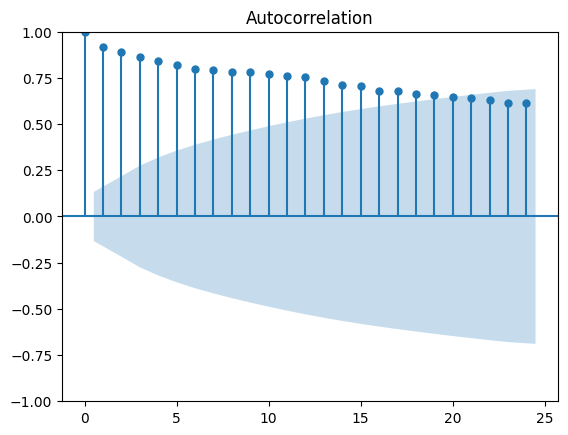

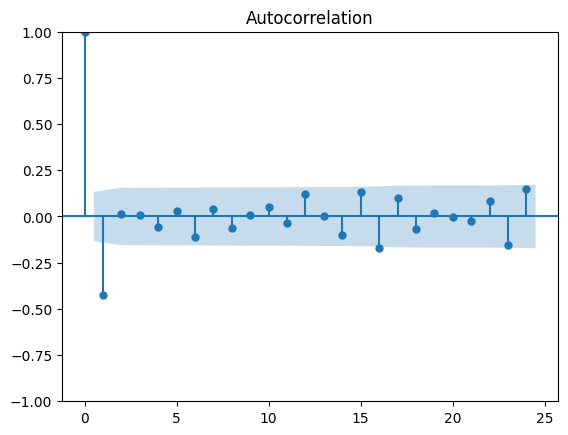

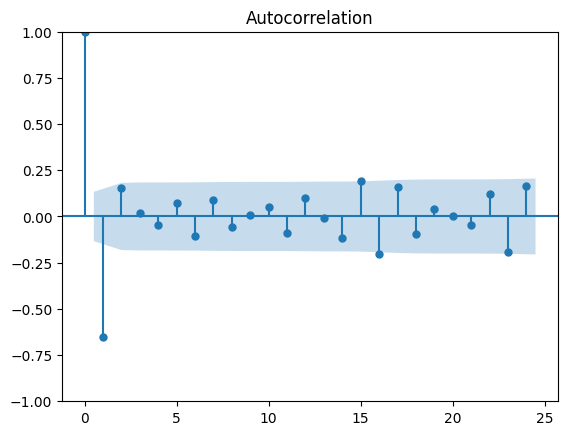

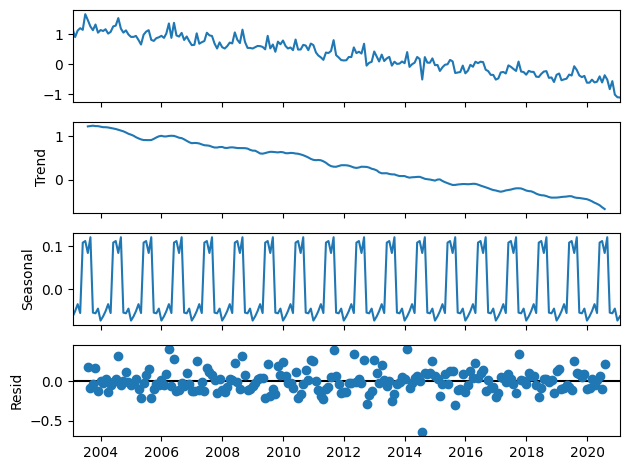

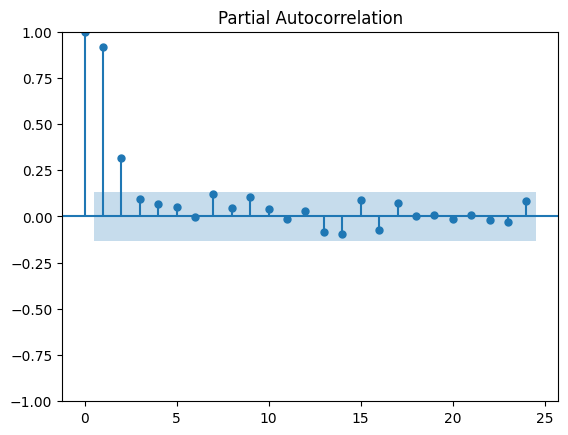

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=4.44 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-24.353, Time=0.18 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-86.735, Time=1.78 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.22 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-26.353, Time=0.20 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-34.252, Time=0.21 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-95.840, Time=2.62 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=7.02 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=2.91 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-84.527, Time=3.39 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=-96.255, Time=4.87 sec
 ARIMA(2,0,0)(1,1,0)[12] intercept   : AIC=-86.498, Time=1.74 sec
 ARIMA(2,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=6.67 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=-119.481, Time=3.49 sec
 ARIMA(2,0,0)(0,1,1)[12] intercept   : AIC=inf, Time

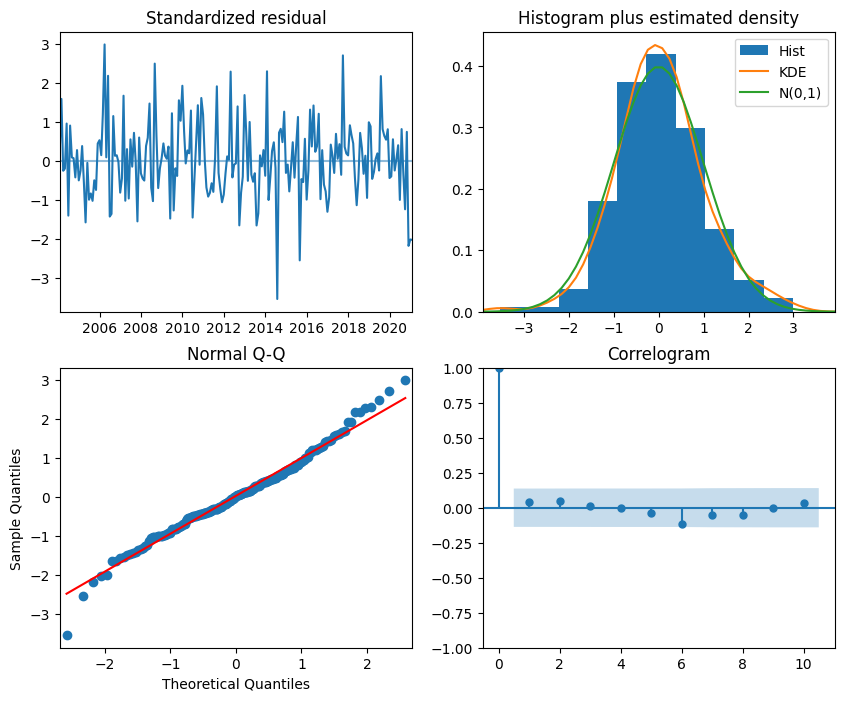

                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  217
Model:             SARIMAX(1, 0, 1)x(0, 1, [1, 2], 12)   Log Likelihood                  67.913
Date:                                 Sat, 11 May 2024   AIC                           -121.826
Time:                                         09:04:47   BIC                            -98.565
Sample:                                     01-31-2003   HQIC                          -112.417
                                          - 01-31-2021                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5005      0.013     37.985      0.000       0.475       0

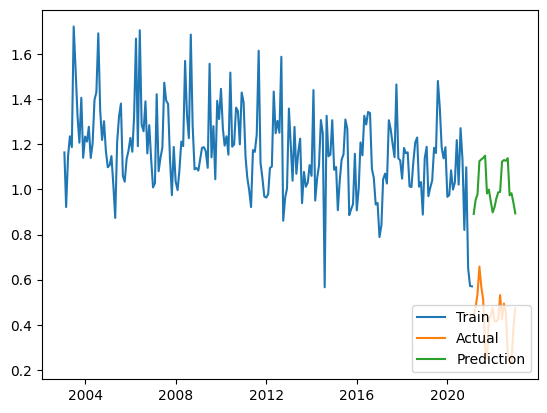

[0.00987521] [[-0.01090266]] [[0.00884777]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=40, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.050495192463361295

 The best parameters across ALL searched params:
 {'min_samples': 40, 'residual_threshold': 0.375}
[0.009637] [[-0.01066445]] [[0.00860955]]
Mean of Residuals -0.3067229911346962
Mean of Residuals -0.29132103693646166


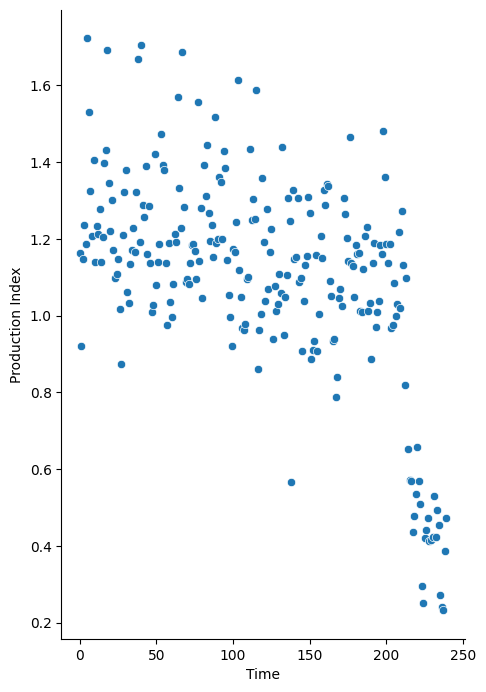

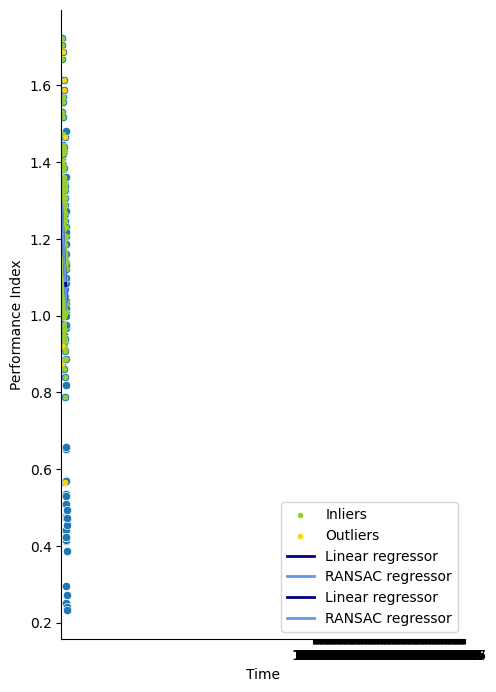

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[4.42472841] [[-4.45135342]] [[4.3981034]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -54.20177473724469

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.42472841] [[-4.45135342]] [[4.3981034]]
[12.32158537] [[-12.31170251]] [[12.33146823]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -247.9949669017405

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[12.32158537] [[-12.31170251]] [[12.33146823]]
[3.34656817] [[-3.36047296]] [[3.33266338]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.148439081761351

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.95693782] [[-1.97084261]] [[1.94303303]]
[5.18056476] [[-5.24667402]] [[5.11445549]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.729953582582134

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.06205541] [[-6.12816468]] [[5.99594615]]
[3.44307545] [[-3.44088136]] [[3.44526955]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -14.912392658565324

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.44307545] [[-3.44088136]] [[3.44526955]]
[8.84984843] [[-8.78772767]] [[8.91196919]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -28.545067182594096

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[8.84984843] [[-8.78772767]] [[8.91196919]]
[3.62278434] [[-3.71064657]] [[3.53492212]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5368073941448925

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.7667058] [[-4.85456802]] [[4.67884358]]
[1.92586807] [[-1.96170391]] [[1.89003224]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.619459432133995

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.92586807] [[-1.96170391]] [[1.89003224]]
[6.50150389] [[-6.4928018]] [[6.51020597]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5147870710400748

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.50150389] [[-6.4928018]] [[6.51020597]]
[5.8580557] [[-5.79576989]] [[5.92034151]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -61.843278574462865

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.8580557] [[-5.79576989]] [[5.92034151]]
[3.4535645] [[-3.51004991]] [[3.39707908]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.13204535113185467

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.4535645] [[-3.51004991]] [[3.39707908]]
[4.03873647] [[-4.00567027]] [[4.07180268]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.2217473469812123

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.03873647] [[-4.00567027]] [[4.07180268]]
[18.56756248] [[-18.60850951]] [[18.52661545]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -3.111625409774571

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[18.56756248] [[-18.60850951]] [[18.52661545]]
[8.09311852] [[-8.05870594]] [[8.1275311]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -11.495284665251976

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[8.78513283] [[-8.75072024]] [[8.81954541]]
[9.09508189] [[-9.07836613]] [[9.11179766]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -36.213736053313525

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[8.53757442] [[-8.52085866]] [[8.55429019]]
[0.94245525] [[-0.9798946]] [[0.9050159]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.1595814903025445

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.94245525] [[-0.9798946]] [[0.9050159]]
[16.79643691] [[-16.66358081]] [[16.92929301]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[16.79643691] [[-16.66358081]] [[16.92929301]]
[1.41492927] [[-1.40706367]] [[1.42279487]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.315055393249513

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[5.40303809] [[-5.39517249]] [[5.41090369]]
[2.58021219] [[-2.60479825]] [[2.55562614]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.310034088351933

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.62699524] [[-2.6515813]] [[2.60240919]]
[6.27741007] [[-6.25320963]] [[6.30161051]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -48.82401450666295

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.27741007] [[-6.25320963]] [[6.30161051]]
[3.57780431] [[-3.57915014]] [[3.57645848]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.480700044940727

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84133431] [[-0.84268014]] [[0.83998849]]
[5.84838483] [[-5.78915327]] [[5.9076164]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -6.937081329065502

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[10.78707373] [[-10.72784217]] [[10.84630529]]
[11.95561044] [[-11.88875846]] [[12.02246242]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.049576173495841

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.34212884] [[-13.27527686]] [[13.40898082]]
[2.88918136] [[-2.90958639]] [[2.86877634]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.861349234060771

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.88918136] [[-2.90958639]] [[2.86877634]]
[4.76676598] [[-4.76581927]] [[4.76771268]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7145021138193259

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[4.76676598] [[-4.76581927]] [[4.76771268]]
[7.06131737] [[-7.03523856]] [[7.08739619]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.069632453405319

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[6.61163115] [[-6.58555233]] [[6.63770996]]
[5.3727806] [[-5.37274171]] [[5.37281948]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -30.28925896699489

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.59348185] [[-2.59344297]] [[2.59352074]]
[7.56482587] [[-7.58752412]] [[7.54212762]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.6301126732144833

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.38106721] [[-7.40376546]] [[7.35836896]]
[10.55851685] [[-10.65061493]] [[10.46641876]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.8246472788405217

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[4.57152712] [[-4.66362521]] [[4.47942904]]
[11.57790436] [[-11.52373562]] [[11.6320731]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -0.7004498776194658

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[11.57790436] [[-11.52373562]] [[11.6320731]]
[6.22479652] [[-6.19524636]] [[6.25434668]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -2.2011504862767484

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[6.22479652] [[-6.19524636]] [[6.25434668]]
[6.89216672] [[-6.82338179]] [[6.96095166]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -151.79091477165173

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[11.64130772] [[-11.57252279]] [[11.71009266]]
[4.21665728] [[-4.20811912]] [[4.22519544]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.136825154763113

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.44920815] [[-1.44066999]] [[1.45774631]]
[1.12370134] [[-1.0590029]] [[1.18839977]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.5)

 The best score across ALL searched params:
 -917.0758861842321

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.5}
[6.25480861] [[-6.19011018]] [[6.31950705]]
[10.24017031] [[-10.18046063]] [[10.29987999]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.5464111892530865

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[10.24017031] [[-10.18046063]] [[10.29987999]]
[1.5930472] [[-1.60212594]] [[1.58396847]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5016741305089699

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.5930472] [[-1.60212594]] [[1.58396847]]
[1.86400925] [[-1.85948702]] [[1.86853148]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.448609786180693

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.40334418] [[-1.39882195]] [[1.40786641]]
[4.54466645] [[-4.56678194]] [[4.52255095]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.079194527495744

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[4.54466645] [[-4.56678194]] [[4.52255095]]
[9.68527606] [[-9.66231841]] [[9.7082337]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -700.535643180954

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.98313636] [[-5.96017871]] [[6.006094]]
[11.77086169] [[-11.73097747]] [[11.81074591]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.903383662827153

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[10.90206114] [[-10.86217692]] [[10.94194536]]
[17.65448764] [[-17.73437296]] [[17.57460233]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.796676438985152

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[14.96980104] [[-15.04968636]] [[14.88991573]]
[3.71174888] [[-3.68709218]] [[3.73640559]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -14.115226330143651

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.10265878] [[-5.07800207]] [[5.12731548]]
[3.6690864] [[-3.64253752]] [[3.69563528]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -23.822689766028695

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.6690864] [[-3.64253752]] [[3.69563528]]
[4.4281312] [[-4.40544485]] [[4.45081756]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -32.139541736097

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.4281312] [[-4.40544485]] [[4.45081756]]
[14.62889637] [[-14.67954027]] [[14.57825248]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -61.478691187156684

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[15.06933079] [[-15.11997469]] [[15.0186869]]
[3.98847988] [[-3.97092486]] [[4.0060349]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.389105199418522

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.98847988] [[-3.97092486]] [[4.0060349]]
[9.01089575] [[-8.90859427]] [[9.11319722]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -44.80937342003393

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[9.01089575] [[-8.90859427]] [[9.11319722]]
[11.29760591] [[-11.22120554]] [[11.37400628]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -50.7866243354331

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.60637009] [[-5.52996972]] [[5.68277046]]
[2.51527791] [[-2.53294937]] [[2.49760645]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -866.280245722383

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.51527791] [[-2.53294937]] [[2.49760645]]
[7.79413773] [[-7.80370245]] [[7.78457302]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -16.77686014551717

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.79413773] [[-7.80370245]] [[7.78457302]]
[8.91778361] [[-8.9931548]] [[8.84241242]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20.350741334437306

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.91778361] [[-8.9931548]] [[8.84241242]]
[7.0985235] [[-7.06067353]] [[7.13637347]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -23.686666147955474

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[7.0985235] [[-7.06067353]] [[7.13637347]]
[6.25138504] [[-6.21729681]] [[6.28547328]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.715081763971871

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.25138504] [[-6.21729681]] [[6.28547328]]
[2.60577379] [[-2.62169795]] [[2.58984963]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2.5272362652295164

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.60577379] [[-2.62169795]] [[2.58984963]]
[2.07181308] [[-2.1004411]] [[2.04318507]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -205.90522934247844

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[3.06009348] [[-3.0887215]] [[3.03146546]]
[1.66628679] [[-1.74999255]] [[1.58258104]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -134.19781413829278

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[1.66628679] [[-1.74999255]] [[1.58258104]]
[2.76796482] [[-2.73114395]] [[2.8047857]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.7215515870833777

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.92546141] [[-1.88864054]] [[1.96228229]]
[6.39287759] [[-6.34497129]] [[6.44078389]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.575086250471316

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.05081741] [[-11.0029111]] [[11.09872371]]
[6.45787962] [[-6.47622267]] [[6.43953657]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -134.284673073215

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[10.54716875] [[-10.56551179]] [[10.5288257]]
[1.42335938] [[-1.43456306]] [[1.4121557]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3631323935520692

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.42335938] [[-1.43456306]] [[1.4121557]]
[6.3399525] [[-6.2902979]] [[6.38960711]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.38613139] [[-7.33647678]] [[7.43578599]]
[1.8548327] [[-1.85128074]] [[1.85838466]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.844077833985693

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.8548327] [[-1.85128074]] [[1.85838466]]
[1.41478614] [[-1.44148035]] [[1.38809192]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -167.60711909467835

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.41478614] [[-1.44148035]] [[1.38809192]]
[5.29919638] [[-5.30164545]] [[5.29674732]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.562640575877762

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.29919638] [[-5.30164545]] [[5.29674732]]
[1.71289018] [[-1.73662757]] [[1.68915279]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.174178401148417

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.75487766] [[-1.77861505]] [[1.73114027]]
[2.20259248] [[-2.20489992]] [[2.20028505]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -38.34973199177655

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[2.20259248] [[-2.20489992]] [[2.20028505]]
[7.10251831] [[-7.14035848]] [[7.06467813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -3.673550306715982

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.10251831] [[-7.14035848]] [[7.06467813]]
[3.34076815] [[-3.37625618]] [[3.30528011]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -13987.051085778678

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[3.34076815] [[-3.37625618]] [[3.30528011]]
[1.81925474] [[-1.81202464]] [[1.82648485]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -34.01096376304499

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.81925474] [[-1.81202464]] [[1.82648485]]
[5.42491914] [[-5.40182522]] [[5.44801306]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -49.33824844862713

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.42491914] [[-5.40182522]] [[5.44801306]]
[1.93427396] [[-1.97887103]] [[1.88967689]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -14.499878949340793

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[1.93427396] [[-1.97887103]] [[1.88967689]]
[3.98078338] [[-4.05947596]] [[3.90209081]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1580.383900338106

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.98078338] [[-4.05947596]] [[3.90209081]]
[2.05278227] [[-2.09902467]] [[2.00653987]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1911.8258339385052

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.06022161] [[-3.10646401]] [[3.01397921]]
[3.03694783] [[-3.02097702]] [[3.05291863]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -180.23986551894342

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.51124977] [[-2.49527896]] [[2.52722057]]
[0.89672286] [[-0.93583837]] [[0.85760735]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -162874.10977087513

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.89672286] [[-0.93583837]] [[0.85760735]]
[1.1481541] [[-1.13438896]] [[1.16191924]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1022.8938411460027

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.1481541] [[-1.13438896]] [[1.16191924]]
[0.65567847] [[-0.65164616]] [[0.65971079]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6174412098776352

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.65567847] [[-0.65164616]] [[0.65971079]]
[0.51505666] [[-0.52163215]] [[0.50848116]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.610485115483994

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.51505666] [[-0.52163215]] [[0.50848116]]
[1.84455826] [[-1.86377126]] [[1.82534526]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.516524647841999

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.84455826] [[-1.86377126]] [[1.82534526]]
[5.39907687] [[-5.33212881]] [[5.46602493]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.3793125151729704

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.39907687] [[-5.33212881]] [[5.46602493]]
               Production Index  Time
DateTimeIndex                        
2004-01-31             1.204146     0
2004-02-29             1.227201     1
2004-03-31             1.125275     2
2004-04-30             1.196792     3
2004-05-31             1.386451     4
2004-06-30             1.427085     5
2004-07-31             1.662057     6
2004-08-31             1.322600     7
2004-09-30             1.216992     8
2004-10-31             1.300226     9
2004-11-30             1.164617    10
2004-12-31             1.081116    11
2005-01-31             1.072839    12
2005-02-28             1.

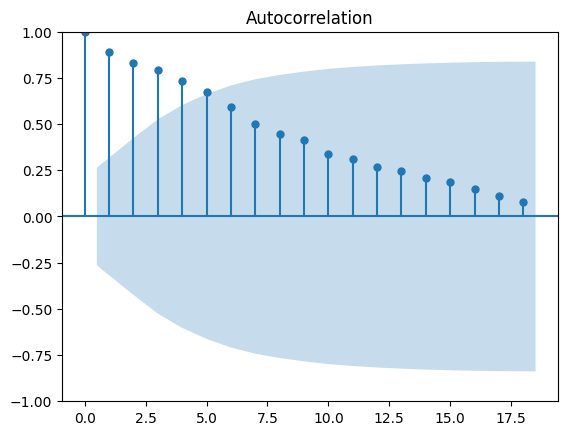

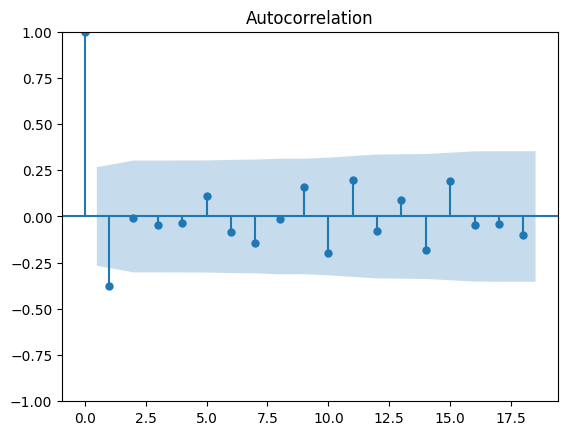

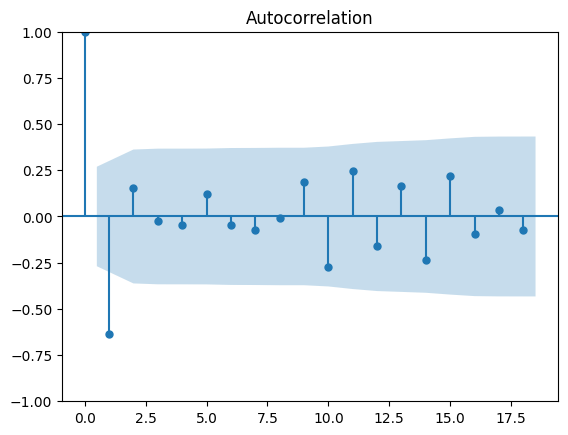

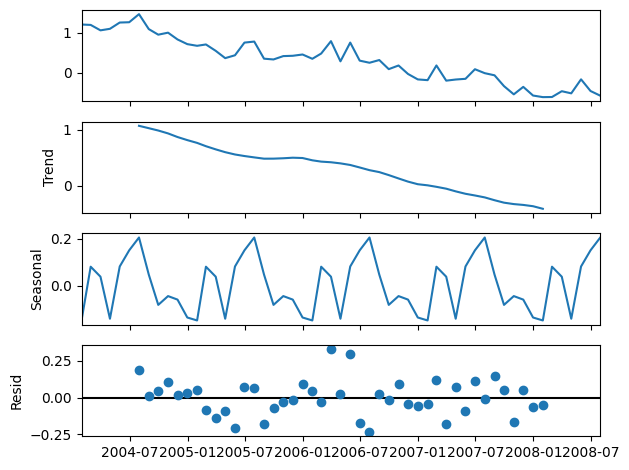

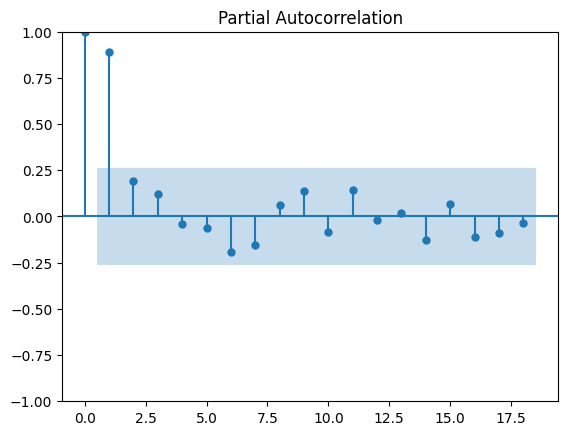

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.20 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=14.584, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-9.136, Time=0.48 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.63 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=12.584, Time=0.07 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=12.576, Time=0.09 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-9.882, Time=2.38 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-7.906, Time=2.33 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-9.841, Time=1.29 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-8.722, Time=1.20 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=-8.651, Time=2.05 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-8.511, Time=1.96 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-9.220, Time=2.06 sec
 ARIMA(2,0,1)(2,1,0)[12] intercept   : AIC=-6.497, Time=2.01 sec
 ARIMA(1,0,0)(2,1,0)[12]             : AIC=-11.882, T

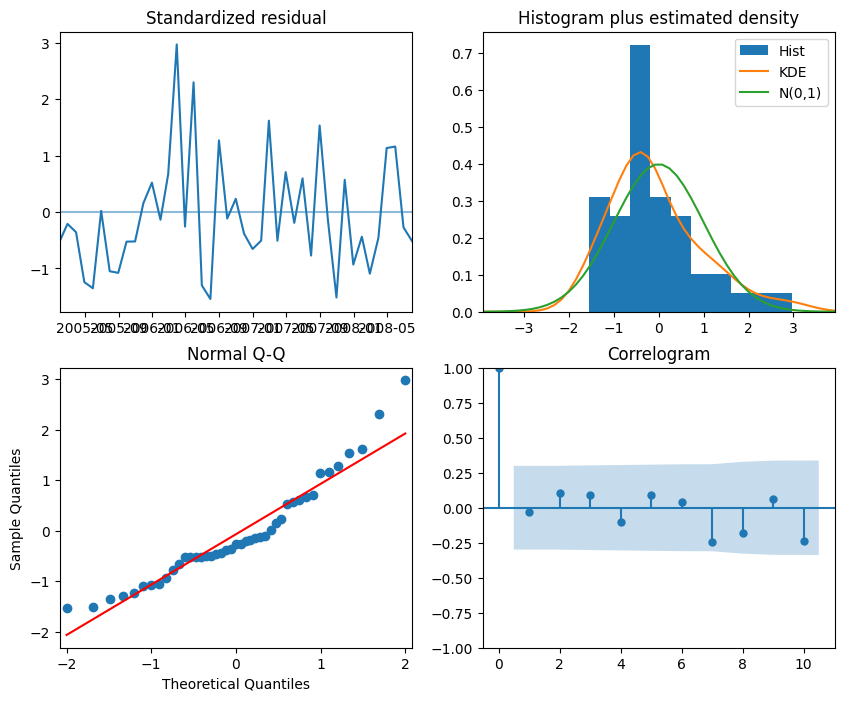

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(2, 1, 0, 12)   Log Likelihood                  10.941
Date:                            Sat, 11 May 2024   AIC                            -11.882
Time:                                    09:05:55   BIC                             -3.076
Sample:                                01-31-2004   HQIC                            -8.635
                                     - 07-31-2008                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0002      0.002     -0.128      0.899      -0.004       0.003
ar.L1          0.2672      0.181   

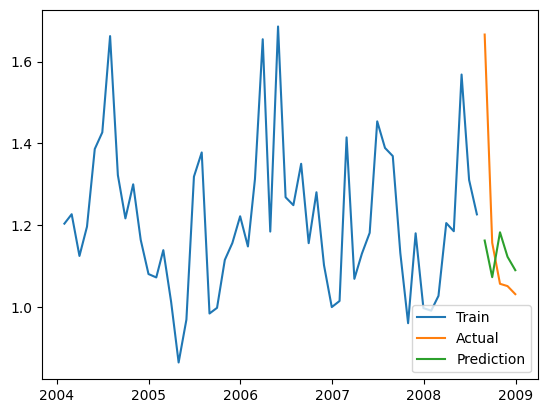

[0.04234927] [[-0.04331894]] [[0.04137961]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.6117163673165091

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.5}
[0.04234927] [[-0.04331894]] [[0.04137961]]
Mean of Residuals 0.02245832914667828
Mean of Residuals 0.02245832914667828


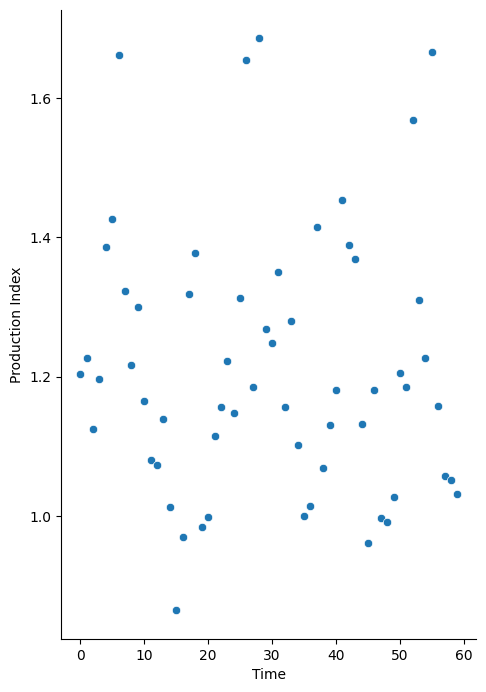

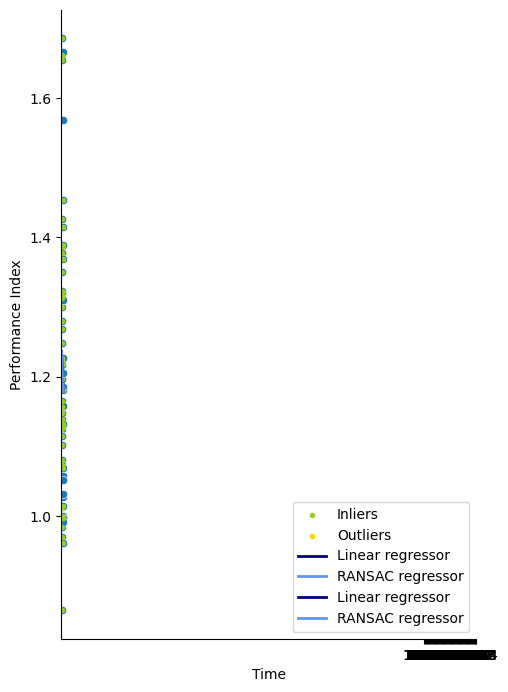

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                        Sandøy
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2015-12-06 10:00:00  19.984436
2015-12-25 10:00:00  20.785894
2019-03-28 18:00:00  21.982992
2020-02-21 17:00:00  21.264229
2020-09-21 06:00:00  19.877434

[186508 rows x 1 columns]
##################Skomakerfjellet###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2017-01-11 10:00:00   8.520872  277.382111  94944.507812         0.917476
2017-01-11 11:00:00   7.852581  277.402008  94837.960938         0.918160
2017-01-11 12:00:00   7.679711  277.321106  94779.140625         0.918740
2017-01-11 13:00:00   7.929130  277.207214  94757.507812         0.919347
2017-01-11 14:00:00   7.740021

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    299746.517373
dtype: float64
                 Observasjoner tot prod  Observasjoner valid prod  \
Skomakerfjellet                  192840                     61094   

                 Missing values prod  Negative values prod  Zero values prod  \
Skomakerfjellet                    0                     0              7016   

                 Prod over capacity  Observasjoner df_windpowerlib  \
Skomakerfjellet                   0                          61094   

                 Missing values wind_peed  Missing values temperature  \
Skomakerfjellet                       NaN                         NaN   

                 Missing values pressure  Missing values roughness_length  \
Skomakerfjellet                      NaN                              NaN   

                 Observasjoner sim  Zero values sim  
Skomakerfjellet              61094             5107  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Skomakerfjellet
2002-12-31              NaN
2003-12-31              NaN
2004-12-31              NaN
2005-12-31              NaN
2006-12-31              NaN
2007-12-31              NaN
2008-12-31              NaN
2009-12-31              NaN
2010-12-31              NaN
2011-12-31              NaN
2012-12-31              NaN
2013-12-31              NaN
2014-12-31              NaN
2015-12-31              NaN
2016-12-31              NaN
2017-12-31         1.656874
2018-12-31         1.255708
2019-12-31         0.353881
2020-12-31         0.535064
2021-12-31         0.639269
2022-12-31         1.438356
2023-12-31         1.917808 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    294191.849764
dtype: float64


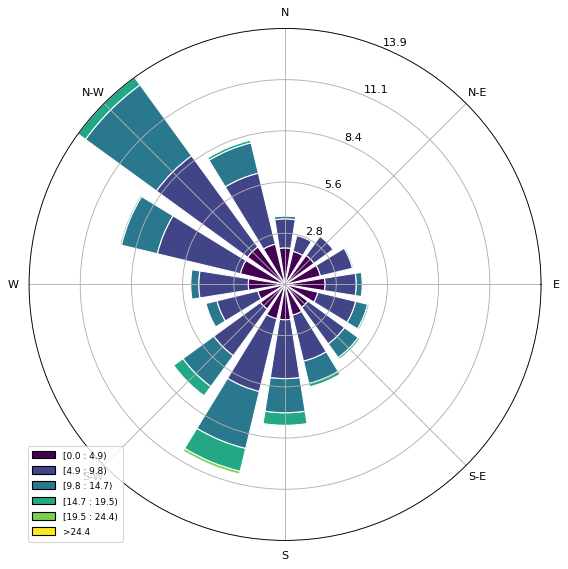

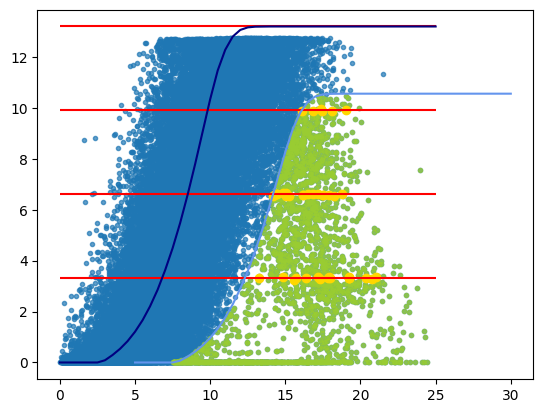

               Production Index  Time
DateTimeIndex                        
2017-01-31             0.716192     0
2017-02-28             0.909122     1
2017-03-31             0.865438     2
2017-04-30             0.799132     3
2017-05-31             0.875753     4
...                         ...   ...
2023-08-31             0.833057    79
2023-09-30             0.592518    80
2023-10-31             0.824902    81
2023-11-30             1.059534    82
2023-12-31             0.772689    83

[84 rows x 2 columns]


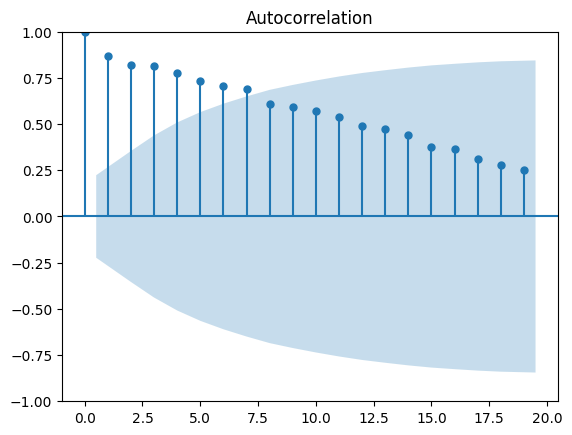

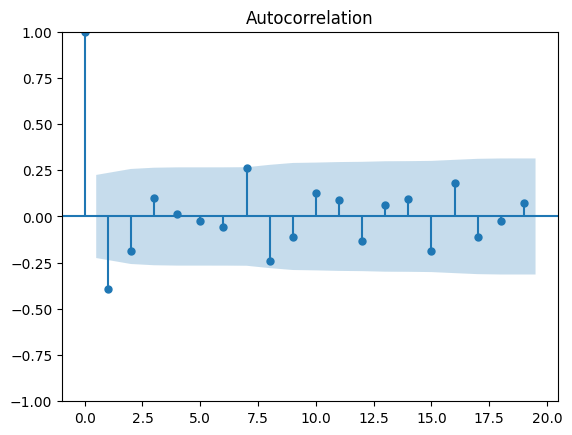

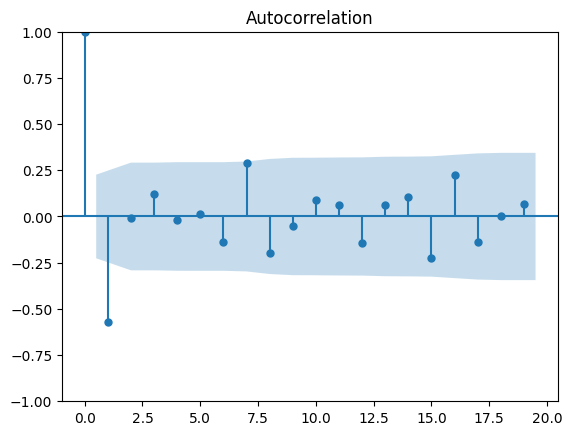

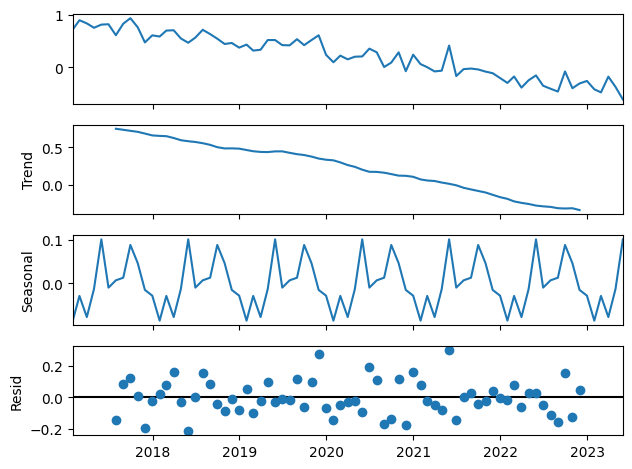

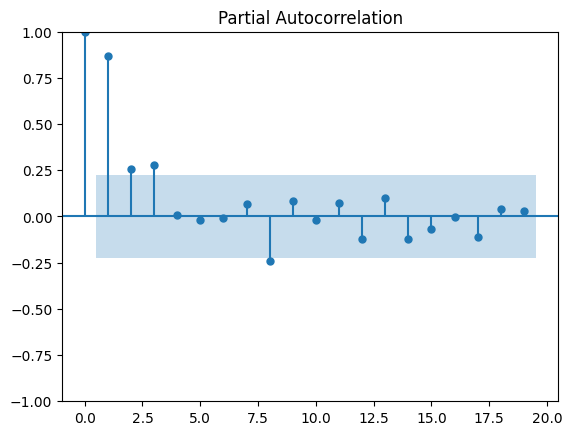

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.20 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-32.754, Time=0.07 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-40.945, Time=0.83 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.01 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-34.754, Time=0.11 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-30.927, Time=0.09 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-43.122, Time=1.41 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-40.624, Time=2.72 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.54 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-45.122, Time=1.62 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-42.875, Time=0.43 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-42.224, Time=1.18 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.16 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-43.122, Time=1.95 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-43.31

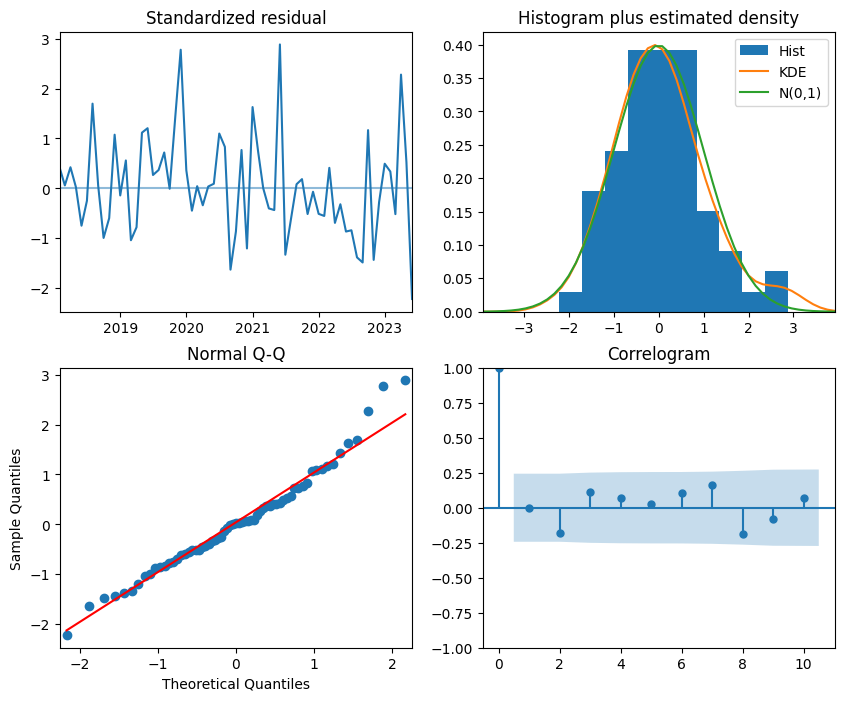

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   77
Model:             SARIMAX(2, 1, 0, 12)   Log Likelihood                  27.561
Date:                  Sat, 11 May 2024   AIC                            -47.122
Time:                          09:06:37   BIC                            -38.425
Sample:                      01-31-2017   HQIC                           -43.690
                           - 05-31-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0007      0.001     -0.660      0.509      -0.003       0.001
ar.S.L12      -0.6352      0.155     -4.102      0.000      -0.939      -0.332
ar.S.L24      -0.3415      0.141    

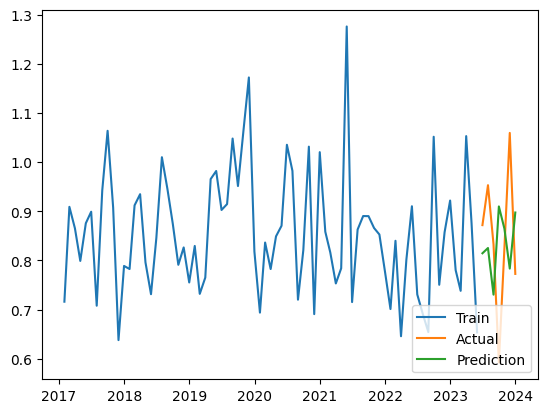

[0.0153603] [[-0.0158249]] [[0.01489569]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.47847802989664245

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.5}
[0.0153603] [[-0.0158249]] [[0.01489569]]
Mean of Residuals -0.00025631738326215665
Mean of Residuals -0.00025631738326215665


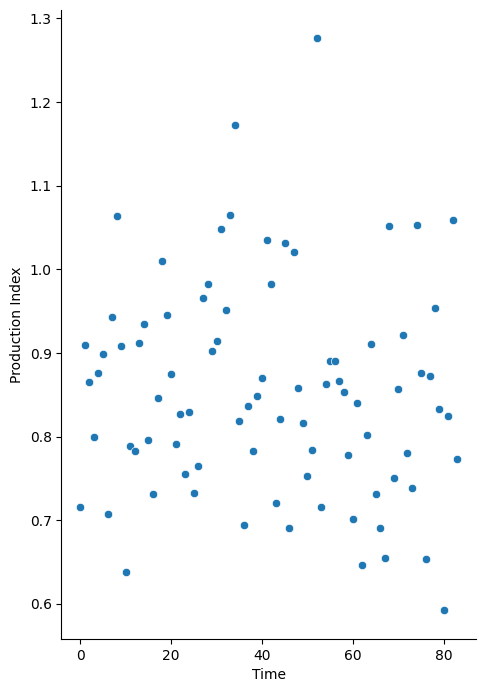

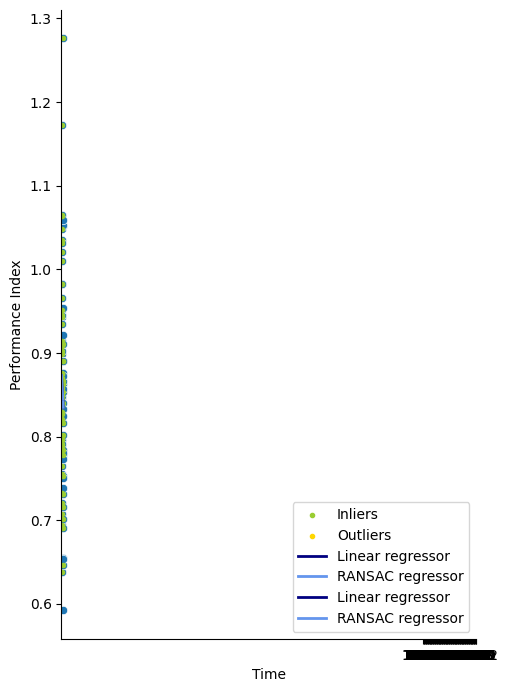

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.85051092] [[-3.81941287]] [[3.88160897]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.85051092] [[-3.81941287]] [[3.88160897]]
[2.46047713] [[-2.46114917]] [[2.45980509]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -193.4562872483129

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.46047713] [[-2.46114917]] [[2.45980509]]
[2.75189137] [[-2.7292548]] [[2.77452795]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -323.1316635076998

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.39188934] [[-3.36925277]] [[3.41452591]]
[3.88008547] [[-3.89921785]] [[3.86095309]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.634328343092615

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[3.88008547] [[-3.89921785]] [[3.86095309]]
[4.31529213] [[-4.27505485]] [[4.3555294]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.31529213] [[-4.27505485]] [[4.3555294]]
[7.89251194] [[-7.96904]] [[7.81598389]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.98570823371711

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.34855637] [[-5.42508442]] [[5.27202831]]
[5.82040083] [[-5.78887368]] [[5.85192799]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -108.39845872675805

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.82040083] [[-5.78887368]] [[5.85192799]]
[1.88320308] [[-1.87964237]] [[1.88676379]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.5092161609916146

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.88320308] [[-1.87964237]] [[1.88676379]]
[2.82597348] [[-2.81772145]] [[2.83422551]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -140.24651100001415

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.82597348] [[-2.81772145]] [[2.83422551]]
[4.15265937] [[-4.13668007]] [[4.16863867]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.30088594332103646

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.15265937] [[-4.13668007]] [[4.16863867]]
[2.65708737] [[-2.62923557]] [[2.68493917]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.678435579969968

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.65708737] [[-2.62923557]] [[2.68493917]]
[3.06804724] [[-3.11251617]] [[3.02357832]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.4098394921617032

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.76210786] [[-1.80657679]] [[1.71763894]]
[4.68734161] [[-4.64967927]] [[4.72500394]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -155.55369795157677

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.68734161] [[-4.64967927]] [[4.72500394]]
[3.30220659] [[-3.27522315]] [[3.32919003]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -8.408775373142689

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[3.30220659] [[-3.27522315]] [[3.32919003]]
[1.77930565] [[-1.7983129]] [[1.76029841]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.154471897471788

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.60630894] [[-3.62531618]] [[3.5873017]]
[5.27788047] [[-5.31937425]] [[5.23638669]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -317.3200383526557

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.27788047] [[-5.31937425]] [[5.23638669]]
[0.37089627] [[-0.39998126]] [[0.34181127]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.5991069801159391

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[2.46212187] [[-2.49120686]] [[2.43303687]]
[9.44458255] [[-9.39737745]] [[9.49178766]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -1.392160796144708

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[7.72229125] [[-7.67508615]] [[7.76949635]]
[3.43041935] [[-3.44875869]] [[3.41208001]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -29.716940465213025

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.43041935] [[-3.44875869]] [[3.41208001]]
[2.20079642] [[-2.20897032]] [[2.19262253]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5126642519202956

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.20079642] [[-2.20897032]] [[2.19262253]]
[3.69757746] [[-3.68342599]] [[3.71172893]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.91958511370088

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.69757746] [[-3.68342599]] [[3.71172893]]
[6.68864738] [[-6.65151962]] [[6.72577515]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.802710569943477

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.68864738] [[-6.65151962]] [[6.72577515]]
[7.41899607] [[-7.37677195]] [[7.46122019]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -58.22056147957496

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[7.4585367] [[-7.41631258]] [[7.50076083]]
[4.82838726] [[-4.82494081]] [[4.83183371]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.88232809592002

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.82838726] [[-4.82494081]] [[4.83183371]]
[5.99322832] [[-5.99328038]] [[5.99317626]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.08438068008889

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.99322832] [[-5.99328038]] [[5.99317626]]
[4.96034799] [[-5.02950009]] [[4.8911959]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.784186951750799

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.48386819] [[-4.55302029]] [[4.4147161]]
[3.83004238] [[-3.85488626]] [[3.8051985]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.30624475797044604

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.41658138] [[-4.44142526]] [[4.39173749]]
[8.66964364] [[-8.62007134]] [[8.71921594]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -49.25679298220574

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[8.66964364] [[-8.62007134]] [[8.71921594]]
               Production Index  Time
DateTimeIndex                        
2017-01-31             0.718118     0
2017-02-28             0.910379     1
2017-03-31             0.866973     2
2017-04-30             0.799132     3
2017-05-31             0.876421     4
...                         ...   ...
2023-08-31             1.034137    79
2023-09-30             0.694888    80
2023-10-31             0.884218    81
2023-11-30             1.059880    82
2023-12-31             0.776179    83

[84 rows x 2 columns]


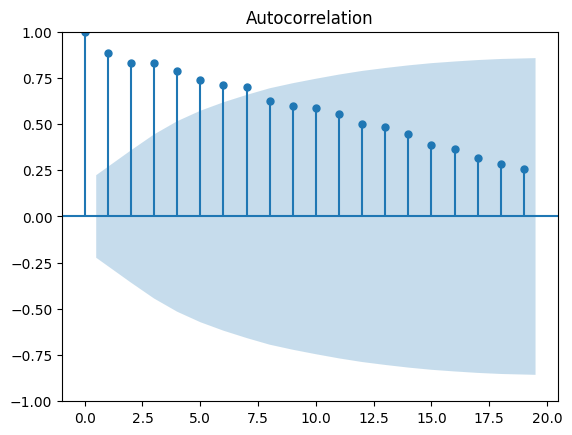

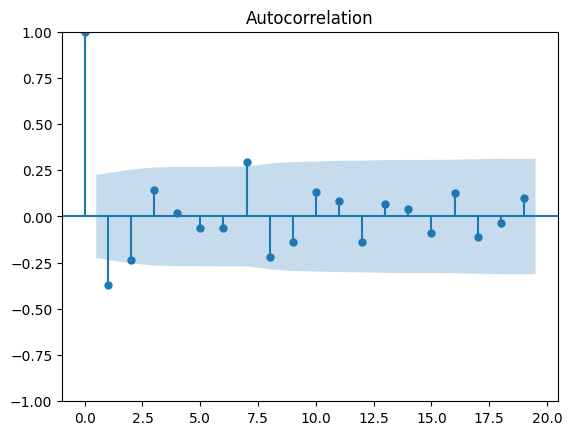

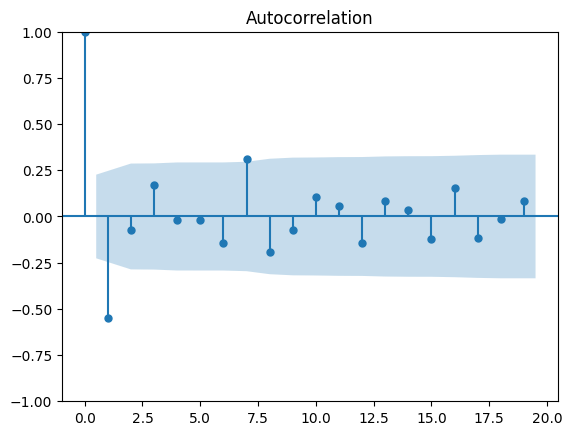

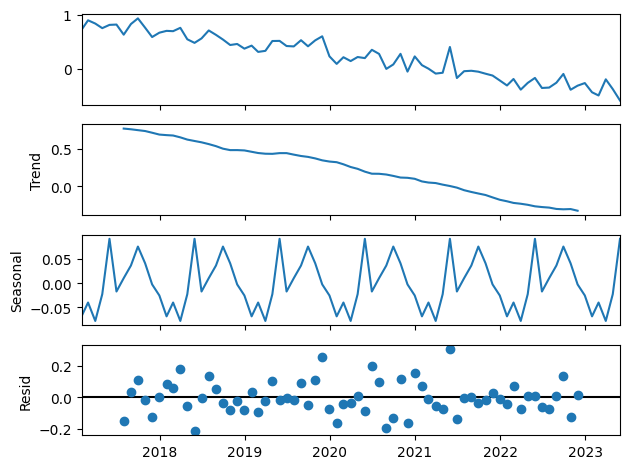

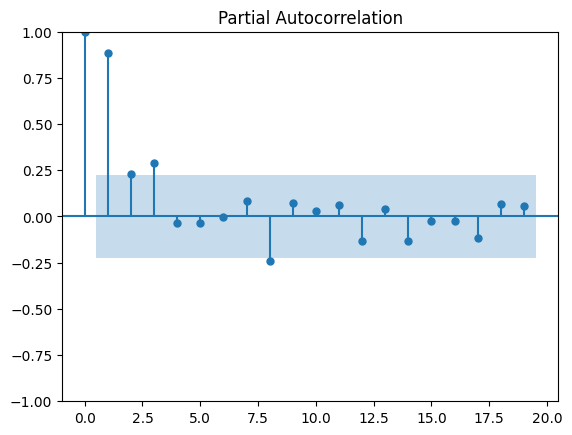

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.75 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-36.238, Time=0.14 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-45.767, Time=1.53 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.95 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-38.238, Time=0.16 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-34.248, Time=0.07 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-50.609, Time=2.03 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-47.447, Time=4.07 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=2.10 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-52.608, Time=2.04 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-47.755, Time=0.62 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-49.443, Time=1.02 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.41 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-50.611, Time=1.43 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-52.42

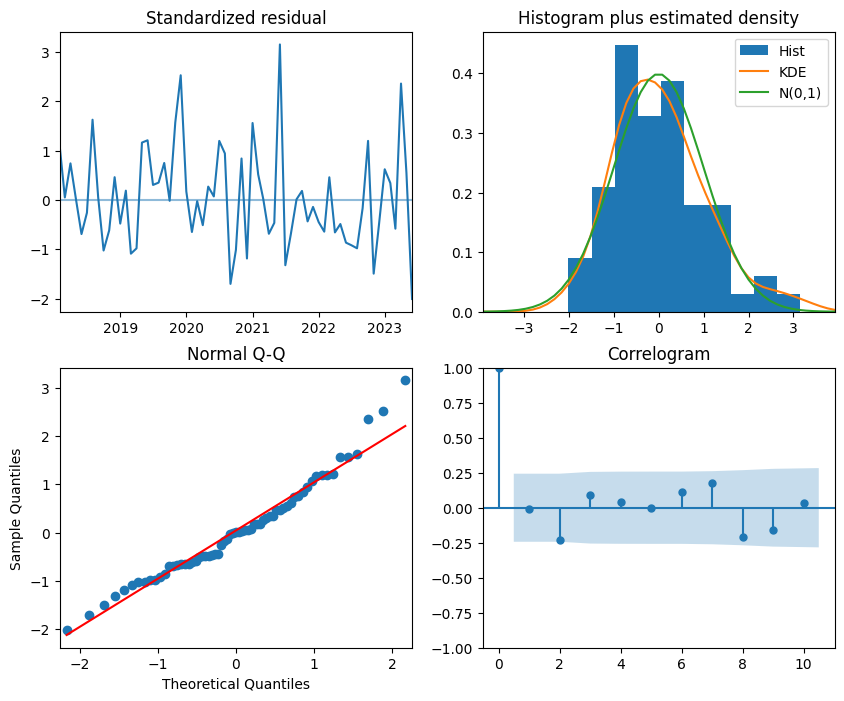

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   77
Model:             SARIMAX(2, 1, 0, 12)   Log Likelihood                  31.304
Date:                  Sat, 11 May 2024   AIC                            -54.609
Time:                          09:07:22   BIC                            -45.911
Sample:                      01-31-2017   HQIC                           -51.177
                           - 05-31-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0006      0.001     -0.630      0.529      -0.002       0.001
ar.S.L12      -0.6860      0.151     -4.556      0.000      -0.981      -0.391
ar.S.L24      -0.4158      0.138    

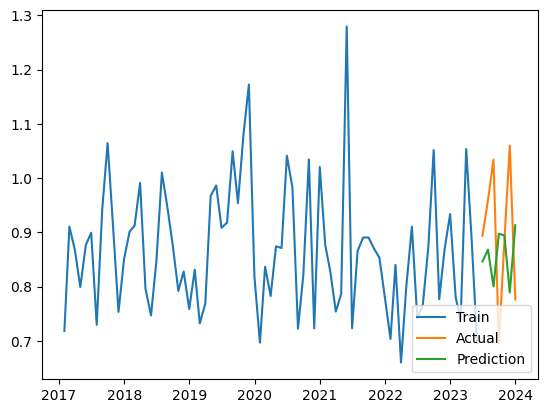

[0.01416639] [[-0.01478642]] [[0.01354635]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.4739013070854329

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.5}
[0.01416639] [[-0.01478642]] [[0.01354635]]
Mean of Residuals 0.03861952671989594
Mean of Residuals 0.03861952671989594


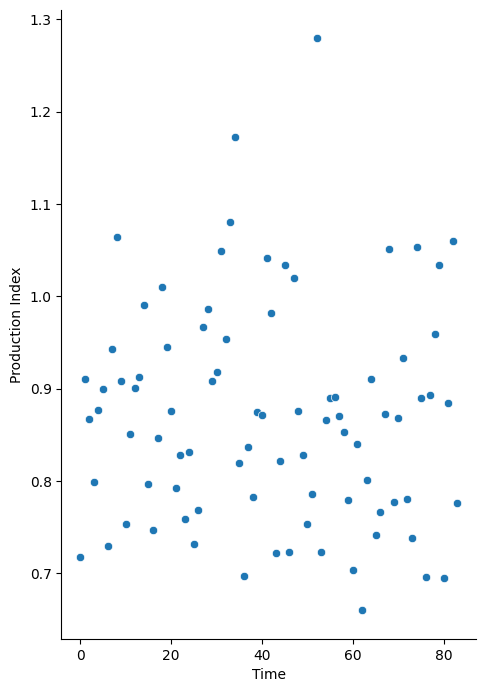

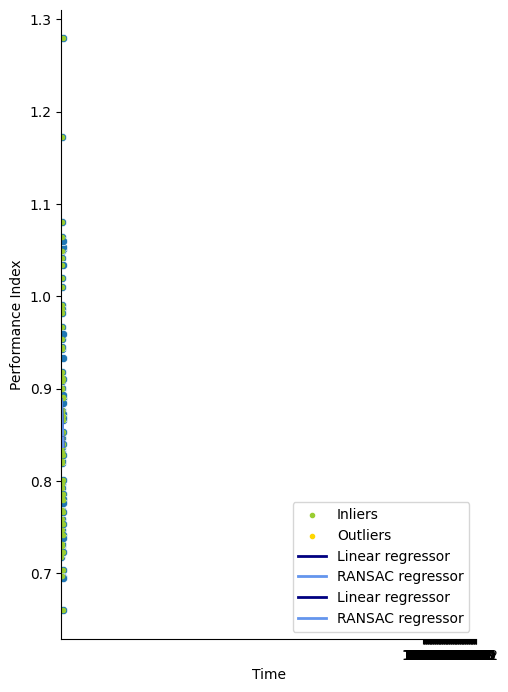

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.85029414] [[-3.81930518]] [[3.88128309]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.85029414] [[-3.81930518]] [[3.88128309]]
[2.44402955] [[-2.44564144]] [[2.44241766]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -187.92265437309044

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.44402955] [[-2.44564144]] [[2.44241766]]
[2.86059708] [[-2.83912809]] [[2.88206608]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -397.9288749418879

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.86059708] [[-2.83912809]] [[2.88206608]]
[2.7612164] [[-2.7727565]] [[2.7496763]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.7813889448102892

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.7612164] [[-2.7727565]] [[2.7496763]]
[4.34781638] [[-4.32924564]] [[4.36638712]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.34781638] [[-4.32924564]] [[4.36638712]]
[7.70478579] [[-7.78029434]] [[7.62927723]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.621502242529815

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.16957023] [[-5.24507878]] [[5.09406168]]
[5.80584433] [[-5.77431718]] [[5.83737148]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -108.39845872675805

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.80584433] [[-5.77431718]] [[5.83737148]]
[1.85240838] [[-1.84886915]] [[1.85594762]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.55400561584283

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.85240838] [[-1.84886915]] [[1.85594762]]
[2.74181558] [[-2.73403519]] [[2.74959597]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -139.95095697449148

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.74181558] [[-2.73403519]] [[2.74959597]]
[4.08705645] [[-4.07172165]] [[4.10239126]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.27356141630016756

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.08705645] [[-4.07172165]] [[4.10239126]]
[2.59265912] [[-2.56551363]] [[2.61980461]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.52222146799034

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.59265912] [[-2.56551363]] [[2.61980461]]
[3.05808626] [[-3.1031422]] [[3.01303032]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.423070032857935

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.7607505] [[-1.80580644]] [[1.71569456]]
[4.67497128] [[-4.63756326]] [[4.71237931]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -154.54182465105293

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.67497128] [[-4.63756326]] [[4.71237931]]
[3.12098851] [[-3.09595489]] [[3.14602213]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -10.984621998348361

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[2.56788364] [[-2.54285002]] [[2.59291726]]
[1.79478782] [[-1.81349246]] [[1.77608319]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.6362747985007442

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[3.54443896] [[-3.56314359]] [[3.52573432]]
[5.10552261] [[-5.14669585]] [[5.06434937]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -185.16422918794112

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.10552261] [[-5.14669585]] [[5.06434937]]
[0.33762673] [[-0.36853011]] [[0.30672336]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.9991596259740989

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.49997974] [[-2.53088311]] [[2.46907636]]
[10.1897801] [[-10.13651062]] [[10.24304957]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -2.133780528972729

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[8.50566668] [[-8.45239721]] [[8.55893616]]
[3.4469304] [[-3.46583288]] [[3.42802791]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -33.659383264337244

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.4469304] [[-3.46583288]] [[3.42802791]]
[2.18221097] [[-2.1910345]] [[2.17338743]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5537968066612879

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.18221097] [[-2.1910345]] [[2.17338743]]
[3.47378748] [[-3.4595036]] [[3.48807135]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.41843277566597

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.47378748] [[-3.4595036]] [[3.48807135]]
[6.53116556] [[-6.49436287]] [[6.56796826]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.935022538341622

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.53116556] [[-6.49436287]] [[6.56796826]]
[7.52495649] [[-7.47329356]] [[7.57661942]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -10.674598804044003

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[7.52495649] [[-7.47329356]] [[7.57661942]]
[4.80170115] [[-4.79997355]] [[4.80342875]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.201147819366122

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.80170115] [[-4.79997355]] [[4.80342875]]
[6.11460797] [[-6.11614624]] [[6.1130697]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.806867225660405

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.11460797] [[-6.11614624]] [[6.1130697]]
[4.46236621] [[-4.52820139]] [[4.39653104]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.340892033769152

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.85483186] [[-3.92066704]] [[3.78899669]]
[3.40567476] [[-3.42084844]] [[3.39050107]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.6414789492684811

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.74010792] [[-2.75528161]] [[2.72493424]]
[8.20704506] [[-8.16525291]] [[8.2488372]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -60.786245054422054

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[8.20704506] [[-8.16525291]] [[8.2488372]]
               Production Index  Time
DateTimeIndex                        
2018-01-31             0.782637     0
2018-02-28             0.912175     1
2018-03-31             0.934897     2
2018-04-30             0.796255     3
2018-05-31             0.731427     4
2018-06-30             0.846039     5
2018-07-31             1.010090     6
2018-08-31             0.945424     7
2018-09-30             0.874766     8
2018-10-31             0.791199     9
2018-11-30             0.826566    10
2018-12-31             0.755309    11
2019-01-31             0.829584    12
2019-02-28             0.73209

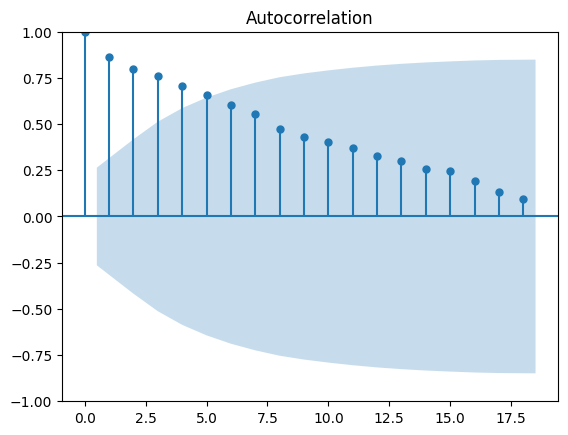

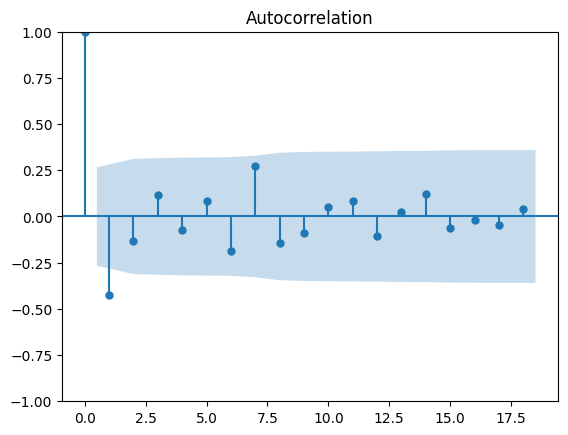

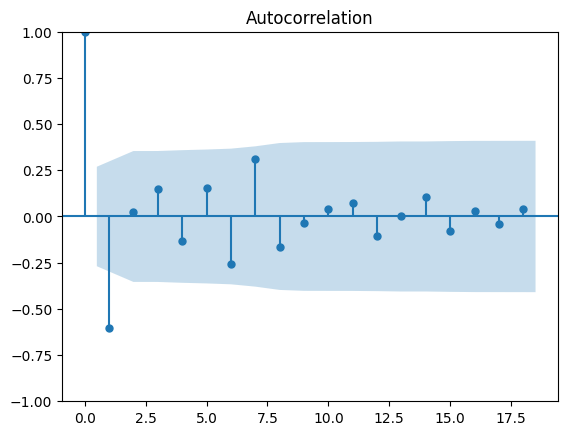

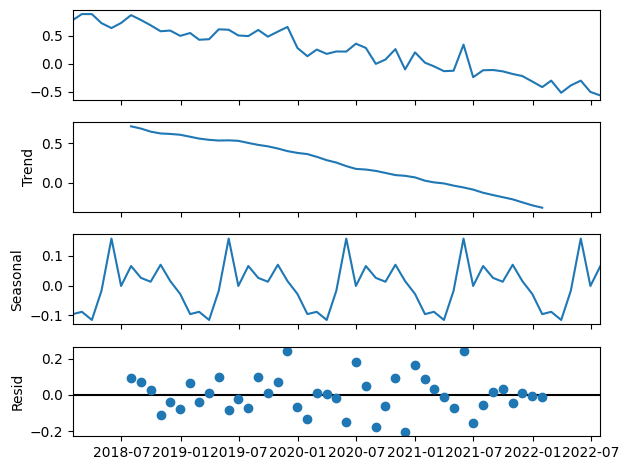

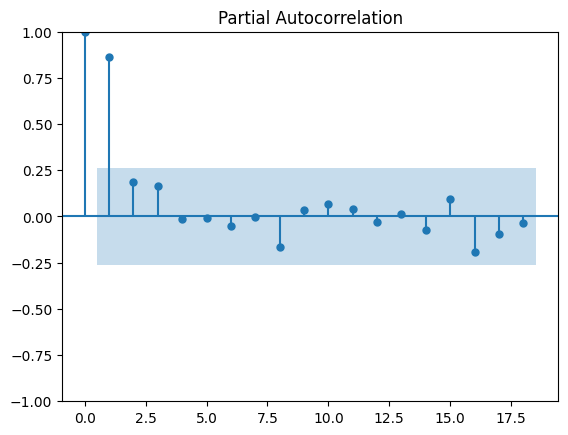

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.21 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-15.983, Time=0.11 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-29.911, Time=0.81 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.02 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-17.983, Time=0.09 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-14.041, Time=0.09 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-28.534, Time=1.58 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-28.684, Time=1.02 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=1.34 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-26.539, Time=1.60 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-31.834, Time=0.70 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-30.497, Time=1.47 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-30.670, Time=0.99 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.83 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-28.59

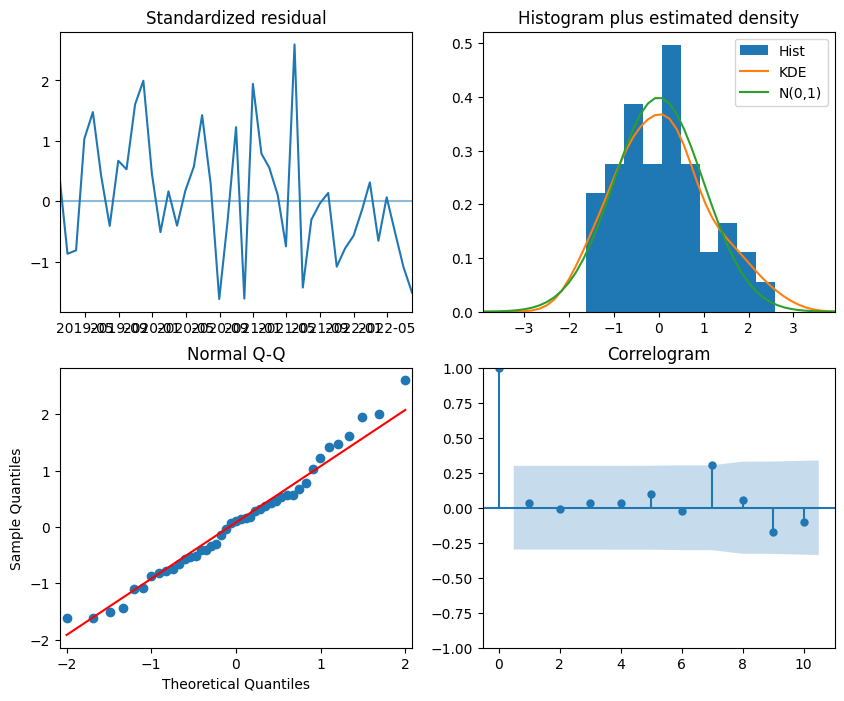

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   55
Model:             SARIMAX(1, 1, 0, 12)   Log Likelihood                  19.915
Date:                  Sat, 11 May 2024   AIC                            -33.831
Time:                          09:07:58   BIC                            -28.547
Sample:                      01-31-2018   HQIC                           -31.882
                           - 07-31-2022                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0017      0.001     -1.211      0.226      -0.004       0.001
ar.S.L12      -0.6357      0.135     -4.710      0.000      -0.900      -0.371
sigma2         0.0201      0.005    

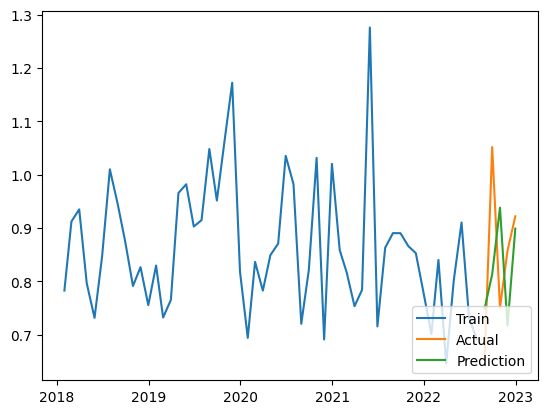

[0.02974724] [[-0.02955612]] [[0.02993837]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=25, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.0398527543863401

 The best parameters across ALL searched params:
 {'min_samples': 25, 'residual_threshold': 0.375}
[0.02672957] [[-0.02653844]] [[0.02692069]]
Mean of Residuals -0.08498677890852502
Mean of Residuals -0.05379491608238816


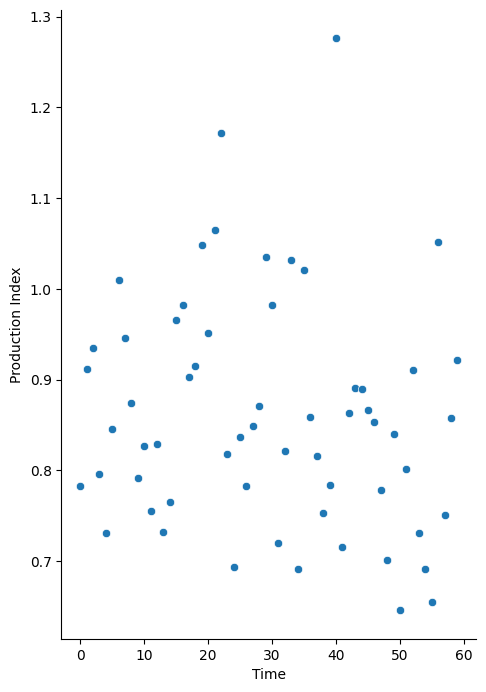

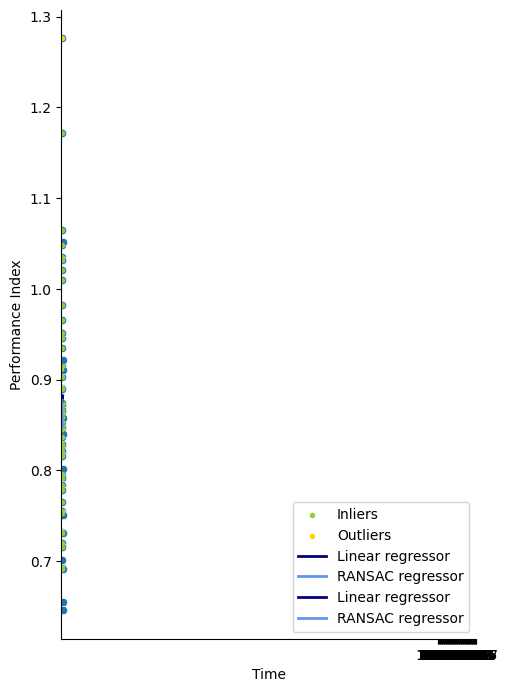

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Skomakerfjellet
2002-01-01 00:00:00              NaN
2002-01-01 01:00:00              NaN
2002-01-01 02:00:00              NaN
2002-01-01 03:00:00              NaN
2002-01-01 04:00:00              NaN
...                              ...
2017-03-27 05:00:00        17.379429
2017-12-23 03:00:00        17.409456
2019-12-05 02:00:00        16.117369
2022-03-01 17:00:00        18.118353
2022-03-01 21:00:00        16.815948

[193519 rows x 1 columns]
##################Tellenes###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2018-07-16 16:00:00   3.297013  294.602417  99899.984375         1.100646
2018-07-16 17:00:00   3.080542  294.387634  99865.351562         1.100651
2018-07-16 18:00:00   2.777701  293.572845  99878.984375         1.100666
2018-07-16 19:00:00   2.273869  292.631

<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Tellenes
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31       NaN
2014-12-31       NaN
2015-12-31       NaN
2016-12-31       NaN
2017-12-31       NaN
2018-12-31  0.222772
2019-12-31  0.821918
2020-12-31  0.295993
2021-12-31  0.787671
2022-12-31  1.267123
2023-12-31  2.214612 <class 'pandas.core.frame.DataFrame'>
feedin_power_plant    3.328661e+06
dtype: float64


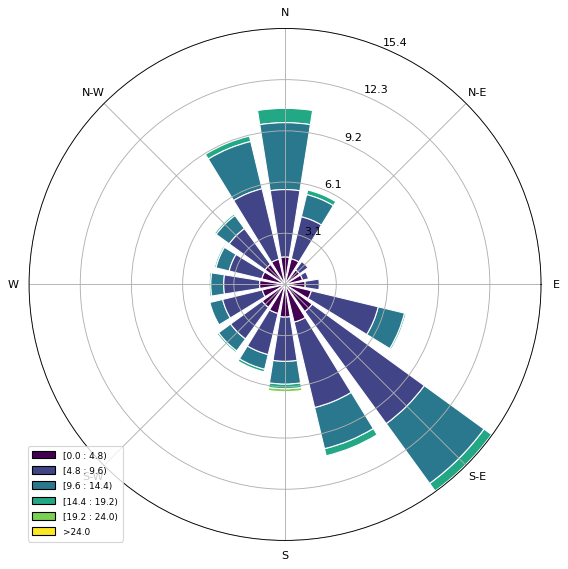

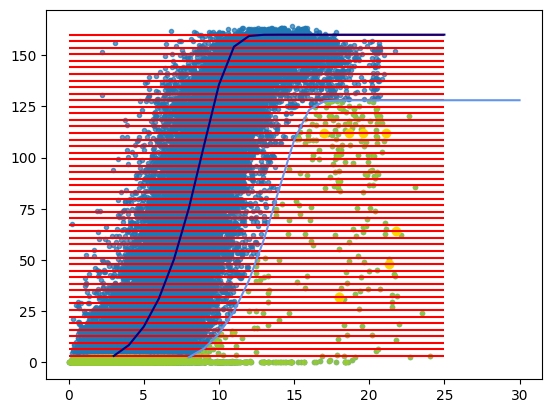

               Production Index  Time
DateTimeIndex                        
2018-07-31             0.818721     0
2018-08-31             0.938867     1
2018-09-30             0.940844     2
2018-10-31             0.941162     3
2018-11-30             0.983398     4
...                         ...   ...
2023-08-31             0.845520    61
2023-09-30             0.834015    62
2023-10-31             0.857922    63
2023-11-30             1.024073    64
2023-12-31             0.923980    65

[66 rows x 2 columns]


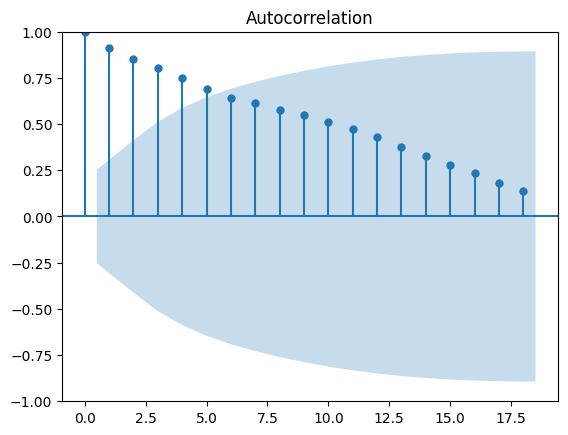

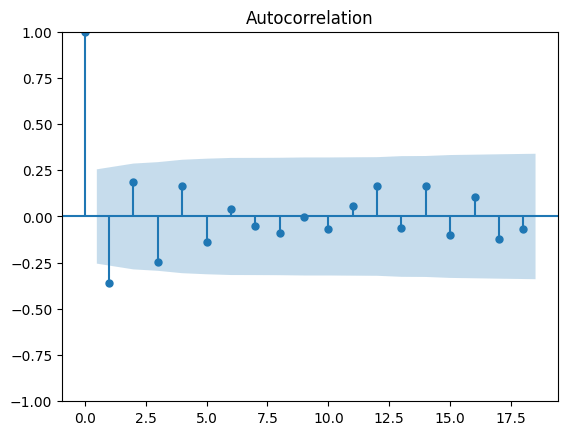

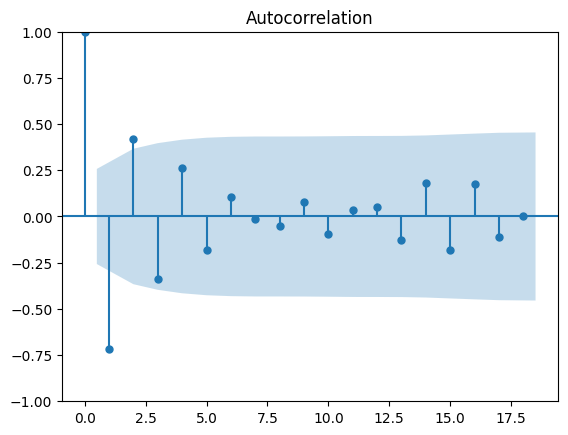

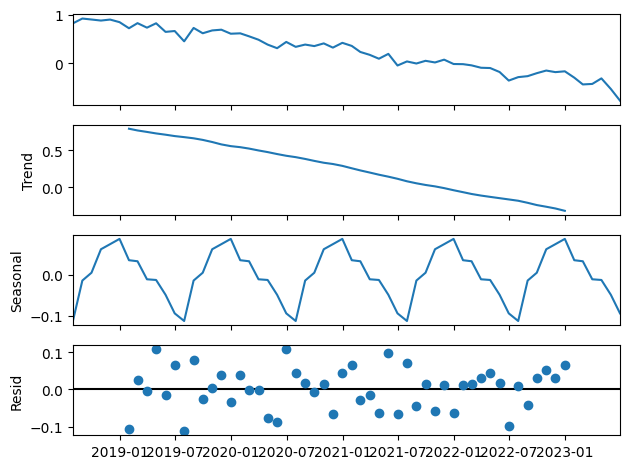

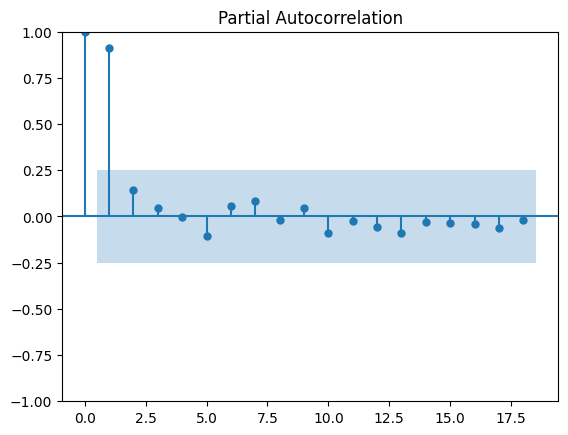

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-91.514, Time=0.74 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-92.349, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-92.231, Time=0.90 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-93.511, Time=3.41 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-94.349, Time=0.10 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-94.224, Time=1.64 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-95.482, Time=0.35 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-93.711, Time=1.57 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=-93.783, Time=0.90 sec
 ARIMA(0,0,0)(1,1,2)[12] intercept   : AIC=-91.822, Time=1.27 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-93.524, Time=0.72 sec
 ARIMA(0,0,0)(0,1,1)[12]             : AIC=-97.482, Time=0.33 sec
 ARIMA(0,0,0)(1,1,1)[12]             : AIC=-95.738, Time=0.63 sec
 ARIMA(0,0,0)(0,1,2)[12]             : AIC=-95.789, Time=0.99 sec
 ARIMA(0,0,0)(1,1,0)[12]         

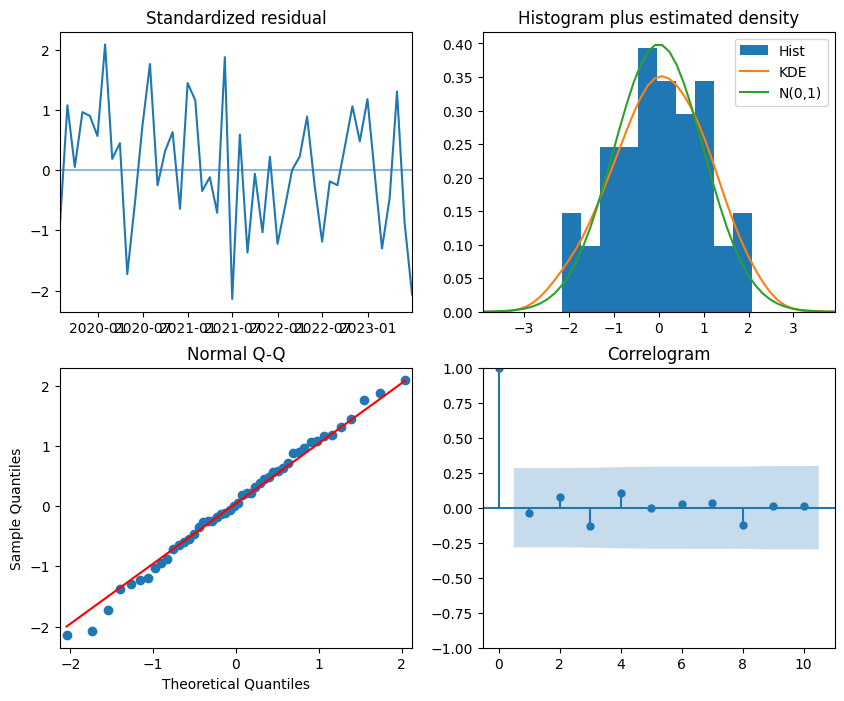

                                 SARIMAX Results                                  
Dep. Variable:                          y   No. Observations:                   60
Model:             SARIMAX(0, 1, [1], 12)   Log Likelihood                  51.741
Date:                    Sat, 11 May 2024   AIC                            -97.482
Time:                            09:08:46   BIC                            -91.868
Sample:                        07-31-2018   HQIC                           -95.360
                             - 06-30-2023                                         
Covariance Type:                      opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0021      0.001     -2.942      0.003      -0.004      -0.001
ma.S.L12      -0.4304      0.169     -2.548      0.011      -0.761      -0.099
sigma2         0.006

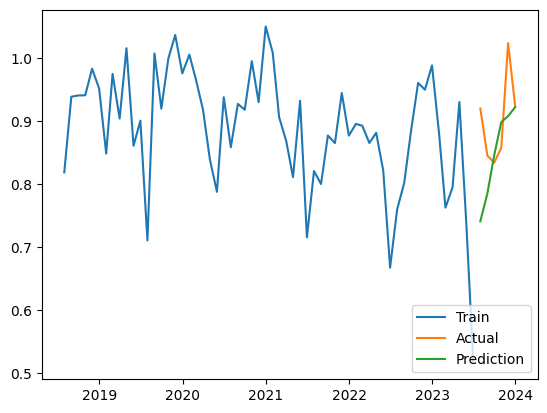

[0.01960893] [[-0.02163238]] [[0.01758548]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.32747880071143787

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.01960893] [[-0.02163238]] [[0.01758548]]
Mean of Residuals 0.02274790261974809
Mean of Residuals 0.02274790261974809


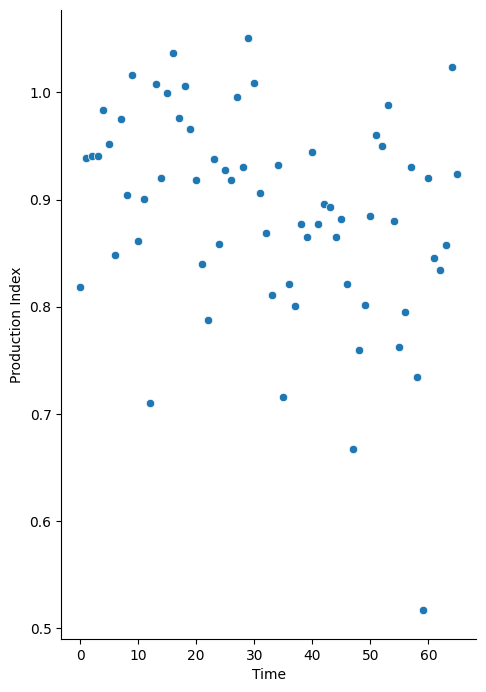

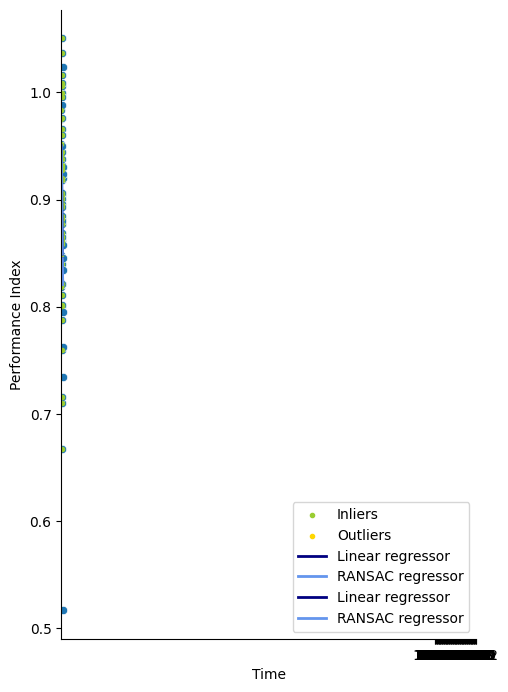

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.42235784] [[-3.38478856]] [[3.45992711]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.42235784] [[-3.38478856]] [[3.45992711]]
[1.3517164] [[-1.34000909]] [[1.36342372]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.331434552488847

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.3517164] [[-1.34000909]] [[1.36342372]]
[1.74512893] [[-1.72942778]] [[1.76083008]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -294.9628300654034

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.74512893] [[-1.72942778]] [[1.76083008]]
[3.38716298] [[-3.41675305]] [[3.35757291]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -24.681110130080086

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.70038419] [[-2.72997427]] [[2.67079412]]
[5.31850263] [[-5.25951101]] [[5.37749424]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -41.54464999326113

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.31850263] [[-5.25951101]] [[5.37749424]]
[1.39275602] [[-1.38726093]] [[1.39825112]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.765672223802166

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.39275602] [[-1.38726093]] [[1.39825112]]
[0.86306992] [[-0.86709047]] [[0.85904937]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.8111530342743856

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.86306992] [[-0.86709047]] [[0.85904937]]
[2.56128487] [[-2.5639693]] [[2.55860044]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -140.64362588440932

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.56128487] [[-2.5639693]] [[2.55860044]]
[3.30164831] [[-3.2943848]] [[3.30891181]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.643285737875141

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.30164831] [[-3.2943848]] [[3.30891181]]
[0.97823852] [[-0.97952182]] [[0.97695522]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -65561.41586789553

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.97823852] [[-0.97952182]] [[0.97695522]]
[6.16883955] [[-6.25010992]] [[6.08756918]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -78674.11937942068

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.17353974] [[-4.2548101]] [[4.09226937]]
[5.944452] [[-5.92935113]] [[5.95955287]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.542023797709634

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[5.45867718] [[-5.44357631]] [[5.47377805]]
[4.5674195] [[-4.57502331]] [[4.5598157]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.1547502199289967

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.94770838] [[-5.95531218]] [[5.94010457]]
[2.85604393] [[-2.8523689]] [[2.85971896]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.779417745136084

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.85604393] [[-2.8523689]] [[2.85971896]]
[0.45990108] [[-0.46531495]] [[0.45448721]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -755.820607610659

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.45990108] [[-0.46531495]] [[0.45448721]]
[5.13061355] [[-5.16074043]] [[5.10048667]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -23.90887971318368

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.13061355] [[-5.16074043]] [[5.10048667]]
[1.57903703] [[-1.56742014]] [[1.59065392]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.384706738636899

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.57903703] [[-1.56742014]] [[1.59065392]]
[0.80168986] [[-0.80614265]] [[0.79723707]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.8738193948270387

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.80168986] [[-0.80614265]] [[0.79723707]]
[2.33028851] [[-2.34960643]] [[2.3109706]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1230.5946011187034

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.51077779] [[-1.5300957]] [[1.49145988]]
[5.35896224] [[-5.40956974]] [[5.30835474]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.321794840756203

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.18822408] [[-5.23883158]] [[5.13761658]]
[3.40946518] [[-3.39551877]] [[3.4234116]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.148464950701523

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.40946518] [[-3.39551877]] [[3.4234116]]
[4.31721274] [[-4.28947031]] [[4.34495518]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7607793638919862

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.31721274] [[-4.28947031]] [[4.34495518]]
               Production Index  Time
DateTimeIndex                        
2018-07-31             0.819803     0
2018-08-31             0.938867     1
2018-09-30             0.941471     2
2018-10-31             0.941162     3
2018-11-30             0.989014     4
...                         ...   ...
2023-08-31             0.850920    61
2023-09-30             0.837717    62
2023-10-31             0.867034    63
2023-11-30             1.024552    64
2023-12-31             0.936031    65

[66 rows x 2 columns]


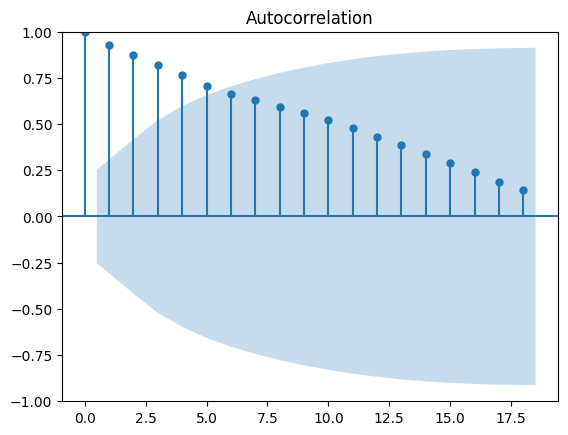

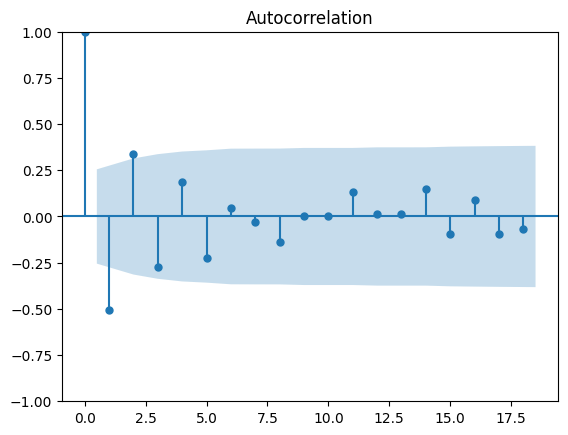

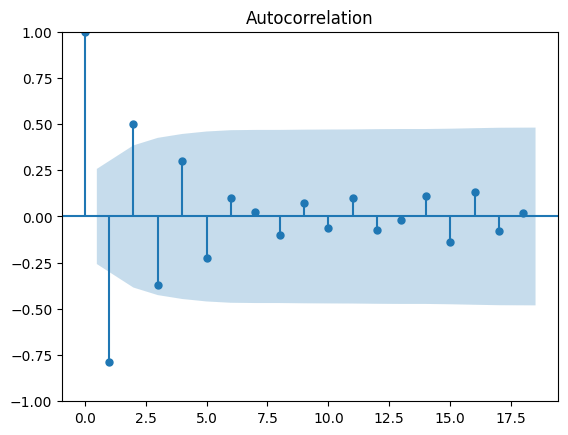

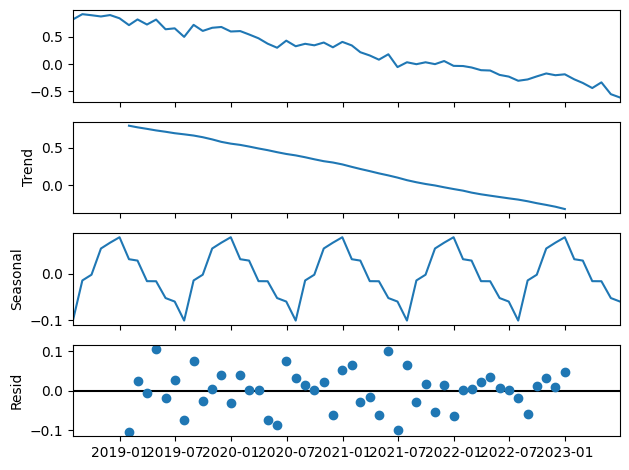

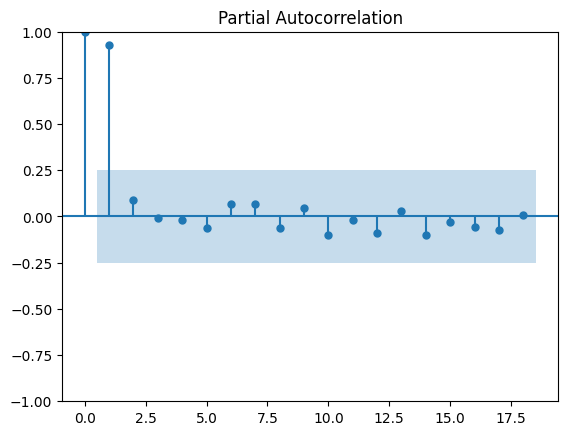

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.28 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-96.938, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-101.866, Time=1.20 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.35 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-98.938, Time=0.12 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-95.242, Time=0.11 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-108.256, Time=1.76 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-106.764, Time=2.63 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-105.151, Time=0.91 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-108.891, Time=1.09 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-103.499, Time=0.38 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-107.382, Time=1.99 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.34 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-108.247, Time=3.05 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   

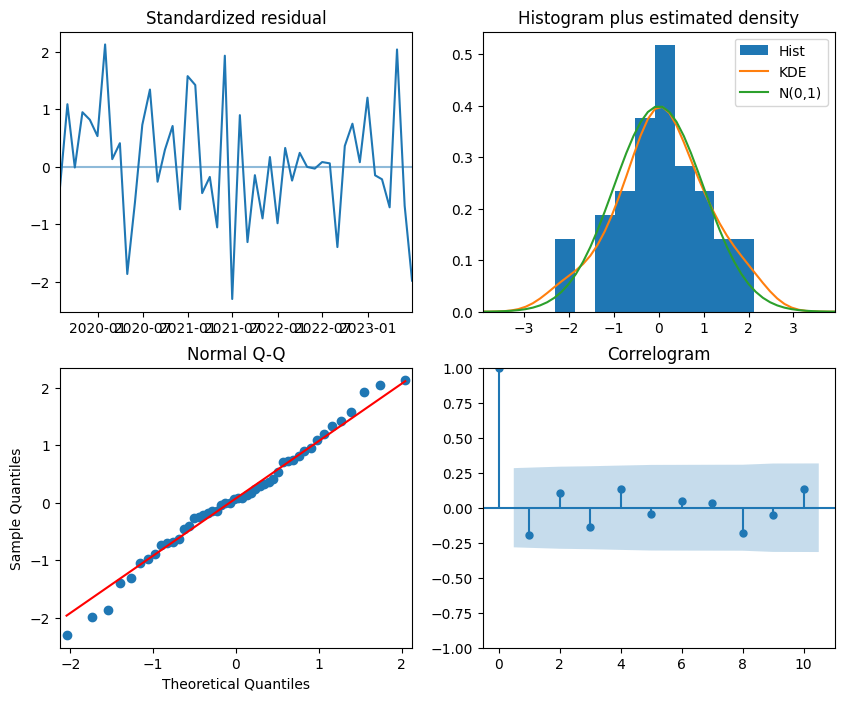

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   60
Model:             SARIMAX(2, 1, 0, 12)   Log Likelihood                  59.454
Date:                  Sat, 11 May 2024   AIC                           -110.907
Time:                          09:09:28   BIC                           -103.422
Sample:                      07-31-2018   HQIC                          -108.079
                           - 06-30-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0017      0.000     -3.505      0.000      -0.003      -0.001
ar.S.L12      -0.7055      0.152     -4.629      0.000      -1.004      -0.407
ar.S.L24      -0.5353      0.128    

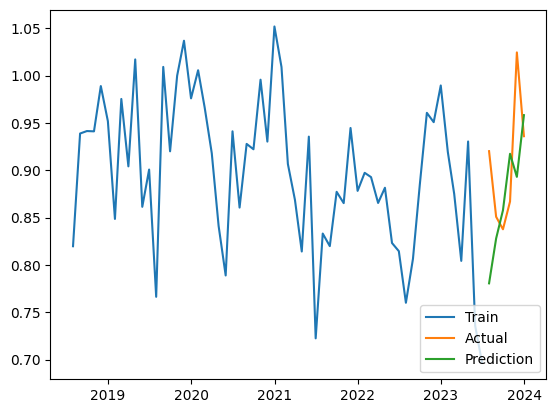

[0.01491001] [[-0.01669101]] [[0.01312901]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.32558023534625546

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.01491001] [[-0.01669101]] [[0.01312901]]
Mean of Residuals 0.03607458653227278
Mean of Residuals 0.03607458653227278


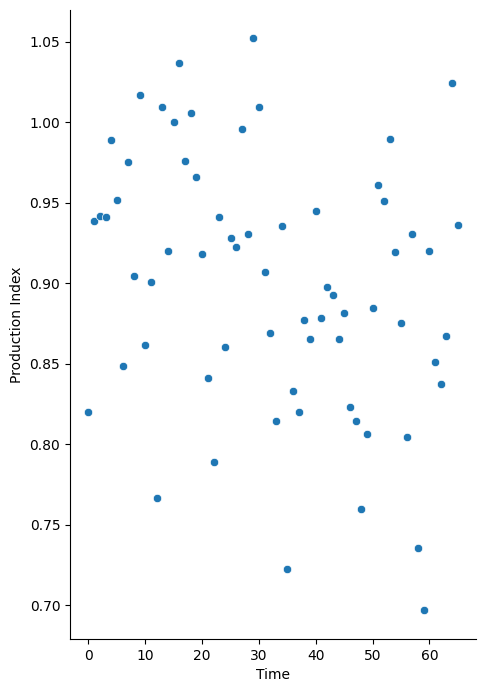

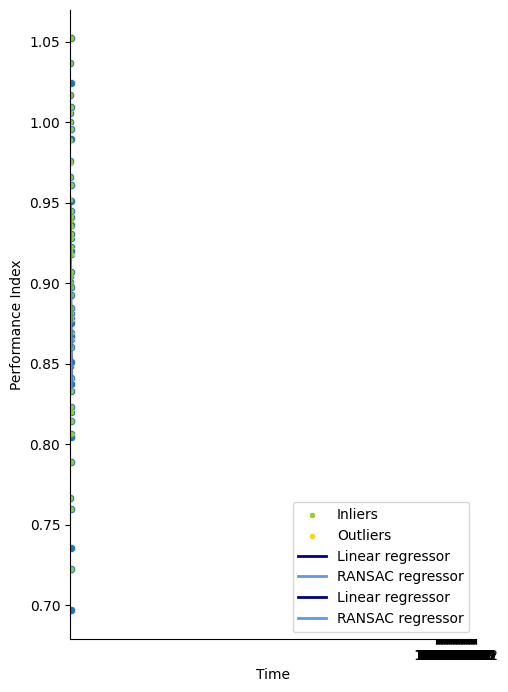

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.39838096] [[-3.36105787]] [[3.43570406]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.39838096] [[-3.36105787]] [[3.43570406]]
[1.49894396] [[-1.48644248]] [[1.51144544]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -32.67608236671843

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.49894396] [[-1.48644248]] [[1.51144544]]
[1.7465934] [[-1.73088813]] [[1.76229867]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -345.44665125997534

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.7465934] [[-1.73088813]] [[1.76229867]]
[3.38334598] [[-3.41294925]] [[3.35374271]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.439790309784918

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.69849772] [[-2.728101]] [[2.66889445]]
[4.99478193] [[-4.94125061]] [[5.04831325]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -77.39932768640608

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.99478193] [[-4.94125061]] [[5.04831325]]
[1.39292737] [[-1.38743089]] [[1.39842385]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.7137689302982

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.39292737] [[-1.38743089]] [[1.39842385]]
[0.86314988] [[-0.86715844]] [[0.85914133]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.8201096014406866

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.86314988] [[-0.86715844]] [[0.85914133]]
[2.4441387] [[-2.44619334]] [[2.44208406]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -46.4385084444437

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.4441387] [[-2.44619334]] [[2.44208406]]
[3.13459354] [[-3.12746516]] [[3.14172192]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.513548759879026

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13459354] [[-3.12746516]] [[3.14172192]]
[0.9780305] [[-0.97938281]] [[0.97667819]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1475.6337643728343

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.9780305] [[-0.97938281]] [[0.97667819]]
[6.16007404] [[-6.2413808]] [[6.07876729]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -77312.08206631677

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.17067312] [[-4.25197987]] [[4.08936637]]
[5.82050204] [[-5.80541407]] [[5.83559001]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.772882520233958

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[5.33200271] [[-5.31691473]] [[5.34709068]]
[4.32865479] [[-4.33453287]] [[4.3227767]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.313357876478234

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.4887526] [[-3.49463069]] [[3.48287452]]
[2.75967319] [[-2.75598995]] [[2.76335643]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.7797865408064544

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.75967319] [[-2.75598995]] [[2.76335643]]
[0.46208982] [[-0.46762417]] [[0.45655547]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1930.629146508886

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.46208982] [[-0.46762417]] [[0.45655547]]
[4.91442515] [[-4.94335544]] [[4.88549487]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -22.613808675550608

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.91442515] [[-4.94335544]] [[4.88549487]]
[1.58509874] [[-1.57328779]] [[1.59690968]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.279753582032501

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58509874] [[-1.57328779]] [[1.59690968]]
[0.82617504] [[-0.83055538]] [[0.8217947]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.8810379656056

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.82617504] [[-0.83055538]] [[0.8217947]]
[1.76340797] [[-1.78038281]] [[1.74643312]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1780.9381368836698

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.76340797] [[-1.78038281]] [[1.74643312]]
[4.58609766] [[-4.63654703]] [[4.53564828]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.5546997980536075

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.38678367] [[-4.43723304]] [[4.33633429]]
[3.44535736] [[-3.43108409]] [[3.45963063]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.61509916976113

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.44535736] [[-3.43108409]] [[3.45963063]]
[4.09780596] [[-4.07035857]] [[4.12525334]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7656941080643027

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.09780596] [[-4.07035857]] [[4.12525334]]
               Production Index  Time
DateTimeIndex                        
2019-07-31             0.710667     0
2019-08-31             1.007568     1
2019-09-30             0.920073     2
2019-10-31             0.999927     3
2019-11-30             1.036866     4
2019-12-31             0.975992     5
2020-01-31             1.005714     6
2020-02-29             0.966025     7
2020-03-31             0.917998     8
2020-04-30             0.839521     9
2020-05-31             0.787868    10
2020-06-30             0.938151    11
2020-07-31             0.858793    12
2020-08-31             0.

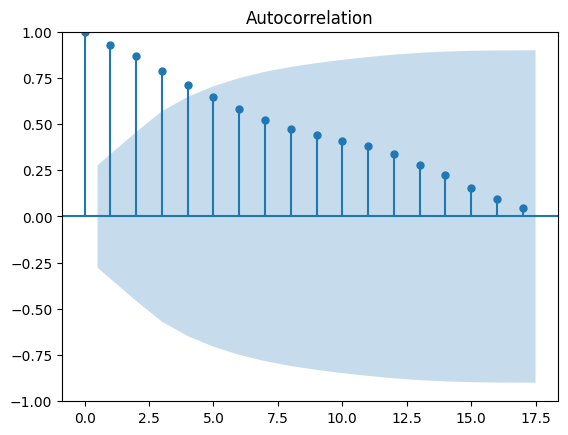

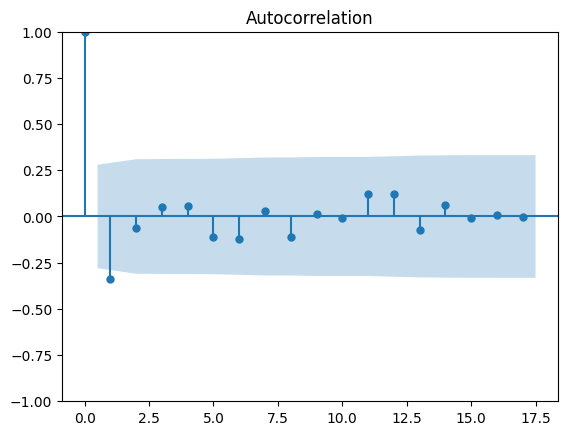

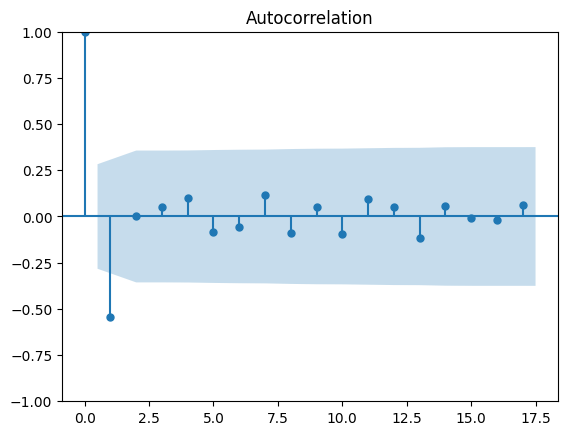

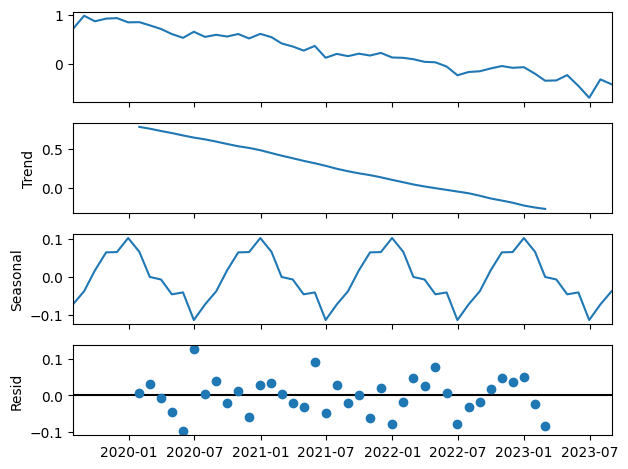

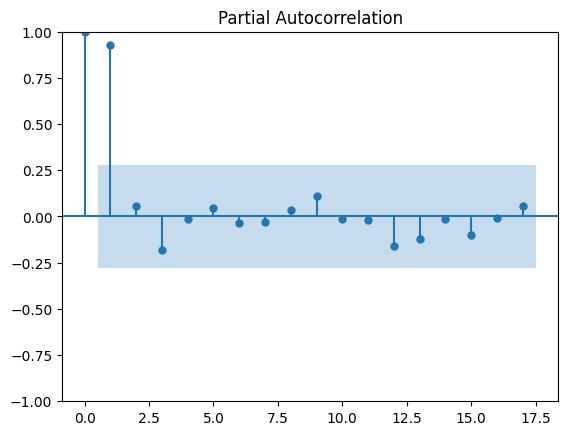

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-66.838, Time=1.14 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-69.392, Time=0.06 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-68.721, Time=0.89 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-68.607, Time=1.03 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-71.392, Time=0.09 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-70.038, Time=0.39 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-69.509, Time=0.38 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-68.048, Time=0.69 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-68.087, Time=0.19 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-68.104, Time=0.17 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-66.018, Time=0.19 sec

Best model:  ARIMA(0,0,0)(0,1,0)[12]          
Total fit time: 5.258 seconds


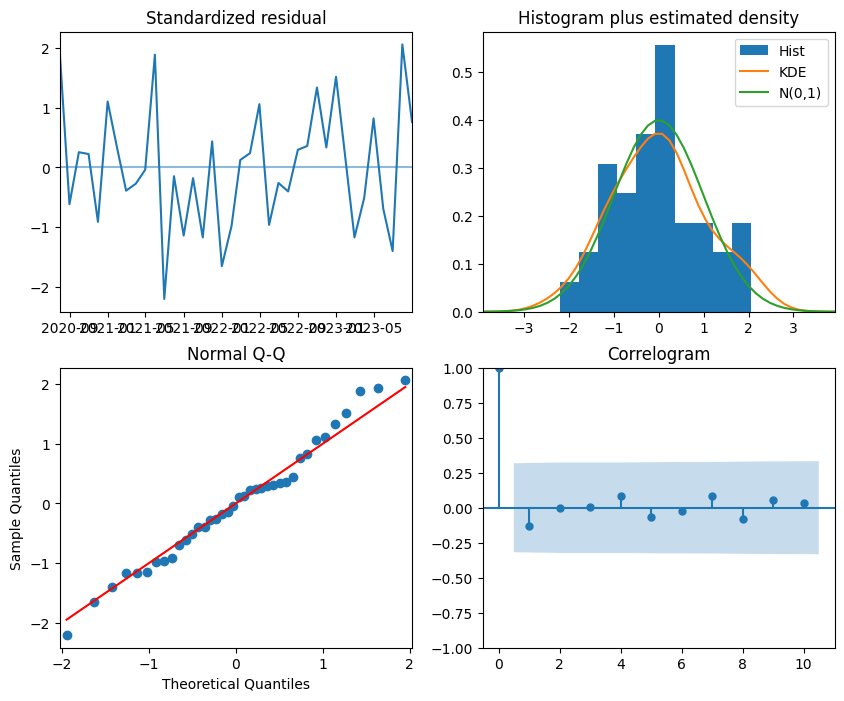

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   50
Model:             SARIMAX(0, 1, 0, 12)   Log Likelihood                  37.696
Date:                  Sat, 11 May 2024   AIC                            -71.392
Time:                          09:09:44   BIC                            -68.117
Sample:                      07-31-2019   HQIC                           -70.227
                           - 08-31-2023                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0021      0.001     -1.684      0.092      -0.004       0.000
sigma2         0.0081      0.002      3.910      0.000       0.004       0.012
Ljung-Box (L1) (Q):                 

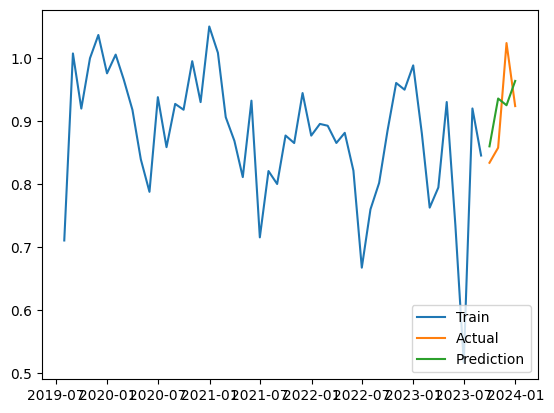

[0.03117845] [[-0.03319393]] [[0.02916296]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 34.

--------------------------------------------------------------------------------
18 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.12432372012308712

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.03117845] [[-0.03319393]] [[0.02916296]]
Mean of Residuals -0.008756843313611495
Mean of Residuals -0.008756843313611495


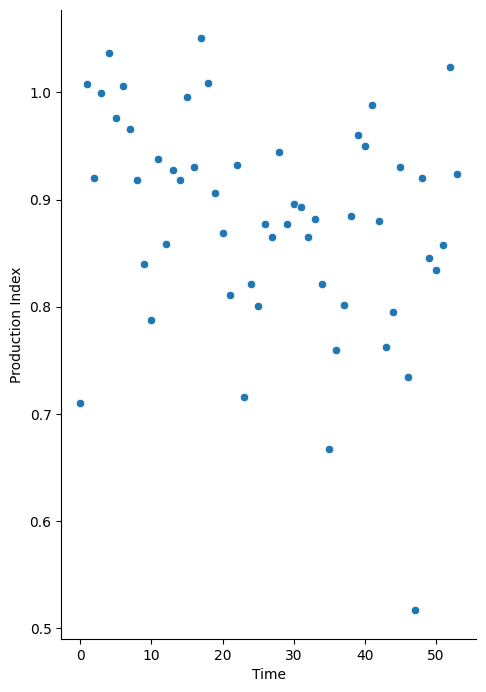

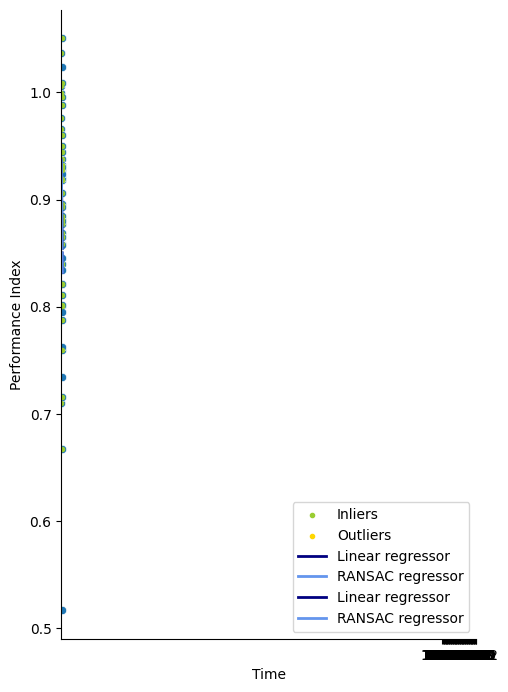

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                      Tellenes
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2022-01-29 20:00:00  21.808565
2018-09-21 18:00:00  21.124720
2022-01-16 21:00:00  19.576239
2022-11-17 10:00:00  16.956352
2023-12-27 21:00:00  18.634985

[193321 rows x 1 columns]
##################Valsneset###################
                    wind_speed temperature      pressure roughness_length
                           100         2             0                0  
timestamp                                                                
2007-10-15 23:00:00  10.536739  282.381134  98889.062500         0.080434
2007-10-16 00:00:00   9.306436  282.643280  98851.210938         0.080688
2007-10-16 01:00:00   7.642297  282.798645  98810.437500         0.080717
2007-10-16 02:00:00   6.880925  282.837463  98751.679688         0.080661
2007-10-16 03:00:00   7.359237  282.

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('pressure', 0), ('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    510560.052367
dtype: float64
           Observasjoner tot prod  Observasjoner valid prod  \
Valsneset                  192840                    142105   

           Missing values prod  Negative values prod  Zero values prod  \
Valsneset                 1104                   334              9069   

           Prod over capacity  Observasjoner df_windpowerlib  \
Valsneset                2182                         142105   

           Missing values wind_peed  Missing values temperature  \
Valsneset                       NaN                         NaN   

           Missing values pressure  Missing values roughness_length  \
Valsneset                      NaN                              NaN   

           Observasjoner sim  Zero values sim  
Valsneset             142105             2109  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Valsneset
2002-12-31        NaN
2003-12-31        NaN
2004-12-31        NaN
2005-12-31        NaN
2006-12-31        NaN
2007-12-31   0.000000
2008-12-31   0.216302
2009-12-31   0.182648
2010-12-31   0.799087
2011-12-31   0.319635
2012-12-31   0.466758
2013-12-31   0.353881
2014-12-31   0.410959
2015-12-31   0.205479
2016-12-31   0.239071
2017-12-31   0.228311
2018-12-31   0.262557
2019-12-31   0.273973
2020-12-31   0.102459
2021-12-31   0.582192
2022-12-31   0.216895
2023-12-31   1.015982 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('pressure', 0), ('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    508774.799326
dtype: float64


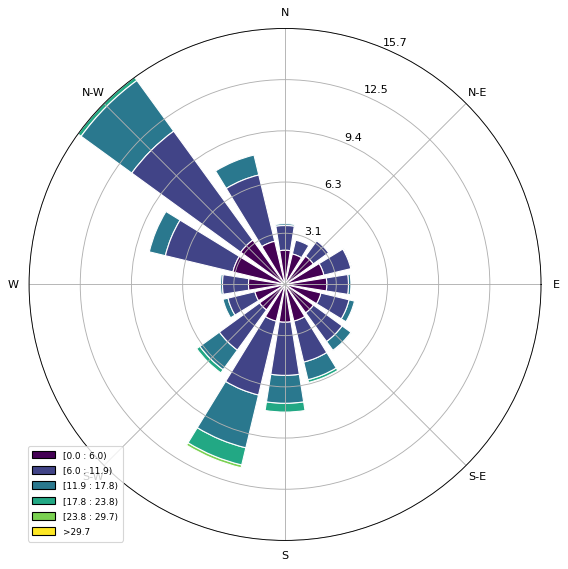

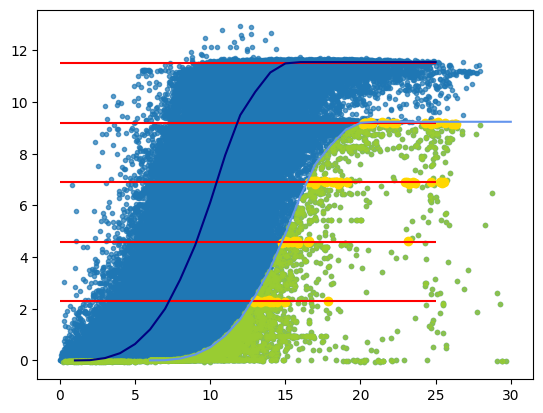

               Production Index  Time
DateTimeIndex                        
2007-10-31             0.888787     0
2007-11-30             0.877057     1
2007-12-31             0.947222     2
2008-01-31             0.882081     3
2008-02-29             1.020533     4
...                         ...   ...
2023-08-31             0.862842   190
2023-09-30             0.863678   191
2023-10-31             0.556750   192
2023-11-30             0.614902   193
2023-12-31             0.961601   194

[195 rows x 2 columns]


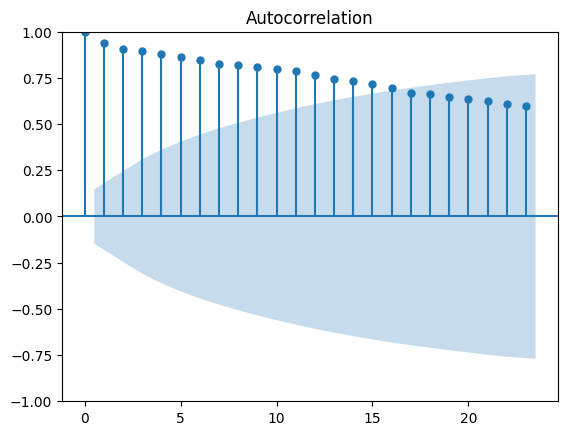

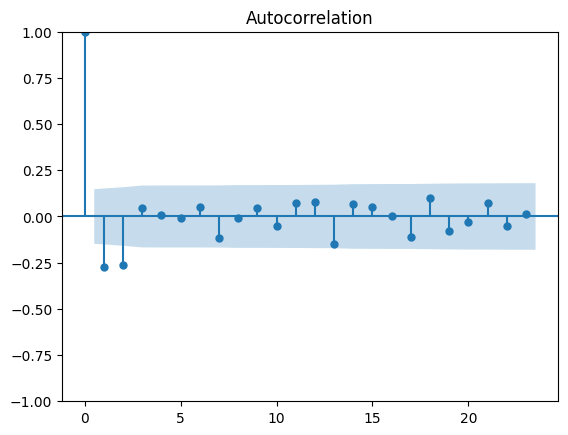

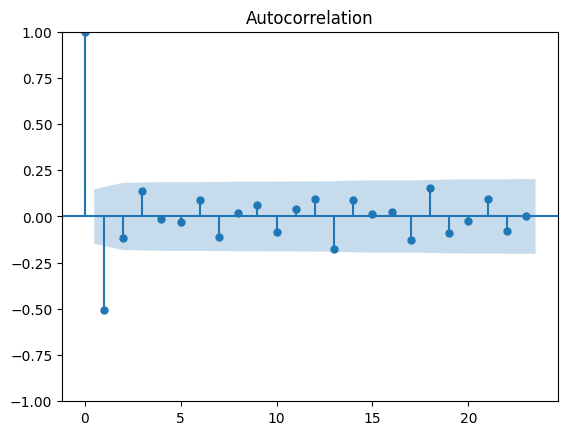

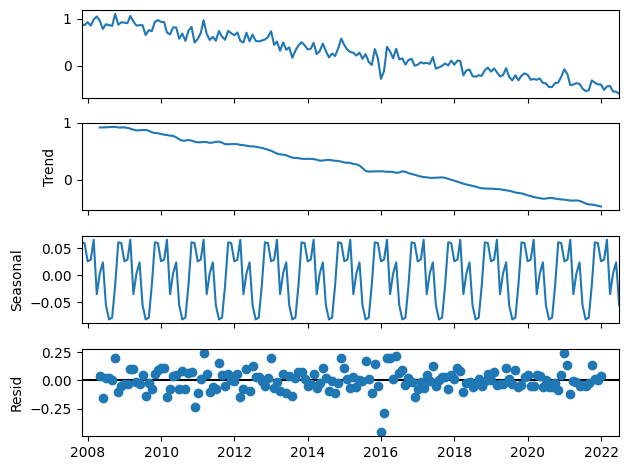

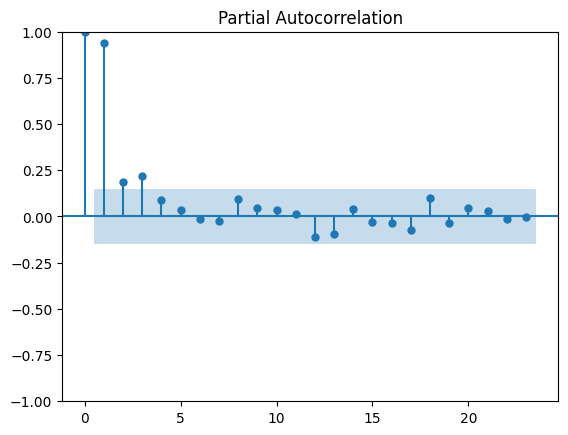

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=3.34 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-151.021, Time=0.15 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-200.483, Time=1.81 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=3.69 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-153.021, Time=0.21 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-159.113, Time=0.19 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-213.721, Time=4.24 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=6.09 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-236.912, Time=2.54 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-235.512, Time=1.87 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=-234.565, Time=3.78 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=-232.777, Time=3.89 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=inf, Time=5.26 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-220.931, Time=1.16 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : 

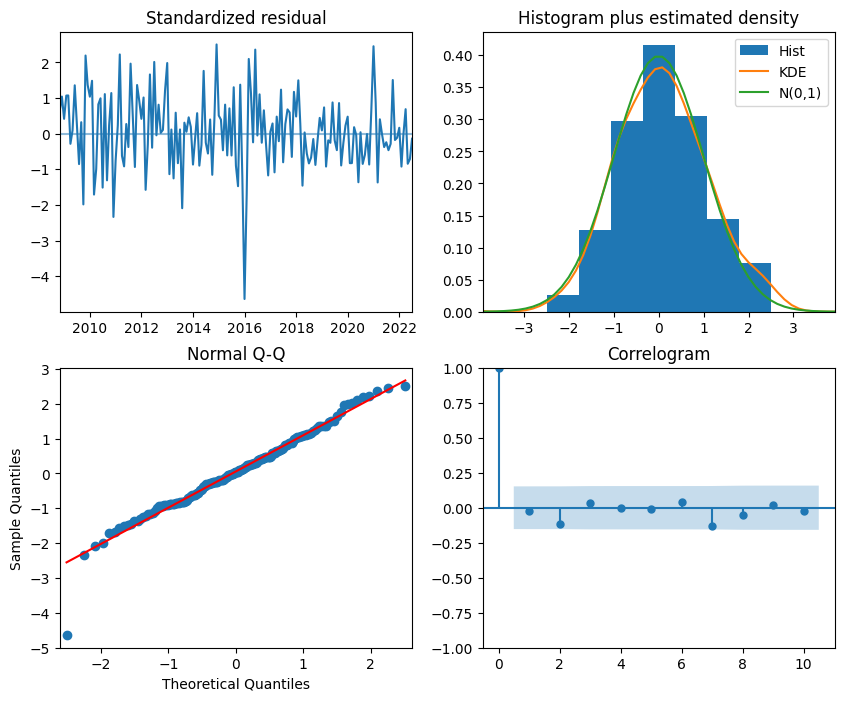

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  177
Model:             SARIMAX(2, 0, 0)x(0, 1, [1], 12)   Log Likelihood                 125.950
Date:                              Sat, 11 May 2024   AIC                           -239.900
Time:                                      09:11:15   BIC                           -221.265
Sample:                                  10-31-2007   HQIC                          -232.336
                                       - 06-30-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2908      0.000   1032.872      0.000       0.290       0.291
Time          -0.03

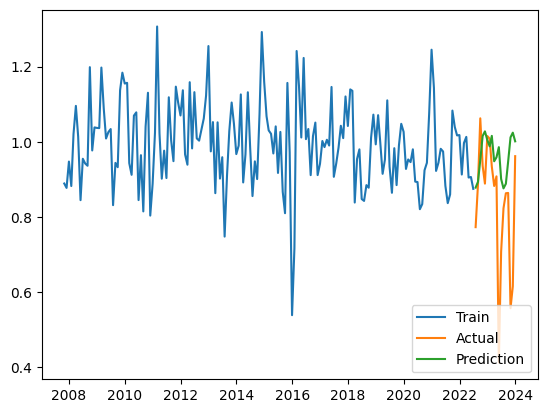

[0.0045997] [[-0.00496221]] [[0.00423718]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.23271808304846847

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.5}
[0.0045997] [[-0.00496221]] [[0.00423718]]
Mean of Residuals -0.04649847248628422
Mean of Residuals -0.04649847248628422


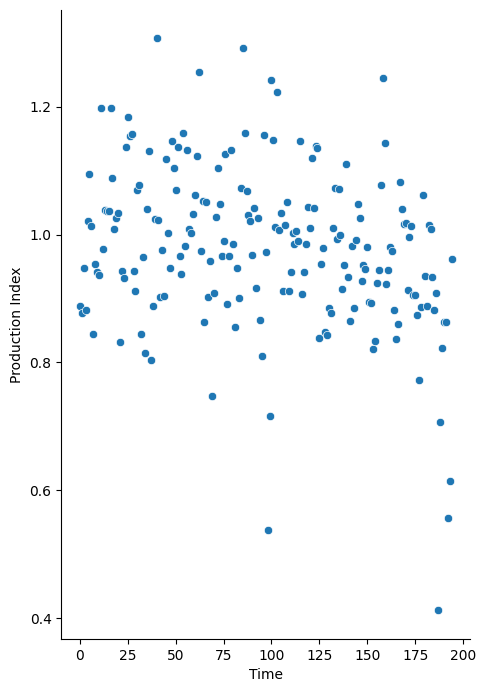

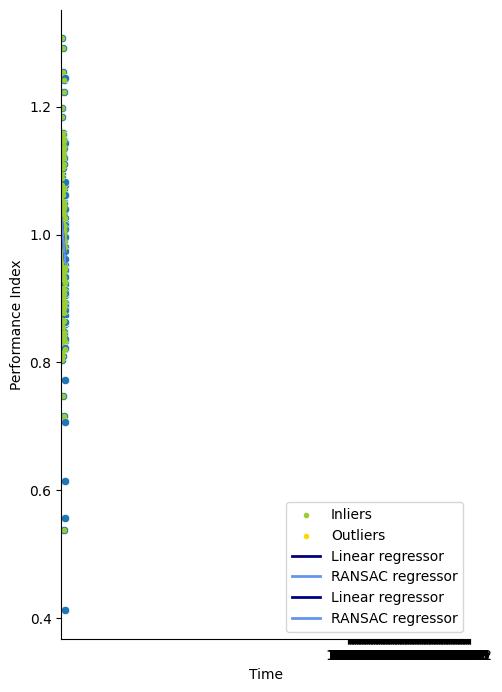

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.64042764] [[-1.62105477]] [[1.65980052]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.64042764] [[-1.62105477]] [[1.65980052]]
[4.2266369] [[-4.19810422]] [[4.25516959]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.189758087114141

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.2266369] [[-4.19810422]] [[4.25516959]]
[2.28999713] [[-2.31769042]] [[2.26230384]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9421.187262809028

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.28999713] [[-2.31769042]] [[2.26230384]]
[5.77690415] [[-5.7559631]] [[5.7978452]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.752194457487269

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.77690415] [[-5.7559631]] [[5.7978452]]
[6.28114745] [[-6.23413298]] [[6.32816192]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.35125708270217637

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.28114745] [[-6.23413298]] [[6.32816192]]
[5.14752932] [[-5.12233788]] [[5.17272077]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -191306211.6433818

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.57585981] [[-4.55066837]] [[4.60105126]]
[2.77935629] [[-2.7841595]] [[2.77455309]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0566800164734453

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.77935629] [[-2.7841595]] [[2.77455309]]
[3.503005] [[-3.47591322]] [[3.53009679]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.578705605602566

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.94813052] [[-1.92103873]] [[1.97522231]]
[5.84413026] [[-5.81905271]] [[5.86920781]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -62.19105718946429

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.84413026] [[-5.81905271]] [[5.86920781]]
[3.83589124] [[-3.88260653]] [[3.78917595]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1582.6968596341746

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.02829887] [[-5.07501416]] [[4.98158358]]
[2.48422732] [[-2.51148441]] [[2.45697023]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.446329497931485

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.05879338] [[-2.08605047]] [[2.03153629]]
[5.66106759] [[-5.67946435]] [[5.64267083]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.75634845443027

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.66106759] [[-5.67946435]] [[5.64267083]]
[3.80735392] [[-3.850095]] [[3.76461284]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.26771519606682

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.80735392] [[-3.850095]] [[3.76461284]]
[5.27264261] [[-5.23944161]] [[5.30584361]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9638.45608415146

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.27264261] [[-5.23944161]] [[5.30584361]]
[1.50491152] [[-1.52191796]] [[1.48790508]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -37.110979236369836

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.50491152] [[-1.52191796]] [[1.48790508]]
[5.90443952] [[-5.87553111]] [[5.93334793]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.822924191731861

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.48500028] [[-1.45609187]] [[1.51390868]]
[2.52865004] [[-2.52303453]] [[2.53426555]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.648533879047546

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.9743945] [[-2.96877899]] [[2.98001001]]
[0.97897967] [[-1.00611188]] [[0.95184746]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.90407260631743

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.70884895] [[-1.73598116]] [[1.68171674]]
[4.7646326] [[-4.7821963]] [[4.74706889]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0656211276208527

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.7646326] [[-4.7821963]] [[4.74706889]]
[5.0111985] [[-5.02748924]] [[4.99490776]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -785.409678315734

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[5.0111985] [[-5.02748924]] [[4.99490776]]
[3.47206848] [[-3.45121756]] [[3.4929194]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5768869180739276

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.47206848] [[-3.45121756]] [[3.4929194]]
[6.2558597] [[-6.25279266]] [[6.25892675]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.139540844978584

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.41653432] [[-6.41346727]] [[6.41960136]]
[4.6258019] [[-4.65958819]] [[4.5920156]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.985983874116644

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.6258019] [[-4.65958819]] [[4.5920156]]
[3.24527664] [[-3.23027364]] [[3.26027963]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.554162533166949

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.59742281] [[-4.58241982]] [[4.6124258]]
[1.48906734] [[-1.5033677]] [[1.47476698]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -336.0678213685966

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.44183794] [[-1.4561383]] [[1.42753758]]
[7.78886766] [[-7.75936477]] [[7.81837055]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2252.595917964783

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.78886766] [[-7.75936477]] [[7.81837055]]
[5.03127249] [[-5.00286726]] [[5.05967772]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -3.204585203861962

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.03127249] [[-5.00286726]] [[5.05967772]]
[2.28621466] [[-2.29994881]] [[2.27248052]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.09672304873013145

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.28621466] [[-2.29994881]] [[2.27248052]]
[4.23994343] [[-4.2044823]] [[4.27540456]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.63897457668583

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.93354381] [[-1.89808268]] [[1.96900494]]
[0.72546575] [[-0.73259334]] [[0.71833816]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -37.43080177709544

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.72546575] [[-0.73259334]] [[0.71833816]]
[3.07906505] [[-3.1218286]] [[3.0363015]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -35.75690864754998

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[3.07906505] [[-3.1218286]] [[3.0363015]]
[1.96681303] [[-1.98060249]] [[1.95302357]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -168.16890820832919

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.96681303] [[-1.98060249]] [[1.95302357]]
[4.5187076] [[-4.54954993]] [[4.48786527]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -8.060499261082827

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.5}
[3.51271028] [[-3.54355261]] [[3.48186795]]
[10.8941846] [[-10.77545702]] [[11.01291218]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.1280044231416038

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[11.1331779] [[-11.01445032]] [[11.25190549]]
[4.79775527] [[-4.78405167]] [[4.81145887]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8257387339334148

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[3.66661242] [[-3.65290882]] [[3.68031602]]
[7.92651127] [[-7.9565472]] [[7.89647533]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3622160698637244

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[8.72565059] [[-8.75568653]] [[8.69561466]]
[1.15896967] [[-1.14907791]] [[1.16886143]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.129788575398104

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.82264794] [[-1.81275618]] [[1.8325397]]
[1.41598225] [[-1.41835289]] [[1.4136116]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -132.34327195012128

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.41598225] [[-1.41835289]] [[1.4136116]]
[4.3968091] [[-4.38662879]] [[4.4069894]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.818489533616292

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.72342987] [[-2.71324956]] [[2.73361018]]
[4.59486151] [[-4.62142386]] [[4.56829916]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.644073996859907

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.59486151] [[-4.62142386]] [[4.56829916]]
[2.87209578] [[-2.86024254]] [[2.88394902]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.373080810885632

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.87209578] [[-2.86024254]] [[2.88394902]]
[10.21328673] [[-10.17244375]] [[10.25412972]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.74284572] [[-4.70200274]] [[4.78368871]]
[3.73453559] [[-3.71678408]] [[3.75228709]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.36857096599424

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.73453559] [[-3.71678408]] [[3.75228709]]
[1.96827189] [[-1.95654147]] [[1.98000231]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -83.1206216561744

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.96827189] [[-1.95654147]] [[1.98000231]]
[4.0642221] [[-4.08398762]] [[4.04445658]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5664267304890322

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.0642221] [[-4.08398762]] [[4.04445658]]
[0.89122937] [[-0.90773615]] [[0.8747226]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.027019699914868

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.89122937] [[-0.90773615]] [[0.8747226]]
[3.2215427] [[-3.20324409]] [[3.23984131]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -822.4070267458974

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.2215427] [[-3.20324409]] [[3.23984131]]
[2.16351889] [[-2.16709026]] [[2.15994753]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -19.958719782547192

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.16351889] [[-2.16709026]] [[2.15994753]]
[3.64452397] [[-3.65171139]] [[3.63733655]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -15.34694832916399

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.68552175] [[-5.69270917]] [[5.67833433]]
[1.10923759] [[-1.10005]] [[1.11842517]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -78.49651384185267

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.10923759] [[-1.10005]] [[1.11842517]]
[2.1108035] [[-2.13064603]] [[2.09096096]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.548674530330852

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.1108035] [[-2.13064603]] [[2.09096096]]
[3.2017691] [[-3.18029297]] [[3.22324523]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -11.356661381906122

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.2017691] [[-3.18029297]] [[3.22324523]]
[1.23789803] [[-1.20122012]] [[1.27457593]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -3.188318099872569

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.23789803] [[-1.20122012]] [[1.27457593]]
[3.15847208] [[-3.20197759]] [[3.11496657]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.4919339832064202

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.15847208] [[-3.20197759]] [[3.11496657]]
[3.45519675] [[-3.46855973]] [[3.44183377]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9691257447037858

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.45519675] [[-3.46855973]] [[3.44183377]]
[11.37960466] [[-11.38767117]] [[11.37153815]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.1760975672780372

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.37960466] [[-11.38767117]] [[11.37153815]]
[1.70694006] [[-1.70601365]] [[1.70786647]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9466359137598546

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.70694006] [[-1.70601365]] [[1.70786647]]
[3.72647746] [[-3.73069998]] [[3.72225494]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.871975914630184

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.72647746] [[-3.73069998]] [[3.72225494]]
[6.84692297] [[-6.8569287]] [[6.83691724]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7592301978590796

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.84692297] [[-6.8569287]] [[6.83691724]]
[3.58482589] [[-3.55286934]] [[3.61678243]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -93.2285855530325

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.46013638] [[-5.42817984]] [[5.49209292]]
[4.50591588] [[-4.47523546]] [[4.53659629]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.702019505345175

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[7.24829933] [[-7.21761891]] [[7.27897974]]
[1.71938136] [[-1.74287661]] [[1.69588611]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.37132249341267

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.71938136] [[-1.74287661]] [[1.69588611]]
[6.33605526] [[-6.38342296]] [[6.28868756]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -42.28260513549576

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.33605526] [[-6.38342296]] [[6.28868756]]
[1.13885848] [[-1.13847533]] [[1.13924163]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.466891787279792

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.13885848] [[-1.13847533]] [[1.13924163]]
[3.81678086] [[-3.77981661]] [[3.8537451]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -17.186367451083793

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.51869789] [[-5.48173364]] [[5.55566214]]
               Production Index  Time
DateTimeIndex                        
2007-10-31             0.888484     0
2007-11-30             0.876736     1
2007-12-31             0.946912     2
2008-01-31             0.881829     3
2008-02-29             1.020403     4
...                         ...   ...
2023-08-31             0.863569   190
2023-09-30             0.863682   191
2023-10-31             0.557605   192
2023-11-30             0.615723   193
2023-12-31             0.961601   194

[195 rows x 2 columns]


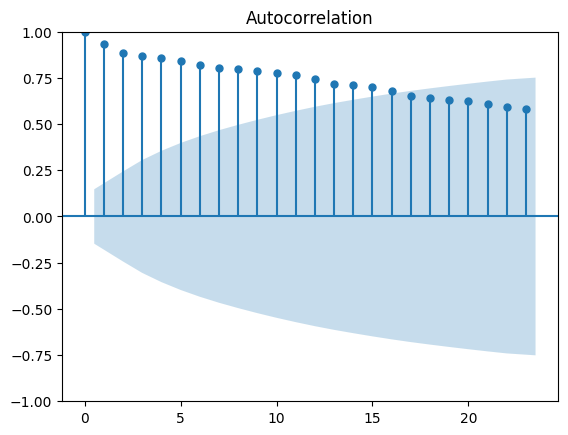

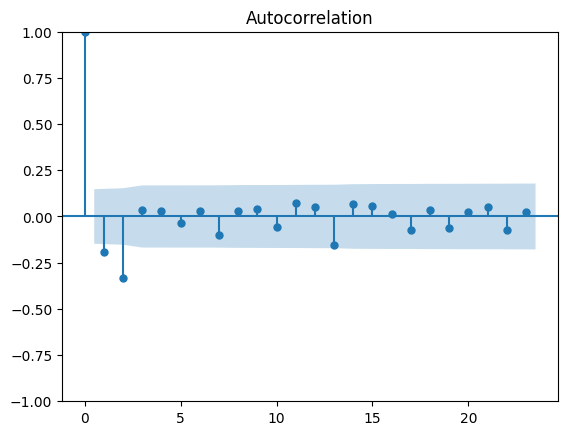

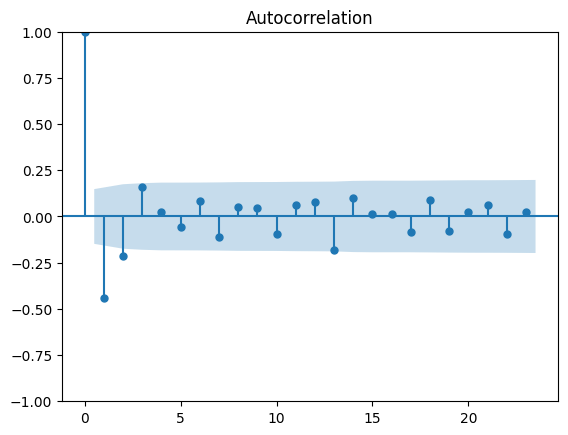

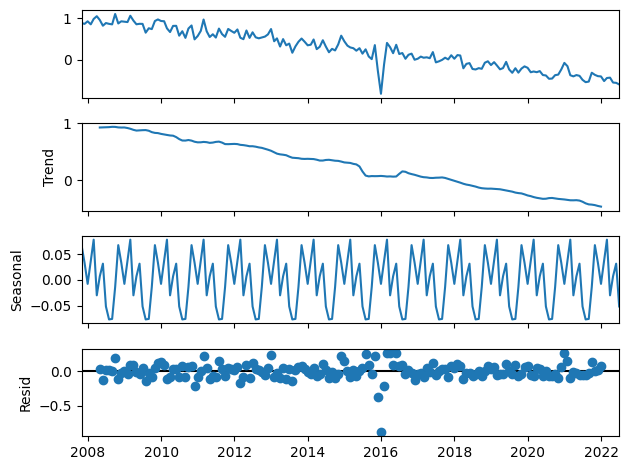

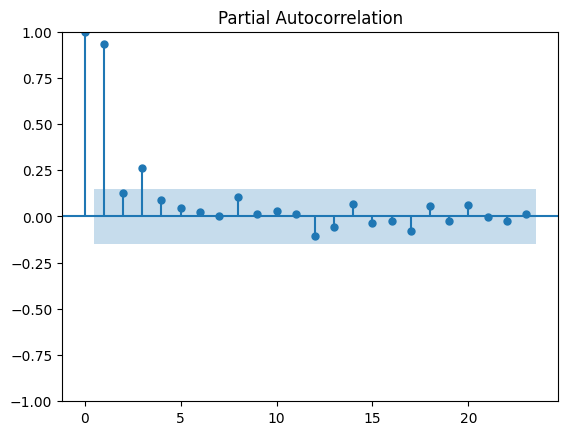

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=5.37 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-72.455, Time=0.12 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-139.444, Time=1.12 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=4.89 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-74.455, Time=0.23 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-95.047, Time=0.30 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-149.151, Time=2.32 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-174.101, Time=10.07 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-172.252, Time=1.34 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=inf, Time=5.24 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=-173.330, Time=3.74 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=inf, Time=4.81 sec
 ARIMA(2,0,0)(2,1,1)[12] intercept   : AIC=-173.503, Time=6.48 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=-162.751, Time=7.36 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AI

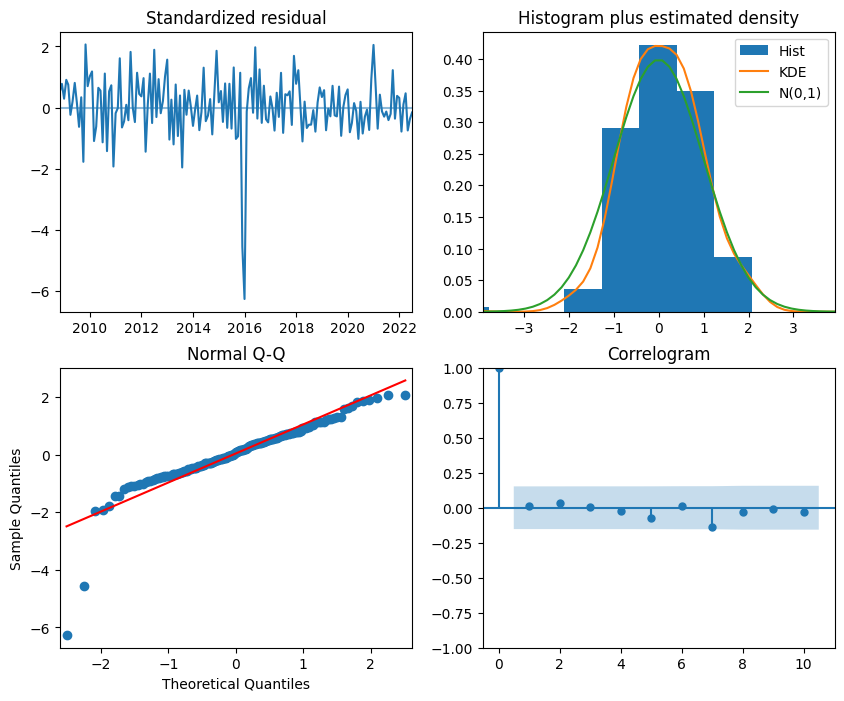

                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  177
Model:             SARIMAX(2, 0, 1)x(2, 1, 1, 12)   Log Likelihood                  97.941
Date:                            Sat, 11 May 2024   AIC                           -179.882
Time:                                    09:15:17   BIC                           -155.035
Sample:                                10-31-2007   HQIC                          -169.796
                                     - 06-30-2022                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0003      0.000     -0.889      0.374      -0.001       0.000
ar.L1          0.0295      0.342   

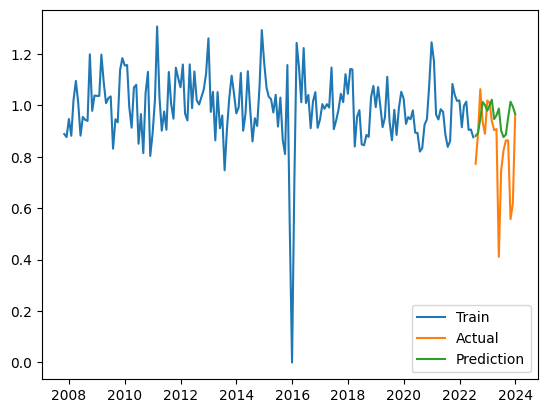

[0.00447928] [[-0.004917]] [[0.00404157]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -0.12626901828992879

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 1.0}
[0.00447928] [[-0.004917]] [[0.00404157]]
Mean of Residuals -0.030993583783152416
Mean of Residuals -0.030993583783152416


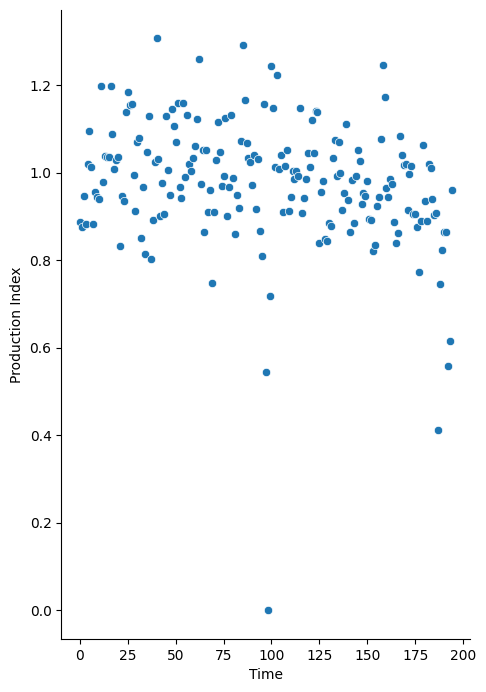

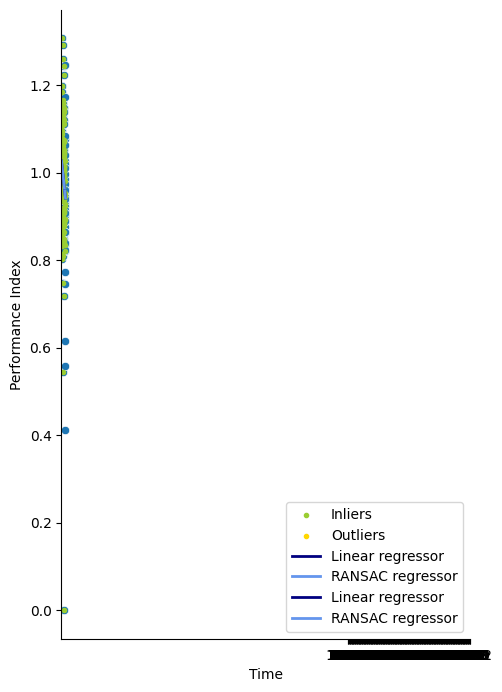

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.63737061] [[-1.6180094]] [[1.65673182]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
135 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
81 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 6.

--------------------------------------------------------------------------------
54 fits failed with the foll

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.63737061] [[-1.6180094]] [[1.65673182]]
[4.23156946] [[-4.20302886]] [[4.26011006]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -7.195759408245219

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[4.23156946] [[-4.20302886]] [[4.26011006]]
[1.59986198] [[-1.62209196]] [[1.57763201]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3737.1140702508455

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.59986198] [[-1.62209196]] [[1.57763201]]
[5.70759626] [[-5.68622265]] [[5.72896986]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.966172877574518

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.70759626] [[-5.68622265]] [[5.72896986]]
[6.26761756] [[-6.2208608]] [[6.31437431]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3425486118901689

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.26761756] [[-6.2208608]] [[6.31437431]]
[5.14506194] [[-5.11991991]] [[5.17020398]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -191165759.51998726

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[4.57370818] [[-4.54856615]] [[4.59885022]]
[2.78730787] [[-2.79194011]] [[2.78267563]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.0663252919203745

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.78730787] [[-2.79194011]] [[2.78267563]]
[3.54422733] [[-3.51726641]] [[3.57118826]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -1.6030167656543157

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.90490355] [[-1.87794263]] [[1.93186447]]
[5.84158758] [[-5.81660567]] [[5.86656948]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -41.68497739060377

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.84158758] [[-5.81660567]] [[5.86656948]]
[2.28461139] [[-2.29496015]] [[2.27426262]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -291.26421173088977

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.28461139] [[-2.29496015]] [[2.27426262]]
[2.18745899] [[-2.21495406]] [[2.15996392]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.400448128352668

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.83824308] [[-1.86573815]] [[1.81074801]]
[5.88538331] [[-5.90384437]] [[5.86692225]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.279401570663522

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.88538331] [[-5.90384437]] [[5.86692225]]
[3.91640286] [[-3.95914394]] [[3.87366178]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.26771519606682

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.91640286] [[-3.95914394]] [[3.87366178]]
[5.43894078] [[-5.40419864]] [[5.47368292]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -9927.409000477946

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.43894078] [[-5.40419864]] [[5.47368292]]
[1.50491152] [[-1.52191796]] [[1.48790508]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -37.110979236369836

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.50491152] [[-1.52191796]] [[1.48790508]]
[5.68722713] [[-5.66236569]] [[5.71208857]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.557423199422676

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.71769584] [[-1.6928344]] [[1.74255729]]
[2.51662991] [[-2.51083576]] [[2.52242405]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.354793254230744

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.95317886] [[-2.94738471]] [[2.958973]]
[0.91314239] [[-0.94133606]] [[0.88494871]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.620077211323192

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.73162783] [[-1.7598215]] [[1.70343415]]
[4.68309473] [[-4.70023314]] [[4.66595633]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.9559834683223098

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.68309473] [[-4.70023314]] [[4.66595633]]
[5.10486911] [[-5.12299419]] [[5.08674404]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -926.5988316854376

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.10486911] [[-5.12299419]] [[5.08674404]]
[3.54668344] [[-3.52583252]] [[3.56753436]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5768869180739276

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.54668344] [[-3.52583252]] [[3.56753436]]
[6.25637167] [[-6.2532966]] [[6.25944673]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.327797342181693

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[6.41377273] [[-6.41069766]] [[6.4168478]]
[4.50597048] [[-4.53865638]] [[4.47328457]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.4250312121591966

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.50597048] [[-4.53865638]] [[4.47328457]]
[3.19894198] [[-3.18364949]] [[3.21423448]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.838351803934193

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.55659125] [[-4.54129875]] [[4.57188374]]
[1.39753992] [[-1.41491098]] [[1.38016885]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -192.0190228721761

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[1.52284157] [[-1.54021263]] [[1.5054705]]
[7.53355637] [[-7.50450456]] [[7.56260818]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2270.9428579042496

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.53355637] [[-7.50450456]] [[7.56260818]]
[5.21299511] [[-5.18316216]] [[5.24282805]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -3.870444566233833

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.21299511] [[-5.18316216]] [[5.24282805]]
[2.31408383] [[-2.32847164]] [[2.29969601]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.09995318769397502

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.31408383] [[-2.32847164]] [[2.29969601]]
[4.14718646] [[-4.1138639]] [[4.18050902]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.545741123779364

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.88160545] [[-1.84828289]] [[1.91492801]]
[0.72291285] [[-0.72998661]] [[0.71583909]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -34.568417952858155

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.72291285] [[-0.72998661]] [[0.71583909]]
[3.08128984] [[-3.12418634]] [[3.03839334]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -31.43144316450924

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[3.08128984] [[-3.12418634]] [[3.03839334]]
[1.89409746] [[-1.90879543]] [[1.87939948]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -165.59736089570418

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.89409746] [[-1.90879543]] [[1.87939948]]
[3.42777204] [[-3.57547303]] [[3.28007106]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=1.0)

 The best score across ALL searched params:
 -5.276243279738724

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 1.0}
[3.42777204] [[-3.57547303]] [[3.28007106]]
[11.88523467] [[-11.75272576]] [[12.01774358]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.6643119842607363

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[12.14153847] [[-12.00902956]] [[12.27404738]]
[4.73027532] [[-4.7166098]] [[4.74394084]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8190164783175551

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[3.59829653] [[-3.58463101]] [[3.61196205]]
[7.89716828] [[-7.92733391]] [[7.86700266]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.4283139860293674

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.89716828] [[-7.92733391]] [[7.86700266]]
[1.12845927] [[-1.11827767]] [[1.13864087]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.176689074225388

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.80278468] [[-1.79260308]] [[1.81296627]]
[1.48792319] [[-1.49133576]] [[1.48451063]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -177.13376781487744

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.48792319] [[-1.49133576]] [[1.48451063]]
[4.38436806] [[-4.37439014]] [[4.39434597]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.544174517075251

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.71839416] [[-2.70841624]] [[2.72837207]]
[4.59486151] [[-4.62142386]] [[4.56829916]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.644073996859907

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.59486151] [[-4.62142386]] [[4.56829916]]
[2.78578087] [[-2.77477307]] [[2.79678867]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -39.29722435307156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.78578087] [[-2.77477307]] [[2.79678867]]
[10.18030917] [[-10.13987171]] [[10.22074663]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.71476215] [[-4.67432468]] [[4.75519961]]
[3.80266686] [[-3.78433235]] [[3.82100137]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.2369309581418595

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.80266686] [[-3.78433235]] [[3.82100137]]
[1.95864174] [[-1.94745553]] [[1.96982795]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -89.20403102327307

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.95864174] [[-1.94745553]] [[1.96982795]]
[3.97534723] [[-3.99652343]] [[3.95417103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -41.56242878310178

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.97534723] [[-3.99652343]] [[3.95417103]]
[0.8926871] [[-0.90919173]] [[0.87618247]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -12.751626186495308

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.8926871] [[-0.90919173]] [[0.87618247]]
[3.406205] [[-3.38665101]] [[3.42575898]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -771.8438452468465

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.406205] [[-3.38665101]] [[3.42575898]]
[2.15909157] [[-2.16249539]] [[2.15568775]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -19.564307143975917

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.15909157] [[-2.16249539]] [[2.15568775]]
[3.58866877] [[-3.59546324]] [[3.5818743]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -13.750185534970512

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[5.6106436] [[-5.61743807]] [[5.60384913]]
[1.11411959] [[-1.1049304]] [[1.12330877]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -80.78792173506922

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.11411959] [[-1.1049304]] [[1.12330877]]
[2.11136277] [[-2.13130467]] [[2.09142087]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.583304067997138

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11136277] [[-2.13130467]] [[2.09142087]]
[3.1977906] [[-3.1763089]] [[3.2192723]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.625)

 The best score across ALL searched params:
 -11.358575520890767

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.625}
[3.1977906] [[-3.1763089]] [[3.2192723]]
[1.23662514] [[-1.2002029]] [[1.27304738]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -2.9034358678911603

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[1.23662514] [[-1.2002029]] [[1.27304738]]
[2.4917321] [[-2.53198036]] [[2.45148385]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -0.9744846196576713

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.4917321] [[-2.53198036]] [[2.45148385]]
[3.43682754] [[-3.45068286]] [[3.42297222]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9252332935469667

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.43682754] [[-3.45068286]] [[3.42297222]]
[11.45436116] [[-11.46384867]] [[11.44487364]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.184951504632361

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[11.45436116] [[-11.46384867]] [[11.44487364]]
[1.7071391] [[-1.70628909]] [[1.70798911]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9773265061679552

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.7071391] [[-1.70628909]] [[1.70798911]]
[3.72515773] [[-3.72939684]] [[3.72091861]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -29.418151307442646

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.72515773] [[-3.72939684]] [[3.72091861]]
[6.84524097] [[-6.85532667]] [[6.83515526]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.7730037863159631

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[6.84524097] [[-6.85532667]] [[6.83515526]]
[3.49734543] [[-3.46448167]] [[3.53020919]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -68.66292859992939

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.30819729] [[-5.27533352]] [[5.34106105]]
[4.45546653] [[-4.42475012]] [[4.48618293]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -4.729291026516575

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.5}
[7.18524925] [[-7.15453285]] [[7.21596566]]
[1.6042231] [[-1.62756254]] [[1.58088367]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.812798397979736

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.6042231] [[-1.62756254]] [[1.58088367]]
[6.21906677] [[-6.26519399]] [[6.17293954]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -33.95354889713446

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[6.21906677] [[-6.26519399]] [[6.17293954]]
[1.13809318] [[-1.13787963]] [[1.13830673]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -38.402453467080505

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.13809318] [[-1.13787963]] [[1.13830673]]
[3.8165894] [[-3.77968207]] [[3.85349673]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -16.979851898176147

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[5.51579055] [[-5.47888322]] [[5.55269788]]
               Production Index  Time
DateTimeIndex                        
2008-10-31             0.976796     0
2008-11-30             1.038225     1
2008-12-31             1.036845     2
2009-01-31             1.036283     3
2009-02-28             1.197555     4
2009-03-31             1.088969     5
2009-04-30             1.008603     6
2009-05-31             1.025756     7
2009-06-30             1.033818     8
2009-07-31             0.831132     9
2009-08-31             0.943769    10
2009-09-30             0.932201    11
2009-10-31             1.137202    12
2009-11-30             1.

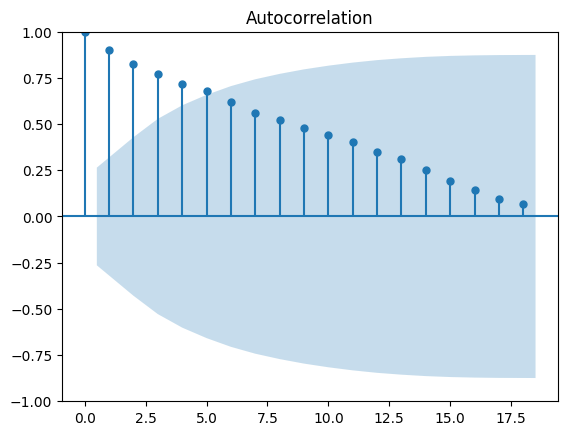

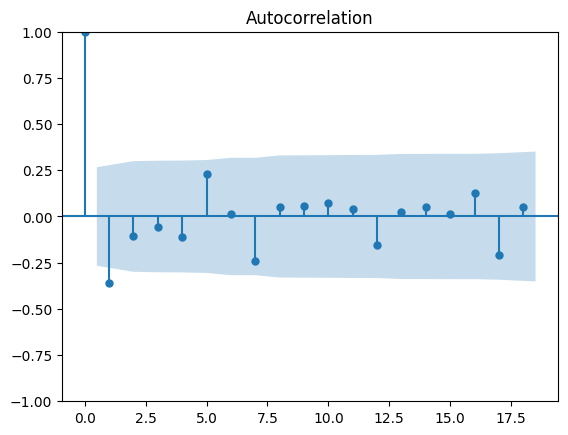

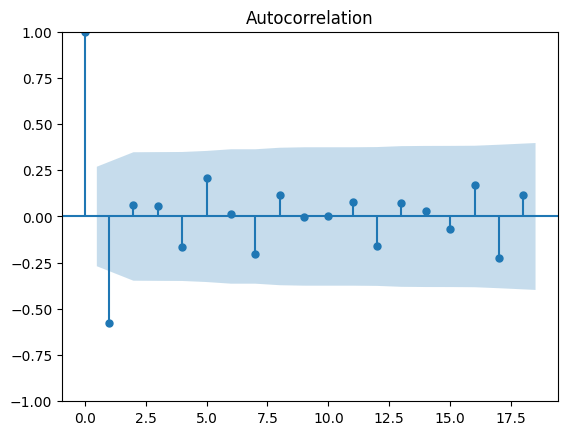

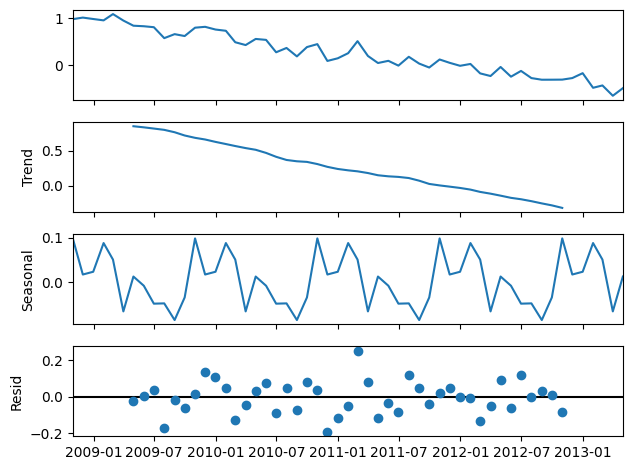

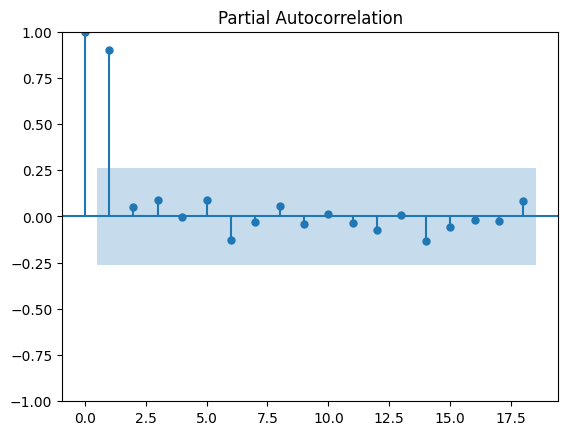

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.12 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-24.646, Time=0.09 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-37.580, Time=1.45 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.11 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-26.646, Time=0.09 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-23.016, Time=0.08 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-44.018, Time=1.86 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-42.055, Time=3.32 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-41.817, Time=0.90 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-45.944, Time=1.39 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-39.372, Time=0.51 sec
 ARIMA(0,0,0)(2,1,1)[12] intercept   : AIC=-43.790, Time=1.48 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.88 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-44.075, Time=3.14 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-4

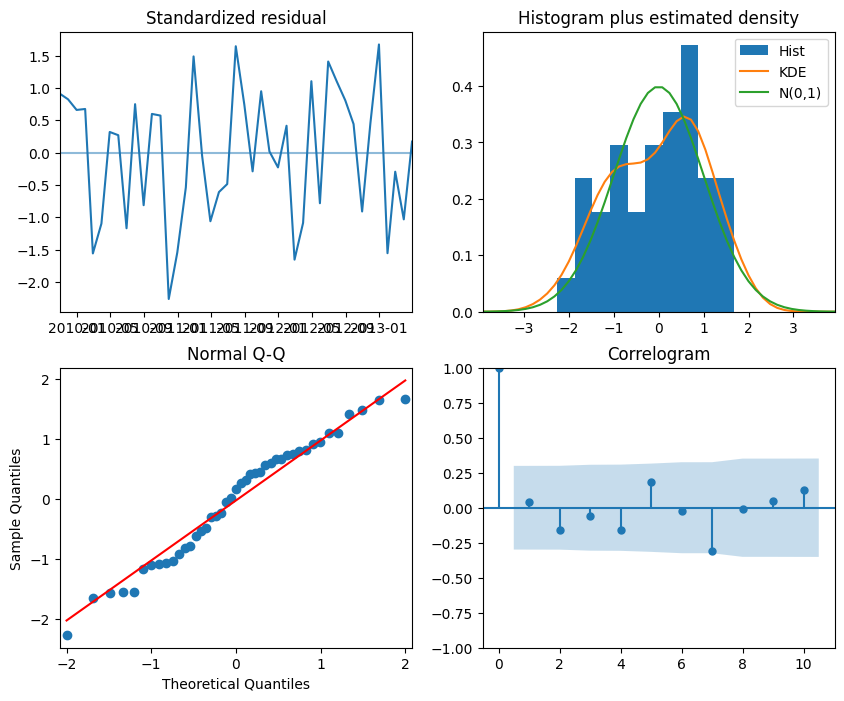

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                   55
Model:             SARIMAX(2, 1, 0, 12)   Log Likelihood                  27.953
Date:                  Sat, 11 May 2024   AIC                            -47.906
Time:                          09:16:14   BIC                            -40.861
Sample:                      10-31-2008   HQIC                           -45.308
                           - 04-30-2013                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0006      0.001      0.746      0.456      -0.001       0.002
ar.S.L12      -0.9886      0.224     -4.418      0.000      -1.427      -0.550
ar.S.L24      -0.6593      0.190    

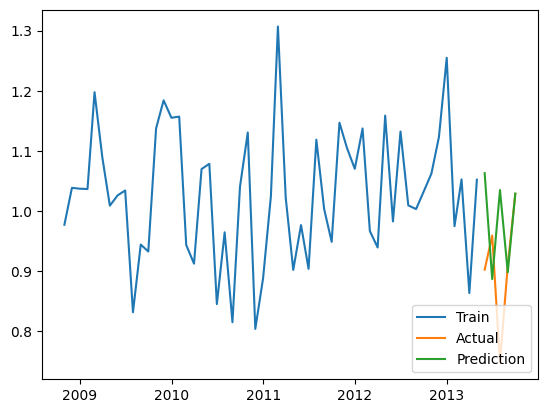

[0.02689116] [[-0.02672731]] [[0.02705501]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.09465119506991475

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.02689116] [[-0.02672731]] [[0.02705501]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

Mean of Residuals -0.03514013709211134
Mean of Residuals -0.03514013709211134


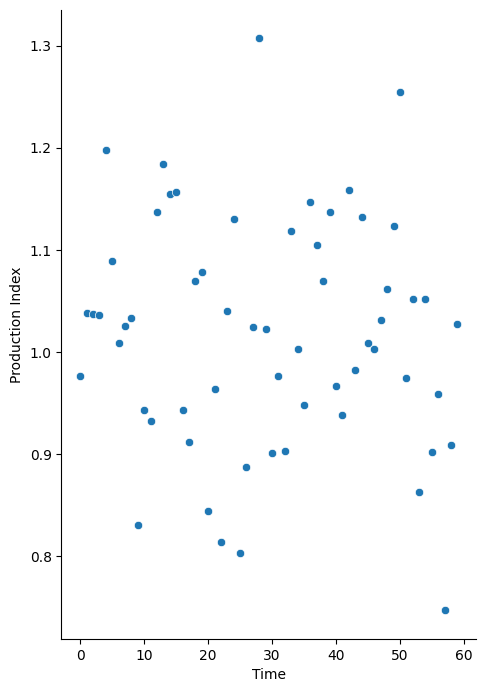

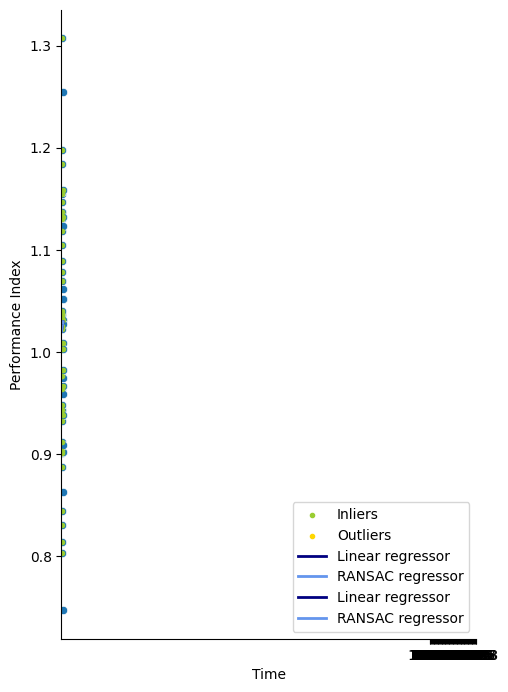

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Valsneset
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2021-01-20 20:00:00  25.161673
2022-01-16 20:00:00  22.348408
2022-01-18 19:00:00  20.785282
2022-01-18 20:00:00  20.171734
2023-08-08 22:00:00  24.693987

[193355 rows x 1 columns]
##################Ytre Vikna###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2013-06-29 13:00:00   6.159103  285.973297  100893.843750         0.000036
2013-06-29 14:00:00   5.061897  285.685760  100945.984375         0.000031
2013-06-29 15:00:00   4.892215  285.532684  100945.984375         0.000028
2013-06-29 16:00:00   3.095226  285.533142  101038.945312         0.000027
2013-06-29 17:00:00   3.2808

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.452833e+06
dtype: float64
            Observasjoner tot prod  Observasjoner valid prod  \
Ytre Vikna                  192840                     92099   

            Missing values prod  Negative values prod  Zero values prod  \
Ytre Vikna                    0                     0              3784   

            Prod over capacity  Observasjoner df_windpowerlib  \
Ytre Vikna                   0                          92099   

            Missing values wind_peed  Missing values temperature  \
Ytre Vikna                       NaN                         NaN   

            Missing values pressure  Missing values roughness_length  \
Ytre Vikna                      NaN                              NaN   

            Observasjoner sim  Zero values sim  
Ytre Vikna              92099              955  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

            Ytre Vikna
2002-12-31         NaN
2003-12-31         NaN
2004-12-31         NaN
2005-12-31         NaN
2006-12-31         NaN
2007-12-31         NaN
2008-12-31         NaN
2009-12-31         NaN
2010-12-31         NaN
2011-12-31         NaN
2012-12-31         NaN
2013-12-31    0.584138
2014-12-31    0.410959
2015-12-31    0.045662
2016-12-31    0.182149
2017-12-31    0.102740
2018-12-31    0.136986
2019-12-31    0.136986
2020-12-31    0.079690
2021-12-31    0.331050
2022-12-31    0.228311
2023-12-31    0.159817 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    1.449382e+06
dtype: float64


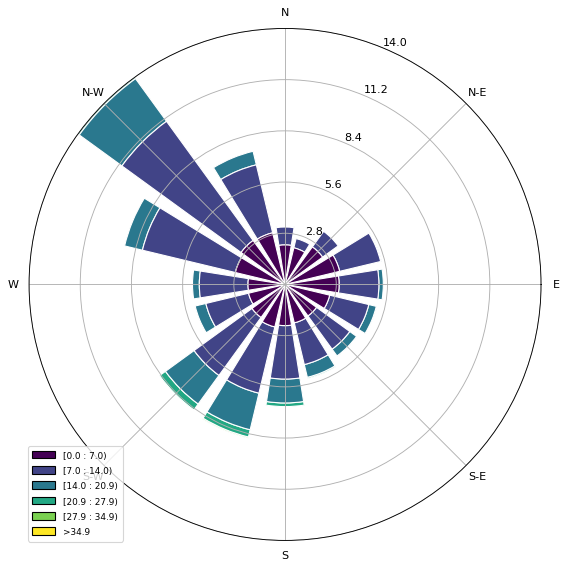

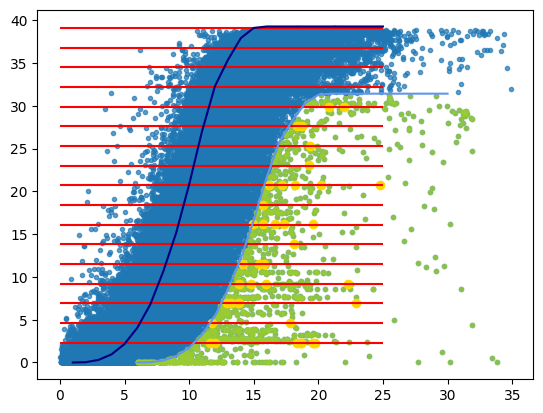

               Production Index  Time
DateTimeIndex                        
2013-06-30             0.637847     0
2013-07-31             0.768982     1
2013-08-31             0.756491     2
2013-09-30             0.760507     3
2013-10-31             0.816601     4
...                         ...   ...
2023-08-31             0.784530   122
2023-09-30             0.701541   123
2023-10-31             0.742167   124
2023-11-30             0.722693   125
2023-12-31             0.855893   126

[127 rows x 2 columns]


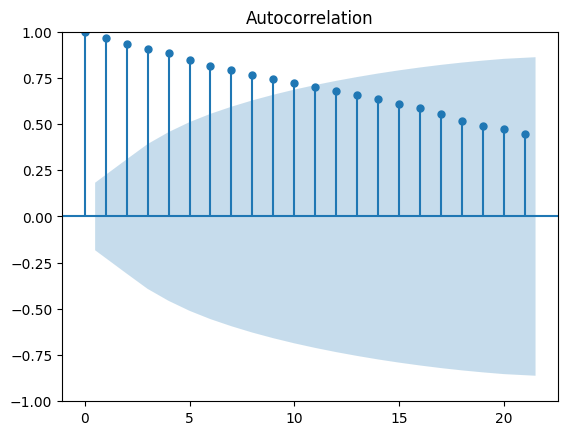

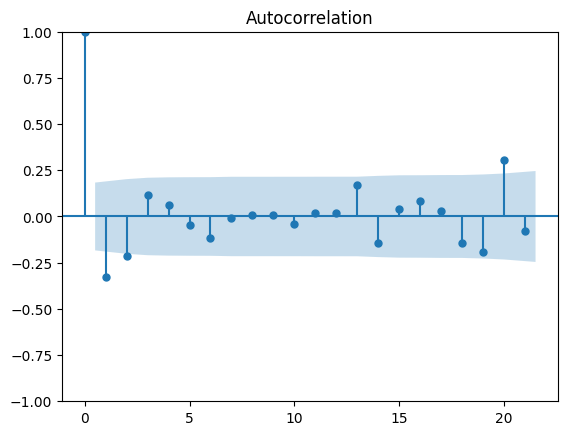

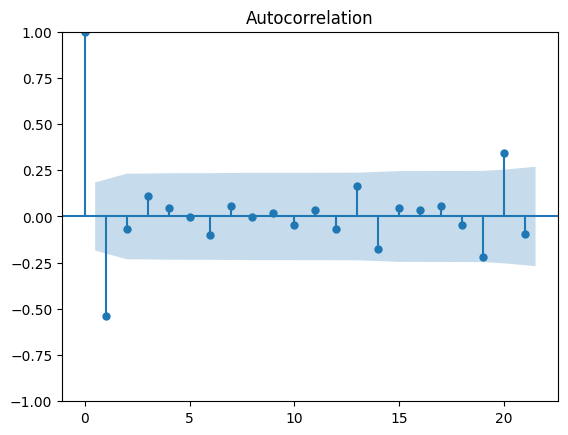

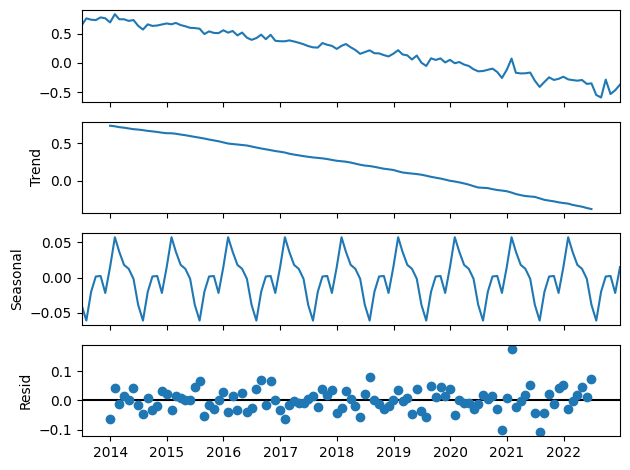

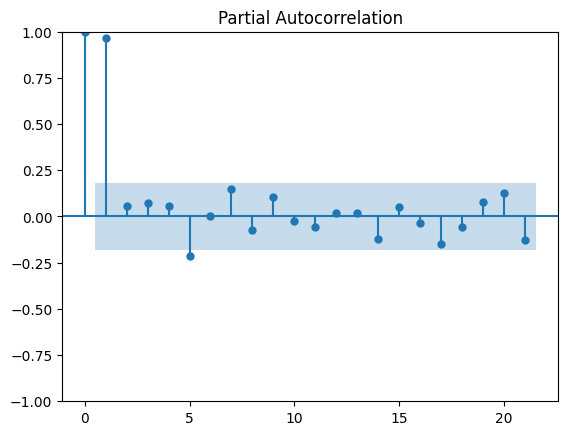

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-274.451, Time=5.63 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-258.893, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-280.425, Time=2.30 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-275.739, Time=0.75 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-260.892, Time=0.13 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-257.078, Time=0.19 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-278.029, Time=2.02 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-276.797, Time=2.04 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-276.360, Time=1.52 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-276.782, Time=4.04 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-282.110, Time=0.52 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-280.126, Time=1.26 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-279.783, Time=1.36 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-278.222, Time=2.83 sec
 ARIMA(0,0,0)(2,1,1

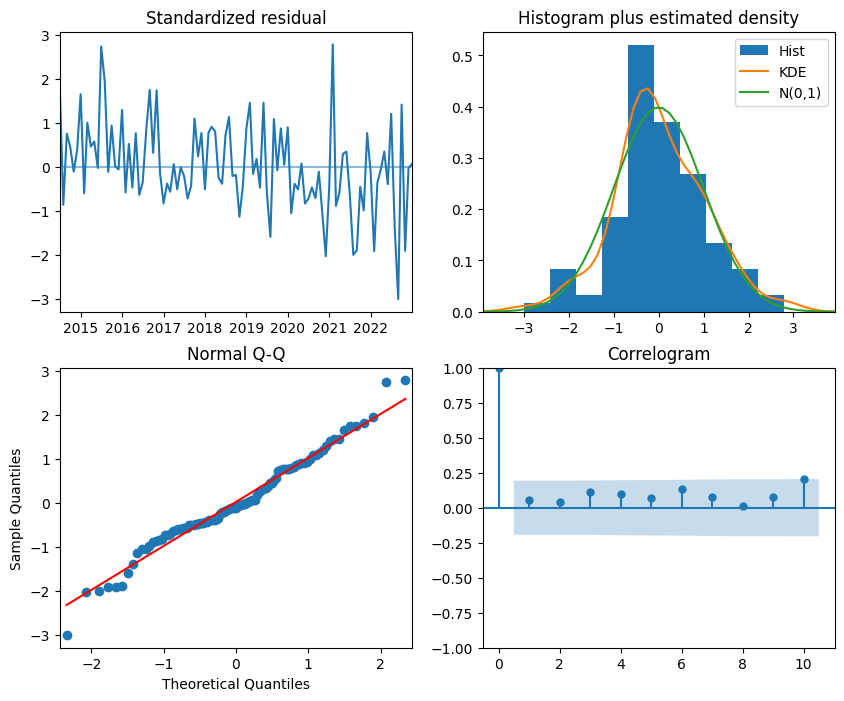

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                  115
Model:             SARIMAX(1, 1, 0, 12)   Log Likelihood                 145.055
Date:                  Sat, 11 May 2024   AIC                           -284.110
Time:                          09:17:13   BIC                           -276.206
Sample:                      06-30-2013   HQIC                          -280.909
                           - 12-31-2022                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0005      0.000     -1.672      0.095      -0.001    9.29e-05
ar.S.L12      -0.5310      0.073     -7.257      0.000      -0.674      -0.388
sigma2         0.0034      0.000    

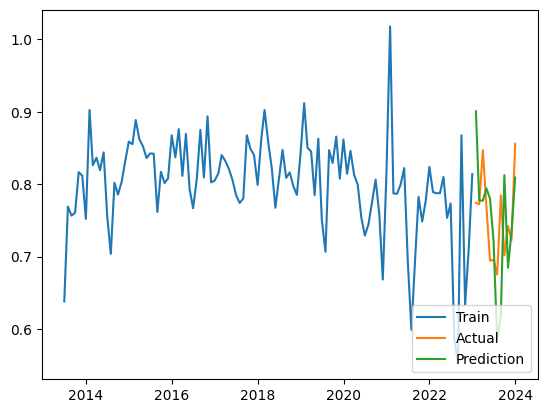

[0.00487316] [[-0.00515692]] [[0.0045894]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5625472817474486

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00487316] [[-0.00515692]] [[0.0045894]]
Mean of Residuals -0.04154025714986531
Mean of Residuals -0.04154025714986531


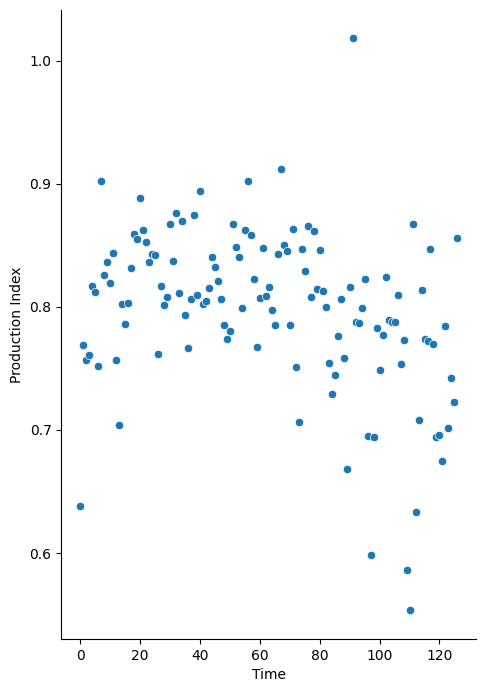

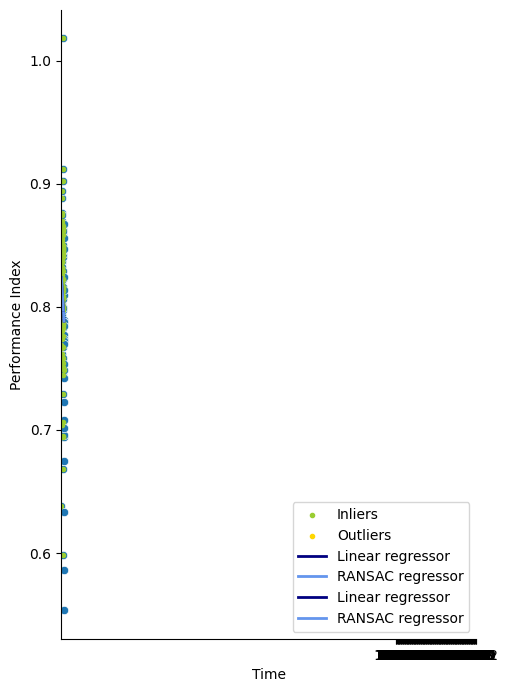

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.96287017] [[-1.96917412]] [[1.95656622]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.04130624490021

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96287017] [[-1.96917412]] [[1.95656622]]
[0.94453014] [[-0.9461097]] [[0.94295058]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.069554378429337

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.94453014] [[-0.9461097]] [[0.94295058]]
[2.62390334] [[-2.62669308]] [[2.6211136]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.405434052631149

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.62390334] [[-2.62669308]] [[2.6211136]]
[0.97095733] [[-0.97269321]] [[0.96922144]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.369423330284548

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.97095733] [[-0.97269321]] [[0.96922144]]
[1.69872762] [[-1.69568126]] [[1.70177399]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.50253130590038

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.69872762] [[-1.69568126]] [[1.70177399]]
[0.84922547] [[-0.83933614]] [[0.8591148]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -14.66445684963029

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84922547] [[-0.83933614]] [[0.8591148]]
[0.65208394] [[-0.65139598]] [[0.65277189]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.971674126569857

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.65208394] [[-0.65139598]] [[0.65277189]]
[0.32159139] [[-0.32687428]] [[0.31630849]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -39.9878603016668

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.32159139] [[-0.32687428]] [[0.31630849]]
[1.11935696] [[-1.1194005]] [[1.11931342]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.02531493560413

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.11935696] [[-1.1194005]] [[1.11931342]]
[0.3786794] [[-0.37144038]] [[0.38591842]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.75712932676152

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.3786794] [[-0.37144038]] [[0.38591842]]
[1.2005002] [[-1.20662715]] [[1.19437325]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.946589258293464

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.2005002] [[-1.20662715]] [[1.19437325]]
[1.63867696] [[-1.65077743]] [[1.6265765]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.694466084531893

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.63867696] [[-1.65077743]] [[1.6265765]]
[2.01595958] [[-2.00897805]] [[2.02294112]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.807265675140627

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.01595958] [[-2.00897805]] [[2.02294112]]
[1.34043204] [[-1.34895532]] [[1.33190877]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -179.77552163549532

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.34043204] [[-1.34895532]] [[1.33190877]]
[2.8632163] [[-2.88118675]] [[2.84524585]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8694011715462227

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.8632163] [[-2.88118675]] [[2.84524585]]
[0.92490596] [[-0.92882471]] [[0.92098722]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.527826634326234

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.92490596] [[-0.92882471]] [[0.92098722]]
[1.99435489] [[-1.99992232]] [[1.98878745]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.6251819816864757

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.99435489] [[-1.99992232]] [[1.98878745]]
[1.68135515] [[-1.68081477]] [[1.68189552]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1437.566145859772

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.68135515] [[-1.68081477]] [[1.68189552]]
[4.82101373] [[-4.78152224]] [[4.86050523]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.82101373] [[-4.78152224]] [[4.86050523]]
[1.10342795] [[-1.09571169]] [[1.11114421]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -276.57641964262956

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.10342795] [[-1.09571169]] [[1.11114421]]
[1.42676271] [[-1.43604887]] [[1.41747654]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.481448985064087

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.42676271] [[-1.43604887]] [[1.41747654]]
[2.0084259] [[-2.00774576]] [[2.00910604]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.363020219032586

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.0084259] [[-2.00774576]] [[2.00910604]]
[1.58516098] [[-1.59759053]] [[1.57273142]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8104572420365663

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58516098] [[-1.59759053]] [[1.57273142]]
[1.47569489] [[-1.47381642]] [[1.47757337]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4847.157942023705

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47569489] [[-1.47381642]] [[1.47757337]]
[0.99851822] [[-0.98080061]] [[1.01623583]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -49.99789932072663

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.99851822] [[-0.98080061]] [[1.01623583]]
[0.78335674] [[-0.78368317]] [[0.78303032]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8557817979362428

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.78335674] [[-0.78368317]] [[0.78303032]]
[0.93519705] [[-0.93295]] [[0.9374441]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -123.38504495127422

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.93519705] [[-0.93295]] [[0.9374441]]
[0.7529109] [[-0.7685968]] [[0.737225]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.9400359389612944

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.7529109] [[-0.7685968]] [[0.737225]]
[0.66164204] [[-0.6561895]] [[0.66709459]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.4773858018265433

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.66164204] [[-0.6561895]] [[0.66709459]]
[1.64977805] [[-1.65267118]] [[1.64688492]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -16.380082025518938

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.64977805] [[-1.65267118]] [[1.64688492]]
[1.46928449] [[-1.48999538]] [[1.44857361]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -70.92459633625572

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.46928449] [[-1.48999538]] [[1.44857361]]
[4.30961433] [[-4.29284928]] [[4.32637939]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -123.35670812842382

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.30961433] [[-4.29284928]] [[4.32637939]]
[1.04993661] [[-1.02553425]] [[1.07433896]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -216.06483306808292

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.04993661] [[-1.02553425]] [[1.07433896]]
[1.35021991] [[-1.33523099]] [[1.36520883]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -50.41502122382529

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.35021991] [[-1.33523099]] [[1.36520883]]
[0.51738321] [[-0.52203259]] [[0.51273383]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.034318100494774

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.51738321] [[-0.52203259]] [[0.51273383]]
[1.52573917] [[-1.53302117]] [[1.51845718]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -512.722844839346

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.52573917] [[-1.53302117]] [[1.51845718]]
[7.08254882] [[-7.06790138]] [[7.09719626]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -546.5962200478208

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.08254882] [[-7.06790138]] [[7.09719626]]
[1.04407641] [[-1.02504971]] [[1.0631031]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -77.00218042061641

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.04407641] [[-1.02504971]] [[1.0631031]]
[3.14821538] [[-3.15164538]] [[3.14478538]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.479387468510744

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.14821538] [[-3.15164538]] [[3.14478538]]
[1.80639509] [[-1.81013435]] [[1.80265582]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.3103608047860194

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96999391] [[-1.97373317]] [[1.96625465]]
[1.47026702] [[-1.4656616]] [[1.47487244]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -496.9140384717002

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47026702] [[-1.4656616]] [[1.47487244]]
[2.69262274] [[-2.67780298]] [[2.7074425]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.011445800864207

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.60977984] [[-2.59496008]] [[2.6245996]]
               Production Index  Time
DateTimeIndex                        
2013-06-30             0.637847     0
2013-07-31             0.768982     1
2013-08-31             0.756491     2
2013-09-30             0.760507     3
2013-10-31             0.816601     4
...                         ...   ...
2023-08-31             0.784530   122
2023-09-30             0.701541   123
2023-10-31             0.742167   124
2023-11-30             0.724259   125
2023-12-31             0.855893   126

[127 rows x 2 columns]


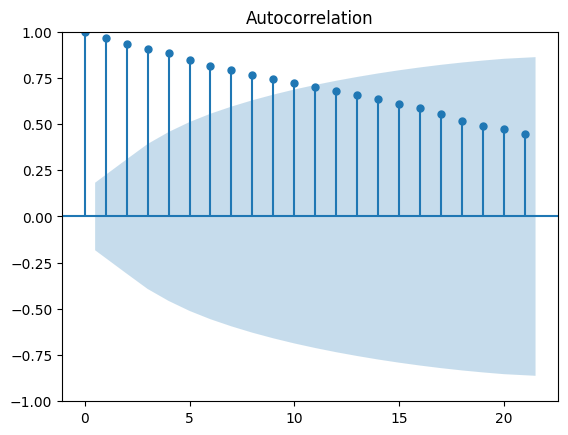

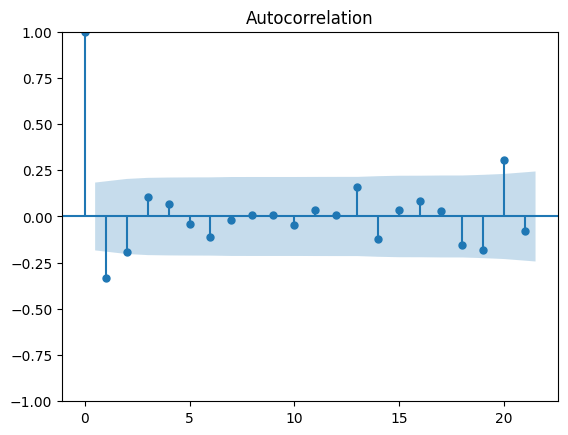

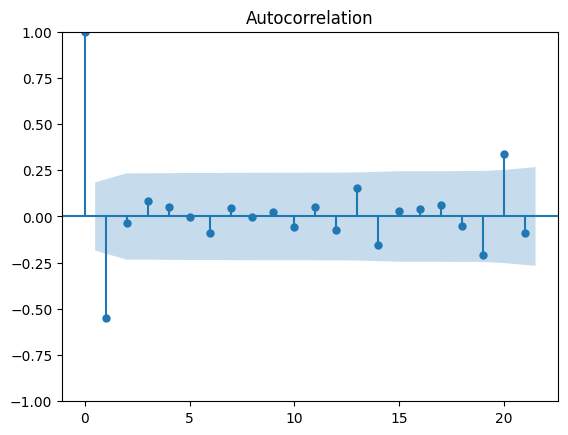

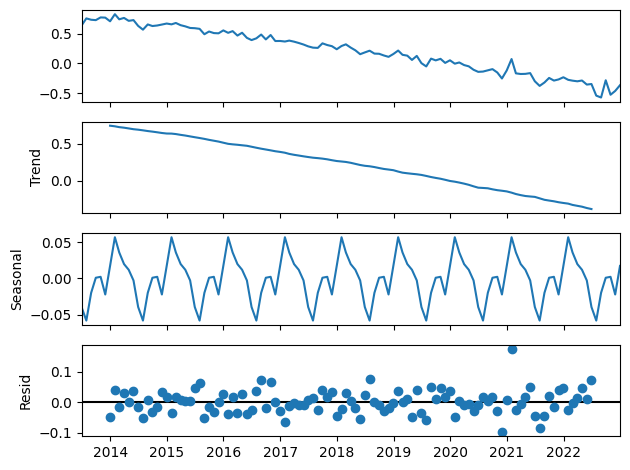

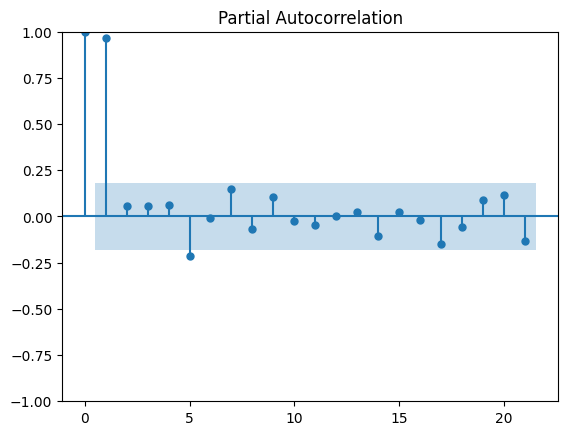

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-279.168, Time=2.34 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-262.419, Time=0.14 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-284.216, Time=1.26 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-280.579, Time=1.11 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-264.419, Time=0.16 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-260.800, Time=0.11 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-281.854, Time=1.78 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-282.113, Time=2.59 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-280.634, Time=1.43 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-280.670, Time=3.84 sec
 ARIMA(0,0,0)(1,1,0)[12] intercept   : AIC=-286.076, Time=1.02 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-284.150, Time=1.62 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=-282.187, Time=0.98 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=-282.501, Time=5.80 sec
 ARIMA(0,0,0)(2,1,1

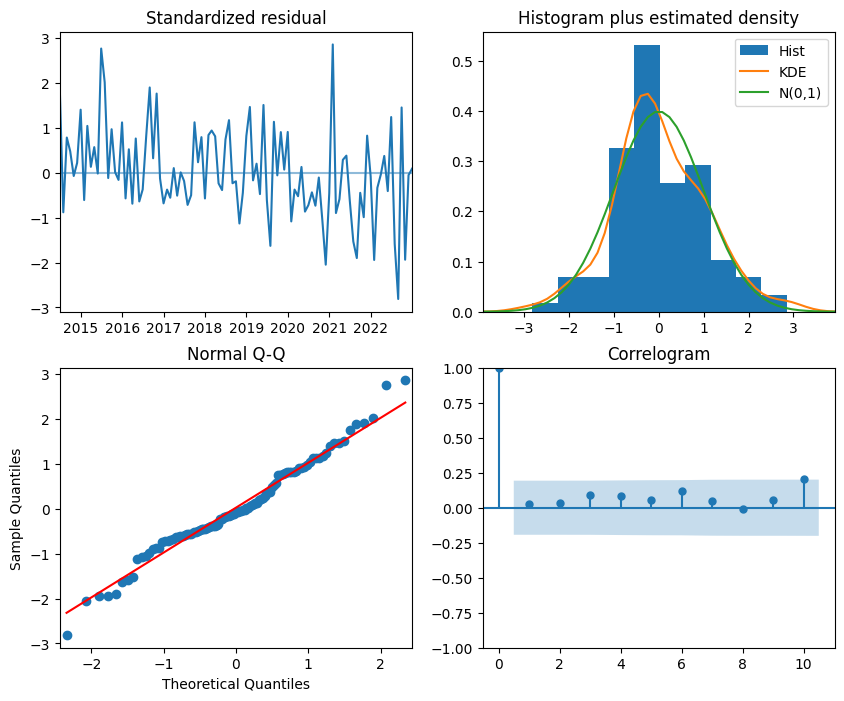

                                SARIMAX Results                                 
Dep. Variable:                        y   No. Observations:                  115
Model:             SARIMAX(1, 1, 0, 12)   Log Likelihood                 147.062
Date:                  Sat, 11 May 2024   AIC                           -288.124
Time:                          09:18:06   BIC                           -280.219
Sample:                      06-30-2013   HQIC                          -284.922
                           - 12-31-2022                                         
Covariance Type:                    opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time          -0.0006      0.000     -1.728      0.084      -0.001    7.45e-05
ar.S.L12      -0.5182      0.073     -7.120      0.000      -0.661      -0.376
sigma2         0.0032      0.000    

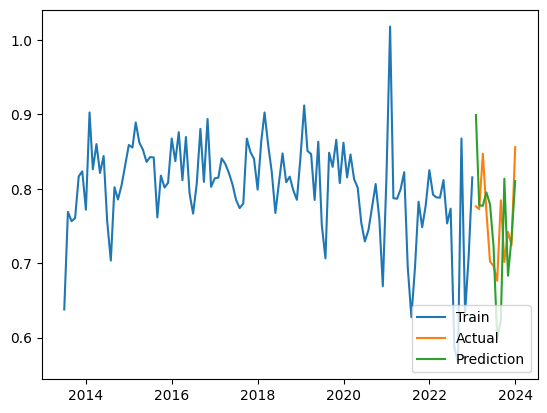

[0.00477131] [[-0.00506621]] [[0.00447641]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5186281024525782

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00477131] [[-0.00506621]] [[0.00447641]]
Mean of Residuals -0.04051383403472393
Mean of Residuals -0.04051383403472393


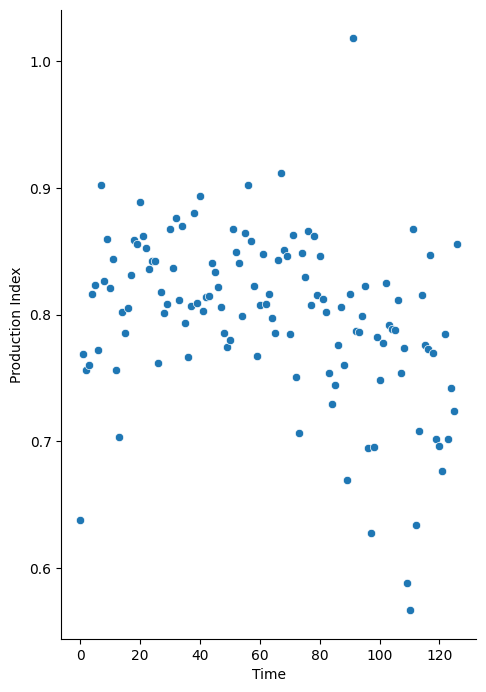

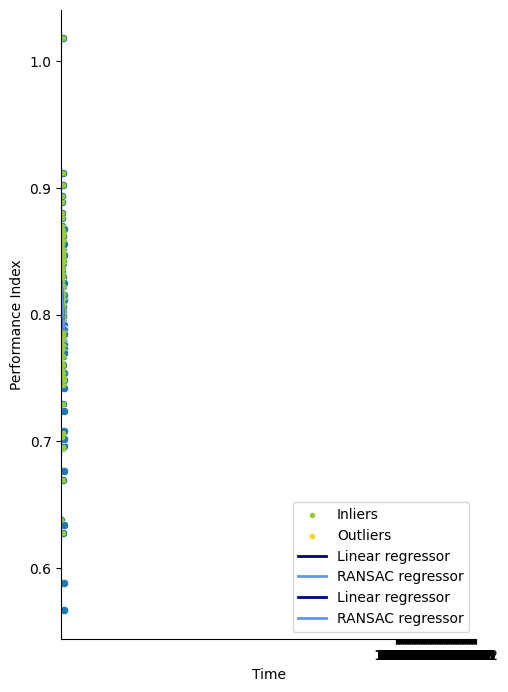

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[1.96287017] [[-1.96917412]] [[1.95656622]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.04130624490021

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96287017] [[-1.96917412]] [[1.95656622]]
[1.15591575] [[-1.15471046]] [[1.15712103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8762679565389018

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.15591575] [[-1.15471046]] [[1.15712103]]
[2.52185043] [[-2.52464017]] [[2.5190607]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.405434052631149

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.52185043] [[-2.52464017]] [[2.5190607]]
[0.9726172] [[-0.97445981]] [[0.97077459]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -26.808271087036395

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.9726172] [[-0.97445981]] [[0.97077459]]
[1.69872762] [[-1.69568126]] [[1.70177399]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.50253130590038

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.69872762] [[-1.69568126]] [[1.70177399]]
[0.84969779] [[-0.84034546]] [[0.85905011]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.384562368857704

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84969779] [[-0.84034546]] [[0.85905011]]
[0.65447224] [[-0.65377701]] [[0.65516748]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.875133077572474

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.65447224] [[-0.65377701]] [[0.65516748]]
[0.32159139] [[-0.32687428]] [[0.31630849]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -39.9878603016668

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.32159139] [[-0.32687428]] [[0.31630849]]
[1.13148026] [[-1.1315238]] [[1.13143672]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.02531493560413

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.13148026] [[-1.1315238]] [[1.13143672]]
[0.3786794] [[-0.37144038]] [[0.38591842]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -36.75712932676152

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.3786794] [[-0.37144038]] [[0.38591842]]
[1.2005002] [[-1.20662715]] [[1.19437325]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.946589258293464

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.2005002] [[-1.20662715]] [[1.19437325]]
[1.63867696] [[-1.65077743]] [[1.6265765]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.694466084531893

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.63867696] [[-1.65077743]] [[1.6265765]]
[2.06229179] [[-2.05475686]] [[2.06982672]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -24.765303630714406

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.06229179] [[-2.05475686]] [[2.06982672]]
[1.4407698] [[-1.44758007]] [[1.43395954]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -30.4729340836843

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.4407698] [[-1.44758007]] [[1.43395954]]
[2.85632715] [[-2.87417949]] [[2.83847481]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.8589701668658852

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.85632715] [[-2.87417949]] [[2.83847481]]
[0.91617194] [[-0.92025667]] [[0.91208722]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.36646784012532

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.91617194] [[-0.92025667]] [[0.91208722]]
[1.99435489] [[-1.99992232]] [[1.98878745]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.6251819816864757

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.99435489] [[-1.99992232]] [[1.98878745]]
[1.68148399] [[-1.68095015]] [[1.68201783]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1434.781470423739

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.68148399] [[-1.68095015]] [[1.68201783]]
[4.79068524] [[-4.75169921]] [[4.82967127]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.79068524] [[-4.75169921]] [[4.82967127]]
[1.10621834] [[-1.09850208]] [[1.1139346]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -276.57641964262956

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.10621834] [[-1.09850208]] [[1.1139346]]
[1.42676271] [[-1.43604887]] [[1.41747654]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.481448985064087

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.42676271] [[-1.43604887]] [[1.41747654]]
[1.99495121] [[-1.99411692]] [[1.99578549]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.873963721134238

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.99495121] [[-1.99411692]] [[1.99578549]]
[1.44725952] [[-1.45847727]] [[1.43604177]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.557669179332064

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.44725952] [[-1.45847727]] [[1.43604177]]
[1.48234627] [[-1.4804181]] [[1.48427444]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4741.490419877125

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.48234627] [[-1.4804181]] [[1.48427444]]
[1.01337893] [[-0.99540512]] [[1.03135275]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -49.874742061179234

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.01337893] [[-0.99540512]] [[1.03135275]]
[0.78335674] [[-0.78368317]] [[0.78303032]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8557817979362428

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.78335674] [[-0.78368317]] [[0.78303032]]
[0.93244025] [[-0.93026452]] [[0.93461597]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -124.72536673136774

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.93244025] [[-0.93026452]] [[0.93461597]]
[0.76595565] [[-0.78184438]] [[0.75006693]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.770490615236605

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.76595565] [[-0.78184438]] [[0.75006693]]
[0.66164204] [[-0.6561895]] [[0.66709459]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.4773858018265433

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.66164204] [[-0.6561895]] [[0.66709459]]
[1.65710231] [[-1.660209]] [[1.65399561]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.68425156314741

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.65710231] [[-1.660209]] [[1.65399561]]
[1.46928449] [[-1.48999538]] [[1.44857361]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -70.92459633625572

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.46928449] [[-1.48999538]] [[1.44857361]]
[4.30961433] [[-4.29284928]] [[4.32637939]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -123.35670812842382

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.30961433] [[-4.29284928]] [[4.32637939]]
[0.92089723] [[-0.90359303]] [[0.93820143]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -113.14323050020114

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.92089723] [[-0.90359303]] [[0.93820143]]
[1.33435055] [[-1.31929942]] [[1.34940169]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -49.391417123477815

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.33435055] [[-1.31929942]] [[1.34940169]]
[0.5221951] [[-0.52703284]] [[0.51735735]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -6.228172058648412

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.5221951] [[-0.52703284]] [[0.51735735]]
[1.53010343] [[-1.53760076]] [[1.5226061]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8091.887196639678

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.53010343] [[-1.53760076]] [[1.5226061]]
[7.01762618] [[-7.00268348]] [[7.03256889]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -11.673792159182597

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[7.01762618] [[-7.00268348]] [[7.03256889]]
[1.00858247] [[-0.98959402]] [[1.02757092]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -77.0145494837973

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.00858247] [[-0.98959402]] [[1.02757092]]
[3.15305055] [[-3.15671787]] [[3.14938323]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -10.40367666643011

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.15305055] [[-3.15671787]] [[3.14938323]]
[1.90234299] [[-1.90522759]] [[1.89945839]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0519977691927798

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.91385461] [[-1.91673921]] [[1.91097001]]
[1.47171667] [[-1.4671957]] [[1.47623764]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -483.97845043225834

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47171667] [[-1.4671957]] [[1.47623764]]
[2.69659191] [[-2.68177215]] [[2.71141167]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.691195764682097

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[2.61338505] [[-2.59856529]] [[2.62820481]]
               Production Index  Time
DateTimeIndex                        
2014-06-30             0.756359     0
2014-07-31             0.703590     1
2014-08-31             0.801967     2
2014-09-30             0.785605     3
2014-10-31             0.803105     4
2014-11-30             0.831325     5
2014-12-31             0.858768     6
2015-01-31             0.855321     7
2015-02-28             0.888675     8
2015-03-31             0.862010     9
2015-04-30             0.852479    10
2015-05-31             0.836091    11
2015-06-30             0.842489    12
2015-07-31             0.8

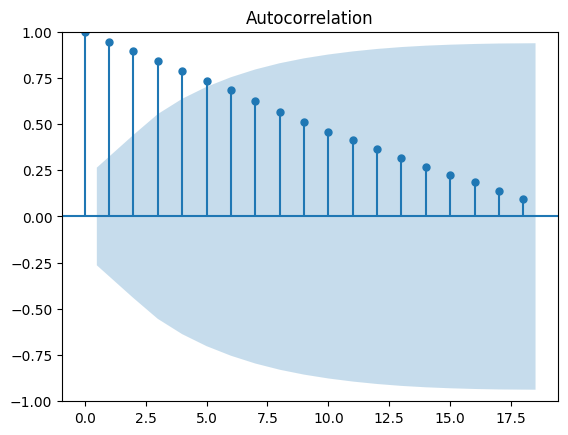

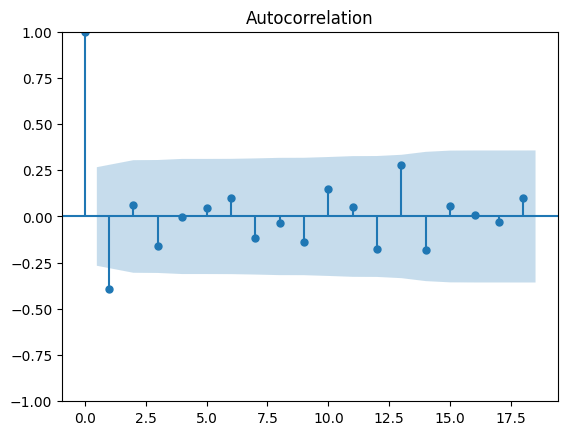

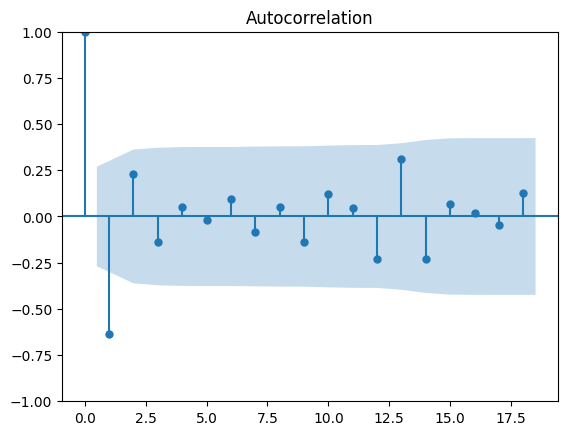

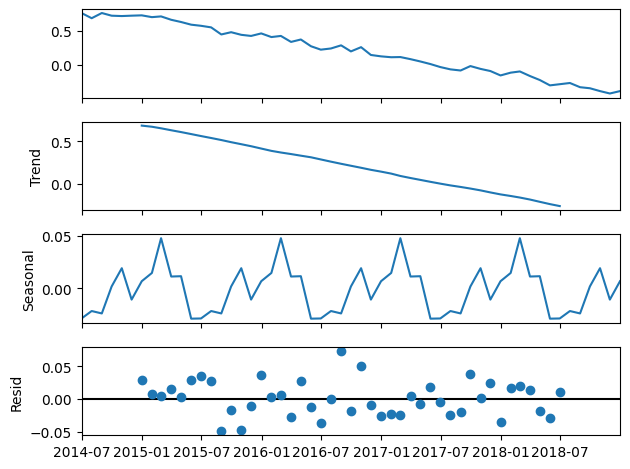

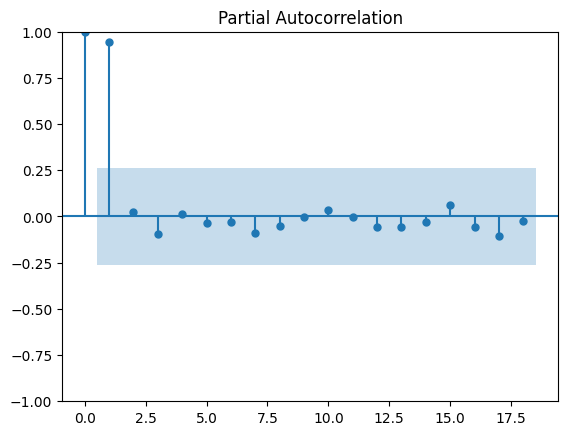

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-137.326, Time=1.59 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-126.979, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-135.096, Time=0.67 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-139.971, Time=0.65 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-128.979, Time=0.09 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-125.078, Time=0.22 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=-137.157, Time=0.83 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=-140.385, Time=3.62 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=-136.800, Time=3.95 sec
 ARIMA(0,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=2.48 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=3.08 sec
 ARIMA(0,0,2)(0,1,2)[12] intercept   : AIC=-138.955, Time=3.10 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=-134.956, Time=1.38 sec
 ARIMA(1,0,2)(0,1,2)[12] intercept   : AIC=-129.661, Time=2.54 sec
 ARIMA(0,0,1)(0,1,2)[12]     

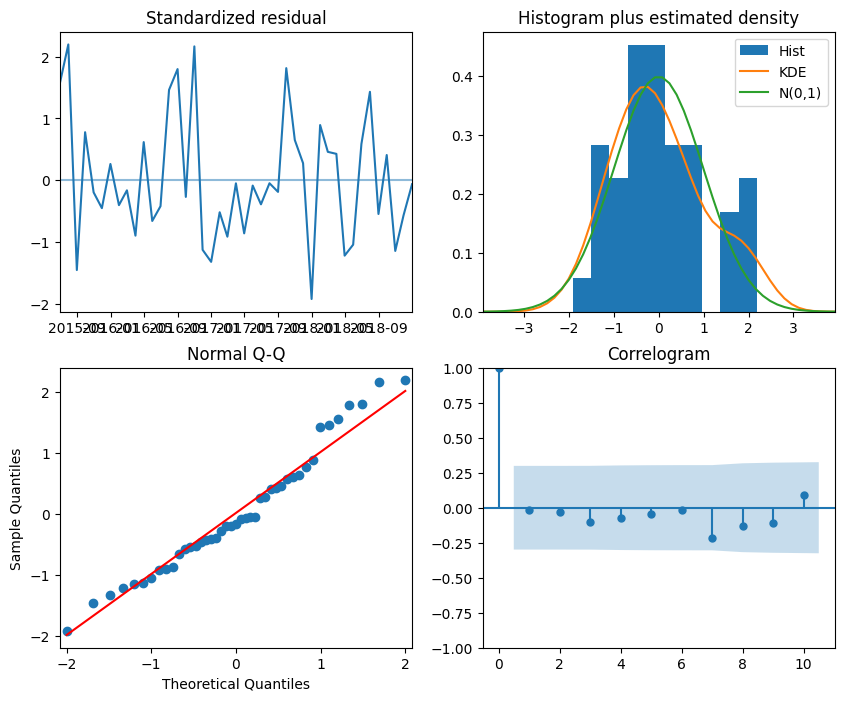

                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(0, 1, [1, 2], 12)   Log Likelihood                  76.463
Date:                                 Sat, 11 May 2024   AIC                           -142.926
Time:                                         09:19:06   BIC                           -134.120
Sample:                                     06-30-2014   HQIC                          -139.679
                                          - 12-31-2018                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time        7.867e-05      0.000      0.197      0.844      -0.001       0

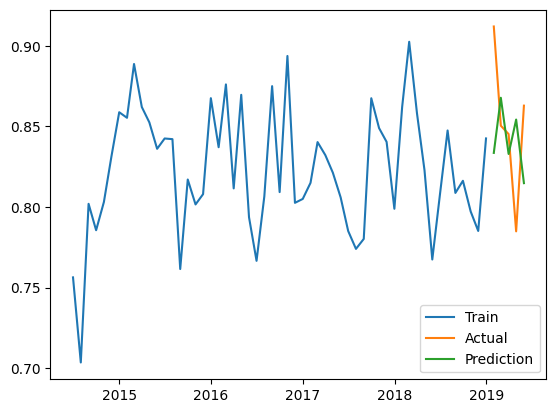

[0.00726595] [[-0.00688784]] [[0.00764406]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.5233626216435588

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

[0.00726595] [[-0.00688784]] [[0.00764406]]
Mean of Residuals -0.005211585640434881
Mean of Residuals -0.005211585640434881


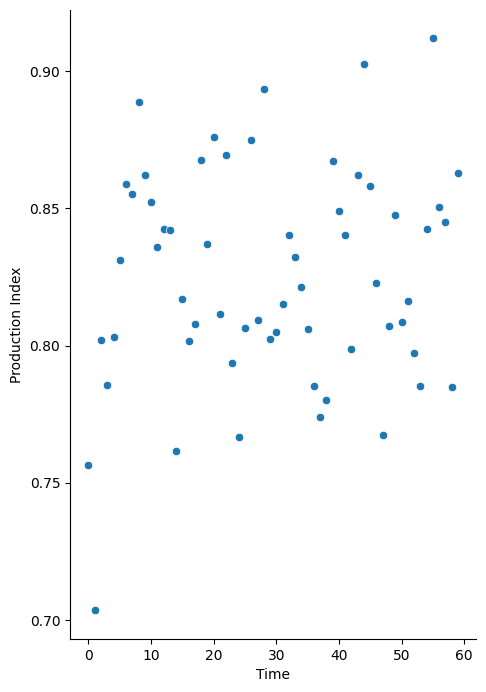

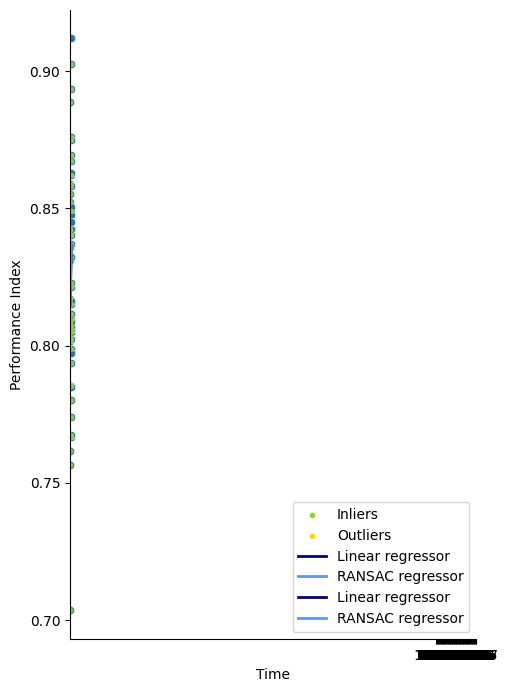

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

                     Ytre Vikna
2002-01-01 00:00:00         NaN
2002-01-01 01:00:00         NaN
2002-01-01 02:00:00         NaN
2002-01-01 03:00:00         NaN
2002-01-01 04:00:00         NaN
...                         ...
2018-01-08 14:00:00   19.342455
2014-10-21 11:00:00   18.763140
2021-07-19 14:00:00   18.349560
2015-02-07 02:00:00   21.985996
2020-01-08 23:00:00   20.820564

[193025 rows x 1 columns]
##################Åsen II###################
                    wind_speed temperature       pressure roughness_length
                           100         2              0                0  
timestamp                                                                 
2013-03-05 00:00:00   7.333631  275.248535  100403.187500         0.507505
2013-03-05 01:00:00   7.448957  275.028320  100322.531250         0.508885
2013-03-05 02:00:00   7.560957  274.754700  100240.226562         0.510811
2013-03-05 03:00:00   7.596419  274.693390  100144.906250         0.512551
2013-03-05 04:00:00

/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    54800.039163
dtype: float64
         Observasjoner tot prod  Observasjoner valid prod  \
Åsen II                  192840                     94896   

         Missing values prod  Negative values prod  Zero values prod  \
Åsen II                    0                     0              5044   

         Prod over capacity  Observasjoner df_windpowerlib  \
Åsen II                1840                          94896   

         Missing values wind_peed  Missing values temperature  \
Åsen II                       NaN                         NaN   

         Missing values pressure  Missing values roughness_length  \
Åsen II                      NaN                              NaN   

         Observasjoner sim  Zero values sim  
Åsen II              94896             6394  


<ipython-input-37-268ec80116a3>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] < 0, Vindpark_navn] = 0
<ipython-input-37-268ec80116a3>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[Vindpark_navn] > Vindpark['Maksimal effekt'], Vindpark_navn] = Vindpark['Maksimal effekt']
<ipython-input-37-268ec80116a3>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_set.loc[data_set[

             Åsen II
2002-12-31       NaN
2003-12-31       NaN
2004-12-31       NaN
2005-12-31       NaN
2006-12-31       NaN
2007-12-31       NaN
2008-12-31       NaN
2009-12-31       NaN
2010-12-31       NaN
2011-12-31       NaN
2012-12-31       NaN
2013-12-31  0.372517
2014-12-31  0.810502
2015-12-31  3.732877
2016-12-31  0.409836
2017-12-31  0.171233
2018-12-31  0.639269
2019-12-31  0.251142
2020-12-31  0.398452
2021-12-31  0.216895
2022-12-31  0.239726
2023-12-31  0.947489 <class 'pandas.core.frame.DataFrame'>


/usr/local/lib/python3.10/dist-packages/windpowerlib/data.py:443: WindpowerlibUserWarning: The following columns of the weather data contain invalid values like 'nan': [('roughness_length', 0)]
  warnings.warn(msg.format(nan_columns), WindpowerlibUserWarning)


feedin_power_plant    53832.315572
dtype: float64


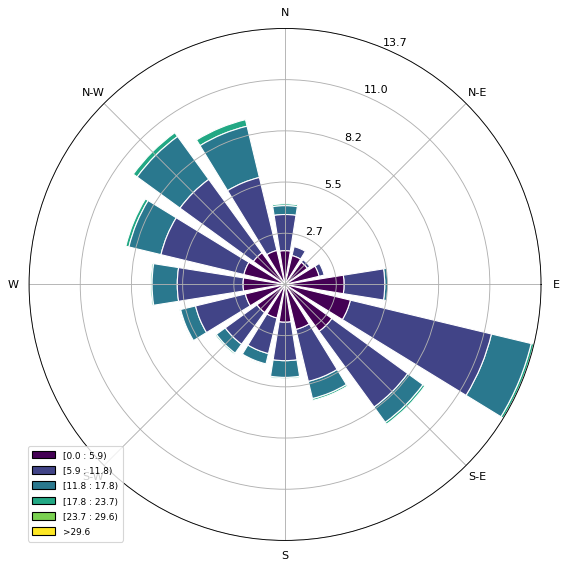

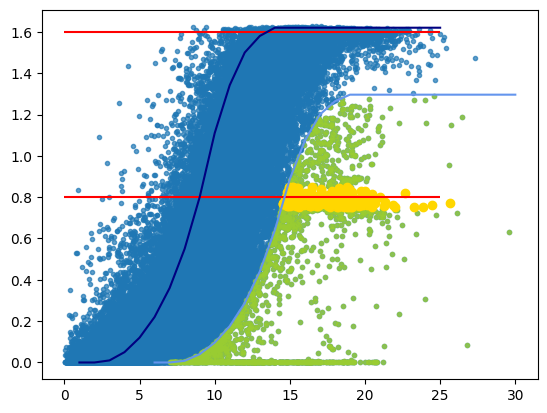

               Production Index  Time
DateTimeIndex                        
2013-03-31             1.135397     0
2013-04-30             0.893691     1
2013-05-31             0.940355     2
2013-06-30             0.862338     3
2013-07-31             0.746046     4
...                         ...   ...
2023-08-31             0.639864   125
2023-09-30             0.849363   126
2023-10-31             0.797750   127
2023-11-30             0.777120   128
2023-12-31             0.708795   129

[130 rows x 2 columns]


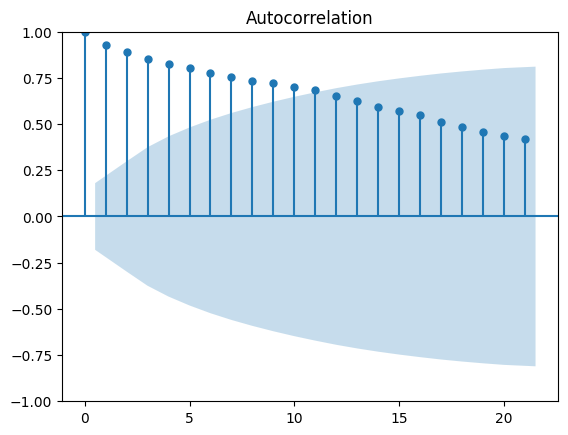

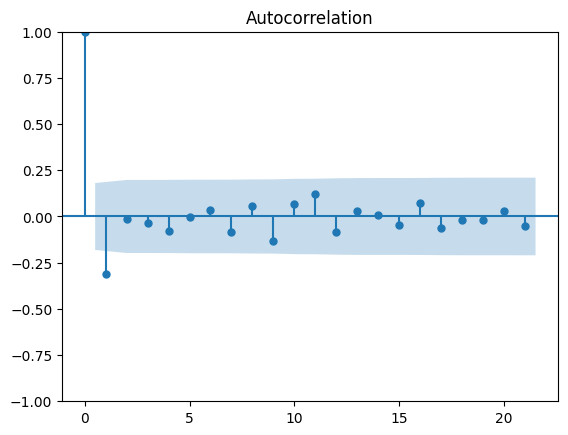

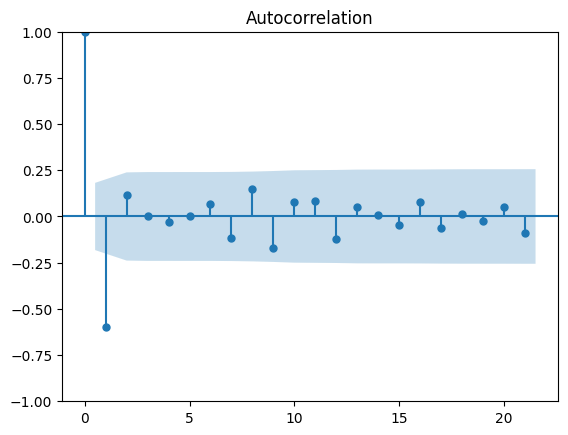

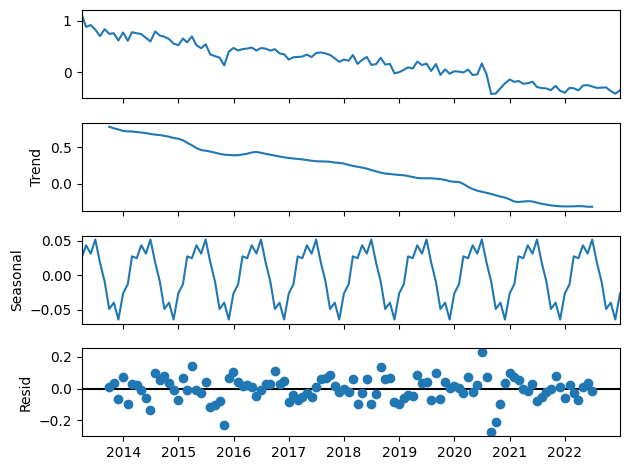

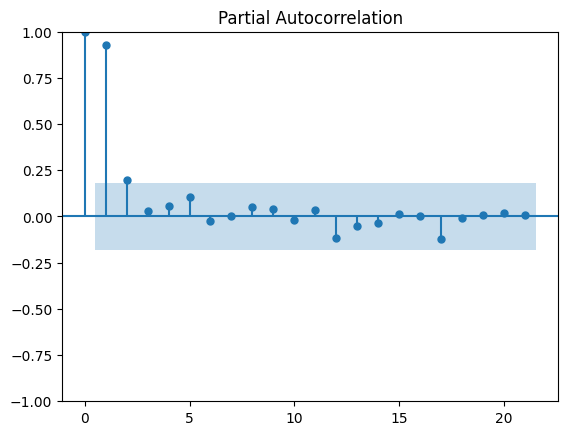

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.99 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-110.718, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-152.692, Time=0.97 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-169.711, Time=1.02 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-112.718, Time=0.11 sec
 ARIMA(0,0,1)(0,1,0)[12] intercept   : AIC=-126.358, Time=0.23 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=-170.735, Time=1.91 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-146.950, Time=1.71 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=-170.598, Time=4.78 sec
 ARIMA(0,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=5.49 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=2.57 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-156.797, Time=1.71 sec
 ARIMA(0,0,1)(2,1,2)[12] intercept   : AIC=inf, Time=4.60 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=2.75 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-

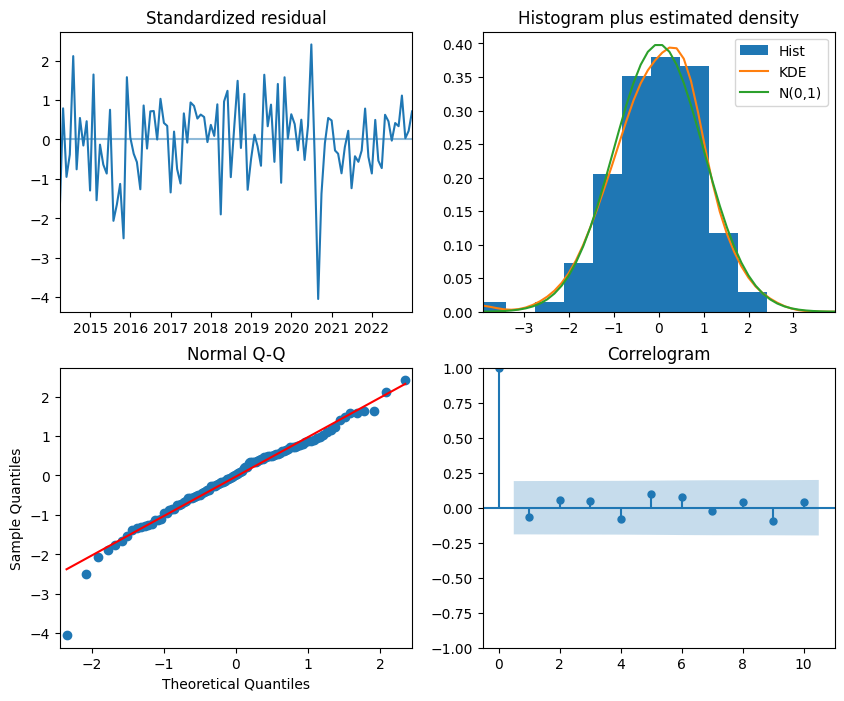

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  118
Model:             SARIMAX(1, 0, 0)x(2, 1, [1], 12)   Log Likelihood                  94.911
Date:                              Sat, 11 May 2024   AIC                           -175.822
Time:                                      09:21:01   BIC                           -157.178
Sample:                                  03-31-2013   HQIC                          -168.265
                                       - 12-31-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.1193      0.001    199.936      0.000       0.118       0.121
Time          -0.01

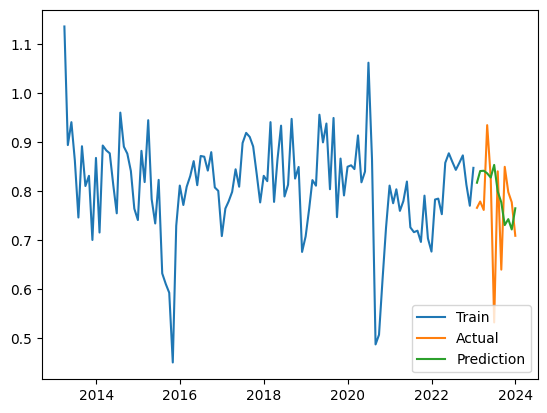

[0.00474351] [[-0.00529547]] [[0.00419155]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3565308233064363

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00474351] [[-0.00529547]] [[0.00419155]]
Mean of Residuals 0.012429822152359245
Mean of Residuals 0.012429822152359245


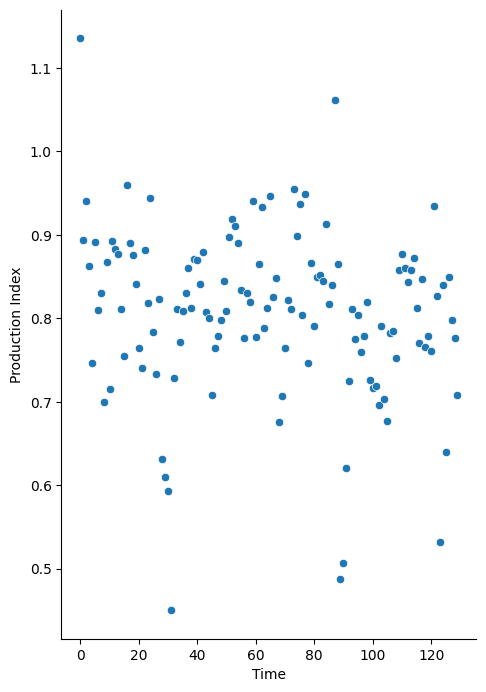

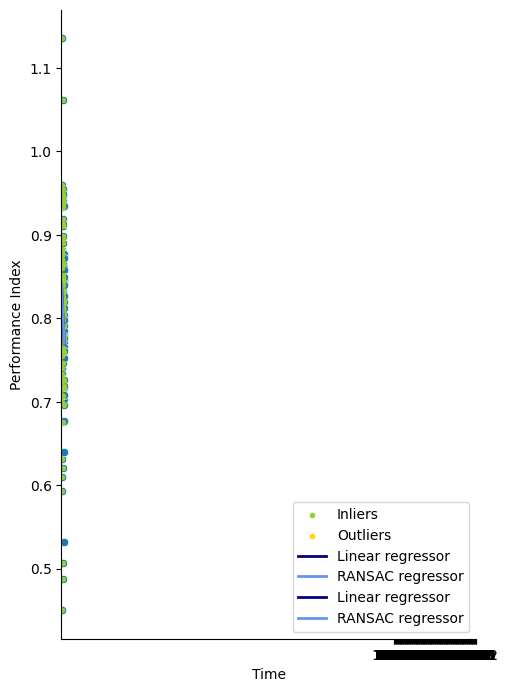

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.09811196] [[-3.11419801]] [[3.0820259]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -216.65287715604686

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.09811196] [[-3.11419801]] [[3.0820259]]
[1.45056544] [[-1.45133445]] [[1.44979642]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -250.04715643760795

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.50900421] [[-1.50977323]] [[1.5082352]]
[3.14043955] [[-3.15117384]] [[3.12970526]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -107.0533903041706

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.14043955] [[-3.15117384]] [[3.12970526]]
[1.7156813] [[-1.69863081]] [[1.73273178]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -40.01245364568273

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.7156813] [[-1.69863081]] [[1.73273178]]
[5.63330301] [[-5.60585369]] [[5.66075232]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -91.37194589318878

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.63330301] [[-5.60585369]] [[5.66075232]]
[3.65627858] [[-3.65750897]] [[3.6550482]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.2116594081359215

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.65627858] [[-3.65750897]] [[3.6550482]]
[2.36638732] [[-2.39187519]] [[2.34089944]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -103.8585731621126

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.36638732] [[-2.39187519]] [[2.34089944]]
[1.47595403] [[-1.46882001]] [[1.48308806]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.99970511665293

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47595403] [[-1.46882001]] [[1.48308806]]
[2.20007356] [[-2.18791608]] [[2.21223103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.090374328899497

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.20007356] [[-2.18791608]] [[2.21223103]]
[3.57136073] [[-3.57056507]] [[3.57215638]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.298670266313374

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.57136073] [[-3.57056507]] [[3.57215638]]
[0.30691603] [[-0.28692243]] [[0.32690963]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.75)

 The best score across ALL searched params:
 -17.991041552112844

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.75}
[0.30691603] [[-0.28692243]] [[0.32690963]]
[3.26826455] [[-3.25051773]] [[3.28601137]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.420428741052324

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.26826455] [[-3.25051773]] [[3.28601137]]
[3.40000554] [[-3.42059045]] [[3.37942064]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -282.29634086055466

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.40000554] [[-3.42059045]] [[3.37942064]]
[2.22314498] [[-2.23902631]] [[2.20726364]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33456.07549204033

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.22314498] [[-2.23902631]] [[2.20726364]]
[1.68785456] [[-1.71098941]] [[1.66471971]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.689810573632727

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.68785456] [[-1.71098941]] [[1.66471971]]
[0.88180561] [[-0.86553228]] [[0.89807893]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6448838183675296

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.88180561] [[-0.86553228]] [[0.89807893]]
[2.65355676] [[-2.66463704]] [[2.64247647]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -796.0990147738031

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.65355676] [[-2.66463704]] [[2.64247647]]
[1.96055053] [[-1.96186657]] [[1.95923449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6289639075879385

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96055053] [[-1.96186657]] [[1.95923449]]
[2.78119654] [[-2.79030558]] [[2.7720875]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0845876769916947

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.78119654] [[-2.79030558]] [[2.7720875]]
[3.87668681] [[-3.85884367]] [[3.89452995]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.87668681] [[-3.85884367]] [[3.89452995]]
[3.48717644] [[-3.46865233]] [[3.50570054]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.259893659791176

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.48717644] [[-3.46865233]] [[3.50570054]]
[5.06761525] [[-5.03498707]] [[5.10024344]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -87.65800195629764

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.06761525] [[-5.03498707]] [[5.10024344]]
[0.70679137] [[-0.72197461]] [[0.69160813]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.861273332724676

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.70679137] [[-0.72197461]] [[0.69160813]]
[0.57552506] [[-0.57345588]] [[0.57759424]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -27.849408445148647

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.57552506] [[-0.57345588]] [[0.57759424]]
[1.5696888] [[-1.58516852]] [[1.55420908]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.1668304714881925

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11551889] [[-2.13099861]] [[2.10003916]]
[4.58977623] [[-4.57027697]] [[4.60927549]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.685887799577813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.58977623] [[-4.57027697]] [[4.60927549]]
[1.31320692] [[-1.3190399]] [[1.30737394]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3662043756213637

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.31320692] [[-1.3190399]] [[1.30737394]]
[0.62853924] [[-0.62367951]] [[0.63339896]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.614243810479499

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.62853924] [[-0.62367951]] [[0.63339896]]
[13.30966491] [[-13.30086556]] [[13.31846427]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -13.575017560340351

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.30966491] [[-13.30086556]] [[13.31846427]]
[4.13433312] [[-4.18966088]] [[4.07900536]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20.34664744181118

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.13433312] [[-4.18966088]] [[4.07900536]]
[1.1437089] [[-1.11702551]] [[1.17039229]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -28.763194836308905

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.1437089] [[-1.11702551]] [[1.17039229]]
[2.62868223] [[-2.65331227]] [[2.60405219]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -70.51492608112713

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.62868223] [[-2.65331227]] [[2.60405219]]
[5.62487603] [[-5.61055652]] [[5.63919554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.276070740874202

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.67050827] [[-4.65618876]] [[4.68482778]]
[0.84848249] [[-0.86241339]] [[0.83455158]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -23.56434508416352

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.84848249] [[-0.86241339]] [[0.83455158]]
[1.20934088] [[-1.23014168]] [[1.18854008]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -48.410271623741174

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.20934088] [[-1.23014168]] [[1.18854008]]
[2.285747] [[-2.27902314]] [[2.29247086]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -78.12625239556435

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.285747] [[-2.27902314]] [[2.29247086]]
[2.45316833] [[-2.46792644]] [[2.43841022]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5636152683422

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.45316833] [[-2.46792644]] [[2.43841022]]
[2.07377269] [[-2.06990585]] [[2.07763953]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -22.81333589624813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.07377269] [[-2.06990585]] [[2.07763953]]
[1.92870096] [[-1.94759677]] [[1.90980516]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.014183748833062

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.92870096] [[-1.94759677]] [[1.90980516]]
[1.54347037] [[-1.55263041]] [[1.53431033]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.392263329768769

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.54347037] [[-1.55263041]] [[1.53431033]]
[3.77220504] [[-3.80257299]] [[3.74183709]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.9764466529427014

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.93248707] [[-3.96285502]] [[3.90211912]]
[5.86794435] [[-5.84471484]] [[5.89117386]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -22.77753612276838

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.12849695] [[-5.10526744]] [[5.15172646]]
[2.26204198] [[-2.26272047]] [[2.2613635]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.43283972350956

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.26204198] [[-2.26272047]] [[2.2613635]]
               Production Index  Time
DateTimeIndex                        
2013-03-31             1.135682     0
2013-04-30             0.914907     1
2013-05-31             0.940564     2
2013-06-30             0.862338     3
2013-07-31             0.746046     4
...                         ...   ...
2023-08-31             0.647512   125
2023-09-30             0.881034   126
2023-10-31             0.803676   127
2023-11-30             0.788554   128
2023-12-31             0.714009   129

[130 rows x 2 columns]


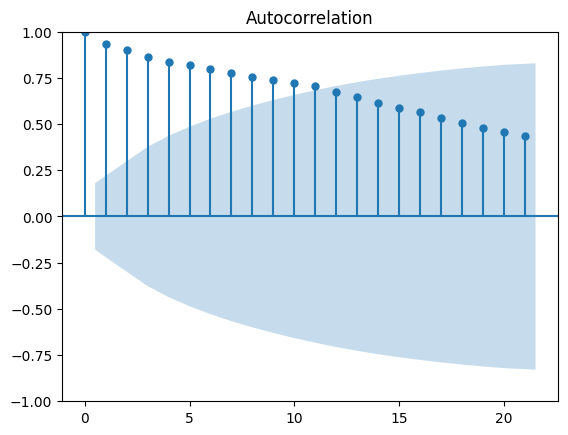

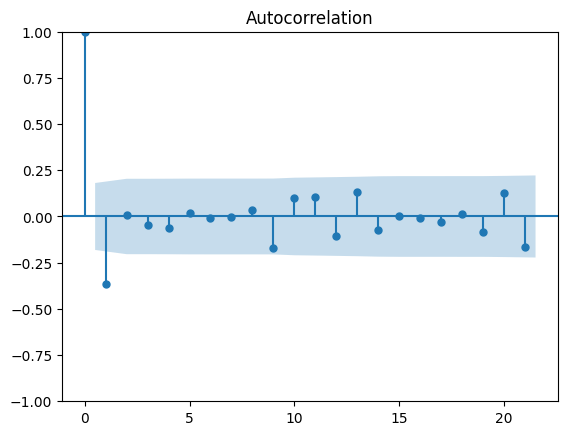

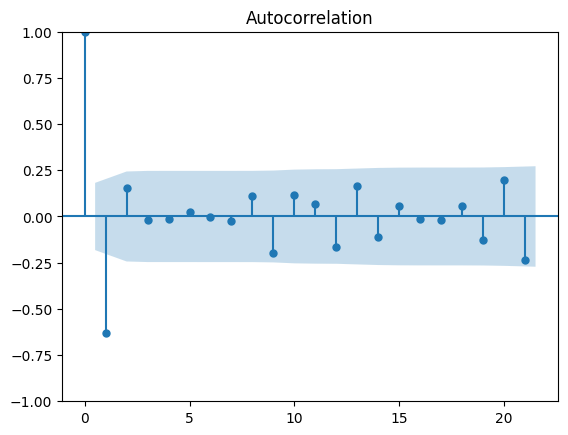

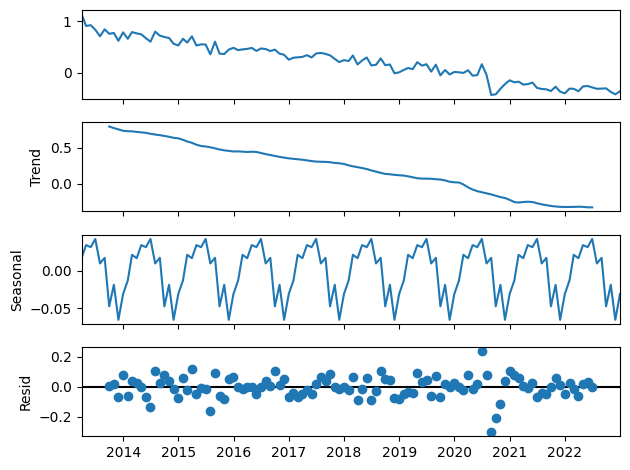

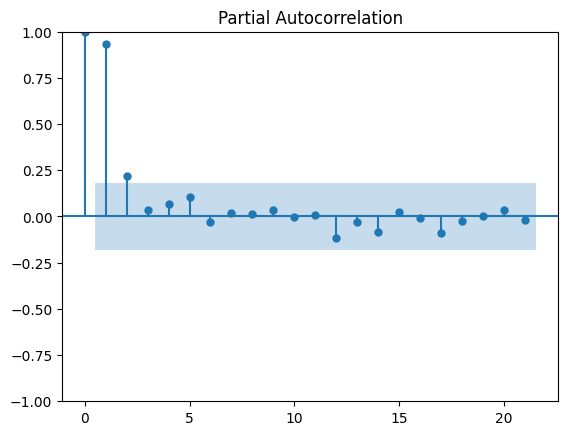

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-190.403, Time=3.26 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-140.138, Time=0.10 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-168.865, Time=1.80 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.78 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-142.138, Time=0.22 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-144.329, Time=0.86 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-189.350, Time=2.82 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=3.33 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-167.447, Time=2.00 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=inf, Time=4.83 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-191.119, Time=0.99 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-144.935, Time=0.26 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-191.251, Time=2.50 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-190.749, Time=3.52 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept

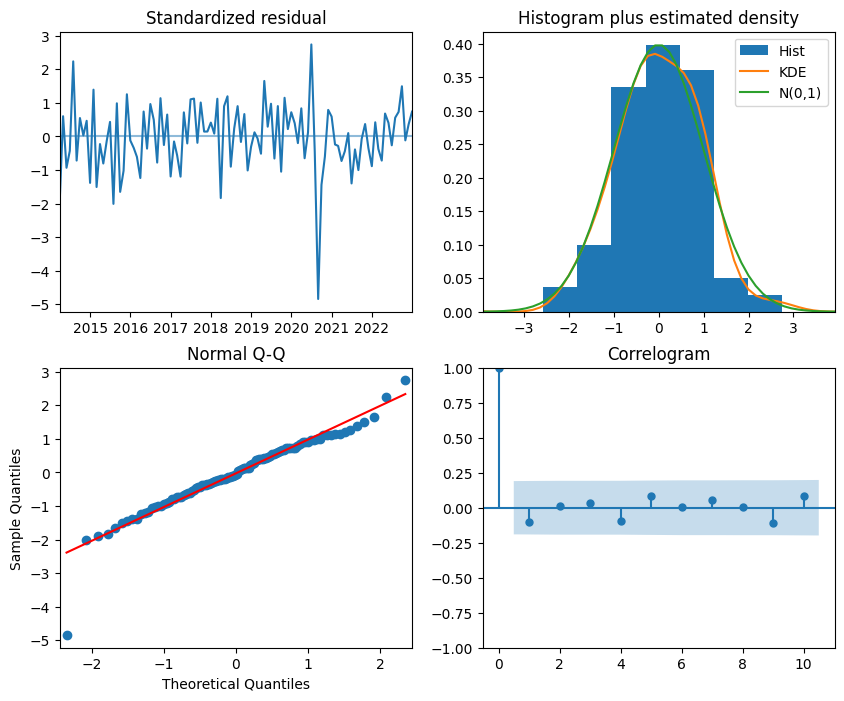

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  118
Model:             SARIMAX(1, 0, 0)x(1, 1, [1], 12)   Log Likelihood                 101.625
Date:                              Sat, 11 May 2024   AIC                           -191.251
Time:                                      09:22:14   BIC                           -175.270
Sample:                                  03-31-2013   HQIC                          -184.774
                                       - 12-31-2022                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2083      0.001    311.104      0.000       0.207       0.210
Time          -0.02

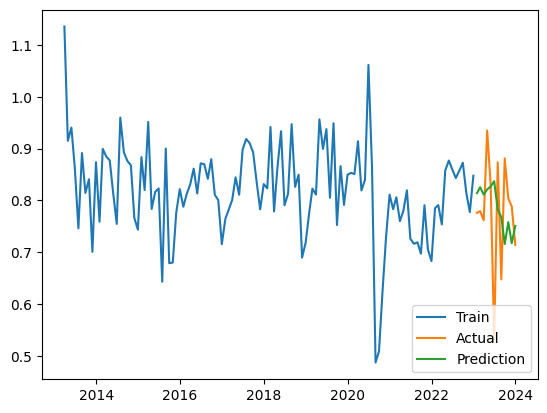

[0.00490288] [[-0.00567254]] [[0.00413323]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.24945985695743875

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}
[0.00490288] [[-0.00567254]] [[0.00413323]]
Mean of Residuals 0.02177814222134957
Mean of Residuals 0.02177814222134957


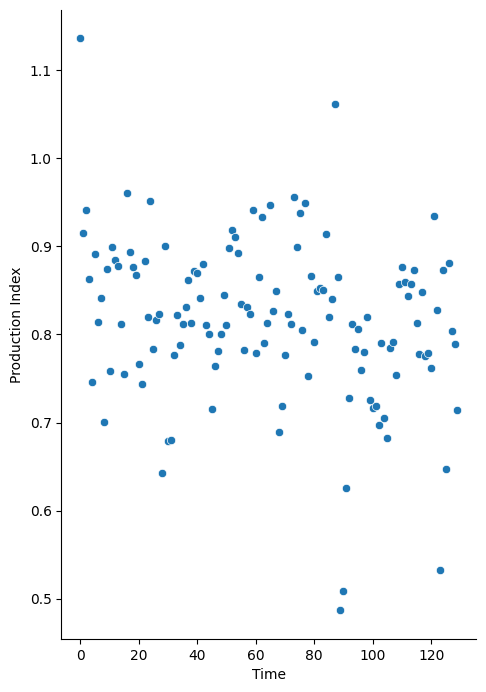

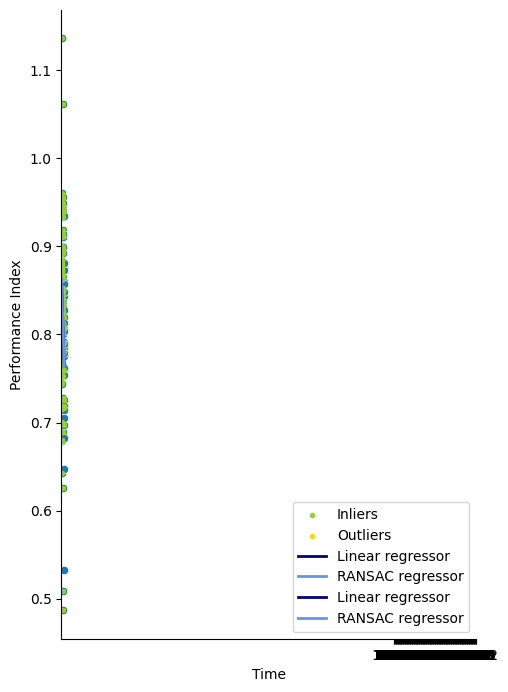

<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

[3.15269065] [[-3.17026178]] [[3.13511952]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.6660763476549034

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.15269065] [[-3.17026178]] [[3.13511952]]
[1.72224891] [[-1.72301676]] [[1.72148106]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=6, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -244.29993399242275

 The best parameters across ALL searched params:
 {'min_samples': 6, 'residual_threshold': 0.375}
[1.77176348] [[-1.77253133]] [[1.77099563]]
[3.19534267] [[-3.20640156]] [[3.18428378]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -126.99752319476791

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.19534267] [[-3.20640156]] [[3.18428378]]
[1.72479018] [[-1.71194965]] [[1.73763072]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -25.71294478638317

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.72479018] [[-1.71194965]] [[1.73763072]]
[5.63114615] [[-5.60372416]] [[5.65856814]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -91.41421109992372

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[5.63114615] [[-5.60372416]] [[5.65856814]]
[3.68008943] [[-3.68114174]] [[3.67903713]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=8, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -4.485821846353536

 The best parameters across ALL searched params:
 {'min_samples': 8, 'residual_threshold': 0.375}
[3.68008943] [[-3.68114174]] [[3.67903713]]
[2.65596046] [[-2.68510574]] [[2.62681518]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -89.43332517018605

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.65596046] [[-2.68510574]] [[2.62681518]]
[1.47049594] [[-1.46328457]] [[1.4777073]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -15.599961112003347

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.47049594] [[-1.46328457]] [[1.4777073]]
[3.13625598] [[-3.12089637]] [[3.15161558]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -131.1768911513482

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13625598] [[-3.12089637]] [[3.15161558]]
[4.24488208] [[-4.22192625]] [[4.26783792]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -55.661405633660685

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.24488208] [[-4.22192625]] [[4.26783792]]
[0.33051365] [[-0.32059765]] [[0.34042966]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -63.26215549796601

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.33051365] [[-0.32059765]] [[0.34042966]]
[3.13394166] [[-3.11885229]] [[3.14903103]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -125.32595503453315

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.13394166] [[-3.11885229]] [[3.14903103]]
[3.39713217] [[-3.41770851]] [[3.37655583]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -282.5610482679891

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.39713217] [[-3.41770851]] [[3.37655583]]
[2.22235981] [[-2.23822787]] [[2.20649175]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -33420.59919739976

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.22235981] [[-2.23822787]] [[2.20649175]]
[1.70833348] [[-1.73183892]] [[1.68482803]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -21.1705561459217

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.70833348] [[-1.73183892]] [[1.68482803]]
[0.90605898] [[-0.88924966]] [[0.92286831]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.0353595847270225

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.90605898] [[-0.88924966]] [[0.92286831]]
[2.63152486] [[-2.64249331]] [[2.62055641]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -771.8418907155088

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.63152486] [[-2.64249331]] [[2.62055641]]
[1.96055053] [[-1.96186657]] [[1.95923449]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.6289639075879385

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.96055053] [[-1.96186657]] [[1.95923449]]
[2.71620364] [[-2.72479538]] [[2.70761191]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.8166924067501984

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.71620364] [[-2.72479538]] [[2.70761191]]
[3.86843356] [[-3.85077525]] [[3.88609187]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
126 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
108 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 7.

--------------------------------------------------------------------------------
18 fits failed with the fol

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 nan

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.86843356] [[-3.85077525]] [[3.88609187]]
[3.48629256] [[-3.4677645]] [[3.50482062]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.2512020557198156

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.48629256] [[-3.4677645]] [[3.50482062]]
[5.03612972] [[-5.00375332]] [[5.06850611]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -89.42490570162946

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[5.03612972] [[-5.00375332]] [[5.06850611]]
[0.56165128] [[-0.57527314]] [[0.54802941]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.831314871868311

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.56165128] [[-0.57527314]] [[0.54802941]]
[0.58128437] [[-0.58084319]] [[0.58172554]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -42.61051648737241

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.58128437] [[-0.58084319]] [[0.58172554]]
[1.56951621] [[-1.5850073]] [[1.55402511]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -3.2005847418064817

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.11375543] [[-2.12924652]] [[2.09826434]]
[4.53675765] [[-4.51710065]] [[4.55641464]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -9.654904245259996

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.53675765] [[-4.51710065]] [[4.55641464]]
[1.3103358] [[-1.31614584]] [[1.30452576]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.3629908426382106

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.3103358] [[-1.31614584]] [[1.30452576]]
[0.50593299] [[-0.50021005]] [[0.51165594]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -39.56804262652251

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.50593299] [[-0.50021005]] [[0.51165594]]
[13.30467188] [[-13.29595421]] [[13.31338955]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -510.4467640589355

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[13.30467188] [[-13.29595421]] [[13.31338955]]
[4.08601652] [[-4.14101814]] [[4.0310149]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -19.514574234548085

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.08601652] [[-4.14101814]] [[4.0310149]]
[1.15857939] [[-1.13160672]] [[1.18555205]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -20.929868458414536

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.15857939] [[-1.13160672]] [[1.18555205]]
[2.63342336] [[-2.65831251]] [[2.60853421]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -66.90819704348901

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.63342336] [[-2.65831251]] [[2.60853421]]
[5.62427264] [[-5.60997382]] [[5.63857147]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -0.26139261309958745

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.6700047] [[-4.65570587]] [[4.68430352]]
[0.86829255] [[-0.88222346]] [[0.85436165]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -23.56434508416352

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[0.86829255] [[-0.88222346]] [[0.85436165]]
[1.29909066] [[-1.31963315]] [[1.27854817]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -98.43810010792365

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.29909066] [[-1.31963315]] [[1.27854817]]
[2.32436976] [[-2.3174857]] [[2.33125382]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -67.09702373205789

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.32436976] [[-2.3174857]] [[2.33125382]]
[2.45384382] [[-2.46861645]] [[2.4390712]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.5974960919388828

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.45384382] [[-2.46861645]] [[2.4390712]]
[2.07290266] [[-2.06903582]] [[2.0767695]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.5)

 The best score across ALL searched params:
 -22.81333589624813

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.5}
[2.07290266] [[-2.06903582]] [[2.0767695]]
[1.83471369] [[-1.8529443]] [[1.81648308]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -14.922007834148626

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.83471369] [[-1.8529443]] [[1.81648308]]
[1.58842646] [[-1.59889486]] [[1.57795806]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -7.3494356265201715

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[1.58842646] [[-1.59889486]] [[1.57795806]]
[3.77563512] [[-3.80603579]] [[3.74523444]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -2.8239116562008744

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[3.93593728] [[-3.96633795]] [[3.90553661]]
[4.80872099] [[-4.78842435]] [[4.82901764]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

  warnings.warn(some_fits_failed_message, FitFailedWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/mo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -5.786419136311028

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[4.36001278] [[-4.33971613]] [[4.38030943]]
[2.25215929] [[-2.25293552]] [[2.25138305]]


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
90 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
18 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 8.

--------------------------------------------------------------------------------
72 fits failed with the follo

 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=4, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -8.816254676637891

 The best parameters across ALL searched params:
 {'min_samples': 4, 'residual_threshold': 0.375}
[2.25215929] [[-2.25293552]] [[2.25138305]]
               Production Index  Time
DateTimeIndex                        
2014-03-31             0.882780     0
2014-04-30             0.876866     1
2014-05-31             0.811790     2
2014-06-30             0.754591     3
2014-07-31             0.959822     4
2014-08-31             0.890352     5
2014-09-30             0.876279     6
2014-10-31             0.840798     7
2014-11-30             0.764096     8
2014-12-31             0.740847     9
2015-01-31             0.881922    10
2015-02-28             0.818263    11
2015-03-31             0.944409    12
2015-04-30             0.7

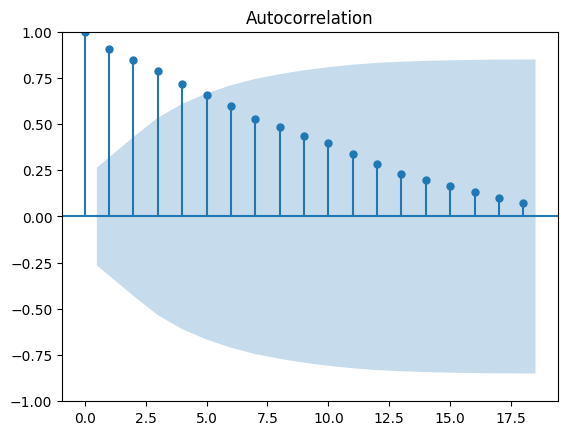

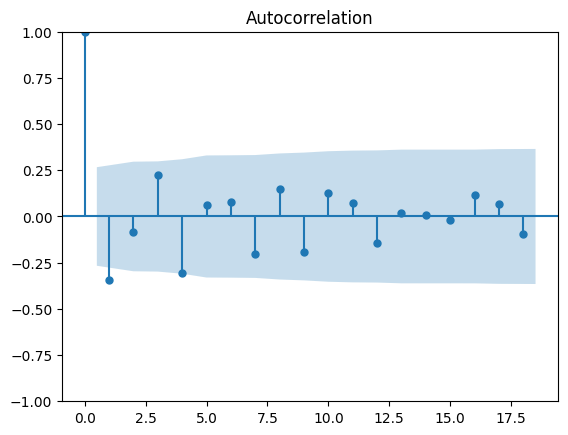

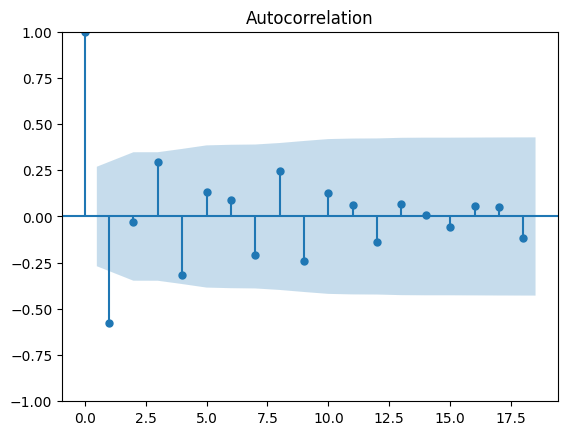

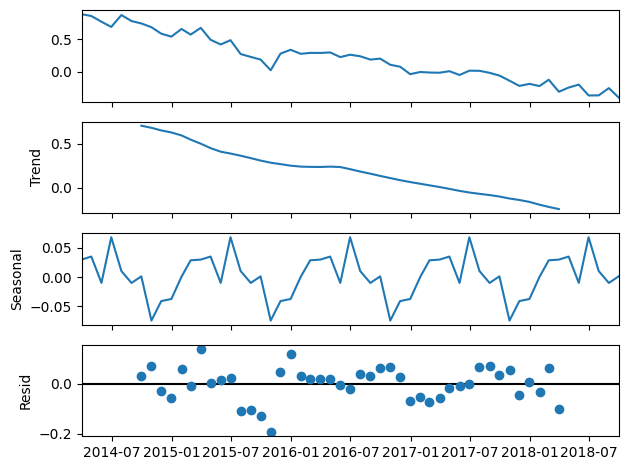

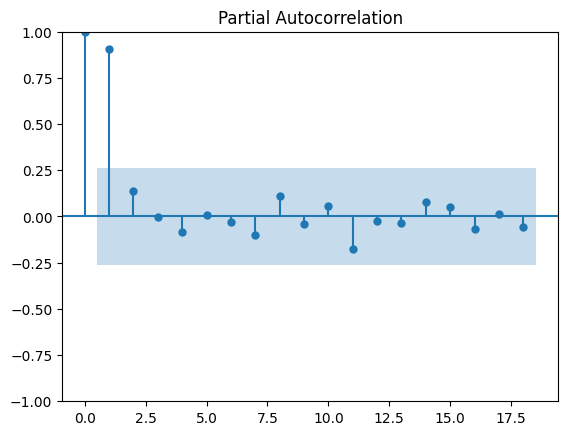

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=2.80 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-37.137, Time=0.08 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-61.396, Time=0.72 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=1.49 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-39.137, Time=0.08 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-51.815, Time=0.18 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-61.312, Time=2.39 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=-62.049, Time=2.27 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.55 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-59.648, Time=2.74 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=3.28 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=1.47 sec
 ARIMA(1,0,0)(2,1,2)[12] intercept   : AIC=-57.991, Time=3.37 sec
 ARIMA(0,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=1.86 sec
 ARIMA(2,0,0)(1,1,1)[12] intercept   : AIC=-61.093, Time=

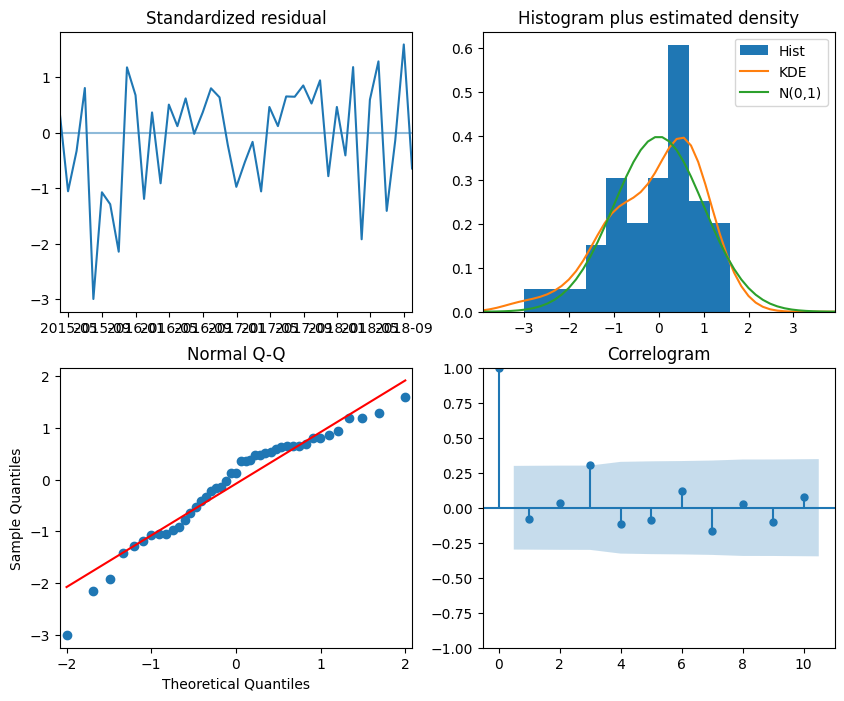

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   55
Model:             SARIMAX(1, 0, 0)x(1, 1, [1], 12)   Log Likelihood                  37.039
Date:                              Sat, 11 May 2024   AIC                            -64.079
Time:                                      09:23:16   BIC                            -55.273
Sample:                                  03-31-2014   HQIC                           -60.831
                                       - 09-30-2018                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Time           0.0010      0.001      0.791      0.429      -0.001       0.004
ar.L1          0.47

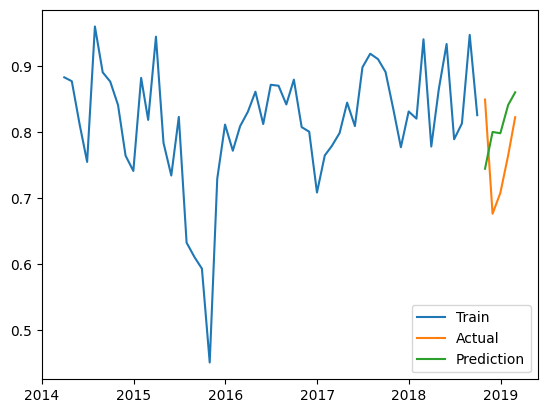

[0.0163741] [[-0.01560203]] [[0.01714616]]
 Results from Grid Search 

 The best estimator across ALL searched params:
 RANSACRegressor(estimator=LinearRegression(), min_samples=20, random_state=0,
                residual_threshold=0.375)

 The best score across ALL searched params:
 -1.5194272701185765

 The best parameters across ALL searched params:
 {'min_samples': 20, 'residual_threshold': 0.375}


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
45 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
27 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ransac.py", line 367, in fit
    raise ValueError(
ValueError: `min_samples` may not be larger than number of samples: n_samples = 38.

--------------------------------------------------------------------------------
18 fits failed with the foll

[0.0163741] [[-0.01560203]] [[0.01714616]]
Mean of Residuals -0.01917272073001126
Mean of Residuals -0.01917272073001126


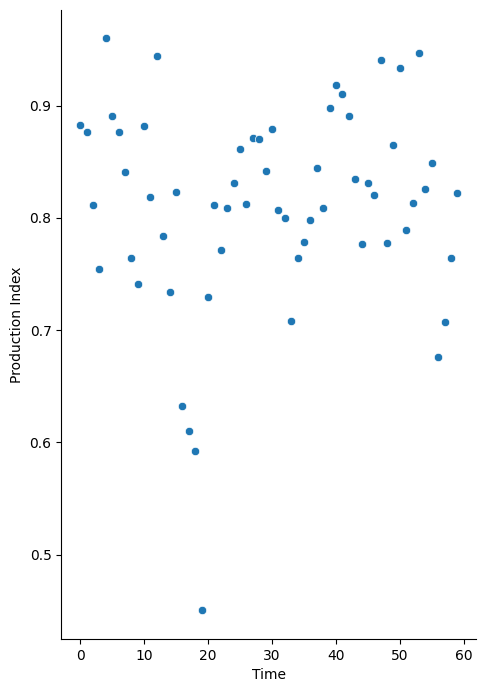

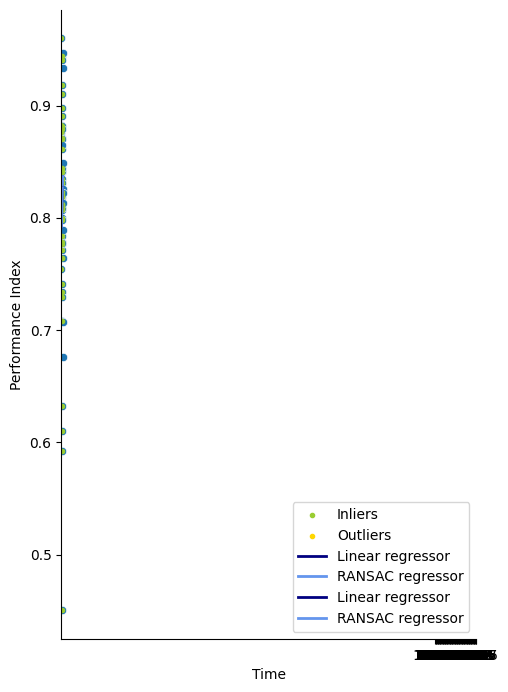

                       Åsen II
2002-01-01 00:00:00        NaN
2002-01-01 01:00:00        NaN
2002-01-01 02:00:00        NaN
2002-01-01 03:00:00        NaN
2002-01-01 04:00:00        NaN
...                        ...
2023-12-28 04:00:00  16.366346
2023-12-31 16:00:00  18.222593
2023-12-31 21:00:00  18.708921
2023-12-31 22:00:00  18.576893
2023-12-31 23:00:00  18.256630

[193552 rows x 1 columns]


<ipython-input-20-ede3f50a1dd2>:116: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  results = df_conf_int = pd.DataFrame({'Linear_coefficient': round(float(lr_coef),4),
<ipython-input-20-ede3f50a1dd2>:117: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Confidence_interval_linear': round(float(ci_factor_linear),4),
<ipython-input-20-ede3f50a1dd2>:118: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  'Ransac_coefficient': round(float(ransac_coef),4),
<ipython-input-20-ed

In [39]:
#Running all wind farms and storing results in separate dataframes
def run_multiple_windfarms(chosen_windfarm):
  df_results = pd.DataFrame()
  df_results_downtime = pd.DataFrame()
  df_confidence_interval = pd.DataFrame()
  df_data_statistics = pd.DataFrame()
  df_results_three_years = pd.DataFrame()
  df_distance = pd.DataFrame()

  df_results_without_downtime = pd.DataFrame()
  df_results_lr_season_without_downtime = pd.DataFrame()
  df_results_ran_season_without_downtime = pd.DataFrame()

  df_results_season_lr = pd.DataFrame()
  df_results_season_ran = pd.DataFrame()

  df_lr_metrics_lf = pd.DataFrame()
  df_ran_metrics_lf = pd.DataFrame()

  df_lr_metrics_s = pd.DataFrame()
  df_ran_metrics_s = pd.DataFrame()

  df_arima_metrics_lf = pd.DataFrame()
  df_arima_metrics_s = pd.DataFrame()
  df_arima_metrics_y = pd.DataFrame()

  df_lr_residuals_lf = pd.DataFrame()
  df_ran_residuals_ran = pd.DataFrame()

  df_downtime = pd.DataFrame()
  df_downtime_percent = pd.DataFrame()
  for windfarm in chosen_windfarm:
    print('##################' + windfarm + '###################')
    results_lifetime,results_lr_season,results_ran_season,results_lifetime_without_downtime,results_lr_season_downtime,results_ran_season_downtime, results_three_years,confidence_interval,data_statistics,downtime,annual_downtime_percent, distance, lf_metrics_lf, ran_metrics_lf, lr_residuals_lf,ran_residuals_lf, lr_metrics_s, ran_metrics_s,arima_metrics_lf,arima_metrics_d,arima_metrics_y = run_one_windfarm(windfarm)
    df_results = pd.concat([df_results,results_lifetime])
    df_results_season_lr = pd.concat([df_results_season_lr, results_lr_season])
    df_results_season_ran = pd.concat([df_results_season_ran, results_ran_season])

    df_confidence_interval = pd.concat([df_confidence_interval,confidence_interval])
    df_data_statistics = pd.concat([df_data_statistics,data_statistics])
    df_results_without_downtime = pd.concat([df_results_without_downtime,results_lifetime_without_downtime])
    df_results_lr_season_without_downtime = pd.concat([df_results_lr_season_without_downtime, results_lr_season_downtime])
    df_results_ran_season_without_downtime = pd.concat([df_results_ran_season_without_downtime, results_ran_season_downtime])

    df_results_three_years = pd.concat([df_results_three_years, results_three_years])
    df_lr_metrics_lf = pd.concat([df_lr_metrics_lf, lf_metrics_lf])
    df_ran_metrics_lf = pd.concat([df_ran_metrics_lf, ran_metrics_lf])

    df_lr_metrics_s = pd.concat([df_lr_metrics_s, lr_metrics_s])
    df_ran_metrics_s = pd.concat([df_ran_metrics_s, ran_metrics_s])

    df_arima_metrics_lf = pd.concat([df_arima_metrics_lf, arima_metrics_lf])
    df_arima_metrics_s = pd.concat([df_arima_metrics_s, arima_metrics_d])
    df_arima_metrics_y = pd.concat([df_arima_metrics_y, arima_metrics_y])

    df_lr_residuals_lf = pd.concat([df_lr_residuals_lf, lr_residuals_lf])
    df_ran_residuals_ran = pd.concat([df_ran_residuals_ran, ran_residuals_lf])

    df_distance = pd.concat([df_distance,distance])
    df_downtime = pd.concat([df_downtime, downtime])
    df_downtime_percent = pd.concat([df_downtime_percent, annual_downtime_percent], axis = 1)
  return df_results,df_results_three_years,df_results_season_lr,df_results_season_ran,df_results_without_downtime,df_results_lr_season_without_downtime,df_results_ran_season_without_downtime, df_downtime,df_downtime_percent,df_confidence_interval,df_data_statistics, df_distance, df_lr_metrics_lf,df_ran_metrics_lf,df_lr_residuals_lf,df_ran_residuals_ran,df_lr_metrics_s,df_ran_metrics_s, df_arima_metrics_lf,df_arima_metrics_s, df_arima_metrics_y

chosen = ['Egersund','Fakken','Hamnefjell','Hitra','Kjøllefjord','Lista','Raggovidda','Rye Vind','Røyrmyra','Sandøy','Skomakerfjellet','Tellenes','Valsneset','Ytre Vikna','Åsen II']

results, results_three_years,results_season_lr,results_season_ran,results_without_downtime,results_lr_season_without_downtime,results_ran_season_without_downtime,df_downtime,df_downtime_percent,df_confidence_interval,df_data_statistics, distance, lr_metrics_lf, ran_metrics_lf,lr_residuals_lf,ran_residuals_ran,lr_metrics_s,ran_metrics_s,df_arima_metrics_lf,df_arima_metrics_s, df_arima_metrics_y = run_multiple_windfarms(chosen)





In [40]:
df_data_statistics

,Observasjoner tot prod,Observasjoner valid prod,Missing values prod,Negative values prod,Zero values prod,Prod over capacity,Observasjoner df_windpowerlib,Missing values wind_peed,Missing values temperature,Missing values pressure,Missing values roughness_length,Observasjoner sim,Zero values sim
Egersund,192840,47270,0,0,3544,0,47270,NaN,NaN,NaN,NaN,47270,2531
Fakken,192840,92030,0,0,9440,0,92030,NaN,NaN,NaN,NaN,92030,16614
Hamnefjell,192840,47857,0,0,3681,1,47857,NaN,NaN,NaN,NaN,47857,4550
Hitra,192840,161081,0,0,17114,317,161081,NaN,NaN,NaN,NaN,161081,33551
Kjøllefjord,192840,142609,0,0,13354,39,142609,NaN,NaN,NaN,NaN,142609,16399
Lista,192840,90683,0,0,5338,0,90683,NaN,NaN,NaN,NaN,90683,8025
Raggovidda,192840,74004,0,0,5570,1068,74004,NaN,NaN,NaN,NaN,74004,11995
Rye Vind,192840,61368,0,0,25590,9,61368,NaN,NaN,NaN,NaN,61368,28038
Røyrmyra,192840,63481,0,0,2598,4020,63481,NaN,NaN,NaN,NaN,63481,3349
Sandøy,184080,175320,0,0,26406,4942,175320,NaN,NaN,NaN,NaN,175320,37078


In [41]:
df_downtime_percent

,Egersund,Fakken,Hamnefjell,Hitra,Kjøllefjord,Lista,Raggovidda,Rye Vind,Røyrmyra,Sandøy,Skomakerfjellet,Tellenes,Valsneset,Ytre Vikna,Åsen II
2002-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.347032,NaN,NaN,NaN,NaN,NaN
2004-12-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.523679,NaN,NaN,NaN,NaN,NaN
2005-12-31,NaN,NaN,NaN,0.121029,NaN,NaN,NaN,NaN,NaN,2.477169,NaN,NaN,NaN,NaN,NaN
2006-12-31,NaN,NaN,NaN,0.148402,NaN,NaN,NaN,NaN,NaN,1.038813,NaN,NaN,NaN,NaN,NaN
2007-12-31,NaN,NaN,NaN,0.319635,0.212495,NaN,NaN,NaN,NaN,0.650685,NaN,NaN,0.000000,NaN,NaN
2008-12-31,NaN,NaN,NaN,0.432605,0.626138,NaN,NaN,NaN,NaN,1.138434,NaN,NaN,0.216302,NaN,NaN
2009-12-31,NaN,NaN,NaN,0.331050,0.205479,NaN,NaN,NaN,NaN,0.673516,NaN,NaN,0.182648,NaN,NaN
2010-12-31,NaN,NaN,NaN,0.445205,0.433790,NaN,NaN,NaN,NaN,0.650685,NaN,NaN,0.799087,NaN,NaN
2011-12-31,NaN,NaN,NaN,0.433790,0.696347,NaN,NaN,NaN,NaN,1.974886,NaN,NaN,0.319635,NaN,NaN


In [42]:
final_avg = pd.DataFrame(df_downtime_percent.sum(axis=1), columns=['Avg_Degrad_percent'])
final_avg['hrs_count'] = df_downtime_percent.count(axis=1)
final_avg['Annual_degrad'] = final_avg['Avg_Degrad_percent']/final_avg['hrs_count']
final_avg.fillna(0, inplace = True)
final_avg

,Avg_Degrad_percent,hrs_count,Annual_degrad
2002-12-31,0.000000,0,0.000000
2003-12-31,1.347032,1,1.347032
2004-12-31,0.523679,1,0.523679
2005-12-31,2.598198,2,1.299099
2006-12-31,1.187215,2,0.593607
2007-12-31,1.182814,4,0.295704
2008-12-31,2.413479,4,0.603370
2009-12-31,1.392694,4,0.348174
2010-12-31,2.328767,4,0.582192
2011-12-31,3.424658,4,0.856164


In [43]:
# Training data
final_avg['Time'] = np.arange(len(final_avg.index))
X = final_avg.loc[:, ['Time']].values  # features
y = final_avg.loc[:, ['Annual_degrad']].values  # target

lr = LinearRegression().fit(X,y)
lr.coef_

array([[0.04187583]])

<ipython-input-46-211654e82005>:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  plt.plot(final_avg['Time'], float(lr.intercept_)+ float(lr.coef_) * final_avg['Time'], 'b')


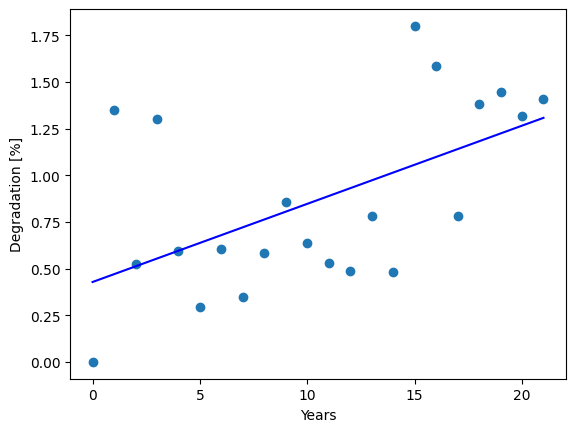

In [46]:

plt.figure()
plt.scatter(final_avg['Time'], final_avg['Annual_degrad'])
plt.plot(final_avg['Time'], float(lr.intercept_)+ float(lr.coef_) * final_avg['Time'], 'b')
plt.xlabel('Years')
plt.ylabel('Degradation [%]')
plt.show()

In [47]:
df_downtime

,Egersund,Fakken,Hamnefjell,Hitra,Kjøllefjord,Lista,Raggovidda,Rye Vind,Røyrmyra,Sandøy,Skomakerfjellet,Tellenes,Valsneset,Ytre Vikna,Åsen II
2002-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2002-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-28 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.366346
2023-12-31 16:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.222593
2023-12-31 21:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.708921
2023-12-31 22:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18.576893


In [48]:
newdf = df_downtime.notnull().astype('int')
newdf

,Egersund,Fakken,Hamnefjell,Hitra,Kjøllefjord,Lista,Raggovidda,Rye Vind,Røyrmyra,Sandøy,Skomakerfjellet,Tellenes,Valsneset,Ytre Vikna,Åsen II
2002-01-01 00:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2002-01-01 01:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2002-01-01 02:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2002-01-01 03:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2002-01-01 04:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-28 04:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2023-12-31 16:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2023-12-31 21:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2023-12-31 22:00:00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [49]:

_, one_year = first_valid_hour(newdf, 'Sandøy')
one_year



'2003-01-01 00:00:00'

In [50]:
df_monthly = newdf[one_year:].resample('A').sum()


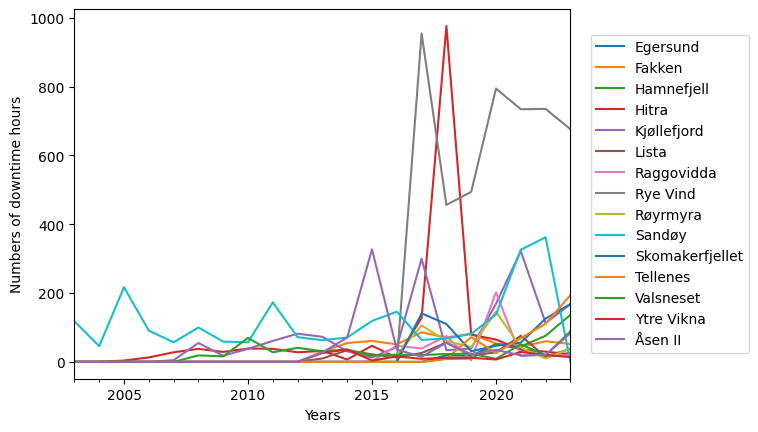

In [51]:
df_monthly.plot()
plt.xlabel('Years')
plt.ylabel('Numbers of downtime hours')
plt.legend(loc='upper center', bbox_to_anchor=(1.2, 0.95))
plt.show()

In [52]:
lr_metrics_lf.set_index('Wind Farm', inplace = True)
lr_metrics_lf

,R2,MSE,MAE
Wind Farm,,,
Egersund,-0.447865,0.003808,0.053551
Fakken,-0.057018,0.461303,0.513819
Hamnefjell,0.004615,0.063902,0.188271
Hitra,-0.836815,0.064173,0.209118
Kjøllefjord,-0.691561,0.068113,0.207929
Lista,-0.001641,0.003071,0.040599
Raggovidda,-0.138197,0.232548,0.355812
Rye Vind,-0.123313,6.024678,1.708881
Røyrmyra,-1.157187,0.027055,0.153028


In [53]:
ran_metrics_lf.set_index('Wind Farm', inplace = True)
ran_metrics_lf

,R2,MSE,MAE
Wind Farm,,,
Egersund,-0.447865,0.003808,0.053551
Fakken,-0.070658,0.467256,0.513258
Hamnefjell,-0.039082,0.066708,0.201206
Hitra,-0.830188,0.063942,0.208855
Kjøllefjord,-0.691561,0.068113,0.207929
Lista,-0.001641,0.003071,0.040599
Raggovidda,-0.174816,0.240030,0.360519
Rye Vind,-0.362159,7.305681,1.828407
Røyrmyra,-1.157187,0.027055,0.153028


In [54]:
lr_residuals_lf.set_index('Windfarm', inplace = True)
lr_residuals_lf

,Ljungbox test,Rainbow test,Shapiro-Wilk test,Goldfeld Quandt
Windfarm,,,,
Egersund,7.997297e-02,8.891378e-05,2.547337e-13,0.253344
Fakken,1.783229e-01,1.264243e-03,1.041356e-18,0.816846
Hamnefjell,5.895145e-01,4.479454e-05,2.313432e-13,0.141306
Hitra,8.569324e-02,1.185522e-10,1.006192e-24,0.911506
Kjøllefjord,1.505792e-01,2.178404e-12,2.200213e-23,0.024231
Lista,3.304656e-02,6.299614e-08,9.278600e-19,0.043751
Raggovidda,3.955235e-01,3.786514e-04,8.113333e-17,0.370396
Rye Vind,1.203026e-02,3.509583e-01,1.046870e-14,0.143504
Røyrmyra,6.763666e-01,2.361475e-04,1.545064e-15,0.004058


In [55]:
lr_residuals_lf

,Ljungbox test,Rainbow test,Shapiro-Wilk test,Goldfeld Quandt
Windfarm,,,,
Egersund,7.997297e-02,8.891378e-05,2.547337e-13,0.253344
Fakken,1.783229e-01,1.264243e-03,1.041356e-18,0.816846
Hamnefjell,5.895145e-01,4.479454e-05,2.313432e-13,0.141306
Hitra,8.569324e-02,1.185522e-10,1.006192e-24,0.911506
Kjøllefjord,1.505792e-01,2.178404e-12,2.200213e-23,0.024231
Lista,3.304656e-02,6.299614e-08,9.278600e-19,0.043751
Raggovidda,3.955235e-01,3.786514e-04,8.113333e-17,0.370396
Rye Vind,1.203026e-02,3.509583e-01,1.046870e-14,0.143504
Røyrmyra,6.763666e-01,2.361475e-04,1.545064e-15,0.004058


In [56]:
ran_residuals_ran.set_index('Windfarm', inplace=True)


In [57]:
ran_residuals_ran

,Ljungbox test,Rainbow test,Shapiro-Wilk test,Goldfeld Quandt
Windfarm,,,,
Egersund,7.997297e-02,8.891378e-05,2.547337e-13,0.253344
Fakken,1.783615e-01,1.264243e-03,1.041356e-18,0.817056
Hamnefjell,6.095566e-01,4.479454e-05,2.313432e-13,0.135953
Hitra,7.938373e-02,1.185522e-10,1.006192e-24,0.913558
Kjøllefjord,1.505792e-01,2.178404e-12,2.200213e-23,0.024231
Lista,3.304656e-02,6.299614e-08,9.278600e-19,0.043751
Raggovidda,3.930167e-01,3.786514e-04,8.113333e-17,0.372159
Rye Vind,1.171032e-02,3.509583e-01,1.046870e-14,0.144227
Røyrmyra,6.763666e-01,2.361475e-04,1.545064e-15,0.004058


In [58]:
#results.reset_index(drop =True, inplace=True)
results.set_index('Wind_farm', inplace=True)
results

,Linear_degradation,Ransac_degradation,Arima degradation
Wind_farm,,,
Egersund,-0.0120,-0.0120,-0.0075
Fakken,-0.0084,-0.0084,0.0053
Hamnefjell,-0.0528,-0.0180,-0.0436
Hitra,-0.0120,-0.0096,-0.0181
Kjøllefjord,0.0024,0.0024,-0.0868
Lista,-0.0012,-0.0012,-0.0011
Raggovidda,-0.0432,-0.0408,-0.0243
Rye Vind,0.0624,-0.0060,0.1715
Røyrmyra,-0.0168,-0.0168,-1.5578


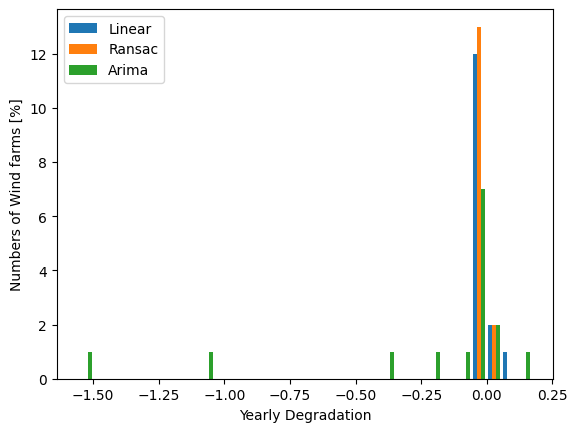

In [59]:
from matplotlib import pyplot
plt.figure()
plt.hist([results['Linear_degradation'],results['Ransac_degradation'],results['Arima degradation']], bins=30, histtype='bar', label = ['Linear', 'Ransac', 'Arima'])
plt.legend(loc='upper left')
plt.xlabel('Yearly Degradation')
plt.ylabel('Numbers of Wind farms [%]')
plt.show()





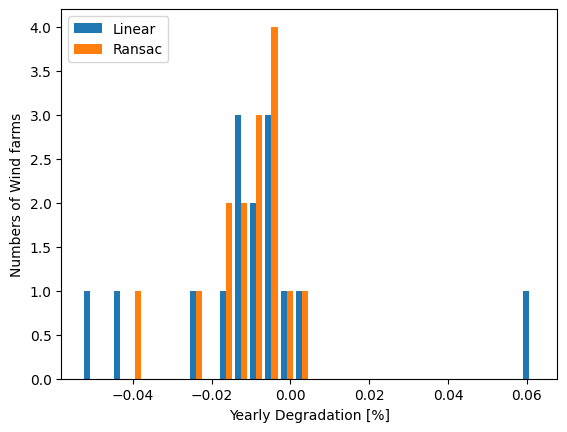

In [60]:
from matplotlib import pyplot
plt.figure()
plt.hist([results['Linear_degradation'],results['Ransac_degradation']], bins=30, histtype='bar', label = ['Linear', 'Ransac'])
plt.legend(loc='upper left')
plt.xlabel('Yearly Degradation [%]')
plt.ylabel('Numbers of Wind farms')
plt.show()

In [61]:
results_without_downtime.set_index('Wind_farm', inplace=True)
results_without_downtime

,Linear_degradation,Ransac_degradation,Arima degradation
Wind_farm,,,
Egersund,-0.0120,-0.0120,-0.2558
Fakken,-0.0096,-0.0096,0.0049
Hamnefjell,-0.0420,-0.0084,-0.0393
Hitra,-0.0084,-0.0072,-0.1599
Kjøllefjord,0.0024,0.0036,-0.0436
Lista,-0.0012,-0.0012,-0.0778
Raggovidda,-0.0372,-0.0348,-0.0218
Rye Vind,0.1284,0.0192,0.1489
Røyrmyra,-0.0180,-0.0180,-1.3541


In [62]:
results_three_years.set_index('Wind_farm',inplace=True)
results_three_years

,Linear_degradation,Ransac_degradation,Arima degradation
Wind_farm,,,
Egersund,-0.0060,-0.0060,0.0000
Fakken,0.1020,0.1020,0.0289
Hamnefjell,-0.0372,-0.0504,-0.0289
Hitra,0.0504,0.0528,0.0253
Kjøllefjord,0.0012,0.0012,-0.0076
Lista,-0.0060,-0.0060,-0.0001
Raggovidda,-0.0312,-0.0324,-0.0486
Rye Vind,-0.3228,-0.2112,-0.0000
Røyrmyra,-0.0492,-0.0492,-0.0266


In [63]:
df_results_avg, df_weighted = make_weighted_degradation(results_three_years)
df_results_avg

                 Maksimal effekt  Proportion
Wind_farm                                   
Egersund                 112.200    0.169916
Fakken                    54.000    0.081778
Hamnefjell                51.750    0.078370
Hitra                     55.200    0.083595
Kjøllefjord               39.100    0.059213
Lista                     71.300    0.107977
Raggovidda                45.000    0.068148
Rye Vind                   0.225    0.000341
Røyrmyra                   2.400    0.003635
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Tellenes                 160.000    0.242305
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
Åsen II                    1.600    0.002423


,Linear Reg Mean,Ransac Reg Mean,Arima Reg Mean,Linear Reg Weighted Avg,Ransac Reg Weighted Avg,Arima Reg Weighted Avg
0,-0.02104,-0.01504,-0.00568,0.000142,-0.000928,-0.007855


In [64]:
df_results_avg, df_weighted = make_weighted_degradation(results_without_downtime)
df_results_avg

                 Maksimal effekt  Proportion
Wind_farm                                   
Egersund                 112.200    0.169916
Fakken                    54.000    0.081778
Hamnefjell                51.750    0.078370
Hitra                     55.200    0.083595
Kjøllefjord               39.100    0.059213
Lista                     71.300    0.107977
Raggovidda                45.000    0.068148
Rye Vind                   0.225    0.000341
Røyrmyra                   2.400    0.003635
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Tellenes                 160.000    0.242305
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
Åsen II                    1.600    0.002423


,Linear Reg Mean,Ransac Reg Mean,Arima Reg Mean,Linear Reg Weighted Avg,Ransac Reg Weighted Avg,Arima Reg Weighted Avg
0,-0.00376,-0.00856,-0.219567,-0.015128,-0.012204,-0.089621


In [65]:
df_results_avg_lr_downtime, df_weighted_lr_downtime = make_weighted_degradation(results_without_downtime)
df_results_avg_lr_downtime

                 Maksimal effekt  Proportion
Wind_farm                                   
Egersund                 112.200    0.169916
Fakken                    54.000    0.081778
Hamnefjell                51.750    0.078370
Hitra                     55.200    0.083595
Kjøllefjord               39.100    0.059213
Lista                     71.300    0.107977
Raggovidda                45.000    0.068148
Rye Vind                   0.225    0.000341
Røyrmyra                   2.400    0.003635
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Tellenes                 160.000    0.242305
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
Åsen II                    1.600    0.002423


,Linear Reg Mean,Ransac Reg Mean,Arima Reg Mean,Linear Reg Weighted Avg,Ransac Reg Weighted Avg,Arima Reg Weighted Avg
0,-0.00376,-0.00856,-0.219567,-0.015128,-0.012204,-0.089621


In [66]:
df_results_avg_lr, df_weighted_lr = make_weighted_degradation(results_without_downtime)
df_results_avg_lr

                 Maksimal effekt  Proportion
Wind_farm                                   
Egersund                 112.200    0.169916
Fakken                    54.000    0.081778
Hamnefjell                51.750    0.078370
Hitra                     55.200    0.083595
Kjøllefjord               39.100    0.059213
Lista                     71.300    0.107977
Raggovidda                45.000    0.068148
Rye Vind                   0.225    0.000341
Røyrmyra                   2.400    0.003635
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Tellenes                 160.000    0.242305
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
Åsen II                    1.600    0.002423


,Linear Reg Mean,Ransac Reg Mean,Arima Reg Mean,Linear Reg Weighted Avg,Ransac Reg Weighted Avg,Arima Reg Weighted Avg
0,-0.00376,-0.00856,-0.219567,-0.015128,-0.012204,-0.089621


In [67]:
df_weighted_lr['Weighted_Ransac_degradation'].sum()

-0.012203808730549352

In [76]:
results_without_downtime['Ransac_degradation'].mean()


-0.008560000000000002

In [69]:
avg_result_linear = 0.5* df_results_avg_lr['Ransac Reg Mean'] + 0.5 * df_results_avg_lr['Ransac Reg Weighted Avg']
avg_result_linear

0   -0.010382
dtype: float64

In [85]:
def mean_confidence_interval(data_1,data_2, confidence=0.95):
  n1 = results_without_downtime['Ransac_degradation'].shape[0]
  n2 = df_weighted['Weighted_Ransac_degradation'].shape[0]

  df = n1 + n2-2

  mean_1 = np.mean(data_1)
  mean_2 = np.sum(data_2)
  total_mean = (0.5 * mean_1 + 0.5 * mean_2)

  std_err_1 = scipy.stats.sem(data_1)
  std_err_2 = scipy.stats.sem(data_2)
  print(std_err_1, std_err_2)
  total_std_error = 0.5 * math.sqrt(((std_err_1**2)/n1 + (std_err_2**2))/n2)
  print(total_std_error)

  pooled_standard_deviation = math.sqrt(
                      ((n1 - 1)*std_err_1 * std_err_1 +
                     (n2-1)*std_err_2 * std_err_2) /
                                  (n1 + n2-2))

  print('Std', pooled_standard_deviation)
  interval = total_std_error * scipy.stats.t.ppf((1 + confidence) / 2., df)

  lower = total_mean-interval
  upper = total_mean +interval
  return interval, lower, upper





In [86]:

interval, lower, upper = mean_confidence_interval(results_without_downtime['Ransac_degradation'],df_weighted['Weighted_Ransac_degradation'])

print(interval)






0.0030847829282278057 0.0003703491629841674
0.00011339833063699647
Std 0.0021969347073603246
0.000232285950344482


In [ ]:
df_cluster = pd.DataFrame(index = results.index)
df_cluster['Geografic'] = portfolio_data['Geografic_area']
df_cluster['Age_groups'] = portfolio_data['Age_groups']
df_cluster


,Geografic,Age_groups
Wind_farm,,
Egersund,South_west,New_turbine
Fakken,North,Old_turbine
Hamnefjell,North,Old_turbine
Hitra,Mid,Old_turbine
Kjøllefjord,North,Old_turbine
Lista,South_west,Old_turbine
Raggovidda,North,New_turbine
Rye Vind,Mid,Old_turbine
Røyrmyra,South_west,Old_turbine


In [ ]:
results['Geografic'] = df_cluster['Geografic']
df_weighted_lr['Geografic'] = df_cluster['Geografic']

linear = alt.Chart(results.reset_index()).mark_bar(opacity = 0.7).encode(
    x='Wind_farm:O',
    y='Linear_degradation:Q',
    color = 'Geografic:O'
)
lr_weighted = alt.Chart(df_weighted_lr.reset_index()).mark_bar(opacity = 0.7).encode(
    x='Wind_farm:O',
    y='Weighted_Linear_degradation:Q',
    color = alt.Color('Geografic', scale=alt.Scale(domain = ['South_west', 'Mid', 'North'], range=['blue', 'red', 'green']))
)

display(alt.hconcat(linear, lr_weighted).configure_axis(
    labelFontSize=15,
    titleFontSize=20))

alt.HConcatChart(...)

In [ ]:
linear = alt.Chart(results.reset_index()).mark_bar(opacity = 0.7).encode(
    x='Wind_farm:O',
    y='Ransac_degradation:Q',
    color = 'Geografic:O'
)
lr_weighted = alt.Chart(df_weighted_lr.reset_index()).mark_bar().encode(
    x='Wind_farm:O',
    y='Weighted_Ransac_degradation:Q',
    color = alt.Color('Geografic', scale=alt.Scale(domain = ['South_west', 'Mid', 'North'], range=['blue', 'red', 'green']))
)

display(alt.hconcat(linear, lr_weighted).configure_axis(
    labelFontSize=15,
    titleFontSize=20))

alt.HConcatChart(...)

In [ ]:
df_results_avg, df_weighted = make_weighted_degradation(results_three_years)
df_results_avg

                 Maksimal effekt  Proportion
Wind_farm                                   
Egersund                 112.200    0.169916
Fakken                    54.000    0.081778
Hamnefjell                51.750    0.078370
Hitra                     55.200    0.083595
Kjøllefjord               39.100    0.059213
Lista                     71.300    0.107977
Raggovidda                45.000    0.068148
Rye Vind                   0.225    0.000341
Røyrmyra                   2.400    0.003635
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Tellenes                 160.000    0.242305
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
Åsen II                    1.600    0.002423


,Linear Reg Mean,Ransac Reg Mean,Arima Reg Mean,Linear Reg Weighted Avg,Ransac Reg Weighted Avg,Arima Reg Weighted Avg
0,-0.02272,-0.01688,-0.00662,-0.002058,-0.003329,-0.008936


In [ ]:
results_season_lr.set_index('Wind_farm', inplace=True)
results_season_lr

,Q1,Q2,Q3,Q4
Wind_farm,,,,
Egersund,-0.007640,-0.002080,-0.004080,0.002017
Fakken,-0.035600,-0.043830,-0.033291,0.034836
Hamnefjell,0.008720,0.057980,-0.078517,-0.013633
Hitra,0.005022,0.012311,-0.029622,-0.013995
Kjøllefjord,0.005675,-0.022969,-0.007144,-0.004665
Lista,0.000530,0.000310,0.001800,-0.002136
Raggovidda,0.014325,0.079200,-0.132400,-0.052756
Rye Vind,0.042014,-1.267757,-0.808714,1.715543
Røyrmyra,-0.001857,0.010757,0.008371,-0.003562


In [ ]:
results_season_ran.set_index('Wind_farm', inplace=True)
results_season_ran

,Q1,Q2,Q3,Q4
Wind_farm,,,,
Egersund,-0.007640,-0.002080,-0.004080,0.002017
Fakken,-0.028000,-0.029840,-0.062500,-0.005718
Hamnefjell,0.014180,0.053040,-0.155217,-0.003033
Hitra,0.005994,0.011006,-0.028200,-0.018363
Kjøllefjord,0.013150,-0.019994,-0.005081,-0.005165
Lista,0.000530,0.000310,0.001800,-0.002136
Raggovidda,0.016175,0.067575,-0.154800,-0.053400
Rye Vind,-0.004943,-0.122629,-0.052614,-0.094586
Røyrmyra,-0.001443,0.013943,0.009714,-0.003562


In [ ]:
results_lr_season_without_downtime.set_index('Wind_farm', inplace=True)
results_lr_season_without_downtime

,Q1,Q2,Q3,Q4
Wind_farm,,,,
Egersund,-0.007500,-0.001400,-0.004060,0.002233
Fakken,-0.034940,-0.041390,-0.035945,0.045127
Hamnefjell,0.009040,0.057780,-0.088383,-0.017583
Hitra,0.004122,0.012261,-0.031794,-0.012989
Kjøllefjord,0.001875,-0.022850,-0.004919,-0.005841
Lista,0.000250,0.000560,0.001670,-0.002118
Raggovidda,0.014013,0.079088,-0.129812,-0.057556
Rye Vind,0.098086,-1.053057,-1.055671,1.757586
Røyrmyra,-0.002886,0.010543,0.008286,-0.002625


In [ ]:
results_ran_season_without_downtime.set_index('Wind_farm', inplace=True)
results_ran_season_without_downtime

,Q1,Q2,Q3,Q4
Wind_farm,,,,
Egersund,-0.007500,-0.001400,-0.004060,0.002233
Fakken,-0.022890,0.008540,-0.065245,0.003682
Hamnefjell,0.014520,0.052780,-0.149150,-0.002583
Hitra,0.003406,0.011294,-0.032839,-0.019984
Kjøllefjord,0.004400,-0.019744,-0.000044,-0.003653
Lista,0.000250,0.000560,0.001670,-0.002118
Raggovidda,0.016675,0.067450,-0.151888,-0.046244
Rye Vind,-0.040714,-0.131743,-0.179857,-0.061043
Røyrmyra,-0.002471,0.013729,0.009629,-0.002625


In [ ]:
avg_result_linear_without_DT = 0.5* df_results_avg_lr_downtime['Linear Reg Mean'] + 0.5 * df_results_avg_lr_downtime['Linear Reg Weighted Avg']
avg_result_linear_without_DT

0   -0.00922
dtype: float64

In [ ]:
df_old_turbines = results_three_years.loc[portfolio_data['Age_groups'] == 'Old_turbine']
df_new_turbines = results_three_years.loc[portfolio_data['Age_groups'] == 'New_turbine']

df_south_west = results.loc[portfolio_data['Geografic_area'] == 'South_west']
df_mid = results.loc[portfolio_data['Geografic_area'] == 'Mid']
df_north = results.loc[portfolio_data['Geografic_area'] == 'North']

group = [df_old_turbines,df_new_turbines,df_south_west,df_mid,df_north]

In [ ]:
for group in [df_old_turbines,df_new_turbines,df_south_west,df_mid,df_north]:
  print(group)

             Linear_degradation  Ransac_degradation  Arima degradation
Wind_farm                                                             
Fakken                   0.1020              0.1020             0.0289
Hamnefjell              -0.0372             -0.0504            -0.0289
Hitra                    0.0504              0.0528             0.0253
Kjøllefjord              0.0012              0.0012            -0.0076
Lista                   -0.0060             -0.0060            -0.0001
Rye Vind                -0.3228             -0.2112            -0.0000
Røyrmyra                -0.0492             -0.0492            -0.0273
Sandøy                  -0.0120             -0.0120            -0.0029
Valsneset                0.0024              0.0024             0.0072
Ytre Vikna               0.0048              0.0048             0.0009
Åsen II                  0.0096              0.0096             0.0122
                 Linear_degradation  Ransac_degradation  Arima degradation
Wi

In [ ]:

for location in [df_south_west,df_mid,df_north]:
  df_results_avg, df_weighted = make_weighted_degradation(location)
  print(df_results_avg)

           Maksimal effekt  Proportion
Wind_farm                             
Egersund             112.2    0.169916
Lista                 71.3    0.107977
Røyrmyra               2.4    0.003635
Tellenes             160.0    0.242305
Åsen II                1.6    0.002423
   Linear Reg Mean  Ransac Reg Mean  Arima Reg Mean  Linear Reg Weighted Avg  \
0         -0.01224         -0.01224        -0.43098                -0.008062   

   Ransac Reg Weighted Avg  Arima Reg Weighted Avg  
0                -0.008062               -0.014547  
                 Maksimal effekt  Proportion
Wind_farm                                   
Hitra                     55.200    0.083595
Rye Vind                   0.225    0.000341
Sandøy                     3.750    0.005679
Skomakerfjellet           13.200    0.019990
Valsneset                 11.500    0.017416
Ytre Vikna                39.100    0.059213
   Linear Reg Mean  Ransac Reg Mean  Arima Reg Mean  Linear Reg Weighted Avg  \
0            0.004  

In [ ]:
#Defining different pairs of groups to compare using MannWhitney U-Test

old_new_lr = {'Old': df_old_turbines['Linear_degradation'], 'New': df_new_turbines['Linear_degradation']}
old_new_ran = {'Old': df_old_turbines['Ransac_degradation'], 'New': df_new_turbines['Ransac_degradation']}


u_test_technology_lr = ('Linear Regression', [old_new_lr])
u_test_technology_ran = ('Ransac Regression',[old_new_ran])

#Defining groups based on geographics
south_mid_lr = {'df_south_west':df_south_west['Linear_degradation'], 'df_mid': df_mid['Linear_degradation']}
south_mid_ran = {'df_south_west': df_south_west['Ransac_degradation'], 'df_mid': df_mid['Ransac_degradation']}

south_north_lr = {'df_south_west':df_south_west['Linear_degradation'], 'df_north': df_north['Linear_degradation']}
south_north_ran = {'df_south_west': df_south_west['Ransac_degradation'], 'df_north': df_north['Ransac_degradation']}

mid_north_lr = {'df_mid':df_mid['Linear_degradation'],'df_north': df_north['Linear_degradation']}
mid_north_ran = {'df_mid': df_mid['Ransac_degradation'], 'df_north': df_north['Ransac_degradation']}


u_test_geografic_lr = ('Linear Regression', [south_mid_lr,south_north_lr,mid_north_lr])
u_test_geografic_ran = ('Ransac Regression',[south_mid_ran,south_north_ran,mid_north_ran])

#Defining groups based on downtime and different life span
results_resultsWODowntime_ran = {'results': results['Ransac_degradation'], 'results_without_downtime': results_without_downtime['Ransac_degradation']}
results_resultsWODowntime_lr = {'results': results['Linear_degradation'], 'results_without_downtime': results_without_downtime['Linear_degradation']}

results_results5_years_lr = {'results': results['Linear_degradation'], 'results_5_years': results_three_years['Linear_degradation']}
results_results5_years_ran ={'results': results['Ransac_degradation'], 'results_5_years': results_three_years['Ransac_degradation']}


u_test_results_lr = ('Linear_degradation', [results_resultsWODowntime_lr,results_results5_years_lr ])
u_test_results_ran = ('Ransac_degradation',[results_resultsWODowntime_lr,results_results5_years_lr ])

#Defining groups based on different seasons
q1_q2_ran = {'Q1': results_season_ran['Q1'], 'Q2': results_season_ran['Q2']}
q1_q3_ran = {'Q1': results_season_ran['Q1'], 'Q3': results_season_ran['Q3']}
q1_q4_ran = {'Q1': results_season_ran['Q1'], 'Q4': results_season_ran['Q4']}
q2_q3_ran = {'Q2': results_season_ran['Q2'], 'Q3': results_season_ran['Q3']}
q2_q4_ran = {'Q2': results_season_ran['Q2'], 'Q4': results_season_ran['Q4']}
q3_q4_ran = {'Q3': results_season_ran['Q3'], 'Q4': results_season_ran['Q4']}

u_test_seasons_ran = ('Ransac Regression', [q1_q2_ran,q1_q3_ran,q1_q4_ran,q2_q3_ran,q2_q4_ran,q2_q4_ran,q3_q4_ran])

q1_q2_lr = {'Q1': results_season_lr['Q1'], 'Q2': results_season_lr['Q2']}
q1_q3_lr = {'Q1': results_season_lr['Q1'], 'Q3': results_season_lr['Q3']}
q1_q4_lr = {'Q1': results_season_lr['Q1'], 'Q4': results_season_lr['Q4']}
q2_q3_lr = {'Q2': results_season_lr['Q2'], 'Q3': results_season_lr['Q3']}
q2_q4_lr = {'Q2': results_season_lr['Q2'], 'Q4': results_season_lr['Q4']}
q3_q4_lr = {'Q3': results_season_lr['Q3'], 'Q4': results_season_lr['Q4']}

u_test_seasons_lr = ('Linear Regression', [q1_q2_lr,q1_q3_lr,q1_q4_lr,q2_q3_lr,q2_q4_lr,q3_q4_lr])

q1_q2_lr_d = {'Q1': results_lr_season_without_downtime['Q1'], 'Q2': results_lr_season_without_downtime['Q2']}
q1_q3_lr_d = {'Q1': results_lr_season_without_downtime['Q1'], 'Q3': results_lr_season_without_downtime['Q3']}
q1_q4_lr_d = {'Q1': results_lr_season_without_downtime['Q1'], 'Q4': results_lr_season_without_downtime['Q4']}
q2_q3_lr_d = {'Q2': results_lr_season_without_downtime['Q2'], 'Q3': results_lr_season_without_downtime['Q3']}
q2_q4_lr_d = {'Q2': results_lr_season_without_downtime['Q2'], 'Q4': results_lr_season_without_downtime['Q4']}
q3_q4_lr_d = {'Q3': results_lr_season_without_downtime['Q3'], 'Q4': results_lr_season_without_downtime['Q4']}

u_test_seasons_wdowntime_lr = ('Linear Regression', [q1_q2_lr_d,q1_q3_lr_d,q1_q4_lr_d,q2_q3_lr_d,q2_q4_lr_d,q3_q4_lr_d])

q1_q2_ran_d = {'Q1': results_ran_season_without_downtime['Q1'], 'Q2': results_ran_season_without_downtime['Q2']}
q1_q3_ran_d = {'Q1': results_ran_season_without_downtime['Q1'], 'Q3': results_ran_season_without_downtime['Q3']}
q1_q4_ran_d = {'Q1': results_ran_season_without_downtime['Q1'], 'Q4': results_ran_season_without_downtime['Q4']}
q2_q3_ran_d = {'Q2': results_ran_season_without_downtime['Q2'], 'Q3': results_ran_season_without_downtime['Q3']}
q2_q4_ran_d = {'Q2': results_ran_season_without_downtime['Q2'], 'Q4': results_ran_season_without_downtime['Q4']}
q3_q4_ran_d = {'Q3': results_ran_season_without_downtime['Q3'], 'Q4': results_ran_season_without_downtime['Q4']}

u_test_seasons_wdowntime_ran = ('Linear Regression', [q1_q2_ran_d,q1_q3_ran_d,q1_q4_ran_d,q2_q3_ran_d,q2_q4_ran_d,q3_q4_ran_d])

u_test_groups = [u_test_technology_lr,u_test_technology_ran,u_test_geografic_lr,u_test_geografic_ran,u_test_results_lr, u_test_results_ran,u_test_seasons_lr,u_test_seasons_ran,u_test_seasons_wdowntime_lr,u_test_seasons_wdowntime_ran]


In [ ]:
#Running all testing pair using the for-loop.
for test_group in u_test_groups:
  print(run_u_test_case(test_group))



                  Test_group_1 Test_group_2  Test-statistic   p-value
Linear Regression          Old          New            27.0  0.556154
None
                  Test_group_1 Test_group_2  Test-statistic   p-value
Ransac Regression          Old          New            29.5  0.360336
None
                    Test_group_1 Test_group_2  Test-statistic   p-value
Linear Regression  df_south_west       df_mid             8.0  0.231045
Linear Regression  df_south_west     df_north            12.0  0.730159
Linear Regression         df_mid     df_north            17.0  0.335887
None
                    Test_group_1 Test_group_2  Test-statistic   p-value
Ransac Regression  df_south_west       df_mid             8.5  0.271132
Ransac Regression  df_south_west     df_north            11.0  0.904762
Ransac Regression         df_mid     df_north            16.0  0.454174
None
                   Test_group_1              Test_group_2  Test-statistic  \
Linear_degradation      results  results_withou